# Preliminaries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time
import seaborn as sns

pd.set_option('display.max_columns', None)

In [2]:
dataset = pd.read_csv('df_merged_no_nans.csv')
dataset.loc[dataset['basicMonthlySalary'] < 100, 'basicMonthlySalary'] *= 1000
dataset
# dataset = dataset.drop('Unnamed: 0', axis=1)

# cols_to_drop = [
#     'id', 'fullName', 'firstName', 'middleName', 'lastName', 'mobileNumber',
#     'dateEntry', 'mobilePrefix', 'address', 'occupation'
# ]
cols_to_drop = [
    'id', 'fullName', 'firstName', 'lastName', 'address', 'dateEntry', 'occupation'
]

dataset = dataset.drop(cols_to_drop, axis=1)

boolean_columns = [col for col in dataset.columns if dataset[col].dtype == bool]
dataset[boolean_columns] = dataset[boolean_columns].apply(lambda x: x.astype('int64'))

columns_to_move = ['lastFirstName', 'age', 'gender', 'province', 'job']
columns_remaining = [col for col in dataset.columns if col not in columns_to_move]

new_column_order = columns_to_move + columns_remaining
dataset = dataset[new_column_order]
dataset.insert(0, 'userId', dataset.pop('userId'))

def map_ageing_class(row):
    found_in_hdmf = row['foundInHDMF']
    home_ownership_class = row['home_ownership_class']

    if home_ownership_class == 0:
        return np.nan
    elif found_in_hdmf in [' Current', 'FP', '01 mos', '02 mos', '03 mos']:
        return 0
    elif found_in_hdmf in ['04 mos', '05 mos']:
        return 1

# One-hot encoding of categorical columns
# dataset = pd.get_dummies(dataset, columns=['gender'], prefix='gender', drop_first='True')
# dataset = pd.get_dummies(dataset, columns=['province'], prefix='province')
# dataset = pd.get_dummies(dataset, columns=['job'], prefix='job')

dataset['home_ownership_class'] = ((dataset['foundInOS'] != 'False') |
                                   (dataset['foundInHDMF'] != 'False')).astype('int64')



# dataset['ageing_class'] = dataset['home_ownership_class'].astype('int64')
# dataset['ageing_class'] = dataset.apply(map_ageing_class, axis=1)

cols_to_drop = ['foundInOS', 'foundInHDMF']
dataset = dataset.drop(cols_to_drop, axis=1)

dataset

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,MALE,METRO MANILA,SERVICE AND SALES,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,FEMALE,METRO MANILA,SERVICE AND SALES,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,1,1,1,0,0,0,1,0,0,0,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,MALE,METRO MANILA,SERVICE AND SALES,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
3,1719,"OSCARES, ELMER",32,MALE,UNKNOWN,MACHINE OPERATOR,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1
4,2081,"LEGASPI, MANNY",39,MALE,METRO MANILA,CLERICAL SUPPORT,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,MALE,METRO MANILA,ASSOCIATE PROFESSIONAL,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0
1066,12852,"TEJADA, JERIC",27,MALE,LAGUNA,CRAFT AND TRADE,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,FEMALE,CAVITE,SERVICE AND SALES,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,FEMALE,ILOILO,SERVICE AND SALES,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


# HO_T01

In [3]:
ho_t01 = dataset.copy()
ho_t01_num = ho_t01.drop(columns=['gender', 'province', 'job'])
ho_t01

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,MALE,METRO MANILA,SERVICE AND SALES,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,FEMALE,METRO MANILA,SERVICE AND SALES,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,1,1,1,0,0,0,1,0,0,0,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,MALE,METRO MANILA,SERVICE AND SALES,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
3,1719,"OSCARES, ELMER",32,MALE,UNKNOWN,MACHINE OPERATOR,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1
4,2081,"LEGASPI, MANNY",39,MALE,METRO MANILA,CLERICAL SUPPORT,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,MALE,METRO MANILA,ASSOCIATE PROFESSIONAL,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0
1066,12852,"TEJADA, JERIC",27,MALE,LAGUNA,CRAFT AND TRADE,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,FEMALE,CAVITE,SERVICE AND SALES,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,FEMALE,ILOILO,SERVICE AND SALES,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


# Outlier Analysis

In [4]:
from sklearn.covariance import EllipticEnvelope
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest

def plot_hist_ee(df, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = EllipticEnvelope(random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel('Elliptic Envelope scores')
    plt.ylabel('Frequency')
    plt.title(f'Elliptic Envelope score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ee(df, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'Elliptic Envelope, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_gmm(df, n_components, covariance_type='full', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = GaussianMixture(n_components=n_components,
                            covariance_type=covariance_type,
                            random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_components}-component Gaussian Mixture Model scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_components}-component Gaussian Mixture Model score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_gmm(df, n_components, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_components}-component Gaussian Mixture Model, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_lof(df, n_neighbors=20, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = LocalOutlierFactor(n_neighbors=n_neighbors)
    model.fit(scaled_data)
    
#     model_scores = model.score_samples(scaled_data)
    model_scores = model.negative_outlier_factor_
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_lof(df, n_neighbors, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_ocsvm(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_hist_ocsvm2(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'ageing_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ocsvm(df, kernel, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

def plot_hist_if(df, n_estimators=100, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = IsolationForest(n_estimators=n_estimators, random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_estimators}-estimator Isolation Forest (IF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_if(df, n_estimators, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

## Elliptic Envelope

In [6]:
# scores = plot_hist_ee(ho_t01_num, bins=10_000, xlim=-1e8)

In [25]:
# for i in np.arange(-1e11, 1, 2e10):
#     plot_ee(ho_t01, scores, i)

## Gaussian Mixture Model (GMM)

### 1-component GMM

In [7]:
# k = 1

# scores = plot_hist_gmm(ho_t01_num, k, covariance_type='full',
#                        bins=1_000)

In [8]:
# for i in np.arange(-600, -150, 30):
#     plot_gmm(ho_t01, k, scores, i)

## Local Outlier Factor

## One-Class SVM

## Isolation Forest

In [9]:
# k = 'rbf'

# scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
#                          bins=1_000)

# ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 360)
# print(ho_t01_outliers)

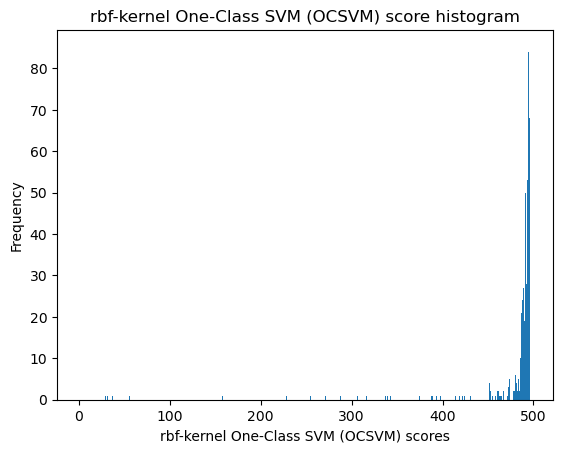

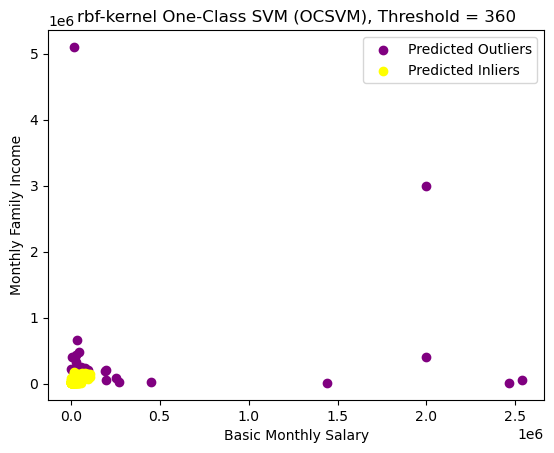

Number of predicted outliers: 38


,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,pred_outlier
14,5415,"LAMOSTE, JO-ANN",36,2534900,3,2,5,50000.0,5000,5000,5000,5000,4000,5000,2000,5000,1000,5000,10000,10000,1000,2500,4500,5000,500,5000,5000,5000,5000,2500,2500,5500,5000,5000,5000,5000,500,500,100,1,1,5000,1,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0,True
24,8342,"VALDEZ, MOSES",28,50000,3,4,8,200000.0,10000,10000,10000,4000,0,0,0,0,0,2100,10000,1000,2000,2000,0,1000,0,2000,2000,2000,1000,599,1899,0,0,0,0,0,0,0,0,0,0,10000,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,True
32,9274,"ALMUETE, CRISTEL",35,200000,3,2,3,50000.0,2000,1000,500,1000,100,100,1500,2000,1000,1000,1000,1000,500,500,2000,1000,500,500,500,1000,500,700,500,100,100,100,100,1000,100,100,100,100,100,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,True
50,9989,"BITAS, SHARRAH",23,37266,3,2,4,50000.0,6000,2000,2000,2500,0,0,0,0,0,0,5000,1000,300,2500,0,0,0,0,0,500,500,100,1500,0,0,0,0,0,0,0,0,0,0,200000,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,True
70,10503,"CASTRO, GLENDA",46,200000,3,1,5,200000.0,5000,1000,500,1000,500,1000,1000,500,500,500,1000,0,1000,1000,2000,0,0,0,100,500,500,500,1000,0,0,0,0,0,0,0,0,0,0,5000,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,1,True
114,10596,"ALERE, DINOS",40,19000,1,0,0,190000.0,1,3,4,3,1,1,1,2,2,1,4,4,5,5,4500,2,6,6,6,6,6,8,2,8,8,8,8,6,9,9,9,9,9,10,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,True
162,10679,"GONEZ, JAMES",25,80000,3,2,3,203000.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,1,True
200,10764,"SANTOS, JOHN CARLO",27,60000,3,1,5,65000.0,5000,1000,500,500,0,0,0,0,0,0,20000,5000,500,6000,0,1000,300,300,300,300,300,0,1625,0,0,0,0,0,0,0,0,0,0,200000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,True
231,11170,"SANTOR, EMELITA",54,7500,1,6,3,16000.0,1000,500,100,48,0,0,0,0,0,0,0,0,100,150,150000,0,0,0,0,0,0,20,366,0,0,10,0,24,0,0,0,0,0,1000,0,0,1,1,0,0,0,0,1,1,0,0,1,1,0,0,True
253,11201,"ABALOS, GLYNN",36,80000,3,2,2,230000.0,13000,2000,1000,3640,0,0,0,0,0,0,0,0,2275,3900,57200,0,0,3000,0,0,0,1300,1625,0,0,0,0,0,0,0,0,0,0,50000,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,True


[14, 24, 32, 50, 70, 114, 162, 200, 231, 253, 299, 323, 325, 380, 391, 405, 417, 435, 515, 556, 558, 563, 568, 584, 608, 677, 692, 702, 706, 762, 773, 830, 868, 912, 929, 940, 1009, 1046]


In [5]:
k = 'rbf'

scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
                         bins=1_000)

ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 360)
print(ho_t01_outliers)

# EDA on Dataset

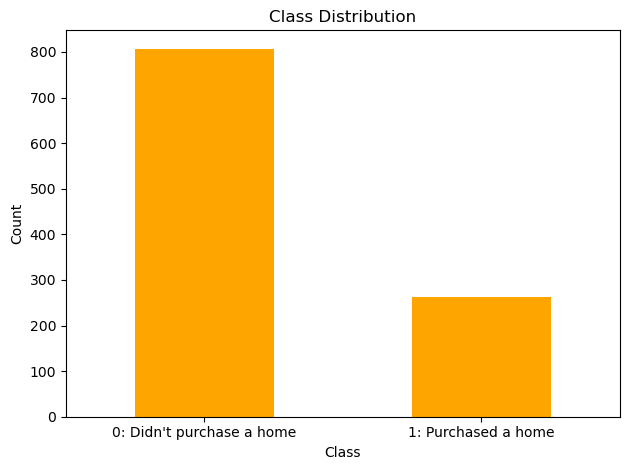

In [6]:
df = ho_t01
class_counts = df['home_ownership_class'].value_counts()
class_counts = class_counts.rename({0: "0: Didn't purchase a home",
                                    1: "1: Purchased a home"})

# Plot
# plt.figure(figsize=(10, 6))
class_counts.plot(kind='bar', color='orange')
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [10]:
pd.__version__

'1.5.3'

# HO_T01: Original

In [21]:
# ho_t01

# HO_T02: OHE Original, VarThresh

In [7]:
ho_t02 = ho_t01.copy()
ho_t02 = pd.get_dummies(ho_t02, columns=['gender'], prefix='gender', drop_first='True')
ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

In [8]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t02_X = ho_t02.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t02_y = ho_t02.copy()[['home_ownership_class']]
# ho_t02_y

In [9]:
from sklearn.feature_selection import VarianceThreshold

In [10]:
df = ho_t02_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t02_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [11]:
ho_t02_X_f02 = ho_t02_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema'
]
# ho_t02_X_f02 = ho_t02_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t02_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t02_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)

cinema | gambling | Correlation: 0.9071628455995576
cinema | smallLottery | Correlation: 0.9034179721740393
cinema | otherVices | Correlation: 0.9092351539530946
alcohol | gambling | Correlation: 0.9279949020777091
alcohol | smallLottery | Correlation: 0.9255905923368998
alcohol | otherVices | Correlation: 0.9232576094080833
gambling | smallLottery | Correlation: 0.9944469455269906
gambling | otherVices | Correlation: 0.9903118675408641
smallLottery | otherVices | Correlation: 0.9940848459135442

After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,0.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,0.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1066,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1067,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,0.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1068,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [12]:
ho_t02_X_f02 = ho_t02.copy().drop(columns=filtered_out_columns)
# ho_t02_X_f02 = ho_t02_X_f02.copy().drop(columns=cols_to_drop)
ho_t02_X_f02

ho_t02 = ho_t02_X_f02.copy()

In [13]:
ho_t02

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1,1,0,1,0,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0,0,0,1,0,1
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0,1,0,1,0,1
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1,0,0,1,0,1,0,1,1,0,0,0,0
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0,1,0,1,1,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,1,0,1,1,0,0,0,0,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,1,0,1,0,0,0,1,0,0,1
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0,0,0,0,0,1


# HO_T03: OHE, VarThresh, Removed correlated features

In [74]:
ho_t03 = ho_t01.copy()
ho_t03 = pd.get_dummies(ho_t03, columns=['gender'], prefix='gender', drop_first='True')
ho_t03 = pd.get_dummies(ho_t03, columns=['province'], prefix='province')
ho_t03 = pd.get_dummies(ho_t03, columns=['job'], prefix='job')
# ho_t02

In [75]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t03_X = ho_t03.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t03_y = ho_t03.copy()[['home_ownership_class']]
# ho_t02_y

In [76]:
df = ho_t03_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t03_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [77]:
ho_t03_X_f02 = ho_t03_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema'
]
ho_t03_X_f02 = ho_t03_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t03_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t03_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1066,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1067,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1068,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [78]:
ho_t03_X_f02 = ho_t03.copy().drop(columns=filtered_out_columns)
ho_t03_X_f02 = ho_t03_X_f02.copy().drop(columns=cols_to_drop)
ho_t03_X_f02

ho_t03 = ho_t03_X_f02.copy()

In [79]:
ho_t03

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1,1,0,1,0,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0,0,0,1,0,1
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,100,100,100,200,200,200,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0,1,0,1,0,1
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,100,200,400,0,0,0,0,0,876,0,0,500,1,0,0,1,0,1,0,1,1,0,0,0,0
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,500,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0,1,0,1,1,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,500,1,0,1,1,0,0,0,0,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,1000,0,0,0,300,0,0,0,500,0,0,0,0,2000,0,0,0,1,0,1,0,0,0,1,0,0,1
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0,0,0,0,0,1


# HO_T04: OHE, Removed Outliers, VarThresh

In [38]:
ho_t04 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t04

In [39]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t04))
print(f"Number of positive class points: {(ho_t04['home_ownership_class'] == 1).sum()}, {(ho_t04['home_ownership_class'] == 1).sum() / len(ho_t04) :.1%}")
print(f"Number of negative class points: {(ho_t04['home_ownership_class'] == 0).sum()}, {(ho_t04['home_ownership_class'] == 0).sum() / len(ho_t04) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 1070
Number of positive class points: 263, 24.6%
Number of negative class points: 807, 75.4%

OUTLIERS REMOVED
Number of outliers: 38
Number of positive class outliers: 15, 39.5%
Number of negative class outliers: 23, 60.5%

AFTER OUTLIER REMOVAL
Number of data points: 1032
Number of positive class points: 248, 24.0%
Number of negative class points: 784, 76.0%


In [40]:
ho_t04 = pd.get_dummies(ho_t04, columns=['gender'], prefix='gender', drop_first='True')
ho_t04 = pd.get_dummies(ho_t04, columns=['province'], prefix='province')
ho_t04 = pd.get_dummies(ho_t04, columns=['job'], prefix='job')
# ho_t02

In [41]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t04_X = ho_t04.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t04_y = ho_t04.copy()[['home_ownership_class']]
# ho_t02_y

In [42]:
df = ho_t04_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t04_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 48
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERAT

In [43]:
ho_t04_X_f02 = ho_t04_X_f01.copy()
# cols_to_drop = [
#     'smallLottery', 'otherVices', 'alcohol', 'cinema'
# ]
# ho_t04_X_f02 = ho_t04_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t04_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t04_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)

cinema | alcohol | Correlation: 0.9019659670569984
cinema | gambling | Correlation: 0.9133348945332308
cinema | smallLottery | Correlation: 0.9097980167545852
cinema | otherVices | Correlation: 0.9099542412290466
alcohol | gambling | Correlation: 0.9333895599687774
alcohol | smallLottery | Correlation: 0.9312160098441578
alcohol | otherVices | Correlation: 0.932142262462858
gambling | smallLottery | Correlation: 0.99447768866585
gambling | otherVices | Correlation: 0.9935861638948069
smallLottery | otherVices | Correlation: 0.9973344027764826

After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,0.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,0.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1028,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1029,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,0.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1030,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [44]:
ho_t04_X_f02 = ho_t04.copy().drop(columns=filtered_out_columns)
# ho_t04_X_f02 = ho_t04_X_f02.copy().drop(columns=cols_to_drop)
ho_t04_X_f02

ho_t04 = ho_t04_X_f02.copy()

# HO_T05: OHE, Removed Outliers, VarThresh, Removed highly correlated features

In [45]:
ho_t05 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [46]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t05))
print(f"Number of positive class points: {(ho_t05['home_ownership_class'] == 1).sum()}, {(ho_t05['home_ownership_class'] == 1).sum() / len(ho_t05) :.1%}")
print(f"Number of negative class points: {(ho_t05['home_ownership_class'] == 0).sum()}, {(ho_t05['home_ownership_class'] == 0).sum() / len(ho_t05) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 1070
Number of positive class points: 263, 24.6%
Number of negative class points: 807, 75.4%

OUTLIERS REMOVED
Number of outliers: 38
Number of positive class outliers: 15, 39.5%
Number of negative class outliers: 23, 60.5%

AFTER OUTLIER REMOVAL
Number of data points: 1032
Number of positive class points: 248, 24.0%
Number of negative class points: 784, 76.0%


In [47]:
ho_t05 = pd.get_dummies(ho_t05, columns=['gender'], prefix='gender', drop_first='True')
ho_t05 = pd.get_dummies(ho_t05, columns=['province'], prefix='province')
ho_t05 = pd.get_dummies(ho_t05, columns=['job'], prefix='job')
# ho_t02

In [48]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t05_X = ho_t05.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t05_y = ho_t05.copy()[['home_ownership_class']]
# ho_t02_y

In [49]:
df = ho_t05_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t05_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 48
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERAT

In [50]:
ho_t05_X_f02 = ho_t05_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema'
]
ho_t05_X_f02 = ho_t05_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t05_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t05_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1028,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1029,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1030,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [51]:
ho_t05_X_f02 = ho_t05.copy().drop(columns=filtered_out_columns)
ho_t05_X_f02 = ho_t05_X_f02.copy().drop(columns=cols_to_drop)
ho_t05_X_f02

ho_t05 = ho_t05_X_f02.copy()

# HO_T06: OHE, Removed Outliers, VarThresh, Removed highly correlated features via VIF

In [52]:
ho_t06 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [53]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t06))
print(f"Number of positive class points: {(ho_t06['home_ownership_class'] == 1).sum()}, {(ho_t06['home_ownership_class'] == 1).sum() / len(ho_t06) :.1%}")
print(f"Number of negative class points: {(ho_t06['home_ownership_class'] == 0).sum()}, {(ho_t06['home_ownership_class'] == 0).sum() / len(ho_t06) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 1070
Number of positive class points: 263, 24.6%
Number of negative class points: 807, 75.4%

OUTLIERS REMOVED
Number of outliers: 38
Number of positive class outliers: 15, 39.5%
Number of negative class outliers: 23, 60.5%

AFTER OUTLIER REMOVAL
Number of data points: 1032
Number of positive class points: 248, 24.0%
Number of negative class points: 784, 76.0%


In [54]:
ho_t06 = pd.get_dummies(ho_t06, columns=['gender'], prefix='gender', drop_first='True')
ho_t06 = pd.get_dummies(ho_t06, columns=['province'], prefix='province')
ho_t06 = pd.get_dummies(ho_t06, columns=['job'], prefix='job')
# ho_t02

In [55]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t06_X = ho_t06.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t06_y = ho_t06.copy()[['home_ownership_class']]
# ho_t02_y

In [56]:
df = ho_t06_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t06_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 48
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERAT

In [57]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t06_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [58]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'otherVices',
 'gambling',
 'age',
 'preferredNetDisposableIncomeId',
 'houseOnlyFamily',
 'alcohol']

In [59]:
ho_t06_X_f02 = ho_t06.copy().drop(columns=filtered_out_columns)
ho_t06_X_f02 = ho_t06_X_f02.copy().drop(columns=columns_to_remove)
ho_t06_X_f02

ho_t06 = ho_t06_X_f02.copy()

# HO_T07 (discarded): OHE, VarThresh, Removed highly correlated features via VIF

In [204]:
ho_t07 = ho_t01.copy()

# ho_t05

In [205]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [206]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [207]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [208]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [209]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [ ]:
ho_t07_X_f02 = ho_t07.copy().drop(columns=filtered_out_columns)
ho_t07_X_f02 = ho_t07_X_f02.copy().drop(columns=columns_to_remove)
ho_t07_X_f02

ho_t07 = ho_t07_X_f02.copy()

# HO_T07: OHE, VarThresh, Added new features (retained only those won't be removed by VIF)

In [60]:
df = ho_t01.copy()

# df['monthlyFamilyIncome - basicMonthlySalary'] = df['monthlyFamilyIncome'] - df['basicMonthlySalary']
df['monthlyVices'] = (
    df['smoking'] + df['alcohol'] + df['gambling'] +
    df['smallLottery'] + df['otherVices']
)
df['monthlyUtilityBills'] = (
    df['water'] + df['electricity'] + df['rent'] +
    df['internet'] + df['mobileLoad']
)
df['totalMonthlyExpenses'] = (
    df['food'] + df['hygiene'] + df['houseCleaning'] +
    df['fare'] + df['parking'] + df['gasoline'] +
    df['tuition'] + df['allowance'] + df['uniform'] +
    df['otherEducation'] + df['emergency'] + df['medicine'] +
    df['repair'] + df['cinema'] + df['dineOut'] +
    df['leisure'] + df['personalCare'] + df['clothing'] +
    df['vehicleLoan'] + df['monthlyUtilityBills'] +
    df['informalLenders'] + df['companyLoan'] + df['privateLoans'] +
    df['governmentLoans'] + df['monthlyVices']
)
# df['monthlyFamilyIncome - totalMonthlyExpenses'] = df['monthlyFamilyIncome'] - df['totalMonthlyExpenses']
# df['basicMonthlySalary - totalMonthlyExpenses'] = df['basicMonthlySalary'] - df['totalMonthlyExpenses']
# df['monthlyFamilyIncome / workingFamilyCount'] = np.where(
#     df['workingFamilyCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['workingFamilyCount']
# )
# df['monthlyFamilyIncome / residentsCount'] = np.where(
#     df['residentsCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['residentsCount']
# )
df['basicMonthlySalary / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['basicMonthlySalary'] / df['monthlyFamilyIncome']
)
df['totalMonthlyExpenses / basicMonthlySalary'] = np.where(
    df['basicMonthlySalary'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['basicMonthlySalary']
)
df['totalMonthlyExpenses / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['monthlyFamilyIncome']
)
# df['monthlyVices / basicMonthlySalary'] = np.where(
#     df['basicMonthlySalary'] == 0,
#     0,
#     df['monthlyVices'] / df['basicMonthlySalary']
# )

ho_t07 = df.copy()

In [61]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [62]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [63]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [64]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

divide by zero encountered in scalar divide


In [65]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['vehicleLoan',
 'gambling',
 'rent',
 'repair',
 'cinema',
 'dineOut',
 'leisure',
 'personalCare',
 'clothing',
 'mobileLoad',
 'internet',
 'smallLottery',
 'informalLenders',
 'companyLoan',
 'privateLoans',
 'governmentLoans',
 'smoking',
 'electricity',
 'water',
 'medicine',
 'houseCleaning',
 'totalMonthlyExpenses',
 'monthlyUtilityBills',
 'monthlyVices',
 'otherVices',
 'food',
 'hygiene',
 'fare',
 'emergency',
 'parking',
 'gasoline',
 'tuition',
 'allowance',
 'uniform',
 'otherEducation',
 'alcohol',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

# HO_T08: Dropped cat features, VarThresh

In [66]:
ho_t08 = ho_t01.copy().drop(columns=['gender', 'province', 'job'])

# ho_t05

In [67]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t08_X = ho_t08.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t08_y = ho_t08.copy()[['home_ownership_class']]
# ho_t02_y

In [68]:
df = ho_t08_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t08_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 8
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee']


In [69]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t08_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [70]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [71]:
ho_t08 = ho_t08.copy().drop(columns=filtered_out_columns)
# ho_t08_X_f02 = ho_t08_X_f02.copy().drop(columns=columns_to_remove)
ho_t08

ho_t08 = ho_t08.copy()

In [72]:
ho_t08

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1,0,0,1,0,1,0,1
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,1,0,1,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,1,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0


# Functions for Classification Modeling and Others

In [14]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [46]:
# ho_t02.info()

In [15]:
ho_t02['userId'] = ho_t02['userId'].astype('str')
ho_t02 = adjust_data_types(ho_t02)
ho_t02.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1070 entries, 0 to 1069
Data columns (total 55 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          1070 non-null   object 
 1   lastFirstName                   1070 non-null   object 
 2   age                             1070 non-null   float64
 3   basicMonthlySalary              1070 non-null   float64
 4   preferredNetDisposableIncomeId  1070 non-null   float64
 5   workingFamilyCount              1070 non-null   float64
 6   residentsCount                  1070 non-null   float64
 7   monthlyFamilyIncome             1070 non-null   float64
 8   food                            1070 non-null   float64
 9   hygiene                         1070 non-null   float64
 10  houseCleaning                   1070 non-null   float64
 11  fare                            1070 non-null   float64
 12  parking                         10

In [17]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from lightgbm import LGBMClassifier
from xgboost.sklearn import XGBClassifier

from sklearn.feature_selection import RFE, RFECV, VarianceThreshold

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer, confusion_matrix, roc_curve
from sklearn.model_selection import GridSearchCV, StratifiedKFold, permutation_test_score
from sklearn.base import clone


from imblearn.metrics import geometric_mean_score
import shap

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from imblearn.pipeline import Pipeline
# from sklearn.pipeline import Pipeline

import dice_ml

from catboost import CatBoostClassifier

In [18]:
def specificity_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn + fp)
    return specificity

specificity_scorer = make_scorer(specificity_score)

def npv_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    npv = tn / (tn + fn)
    return npv

npv_scorer = make_scorer(npv_score)

g_mean_scorer = make_scorer(geometric_mean_score)


skf = StratifiedKFold(10, shuffle=True, random_state=0)

# def get_cat_cols(df):
#     one_hot_encoded_columns = []

#     for idx, column in enumerate(df.columns):
#         if df[column].nunique() == 2 and set(df[column].unique()) == {0, 1}:
#             one_hot_encoded_columns.append(idx)

#     return one_hot_encoded_columns

def get_cat_cols(df):
    return df.select_dtypes(include=['object']).columns.tolist()

# get_cat_cols(ho_t02)
# cat_cols = get_cat_cols(ho_t02)
# num_cols = [col for col in ho_t02.columns if col not in cat_cols]
# cat_cols, num_cols

In [19]:
from sklearn.decomposition import PCA

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours, TomekLinks
from imblearn.combine import SMOTEENN, SMOTETomek


from sklearn.base import BaseEstimator, TransformerMixin

class DropCategoricalFeatures(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Assuming X is a DataFrame
        non_categorical_cols = X.select_dtypes(exclude=['object']).columns.tolist()
        return X[non_categorical_cols]


def knn_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', KNeighborsClassifier())
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_neighbors': list(range(1, 16)),
        'classifier__metric': ['euclidean', 'cosine', 'hamming', 'braycurtis',
                               'chebyshev', 'canberra', 'cityblock', 'sqeuclidean'
                              ]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

#         y_hat = modified_estimator.predict_proba(X_test)[:, 1]

#         fpr, tpr, thresholds = roc_curve(y_test, y_hat)
#         gmeans = np.sqrt(tpr * (1-fpr))
#         ix = np.argmax(gmeans)
#         print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

#         plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
#         plt.plot(fpr, tpr, marker='.', label='Original')
#         plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

#         plt.xlabel('False Positive Rate')
#         plt.ylabel('True Positive Rate')
#         plt.legend()

#         plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def svm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', SVC(random_state=random_state, max_iter=1000,
                           verbose=True))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__probability': [True, False],
        'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def logreg_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
#         ('drop_categorical', None),
#         ('encoder', None),
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LogisticRegression(random_state=random_state, max_iter=1000))
    ])

    param_grid = {
#         'drop_categorical': [None, DropCategoricalFeatures()]
#         'encoder': [None, OneHotEncoder(sparse_output=False)],
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__penalty': ['l2', None],
        'classifier__solver': ['liblinear', 'lbfgs', 'newton-cholesky']
#         'classifier__penalty': ['l1', l2', 'elasticnet', 'None']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df



def dt_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]


    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', DecisionTreeClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(), 
#             RobustScaler(),
#             MinMaxScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
            SMOTEENN(random_state=random_state),
            SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
            TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
#         'classifier__max_depth': [3],
# #         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [1],
#         'classifier__max_depth': [2, 5],
#         'classifier__min_samples_split': [3],
#         'classifier__min_samples_leaf': [3],
# #         'classifier__max_features': ['auto', 'sqrt', 'log2', None],
#         'classifier__criterion': ["entropy", "log_loss"]
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [2, 3],
        'classifier__max_depth': [2, 3, 5],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [1, 2, 3],
        'classifier__max_features': ['auto', 'sqrt', 'log2', None],
        'classifier__criterion': ["gini", "entropy", "log_loss"]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.decomposition import TruncatedSVD

def rf_class2(df, scorer, label_col, random_state=0):
#     df_majority = df[df.home_ownership_class == 0]
#     df_minority = df[df.home_ownership_class == 1]

# #     display(df_majority)
# #     display(df_minority)
# #     print(len(df_majority), len(df_minority))
#     # Randomly downsample majority class
#     df_majority_downsampled = df_majority.sample(frac=0.2,
#                                                  random_state=random_state)
#     df = pd.concat([df_majority_downsampled, df_minority], axis=0)

    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)

#     n_components = X_scaled.shape[1]  # Maximum number of components
#     svd = TruncatedSVD(n_components=n_components)
#     X_svd = svd.fit_transform(X_scaled)

#     # Step 3: Find number of components that explain at least 90% variance
#     cum_variance = np.cumsum(svd.explained_variance_ratio_)
#     num_components = np.argmax(cum_variance >= 0.90) + 1  # +1 because Python indexing starts from 0
#     X_selected = X_svd[:, :num_components]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

#     X_resampled, y_resampled = RandomOverSampler(random_state=random_state).fit_resample(X_train, y_train)
#     class_counts_original = np.bincount(y_train.astype(int))
#     class_counts_resampled = np.bincount(y_resampled.astype(int))

    # Assuming 0 is the majority class, calculate its upweight factor
#     majority_class_original = class_counts_original[0]
#     majority_class_resampled = class_counts_resampled[0]
#     upweight_factor = majority_class_original / majority_class_resampled

#     minority_class_original = class_counts_original[1]
#     minority_class_resampled = class_counts_resampled[1]
#     downweight_factor = minority_class_original / minority_class_resampled

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', RandomForestClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_estimators': [200, 300],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__oob_score': [True, False],
        'classifier__criterion': ["gini", "entropy", "log_loss"]

#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__oob_score': [True, False],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
    }
#         'classifier__n_estimators': [200, 250, 300],
# #         'classifier__max_depth': [2, 3, 4],
#         'classifier__max_depth': [2],
#         'classifier__class_weight': [{0: 263/807, 1:1}],
#         'classifier__oob_score': [True],
# #         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
#     }
    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         modified_estimator = best_estimator
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def gbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', GradientBoostingClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
        'classifier__n_estimators': [200, 250],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def lgbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     plt.figure(figsize=(10, 6))
#     plt.plot(range(1, len(explained_var_ratio)+1), cumulative_explained_var, marker='o', linestyle='--')
#     plt.title('Cumulative Explained Variance Plot')
#     plt.xlabel('Number of Components')
#     plt.ylabel('Cumulative Explained Variance')
#     plt.grid(True)
#     plt.show()

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LGBMClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [400, 450],
#         'classifier__learning_rate': [0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__max_depth': [2, 3],
#         'classifier__boosting_type': ['gbdt', 'dart', 'goss']

        'classifier__n_estimators': [200, 300, 400],
        'classifier__learning_rate': [0.1, 0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
        'classifier__max_depth': [2, 3],
        'classifier__boosting_type': ['gbdt', 'dart', 'goss']
    }
#         'classifier__num_leaves': [20, 31, 40],
#         'classifier__min_child_samples': [10, 20, 30],
#         'classifier__max_depth': [-1, 5, 10],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def xgb_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', XGBClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
# #         'classifier__n_estimators': [200, 250],
#         'classifier__learning_rate': [2, 3],
# #         'classifier__max_depth': [2, 3],
#         'classifier__max_leaves': [5],
#         'classifier__grow_policy': ['depthwise', 'lossguide']
        'classifier__n_estimators': [200, 250],
        'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__max_depth': [None, 2, 3],
        'classifier__max_leaves': [10, 20, 30],
        'classifier__grow_policy': ['depthwise', 'lossguide']
    }
#         'classifier__max_depth': [None, 5, 10],
#         'classifier__max_leaves': [0, 10, 20],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def adaboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', AdaBoostClassifier(
            random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)],
        'classifier__n_estimators': [200, 300],
        'classifier__estimator': [DecisionTreeClassifier(
            random_state=random_state,
#             criterion='entropy', max_depth=3,
#             min_samples_leaf=2, min_samples_split=2
        ),
                                  RandomForestClassifier(
            random_state=random_state,
#             max_depth=3, min_samples_leaf=2,
#             min_samples_split=2, n_estimators=250,
#             oob_score=True
                                                        )],
#         'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__algorithm': ['SAMME', 'SAMME.R']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]


        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.linear_model import RidgeClassifier

def ridge_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]
    
    cat_transformer = Pipeline([
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])
    
    num_transformer = Pipeline([
        ('variance_threshold', VarianceThreshold(threshold=0.15))
    ])
    
    preprocessor = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols),
            ('cat', cat_transformer, cat_cols)
        ],
        remainder='passthrough'
    )

    preprocessor_num = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols)
        ],
        remainder='drop'
    )

    preprocessor_drop_cat = ColumnTransformer(
        transformers = [
            ('num', 'passthrough', num_cols)
        ],
        remainder='drop'
    )

    pipeline = Pipeline([
#         ('preprocessor', None),
        ('preprocessor', preprocessor_drop_cat),
#         ('scaler', None),
        ('resampling', None),
        ('var_threshold', VarianceThreshold(threshold=0.15)),
        ('classifier', RidgeClassifier(max_iter=1000, random_state=random_state))
    ])

    param_grid = {
#         'preprocessor': [
#             preprocessor_drop_cat,
#             preprocessor,
#             preprocessor_num            
#         ],
        'resampling': [ADASYN(random_state=random_state),
                       SMOTEENN(random_state=random_state),
                       SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
                       TomekLinks(),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__alpha': [0.01, 0.1, 1, 10, 100, 1000],
        'classifier__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sag', 'saga'],
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=10, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
        if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
            isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
            modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
        modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time) / 60

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def catboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', CatBoostClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_leaf': [2, 3],
#         'classifier__min_samples_split': [2, 3],
#         'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

# HO-T02 runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2000 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.594305156716838
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 77.2857460975647 secs
Run 1 - Random State: 0
Test G-mean: 0.65248952041962
Best Threshold=0.571125, G-Mean=0.652


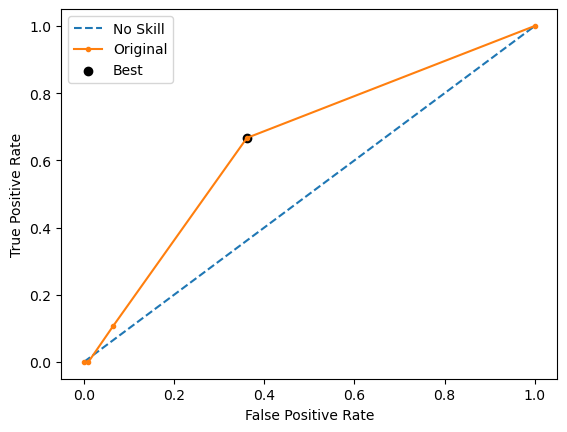

Run 2 - Random State: 1
Test G-mean: 0.6221243475949056
Best Threshold=0.549689, G-Mean=0.622


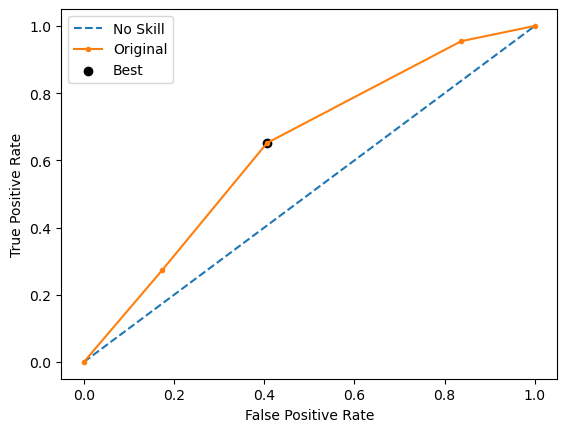

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.575309, G-Mean=0.587


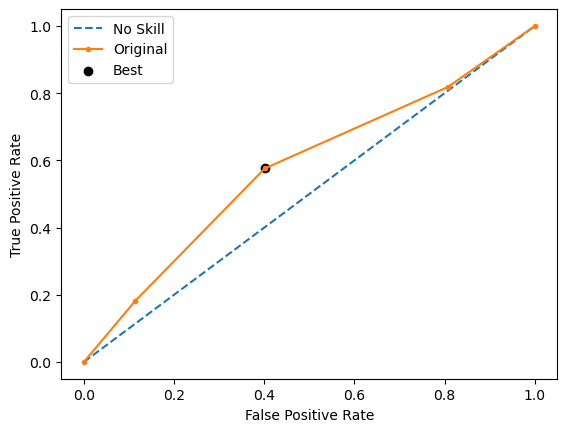

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.567033, G-Mean=0.647


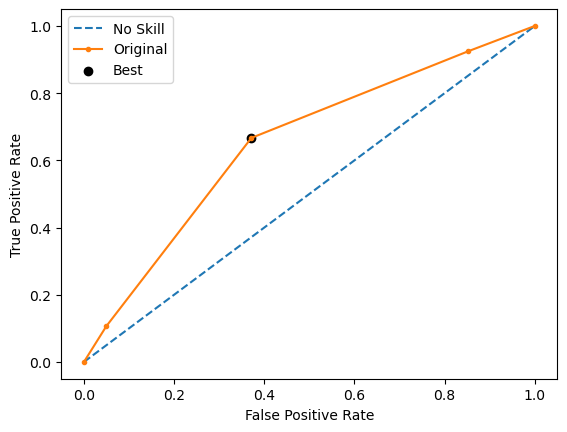

Run 5 - Random State: 4
Test G-mean: 0.6180114835659464
Best Threshold=0.556373, G-Mean=0.618


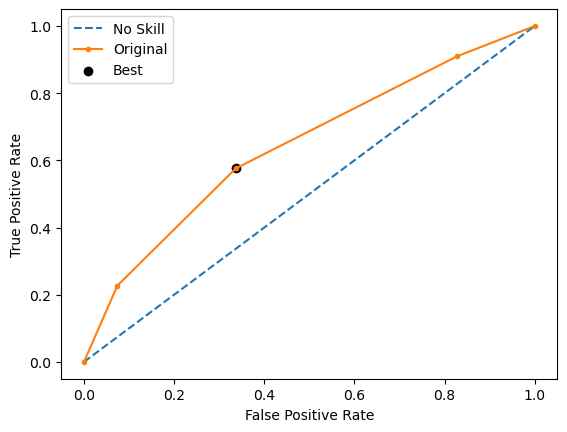

Ave Test G-mean: 0.6254611446779585
Stdev Test G-mean: 0.02616131245822572
Ave Test Specificity: 0.6247524752475248
Ave Test Recall: 0.6272727272727272
Ave Test NPV: 0.8370110997901863
Ave Test Accuracy: 0.6253731343283582
Ave Test Precision: 0.35352691447164253
Ave Test F1-Score: 0.45189660972947365
Ave Runtime: 0.04068751335144043


In [20]:
ho_t02_dt_gs, ho_t02_dt_be, ho_t02_dt_model_info, ho_t02_dt_metrics_df = dt_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5998377217052783
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=2,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.6201809200733651
Std Train Score (G-mean) 0.01963670775034597
GridSearchCV Runtime: 879.9572575092316 secs
Run 1 - Random State: 0
Test G-mean: 0.6561577968030484
Best Threshold=0.503090, G-Mean=0.6

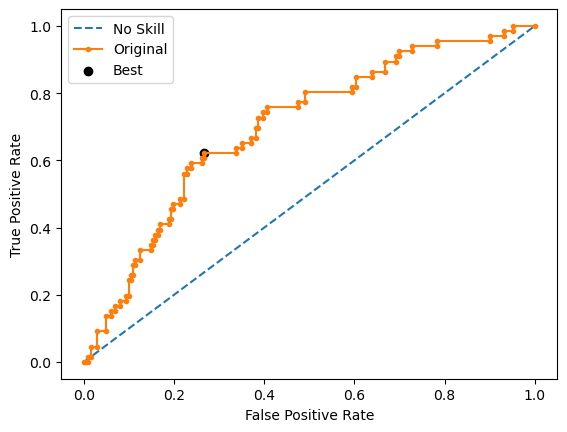

Run 2 - Random State: 1
Test G-mean: 0.5936836245211774
Best Threshold=0.486717, G-Mean=0.610


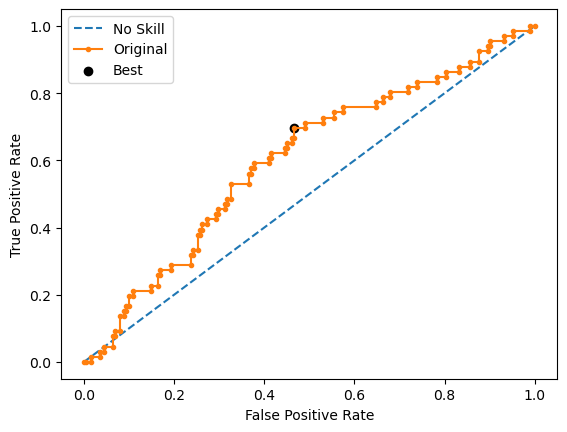

Run 3 - Random State: 2
Test G-mean: 0.6095179662775508
Best Threshold=0.511095, G-Mean=0.623


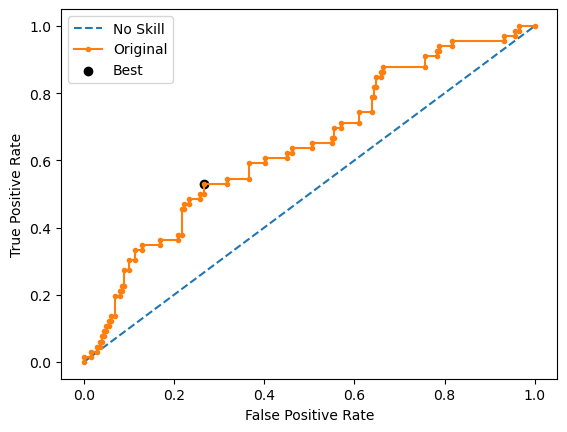

Run 4 - Random State: 3
Test G-mean: 0.644857801502328
Best Threshold=0.498898, G-Mean=0.650


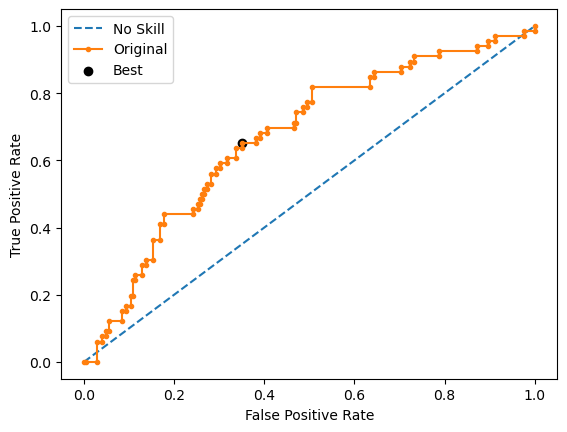

Run 5 - Random State: 4
Test G-mean: 0.5823305855706784
Best Threshold=0.522937, G-Mean=0.604


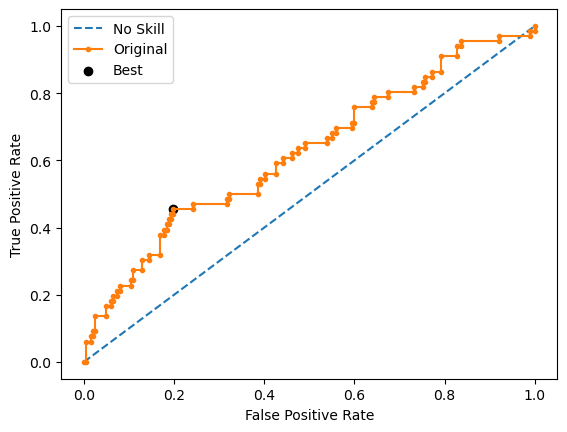

Ave Test G-mean: 0.6173095549349565
Stdev Test G-mean: 0.03205664332353168
Ave Test Specificity: 0.6564356435643565
Ave Test Recall: 0.5818181818181818
Ave Test NPV: 0.8278597872715521
Ave Test Accuracy: 0.6380597014925373
Ave Test Precision: 0.35645107046395463
Ave Test F1-Score: 0.44172398155069914
Ave Runtime: 1.0722969055175782


In [21]:
ho_t02_rf_gs, ho_t02_rf_be, ho_t02_rf_model_info, ho_t02_rf_metrics_df = rf_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6014845566701644
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 142.34454703330994 secs


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 1 - Random State: 0
Test G-mean: 0.5907705992939214
Best Threshold=0.508916, G-Mean=0.601


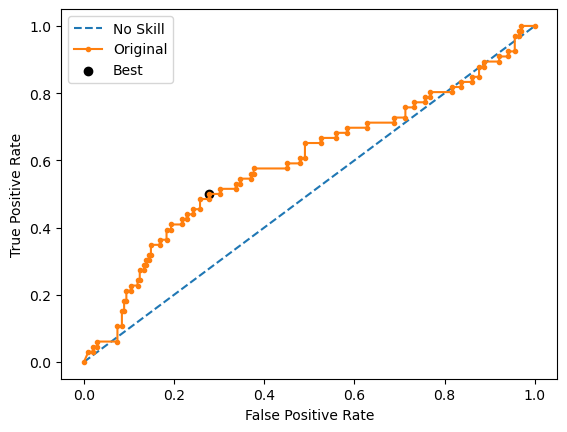

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 2 - Random State: 1
Test G-mean: 0.5751374429715307
Best Threshold=0.526473, G-Mean=0.593


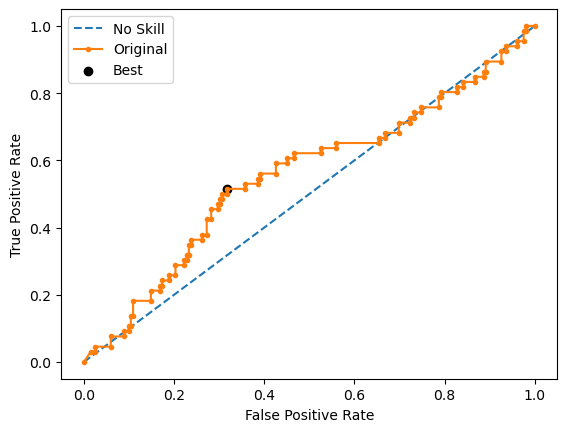

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 3 - Random State: 2
Test G-mean: 0.6016528888153551
Best Threshold=0.524182, G-Mean=0.634


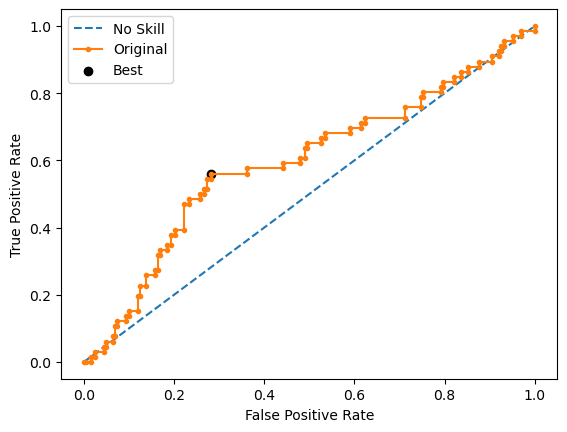

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 4 - Random State: 3
Test G-mean: 0.5875240577643142
Best Threshold=0.506604, G-Mean=0.592


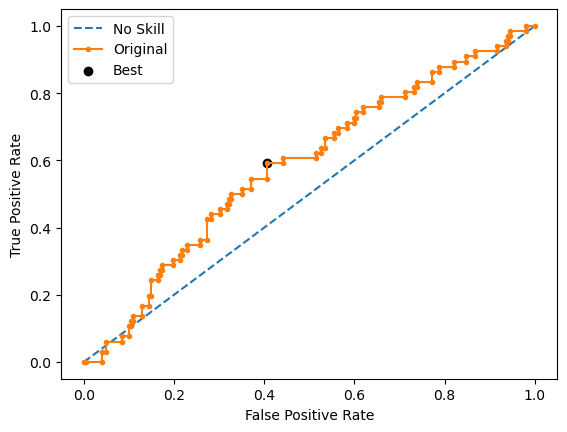

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 5 - Random State: 4
Test G-mean: 0.556107836298464
Best Threshold=0.485860, G-Mean=0.565


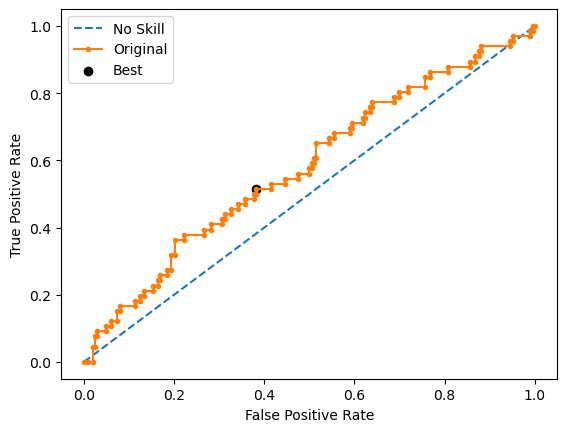

Ave Test G-mean: 0.5822385650287171
Stdev Test G-mean: 0.01739891468381158
Ave Test Specificity: 0.6386138613861386
Ave Test Recall: 0.5333333333333333
Ave Test NPV: 0.8075414414222927
Ave Test Accuracy: 0.6126865671641791
Ave Test Precision: 0.32594710033499297
Ave Test F1-Score: 0.40375072403546397
Ave Runtime: 0.713903284072876


In [22]:
ho_t02_logreg_gs, ho_t02_logreg_be, ho_t02_logreg_model_info, ho_t02_logreg_metrics_df = logreg_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5552765966903894
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2546248278672638
Std Train Score (G-mean) 0.0499746127766985
GridSearchCV Runtime: 355.04674530029297 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.4546654507076678
Best Threshold=0.500000, G-Mean=0.167


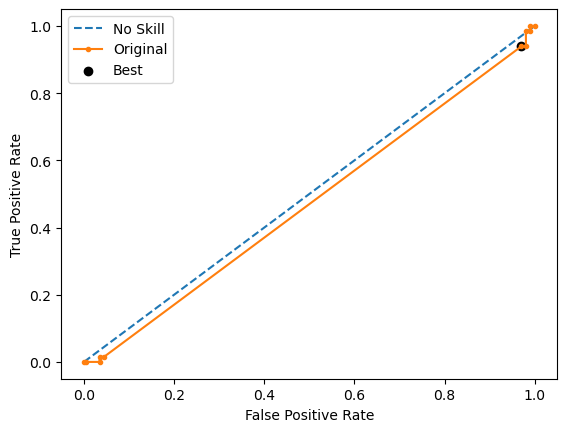

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 2 - Random State: 1
Test G-mean: 0.49244212850343383
Best Threshold=0.505707, G-Mean=0.322


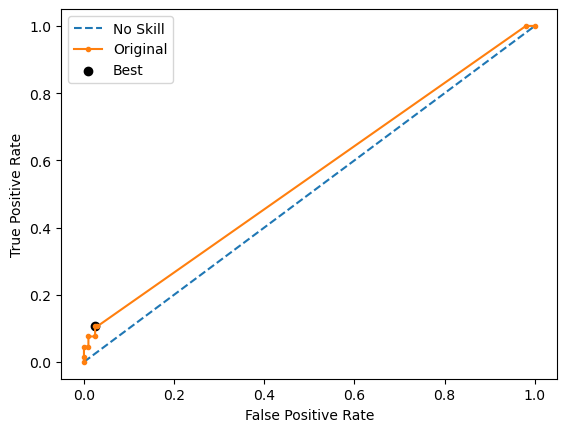

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.556107836298464
Best Threshold=0.508563, G-Mean=0.322


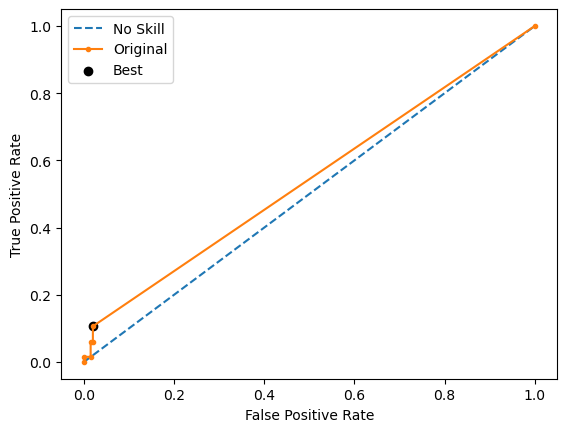

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.43312095236312176
Best Threshold=0.505269, G-Mean=0.268


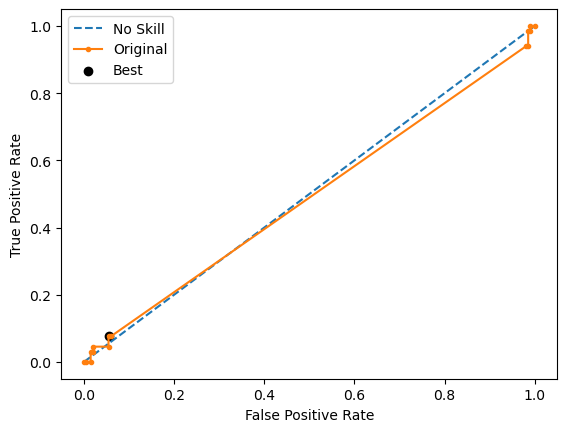

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.5218019046753013
Best Threshold=0.505135, G-Mean=0.503


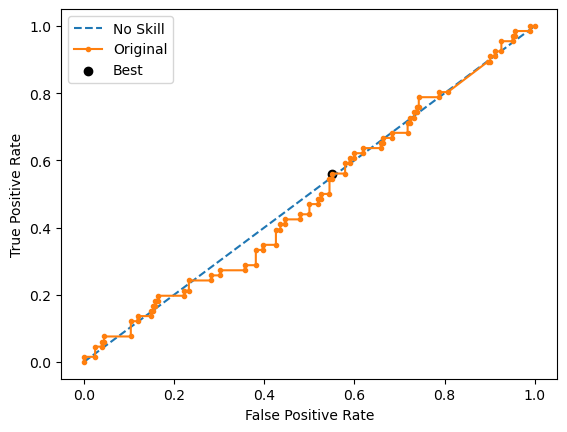

Ave Test G-mean: 0.4916276545095978
Stdev Test G-mean: 0.04964393540611533
Ave Test Specificity: 0.41287128712871296
Ave Test Recall: 0.6393939393939394
Ave Test NPV: 0.7789048171606311
Ave Test Accuracy: 0.4686567164179105
Ave Test Precision: 0.26671086908114994
Ave Test F1-Score: 0.37028664554316115
Ave Runtime: 0.48166723251342775


In [23]:
ho_t02_svm_gs, ho_t02_svm_be, ho_t02_svm_model_info, ho_t02_svm_metrics_df = svm_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [24]:
ho_t02_knn_gs, ho_t02_knn_be, ho_t02_knn_model_info, ho_t02_knn_metrics_df = knn_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 3, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5602736250220166
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=3))])
Mean Train Score (G-mean) 0.6880481414396599
Std Train Score (G-mean) 0.014369111033619755
GridSearchCV Runtime: 274.3233892917633 secs
Run 1 - Random State: 0
Test G-mean: 0.5568491789531615
Run 2 - Random State: 1
Test G-mean: 0.49736780904452127
Run 3 - Random State: 2
Test G-mean: 0.5282309180559948
Run 4 - Random State: 3
Test G-mean: 0.46405445225045017
Run 5 - Random State: 4
Test G-mean: 0.5327554625137915
Ave Test G-mean: 0.5158515641635839
Stdev Test G-mean: 0.03586218275044573
Ave Test Specificity: 0.

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5741407739274401
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8731607295333015
Std Train Score (G-mean) 0.010151152017195495
GridSearchCV Runtime: 687.2776138782501 secs
Run 1 - Random State: 0
Test G-mean: 0.6084094149514948
Best Threshold=0.344862, G-Mean=0.620


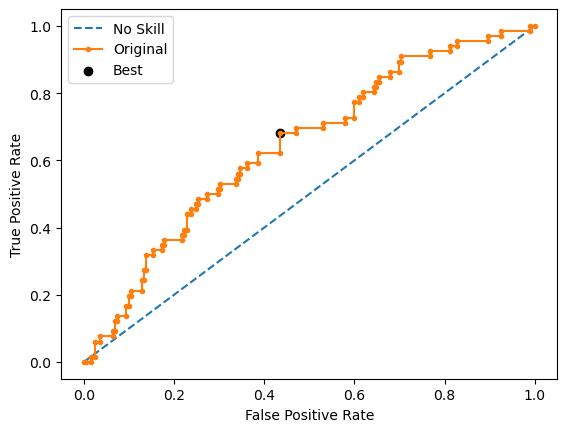

Run 2 - Random State: 1
Test G-mean: 0.5734395201661017
Best Threshold=0.321235, G-Mean=0.598


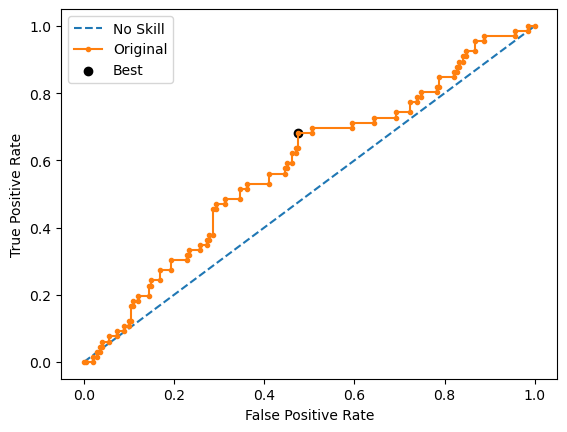

Run 3 - Random State: 2
Test G-mean: 0.6274068567814618
Best Threshold=0.474304, G-Mean=0.637


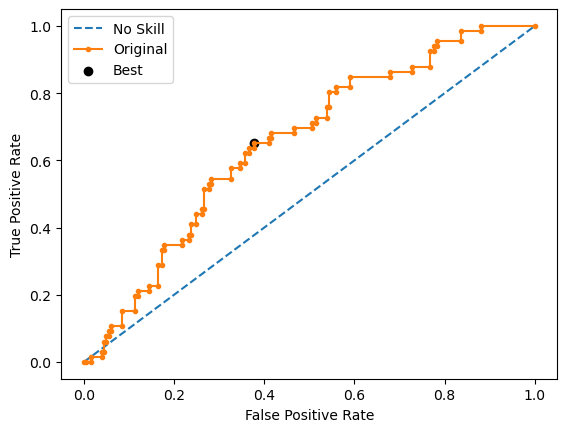

Run 4 - Random State: 3
Test G-mean: 0.5317690079609593
Best Threshold=0.556856, G-Mean=0.563


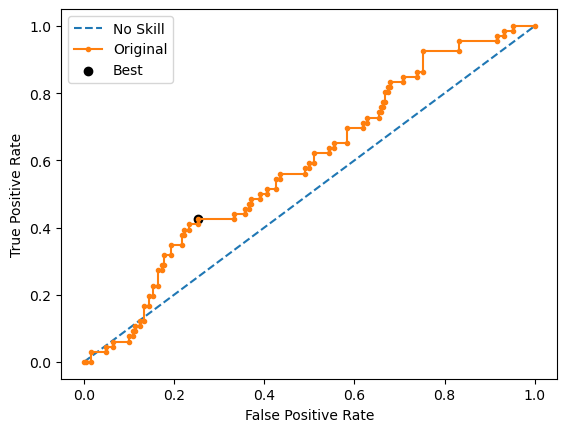

Run 5 - Random State: 4
Test G-mean: 0.5975246468308709
Best Threshold=0.476726, G-Mean=0.626


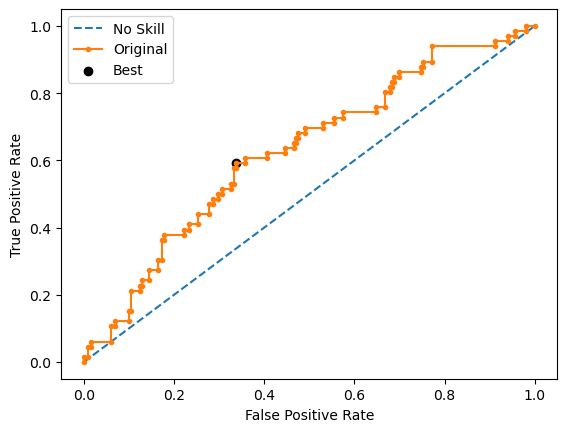

Ave Test G-mean: 0.5877098893381777
Stdev Test G-mean: 0.03685673172914707
Ave Test Specificity: 0.6693069306930693
Ave Test Recall: 0.5181818181818182
Ave Test NPV: 0.8099869883675661
Ave Test Accuracy: 0.6320895522388059
Ave Test Precision: 0.3384594718436434
Ave Test F1-Score: 0.40896679038327477
Ave Runtime: 1.935537004470825


In [25]:
ho_t02_gbm_gs, ho_t02_gbm_be, ho_t02_gbm_model_info, ho_t02_gbm_metrics_df = gbm_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.592547724973347
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_ty

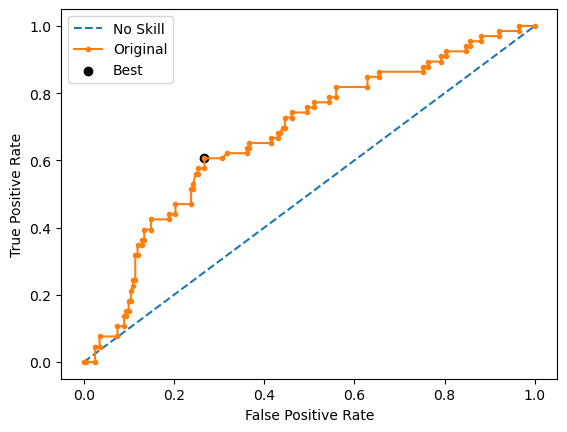

Run 2 - Random State: 1
Test G-mean: 0.5931148105703076
Best Threshold=0.468157, G-Mean=0.620


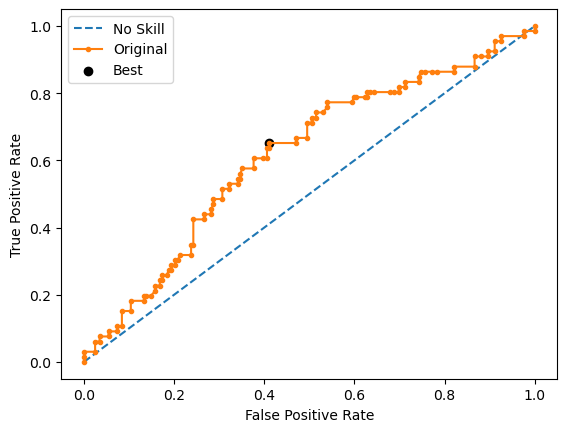

Run 3 - Random State: 2
Test G-mean: 0.6087175483796821
Best Threshold=0.516426, G-Mean=0.614


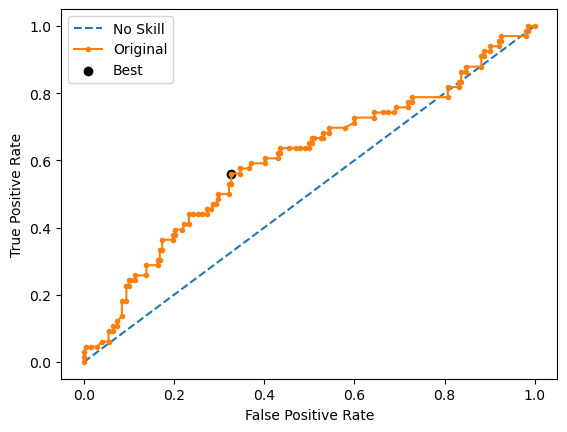

Run 4 - Random State: 3
Test G-mean: 0.6245310271719012
Best Threshold=0.495008, G-Mean=0.643


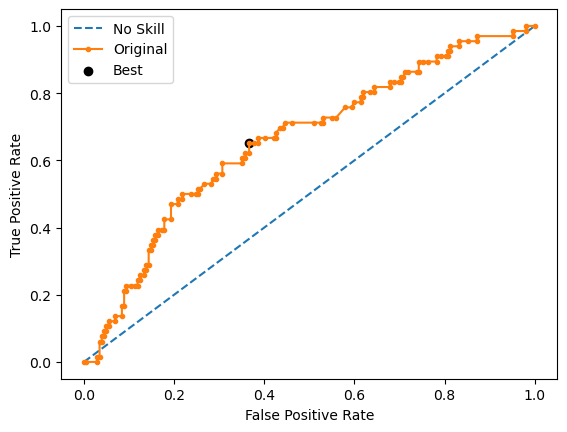

Run 5 - Random State: 4
Test G-mean: 0.6400124698755171
Best Threshold=0.517615, G-Mean=0.641


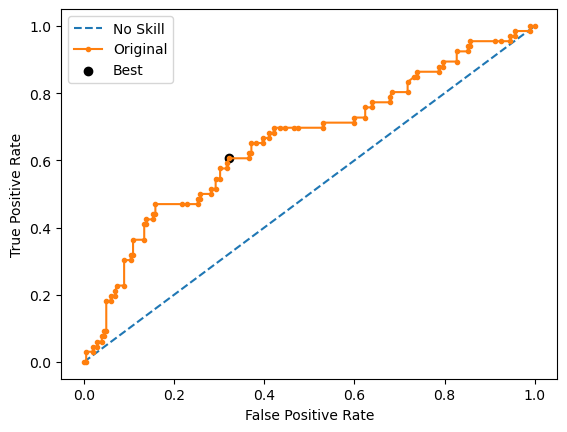

Ave Test G-mean: 0.6226184082368186
Stdev Test G-mean: 0.022082858315004665
Ave Test Specificity: 0.6504950495049505
Ave Test Recall: 0.5969696969696969
Ave Test NPV: 0.8319253038284409
Ave Test Accuracy: 0.637313432835821
Ave Test Precision: 0.3579975155189192
Ave Test F1-Score: 0.447367462230302
Ave Runtime: 0.19022483825683595


In [26]:
ho_t02_xgb_gs, ho_t02_xgb_be, ho_t02_xgb_model_info, ho_t02_xgb_metrics_df = xgb_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5872839868992282
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9423110188300307
Std Train Score (G-mean) 0.005102623733249304
GridSearchCV Runtime: 13.986908435821533 secs
Run 1 - Random State: 0
Test G-mean: 0.6022759115450017
Best Threshold=0.880797, G-Mean=0.602


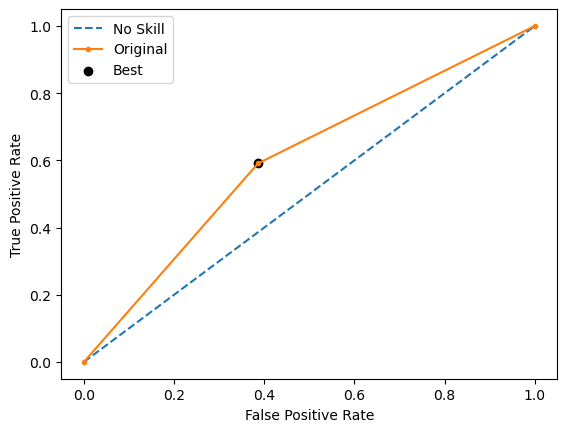

Run 2 - Random State: 1
Test G-mean: 0.5794899316278807
Best Threshold=0.880797, G-Mean=0.579


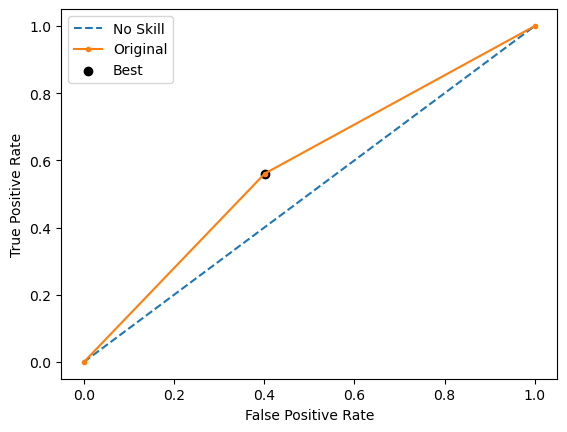

Run 3 - Random State: 2
Test G-mean: 0.5975246468308709
Best Threshold=0.880797, G-Mean=0.598


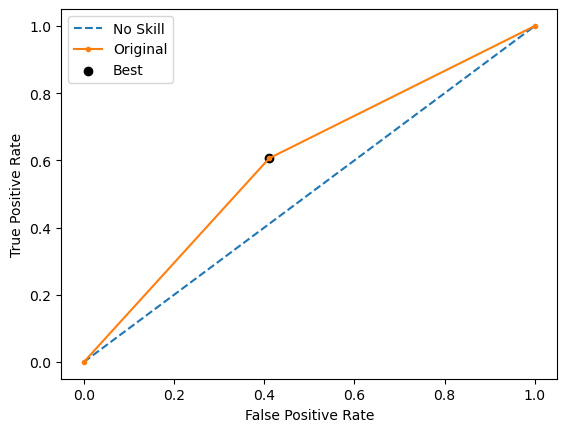

Run 4 - Random State: 3
Test G-mean: 0.6550136672546834
Best Threshold=0.880797, G-Mean=0.655


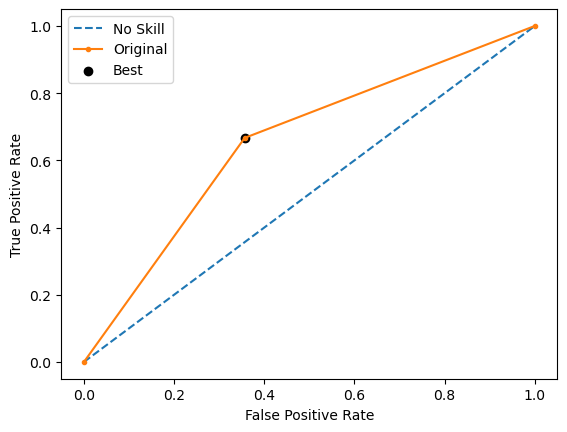

Run 5 - Random State: 4
Test G-mean: 0.5692384414639651
Best Threshold=0.880797, G-Mean=0.569


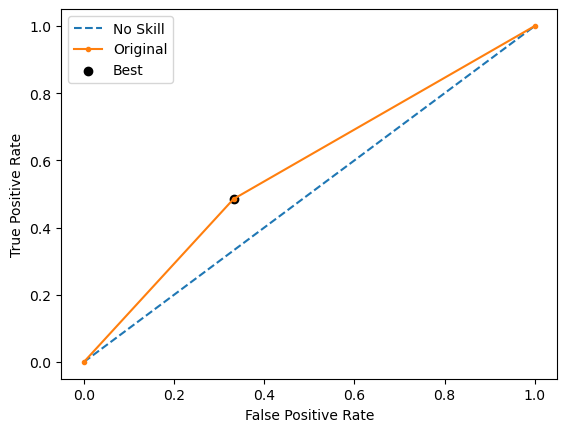

Ave Test G-mean: 0.6007085197444804
Stdev Test G-mean: 0.03317467828983022
Ave Test Specificity: 0.6227722772277228
Ave Test Recall: 0.5818181818181818
Ave Test NPV: 0.8205256201522573
Ave Test Accuracy: 0.612686567164179
Ave Test Precision: 0.33492771509193225
Ave Test F1-Score: 0.4246158231831788
Ave Runtime: 0.3203893184661865


In [27]:
ho_t02_adaboost_gs, ho_t02_adaboost_be, ho_t02_adaboost_model_info, ho_t02_adaboost_metrics_df = adaboost_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002991 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1229
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -

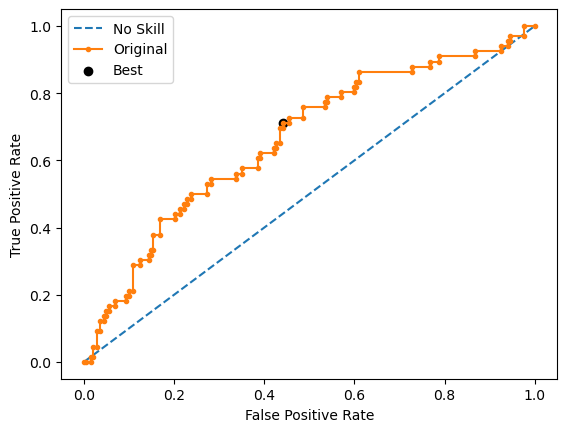

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001578 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1192
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

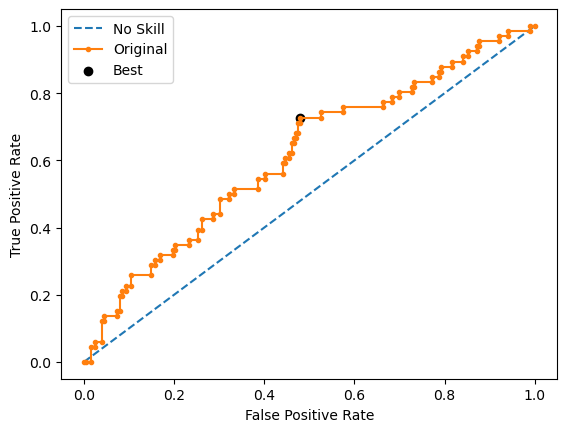

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1179
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with 

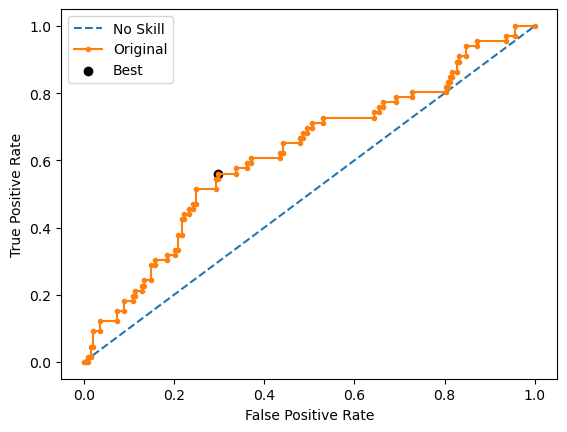

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1181
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with 

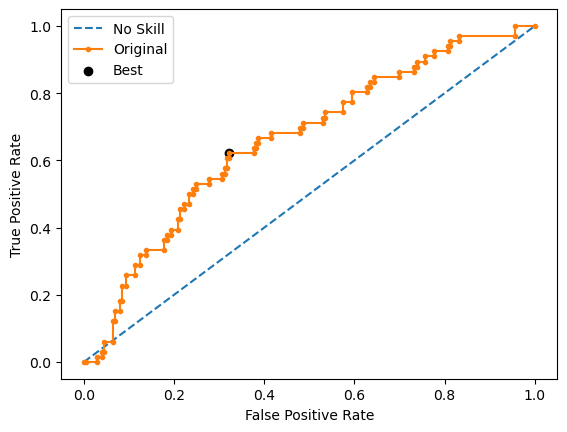

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001590 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1220
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with 

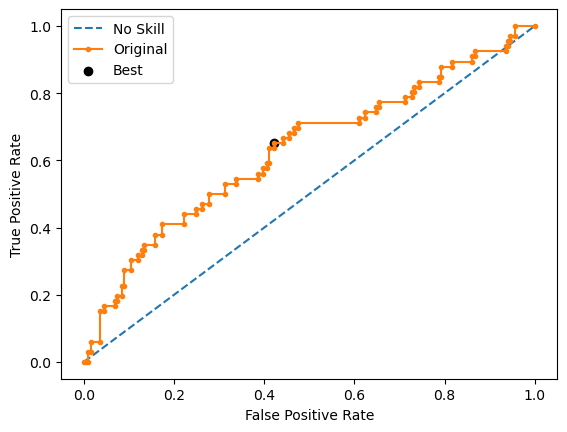

Ave Test G-mean: 0.6120517331425519
Stdev Test G-mean: 0.022365618348073785
Ave Test Specificity: 0.6841584158415842
Ave Test Recall: 0.5484848484848485
Ave Test NPV: 0.8227498247693509
Ave Test Accuracy: 0.6507462686567165
Ave Test Precision: 0.3623357317956324
Ave Test F1-Score: 0.4360214917185389
Ave Runtime: 0.24807348251342773


In [28]:
ho_t02_lgbm_gs, ho_t02_lgbm_be, ho_t02_lgbm_model_info, ho_t02_lgbm_metrics_df = lgbm_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6923329	total: 138ms	remaining: 2m 18s
1:	learn: 0.6914467	total: 140ms	remaining: 1m 9s
2:	learn: 0.6904828	total: 142ms	remaining: 47.1s
3:	learn: 0.6894069	total: 144ms	remaining: 35.8s
4:	learn: 0.6886410	total: 146ms	remaining: 29s
5:	learn: 0.6877865	total: 147ms	remaining: 24.4s
6:	learn: 0.6871926	total: 150ms	remaining: 21.2s
7:	learn: 0.6864858	total: 152ms	remaining: 18.8s
8:	learn: 0.6857214	total: 153ms	remaining: 16.9s
9:	learn: 0.6840348	total: 155ms	remaining: 15.4s
10:	learn: 0.6829774	total: 157ms	remaining: 14.1s
11:	learn: 0.6824786	total: 159ms	remaining: 13.1s
12:	learn: 0.6818888	total: 161ms	remaining: 12.2s
13:	learn: 0.6810332	total: 162ms	remaining: 11.4s
14:	learn: 0.6803911	total: 164ms	remaining: 10.8s
15:	learn: 0.6797754	total: 166ms	remaining: 10.2s
16:	learn: 0.6783844	total: 168ms	remaining: 9.71s
17:	learn: 0.6778408	total: 170ms	remaining: 9.25s
18

253:	learn: 0.5064594	total: 609ms	remaining: 1.79s
254:	learn: 0.5059235	total: 611ms	remaining: 1.78s
255:	learn: 0.5054172	total: 613ms	remaining: 1.78s
256:	learn: 0.5048955	total: 615ms	remaining: 1.78s
257:	learn: 0.5043567	total: 617ms	remaining: 1.77s
258:	learn: 0.5037059	total: 619ms	remaining: 1.77s
259:	learn: 0.5027501	total: 621ms	remaining: 1.77s
260:	learn: 0.5021805	total: 622ms	remaining: 1.76s
261:	learn: 0.5016734	total: 624ms	remaining: 1.76s
262:	learn: 0.5012207	total: 626ms	remaining: 1.75s
263:	learn: 0.5006896	total: 628ms	remaining: 1.75s
264:	learn: 0.5001459	total: 630ms	remaining: 1.75s
265:	learn: 0.4995624	total: 632ms	remaining: 1.74s
266:	learn: 0.4990482	total: 634ms	remaining: 1.74s
267:	learn: 0.4984862	total: 636ms	remaining: 1.74s
268:	learn: 0.4978442	total: 638ms	remaining: 1.73s
269:	learn: 0.4969311	total: 640ms	remaining: 1.73s
270:	learn: 0.4966666	total: 642ms	remaining: 1.73s
271:	learn: 0.4964724	total: 644ms	remaining: 1.72s
272:	learn: 

467:	learn: 0.4088945	total: 1.01s	remaining: 1.15s
468:	learn: 0.4084530	total: 1.01s	remaining: 1.15s
469:	learn: 0.4081202	total: 1.01s	remaining: 1.14s
470:	learn: 0.4079668	total: 1.01s	remaining: 1.14s
471:	learn: 0.4075228	total: 1.02s	remaining: 1.14s
472:	learn: 0.4070230	total: 1.02s	remaining: 1.13s
473:	learn: 0.4062687	total: 1.02s	remaining: 1.13s
474:	learn: 0.4057403	total: 1.02s	remaining: 1.13s
475:	learn: 0.4054101	total: 1.02s	remaining: 1.13s
476:	learn: 0.4052233	total: 1.02s	remaining: 1.12s
477:	learn: 0.4049876	total: 1.03s	remaining: 1.12s
478:	learn: 0.4045308	total: 1.03s	remaining: 1.12s
479:	learn: 0.4039114	total: 1.03s	remaining: 1.12s
480:	learn: 0.4033324	total: 1.03s	remaining: 1.11s
481:	learn: 0.4030430	total: 1.03s	remaining: 1.11s
482:	learn: 0.4026584	total: 1.04s	remaining: 1.11s
483:	learn: 0.4023043	total: 1.04s	remaining: 1.11s
484:	learn: 0.4019654	total: 1.04s	remaining: 1.1s
485:	learn: 0.4015137	total: 1.04s	remaining: 1.1s
486:	learn: 0.

676:	learn: 0.3376873	total: 1.4s	remaining: 666ms
677:	learn: 0.3374028	total: 1.4s	remaining: 664ms
678:	learn: 0.3369940	total: 1.4s	remaining: 662ms
679:	learn: 0.3367246	total: 1.4s	remaining: 659ms
680:	learn: 0.3364632	total: 1.4s	remaining: 657ms
681:	learn: 0.3359899	total: 1.41s	remaining: 655ms
682:	learn: 0.3356506	total: 1.41s	remaining: 653ms
683:	learn: 0.3355459	total: 1.41s	remaining: 651ms
684:	learn: 0.3353501	total: 1.41s	remaining: 649ms
685:	learn: 0.3349466	total: 1.41s	remaining: 647ms
686:	learn: 0.3347703	total: 1.41s	remaining: 645ms
687:	learn: 0.3344319	total: 1.42s	remaining: 642ms
688:	learn: 0.3339392	total: 1.42s	remaining: 640ms
689:	learn: 0.3335765	total: 1.42s	remaining: 638ms
690:	learn: 0.3333226	total: 1.42s	remaining: 636ms
691:	learn: 0.3332096	total: 1.42s	remaining: 634ms
692:	learn: 0.3329625	total: 1.43s	remaining: 632ms
693:	learn: 0.3327065	total: 1.43s	remaining: 630ms
694:	learn: 0.3322713	total: 1.43s	remaining: 627ms
695:	learn: 0.332

894:	learn: 0.2719402	total: 1.8s	remaining: 211ms
895:	learn: 0.2718038	total: 1.8s	remaining: 209ms
896:	learn: 0.2713276	total: 1.8s	remaining: 207ms
897:	learn: 0.2708154	total: 1.8s	remaining: 205ms
898:	learn: 0.2704690	total: 1.8s	remaining: 203ms
899:	learn: 0.2702021	total: 1.81s	remaining: 201ms
900:	learn: 0.2697976	total: 1.81s	remaining: 199ms
901:	learn: 0.2695192	total: 1.81s	remaining: 197ms
902:	learn: 0.2693177	total: 1.81s	remaining: 195ms
903:	learn: 0.2691361	total: 1.81s	remaining: 193ms
904:	learn: 0.2687376	total: 1.82s	remaining: 191ms
905:	learn: 0.2684609	total: 1.82s	remaining: 189ms
906:	learn: 0.2682296	total: 1.82s	remaining: 187ms
907:	learn: 0.2678171	total: 1.82s	remaining: 185ms
908:	learn: 0.2674658	total: 1.82s	remaining: 183ms
909:	learn: 0.2671814	total: 1.83s	remaining: 181ms
910:	learn: 0.2669722	total: 1.83s	remaining: 179ms
911:	learn: 0.2667118	total: 1.83s	remaining: 177ms
912:	learn: 0.2664050	total: 1.83s	remaining: 175ms
913:	learn: 0.266

82:	learn: 0.6177224	total: 154ms	remaining: 1.7s
83:	learn: 0.6172661	total: 156ms	remaining: 1.71s
84:	learn: 0.6163619	total: 158ms	remaining: 1.7s
85:	learn: 0.6155227	total: 160ms	remaining: 1.7s
86:	learn: 0.6148725	total: 162ms	remaining: 1.7s
87:	learn: 0.6141248	total: 164ms	remaining: 1.7s
88:	learn: 0.6135123	total: 166ms	remaining: 1.69s
89:	learn: 0.6128559	total: 168ms	remaining: 1.69s
90:	learn: 0.6121361	total: 170ms	remaining: 1.69s
91:	learn: 0.6110660	total: 171ms	remaining: 1.69s
92:	learn: 0.6107693	total: 173ms	remaining: 1.69s
93:	learn: 0.6100713	total: 175ms	remaining: 1.69s
94:	learn: 0.6094077	total: 177ms	remaining: 1.69s
95:	learn: 0.6087701	total: 179ms	remaining: 1.68s
96:	learn: 0.6081225	total: 181ms	remaining: 1.68s
97:	learn: 0.6071882	total: 182ms	remaining: 1.68s
98:	learn: 0.6063006	total: 185ms	remaining: 1.68s
99:	learn: 0.6051098	total: 187ms	remaining: 1.68s
100:	learn: 0.6041946	total: 189ms	remaining: 1.68s
101:	learn: 0.6032389	total: 190ms	

289:	learn: 0.4880648	total: 540ms	remaining: 1.32s
290:	learn: 0.4875315	total: 542ms	remaining: 1.32s
291:	learn: 0.4868925	total: 543ms	remaining: 1.32s
292:	learn: 0.4861699	total: 545ms	remaining: 1.31s
293:	learn: 0.4856402	total: 547ms	remaining: 1.31s
294:	learn: 0.4853300	total: 549ms	remaining: 1.31s
295:	learn: 0.4846859	total: 550ms	remaining: 1.31s
296:	learn: 0.4841560	total: 552ms	remaining: 1.31s
297:	learn: 0.4837470	total: 554ms	remaining: 1.3s
298:	learn: 0.4830408	total: 556ms	remaining: 1.3s
299:	learn: 0.4825813	total: 558ms	remaining: 1.3s
300:	learn: 0.4815310	total: 559ms	remaining: 1.3s
301:	learn: 0.4812348	total: 561ms	remaining: 1.3s
302:	learn: 0.4807592	total: 563ms	remaining: 1.29s
303:	learn: 0.4801391	total: 565ms	remaining: 1.29s
304:	learn: 0.4795606	total: 566ms	remaining: 1.29s
305:	learn: 0.4788787	total: 568ms	remaining: 1.29s
306:	learn: 0.4783514	total: 570ms	remaining: 1.29s
307:	learn: 0.4777194	total: 572ms	remaining: 1.28s
308:	learn: 0.477

505:	learn: 0.3945117	total: 930ms	remaining: 908ms
506:	learn: 0.3941070	total: 932ms	remaining: 906ms
507:	learn: 0.3935844	total: 934ms	remaining: 904ms
508:	learn: 0.3932300	total: 936ms	remaining: 902ms
509:	learn: 0.3929126	total: 937ms	remaining: 901ms
510:	learn: 0.3926854	total: 939ms	remaining: 899ms
511:	learn: 0.3920260	total: 941ms	remaining: 897ms
512:	learn: 0.3915282	total: 943ms	remaining: 895ms
513:	learn: 0.3909043	total: 945ms	remaining: 893ms
514:	learn: 0.3904389	total: 947ms	remaining: 892ms
515:	learn: 0.3902850	total: 949ms	remaining: 890ms
516:	learn: 0.3900236	total: 950ms	remaining: 888ms
517:	learn: 0.3898104	total: 952ms	remaining: 886ms
518:	learn: 0.3896756	total: 954ms	remaining: 884ms
519:	learn: 0.3893899	total: 955ms	remaining: 882ms
520:	learn: 0.3889912	total: 957ms	remaining: 880ms
521:	learn: 0.3886706	total: 959ms	remaining: 878ms
522:	learn: 0.3882399	total: 961ms	remaining: 876ms
523:	learn: 0.3878191	total: 963ms	remaining: 875ms
524:	learn: 

722:	learn: 0.3245206	total: 1.32s	remaining: 506ms
723:	learn: 0.3243237	total: 1.32s	remaining: 504ms
724:	learn: 0.3237947	total: 1.32s	remaining: 502ms
725:	learn: 0.3233842	total: 1.33s	remaining: 501ms
726:	learn: 0.3232369	total: 1.33s	remaining: 499ms
727:	learn: 0.3231155	total: 1.33s	remaining: 497ms
728:	learn: 0.3230046	total: 1.33s	remaining: 495ms
729:	learn: 0.3223493	total: 1.33s	remaining: 493ms
730:	learn: 0.3218981	total: 1.33s	remaining: 491ms
731:	learn: 0.3215422	total: 1.34s	remaining: 490ms
732:	learn: 0.3211834	total: 1.34s	remaining: 488ms
733:	learn: 0.3209745	total: 1.34s	remaining: 486ms
734:	learn: 0.3208704	total: 1.34s	remaining: 484ms
735:	learn: 0.3203411	total: 1.34s	remaining: 482ms
736:	learn: 0.3200621	total: 1.35s	remaining: 480ms
737:	learn: 0.3199194	total: 1.35s	remaining: 479ms
738:	learn: 0.3196434	total: 1.35s	remaining: 477ms
739:	learn: 0.3194967	total: 1.35s	remaining: 475ms
740:	learn: 0.3193347	total: 1.35s	remaining: 473ms
741:	learn: 

940:	learn: 0.2578364	total: 1.71s	remaining: 107ms
941:	learn: 0.2574854	total: 1.71s	remaining: 106ms
942:	learn: 0.2571175	total: 1.72s	remaining: 104ms
943:	learn: 0.2567217	total: 1.72s	remaining: 102ms
944:	learn: 0.2563293	total: 1.72s	remaining: 100ms
945:	learn: 0.2560899	total: 1.72s	remaining: 98.3ms
946:	learn: 0.2559285	total: 1.72s	remaining: 96.4ms
947:	learn: 0.2554412	total: 1.72s	remaining: 94.6ms
948:	learn: 0.2551347	total: 1.73s	remaining: 92.8ms
949:	learn: 0.2547049	total: 1.73s	remaining: 90.9ms
950:	learn: 0.2543392	total: 1.73s	remaining: 89.1ms
951:	learn: 0.2542181	total: 1.73s	remaining: 87.3ms
952:	learn: 0.2540732	total: 1.73s	remaining: 85.5ms
953:	learn: 0.2537519	total: 1.74s	remaining: 83.7ms
954:	learn: 0.2536147	total: 1.74s	remaining: 81.8ms
955:	learn: 0.2533395	total: 1.74s	remaining: 80ms
956:	learn: 0.2529786	total: 1.74s	remaining: 78.2ms
957:	learn: 0.2526749	total: 1.74s	remaining: 76.4ms
958:	learn: 0.2523158	total: 1.74s	remaining: 74.6ms


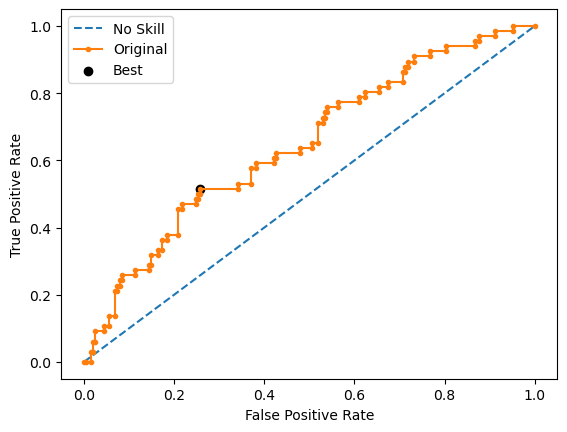

Learning rate set to 0.006922
0:	learn: 0.6921878	total: 2.15ms	remaining: 2.15s
1:	learn: 0.6910493	total: 4.09ms	remaining: 2.04s
2:	learn: 0.6894596	total: 6.01ms	remaining: 2s
3:	learn: 0.6884964	total: 7.71ms	remaining: 1.92s
4:	learn: 0.6875721	total: 9.5ms	remaining: 1.89s
5:	learn: 0.6860080	total: 11.3ms	remaining: 1.87s
6:	learn: 0.6849548	total: 13.2ms	remaining: 1.88s
7:	learn: 0.6836161	total: 15.1ms	remaining: 1.87s
8:	learn: 0.6822972	total: 16.8ms	remaining: 1.85s
9:	learn: 0.6809731	total: 18.6ms	remaining: 1.84s
10:	learn: 0.6797344	total: 20.3ms	remaining: 1.83s
11:	learn: 0.6791753	total: 22.2ms	remaining: 1.83s
12:	learn: 0.6782591	total: 24ms	remaining: 1.82s
13:	learn: 0.6768259	total: 25.7ms	remaining: 1.81s
14:	learn: 0.6759321	total: 27.4ms	remaining: 1.8s
15:	learn: 0.6751470	total: 29.4ms	remaining: 1.8s
16:	learn: 0.6739414	total: 31.1ms	remaining: 1.8s
17:	learn: 0.6728482	total: 33ms	remaining: 1.8s
18:	learn: 0.6718091	total: 34.6ms	remaining: 1.79s
19:	

196:	learn: 0.5292756	total: 390ms	remaining: 1.59s
197:	learn: 0.5287443	total: 392ms	remaining: 1.59s
198:	learn: 0.5281955	total: 394ms	remaining: 1.58s
199:	learn: 0.5278592	total: 396ms	remaining: 1.58s
200:	learn: 0.5270804	total: 398ms	remaining: 1.58s
201:	learn: 0.5266721	total: 400ms	remaining: 1.58s
202:	learn: 0.5260117	total: 402ms	remaining: 1.58s
203:	learn: 0.5253722	total: 404ms	remaining: 1.58s
204:	learn: 0.5245498	total: 407ms	remaining: 1.58s
205:	learn: 0.5236604	total: 409ms	remaining: 1.58s
206:	learn: 0.5233728	total: 411ms	remaining: 1.57s
207:	learn: 0.5227986	total: 413ms	remaining: 1.57s
208:	learn: 0.5223154	total: 414ms	remaining: 1.57s
209:	learn: 0.5215840	total: 416ms	remaining: 1.56s
210:	learn: 0.5206643	total: 418ms	remaining: 1.56s
211:	learn: 0.5197101	total: 420ms	remaining: 1.56s
212:	learn: 0.5191730	total: 422ms	remaining: 1.56s
213:	learn: 0.5184046	total: 424ms	remaining: 1.56s
214:	learn: 0.5181369	total: 426ms	remaining: 1.55s
215:	learn: 

403:	learn: 0.4288995	total: 779ms	remaining: 1.15s
404:	learn: 0.4284539	total: 781ms	remaining: 1.15s
405:	learn: 0.4282832	total: 783ms	remaining: 1.15s
406:	learn: 0.4281219	total: 785ms	remaining: 1.14s
407:	learn: 0.4277583	total: 787ms	remaining: 1.14s
408:	learn: 0.4275259	total: 788ms	remaining: 1.14s
409:	learn: 0.4273260	total: 790ms	remaining: 1.14s
410:	learn: 0.4265220	total: 792ms	remaining: 1.14s
411:	learn: 0.4256045	total: 794ms	remaining: 1.13s
412:	learn: 0.4249994	total: 796ms	remaining: 1.13s
413:	learn: 0.4247396	total: 798ms	remaining: 1.13s
414:	learn: 0.4241542	total: 800ms	remaining: 1.13s
415:	learn: 0.4239295	total: 802ms	remaining: 1.13s
416:	learn: 0.4235707	total: 804ms	remaining: 1.12s
417:	learn: 0.4231387	total: 806ms	remaining: 1.12s
418:	learn: 0.4223612	total: 808ms	remaining: 1.12s
419:	learn: 0.4214745	total: 810ms	remaining: 1.12s
420:	learn: 0.4212452	total: 811ms	remaining: 1.11s
421:	learn: 0.4210200	total: 813ms	remaining: 1.11s
422:	learn: 

610:	learn: 0.3539475	total: 1.17s	remaining: 745ms
611:	learn: 0.3537838	total: 1.17s	remaining: 743ms
612:	learn: 0.3534725	total: 1.17s	remaining: 741ms
613:	learn: 0.3532304	total: 1.18s	remaining: 739ms
614:	learn: 0.3530772	total: 1.18s	remaining: 737ms
615:	learn: 0.3528745	total: 1.18s	remaining: 735ms
616:	learn: 0.3524676	total: 1.18s	remaining: 733ms
617:	learn: 0.3521429	total: 1.18s	remaining: 731ms
618:	learn: 0.3519719	total: 1.19s	remaining: 729ms
619:	learn: 0.3517827	total: 1.19s	remaining: 728ms
620:	learn: 0.3516766	total: 1.19s	remaining: 726ms
621:	learn: 0.3514004	total: 1.19s	remaining: 723ms
622:	learn: 0.3510595	total: 1.19s	remaining: 721ms
623:	learn: 0.3507555	total: 1.19s	remaining: 720ms
624:	learn: 0.3504025	total: 1.2s	remaining: 718ms
625:	learn: 0.3502368	total: 1.2s	remaining: 716ms
626:	learn: 0.3500120	total: 1.2s	remaining: 714ms
627:	learn: 0.3494654	total: 1.2s	remaining: 712ms
628:	learn: 0.3493837	total: 1.2s	remaining: 710ms
629:	learn: 0.348

822:	learn: 0.2940911	total: 1.56s	remaining: 335ms
823:	learn: 0.2938957	total: 1.56s	remaining: 334ms
824:	learn: 0.2937653	total: 1.56s	remaining: 332ms
825:	learn: 0.2933776	total: 1.56s	remaining: 330ms
826:	learn: 0.2931498	total: 1.57s	remaining: 328ms
827:	learn: 0.2924999	total: 1.57s	remaining: 326ms
828:	learn: 0.2922333	total: 1.57s	remaining: 324ms
829:	learn: 0.2919345	total: 1.57s	remaining: 322ms
830:	learn: 0.2917164	total: 1.57s	remaining: 320ms
831:	learn: 0.2913581	total: 1.57s	remaining: 318ms
832:	learn: 0.2910305	total: 1.58s	remaining: 316ms
833:	learn: 0.2907512	total: 1.58s	remaining: 314ms
834:	learn: 0.2905243	total: 1.58s	remaining: 312ms
835:	learn: 0.2903448	total: 1.58s	remaining: 310ms
836:	learn: 0.2900235	total: 1.58s	remaining: 309ms
837:	learn: 0.2898423	total: 1.59s	remaining: 307ms
838:	learn: 0.2895303	total: 1.59s	remaining: 305ms
839:	learn: 0.2893219	total: 1.59s	remaining: 303ms
840:	learn: 0.2891742	total: 1.59s	remaining: 301ms
841:	learn: 

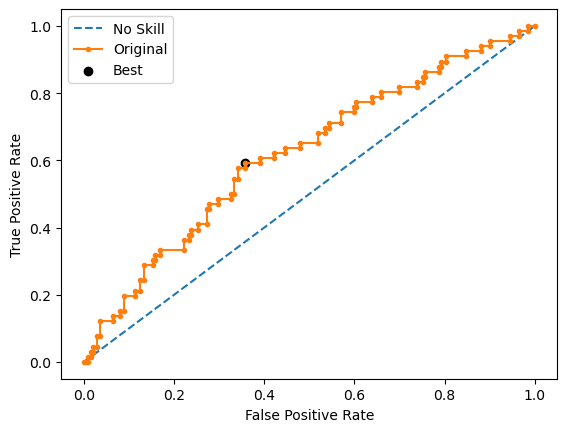

Learning rate set to 0.006922
0:	learn: 0.6921809	total: 2.41ms	remaining: 2.41s
1:	learn: 0.6906403	total: 4.43ms	remaining: 2.21s
2:	learn: 0.6894654	total: 6.18ms	remaining: 2.05s
3:	learn: 0.6880949	total: 7.86ms	remaining: 1.96s
4:	learn: 0.6868583	total: 9.78ms	remaining: 1.95s
5:	learn: 0.6856035	total: 11.7ms	remaining: 1.93s
6:	learn: 0.6842847	total: 13.3ms	remaining: 1.89s
7:	learn: 0.6833575	total: 15.2ms	remaining: 1.89s
8:	learn: 0.6822345	total: 17.5ms	remaining: 1.93s
9:	learn: 0.6808964	total: 19.2ms	remaining: 1.9s
10:	learn: 0.6796967	total: 21.1ms	remaining: 1.89s
11:	learn: 0.6787372	total: 22.8ms	remaining: 1.88s
12:	learn: 0.6781517	total: 24.6ms	remaining: 1.87s
13:	learn: 0.6767399	total: 26.6ms	remaining: 1.87s
14:	learn: 0.6757106	total: 28.4ms	remaining: 1.86s
15:	learn: 0.6745015	total: 30.1ms	remaining: 1.85s
16:	learn: 0.6732951	total: 31.8ms	remaining: 1.84s
17:	learn: 0.6715646	total: 33.6ms	remaining: 1.83s
18:	learn: 0.6707174	total: 35.3ms	remaining:

216:	learn: 0.5105993	total: 393ms	remaining: 1.42s
217:	learn: 0.5103788	total: 395ms	remaining: 1.42s
218:	learn: 0.5099746	total: 397ms	remaining: 1.42s
219:	learn: 0.5089161	total: 399ms	remaining: 1.41s
220:	learn: 0.5082289	total: 401ms	remaining: 1.41s
221:	learn: 0.5077904	total: 402ms	remaining: 1.41s
222:	learn: 0.5075807	total: 404ms	remaining: 1.41s
223:	learn: 0.5070901	total: 406ms	remaining: 1.41s
224:	learn: 0.5066167	total: 408ms	remaining: 1.4s
225:	learn: 0.5060554	total: 410ms	remaining: 1.4s
226:	learn: 0.5054908	total: 412ms	remaining: 1.4s
227:	learn: 0.5051645	total: 413ms	remaining: 1.4s
228:	learn: 0.5045471	total: 415ms	remaining: 1.4s
229:	learn: 0.5044043	total: 417ms	remaining: 1.4s
230:	learn: 0.5036635	total: 418ms	remaining: 1.39s
231:	learn: 0.5033152	total: 420ms	remaining: 1.39s
232:	learn: 0.5028200	total: 422ms	remaining: 1.39s
233:	learn: 0.5024929	total: 423ms	remaining: 1.39s
234:	learn: 0.5020314	total: 425ms	remaining: 1.38s
235:	learn: 0.5015

430:	learn: 0.4134701	total: 785ms	remaining: 1.03s
431:	learn: 0.4131758	total: 787ms	remaining: 1.03s
432:	learn: 0.4127836	total: 789ms	remaining: 1.03s
433:	learn: 0.4123284	total: 791ms	remaining: 1.03s
434:	learn: 0.4120909	total: 793ms	remaining: 1.03s
435:	learn: 0.4117662	total: 794ms	remaining: 1.03s
436:	learn: 0.4115379	total: 797ms	remaining: 1.03s
437:	learn: 0.4112542	total: 799ms	remaining: 1.02s
438:	learn: 0.4109804	total: 801ms	remaining: 1.02s
439:	learn: 0.4107732	total: 803ms	remaining: 1.02s
440:	learn: 0.4103903	total: 804ms	remaining: 1.02s
441:	learn: 0.4100793	total: 806ms	remaining: 1.02s
442:	learn: 0.4095231	total: 808ms	remaining: 1.01s
443:	learn: 0.4093125	total: 809ms	remaining: 1.01s
444:	learn: 0.4091025	total: 811ms	remaining: 1.01s
445:	learn: 0.4085657	total: 813ms	remaining: 1.01s
446:	learn: 0.4082260	total: 815ms	remaining: 1.01s
447:	learn: 0.4079314	total: 817ms	remaining: 1.01s
448:	learn: 0.4076785	total: 819ms	remaining: 1s
449:	learn: 0.4

640:	learn: 0.3410373	total: 1.17s	remaining: 658ms
641:	learn: 0.3405488	total: 1.18s	remaining: 656ms
642:	learn: 0.3403111	total: 1.18s	remaining: 654ms
643:	learn: 0.3399778	total: 1.18s	remaining: 653ms
644:	learn: 0.3398850	total: 1.18s	remaining: 651ms
645:	learn: 0.3395469	total: 1.18s	remaining: 649ms
646:	learn: 0.3391737	total: 1.19s	remaining: 647ms
647:	learn: 0.3388951	total: 1.19s	remaining: 646ms
648:	learn: 0.3383614	total: 1.19s	remaining: 644ms
649:	learn: 0.3378358	total: 1.19s	remaining: 642ms
650:	learn: 0.3376231	total: 1.19s	remaining: 640ms
651:	learn: 0.3374092	total: 1.2s	remaining: 639ms
652:	learn: 0.3371951	total: 1.2s	remaining: 637ms
653:	learn: 0.3369439	total: 1.2s	remaining: 635ms
654:	learn: 0.3367397	total: 1.2s	remaining: 633ms
655:	learn: 0.3363300	total: 1.2s	remaining: 631ms
656:	learn: 0.3360168	total: 1.21s	remaining: 630ms
657:	learn: 0.3359050	total: 1.21s	remaining: 628ms
658:	learn: 0.3357787	total: 1.21s	remaining: 626ms
659:	learn: 0.335

817:	learn: 0.2889764	total: 1.57s	remaining: 350ms
818:	learn: 0.2888882	total: 1.57s	remaining: 348ms
819:	learn: 0.2887193	total: 1.58s	remaining: 346ms
820:	learn: 0.2883411	total: 1.58s	remaining: 344ms
821:	learn: 0.2881290	total: 1.58s	remaining: 342ms
822:	learn: 0.2880329	total: 1.58s	remaining: 340ms
823:	learn: 0.2878649	total: 1.58s	remaining: 338ms
824:	learn: 0.2877163	total: 1.59s	remaining: 337ms
825:	learn: 0.2874236	total: 1.59s	remaining: 335ms
826:	learn: 0.2868831	total: 1.59s	remaining: 333ms
827:	learn: 0.2867192	total: 1.59s	remaining: 331ms
828:	learn: 0.2862975	total: 1.59s	remaining: 329ms
829:	learn: 0.2861398	total: 1.6s	remaining: 327ms
830:	learn: 0.2857824	total: 1.6s	remaining: 325ms
831:	learn: 0.2853003	total: 1.6s	remaining: 323ms
832:	learn: 0.2851193	total: 1.6s	remaining: 321ms
833:	learn: 0.2849394	total: 1.6s	remaining: 319ms
834:	learn: 0.2848380	total: 1.61s	remaining: 317ms
835:	learn: 0.2845764	total: 1.61s	remaining: 315ms
836:	learn: 0.284

Run 3 - Random State: 2
Test G-mean: 0.599842463566985
Best Threshold=0.515909, G-Mean=0.613


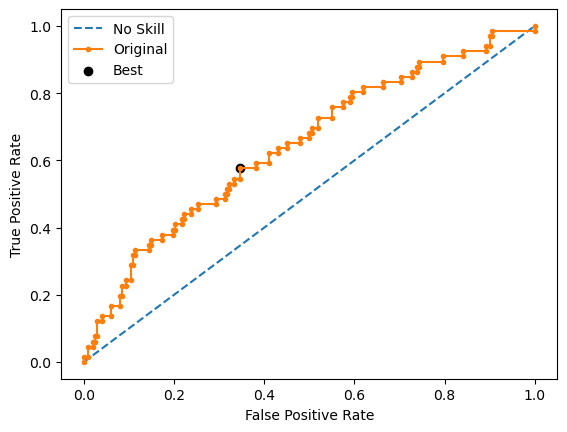

Learning rate set to 0.006922
0:	learn: 0.6921883	total: 5.78ms	remaining: 5.77s
1:	learn: 0.6904994	total: 11.3ms	remaining: 5.65s
2:	learn: 0.6895716	total: 15.7ms	remaining: 5.21s
3:	learn: 0.6885880	total: 19.6ms	remaining: 4.87s
4:	learn: 0.6873471	total: 22.3ms	remaining: 4.43s
5:	learn: 0.6862402	total: 25.3ms	remaining: 4.2s
6:	learn: 0.6850183	total: 29.5ms	remaining: 4.19s
7:	learn: 0.6839012	total: 33.5ms	remaining: 4.16s
8:	learn: 0.6825891	total: 37.2ms	remaining: 4.1s
9:	learn: 0.6813182	total: 40.8ms	remaining: 4.04s
10:	learn: 0.6805077	total: 43.6ms	remaining: 3.92s
11:	learn: 0.6793731	total: 45.2ms	remaining: 3.73s
12:	learn: 0.6787047	total: 47.7ms	remaining: 3.62s
13:	learn: 0.6779723	total: 50.1ms	remaining: 3.53s
14:	learn: 0.6768699	total: 52ms	remaining: 3.41s
15:	learn: 0.6761020	total: 54ms	remaining: 3.32s
16:	learn: 0.6748737	total: 56.5ms	remaining: 3.26s
17:	learn: 0.6734674	total: 58.3ms	remaining: 3.18s
18:	learn: 0.6725041	total: 60.1ms	remaining: 3.1s

185:	learn: 0.5434178	total: 396ms	remaining: 1.73s
186:	learn: 0.5430233	total: 398ms	remaining: 1.73s
187:	learn: 0.5426294	total: 400ms	remaining: 1.73s
188:	learn: 0.5423180	total: 402ms	remaining: 1.72s
189:	learn: 0.5411034	total: 404ms	remaining: 1.72s
190:	learn: 0.5406871	total: 406ms	remaining: 1.72s
191:	learn: 0.5400037	total: 408ms	remaining: 1.72s
192:	learn: 0.5395085	total: 410ms	remaining: 1.72s
193:	learn: 0.5390020	total: 412ms	remaining: 1.71s
194:	learn: 0.5381722	total: 415ms	remaining: 1.71s
195:	learn: 0.5375054	total: 417ms	remaining: 1.71s
196:	learn: 0.5365171	total: 419ms	remaining: 1.71s
197:	learn: 0.5357746	total: 421ms	remaining: 1.7s
198:	learn: 0.5352973	total: 422ms	remaining: 1.7s
199:	learn: 0.5349753	total: 425ms	remaining: 1.7s
200:	learn: 0.5347181	total: 427ms	remaining: 1.7s
201:	learn: 0.5338787	total: 429ms	remaining: 1.7s
202:	learn: 0.5332604	total: 432ms	remaining: 1.69s
203:	learn: 0.5321670	total: 434ms	remaining: 1.69s
204:	learn: 0.531

377:	learn: 0.4487075	total: 797ms	remaining: 1.31s
378:	learn: 0.4481827	total: 800ms	remaining: 1.31s
379:	learn: 0.4476501	total: 803ms	remaining: 1.31s
380:	learn: 0.4473939	total: 806ms	remaining: 1.31s
381:	learn: 0.4467833	total: 810ms	remaining: 1.31s
382:	learn: 0.4466260	total: 813ms	remaining: 1.31s
383:	learn: 0.4464140	total: 815ms	remaining: 1.31s
384:	learn: 0.4461656	total: 817ms	remaining: 1.3s
385:	learn: 0.4456646	total: 820ms	remaining: 1.3s
386:	learn: 0.4451149	total: 822ms	remaining: 1.3s
387:	learn: 0.4447554	total: 825ms	remaining: 1.3s
388:	learn: 0.4441708	total: 827ms	remaining: 1.3s
389:	learn: 0.4436513	total: 830ms	remaining: 1.3s
390:	learn: 0.4433388	total: 832ms	remaining: 1.29s
391:	learn: 0.4429188	total: 834ms	remaining: 1.29s
392:	learn: 0.4425898	total: 837ms	remaining: 1.29s
393:	learn: 0.4420951	total: 840ms	remaining: 1.29s
394:	learn: 0.4415843	total: 842ms	remaining: 1.29s
395:	learn: 0.4412361	total: 845ms	remaining: 1.29s
396:	learn: 0.4408

542:	learn: 0.3883248	total: 1.2s	remaining: 1.01s
543:	learn: 0.3879954	total: 1.2s	remaining: 1.01s
544:	learn: 0.3879163	total: 1.21s	remaining: 1.01s
545:	learn: 0.3871633	total: 1.21s	remaining: 1s
546:	learn: 0.3864735	total: 1.21s	remaining: 1s
547:	learn: 0.3859921	total: 1.21s	remaining: 1s
548:	learn: 0.3857945	total: 1.22s	remaining: 999ms
549:	learn: 0.3855652	total: 1.22s	remaining: 997ms
550:	learn: 0.3852588	total: 1.22s	remaining: 995ms
551:	learn: 0.3850153	total: 1.22s	remaining: 993ms
552:	learn: 0.3843294	total: 1.23s	remaining: 991ms
553:	learn: 0.3838852	total: 1.23s	remaining: 989ms
554:	learn: 0.3837342	total: 1.23s	remaining: 986ms
555:	learn: 0.3831957	total: 1.23s	remaining: 984ms
556:	learn: 0.3827704	total: 1.23s	remaining: 981ms
557:	learn: 0.3826711	total: 1.24s	remaining: 979ms
558:	learn: 0.3824218	total: 1.24s	remaining: 977ms
559:	learn: 0.3821918	total: 1.24s	remaining: 975ms
560:	learn: 0.3819431	total: 1.24s	remaining: 973ms
561:	learn: 0.3817140	t

729:	learn: 0.3289207	total: 1.6s	remaining: 591ms
730:	learn: 0.3288131	total: 1.6s	remaining: 589ms
731:	learn: 0.3286502	total: 1.6s	remaining: 587ms
732:	learn: 0.3285880	total: 1.6s	remaining: 585ms
733:	learn: 0.3282893	total: 1.61s	remaining: 583ms
734:	learn: 0.3281067	total: 1.61s	remaining: 580ms
735:	learn: 0.3279533	total: 1.61s	remaining: 578ms
736:	learn: 0.3275311	total: 1.61s	remaining: 576ms
737:	learn: 0.3274609	total: 1.61s	remaining: 574ms
738:	learn: 0.3272162	total: 1.62s	remaining: 571ms
739:	learn: 0.3268137	total: 1.62s	remaining: 569ms
740:	learn: 0.3265483	total: 1.62s	remaining: 567ms
741:	learn: 0.3263501	total: 1.62s	remaining: 565ms
742:	learn: 0.3260894	total: 1.63s	remaining: 563ms
743:	learn: 0.3258713	total: 1.63s	remaining: 561ms
744:	learn: 0.3256455	total: 1.63s	remaining: 558ms
745:	learn: 0.3251370	total: 1.63s	remaining: 556ms
746:	learn: 0.3247800	total: 1.64s	remaining: 554ms
747:	learn: 0.3245273	total: 1.64s	remaining: 552ms
748:	learn: 0.32

913:	learn: 0.2791713	total: 1.99s	remaining: 188ms
914:	learn: 0.2789163	total: 2s	remaining: 185ms
915:	learn: 0.2784937	total: 2s	remaining: 183ms
916:	learn: 0.2782944	total: 2s	remaining: 181ms
917:	learn: 0.2779896	total: 2s	remaining: 179ms
918:	learn: 0.2778565	total: 2s	remaining: 177ms
919:	learn: 0.2777940	total: 2.01s	remaining: 175ms
920:	learn: 0.2774169	total: 2.01s	remaining: 172ms
921:	learn: 0.2769280	total: 2.01s	remaining: 170ms
922:	learn: 0.2766618	total: 2.01s	remaining: 168ms
923:	learn: 0.2761288	total: 2.02s	remaining: 166ms
924:	learn: 0.2756851	total: 2.02s	remaining: 164ms
925:	learn: 0.2753984	total: 2.02s	remaining: 162ms
926:	learn: 0.2752605	total: 2.02s	remaining: 159ms
927:	learn: 0.2749503	total: 2.03s	remaining: 157ms
928:	learn: 0.2747384	total: 2.03s	remaining: 155ms
929:	learn: 0.2744666	total: 2.03s	remaining: 153ms
930:	learn: 0.2742415	total: 2.03s	remaining: 151ms
931:	learn: 0.2738998	total: 2.04s	remaining: 149ms
932:	learn: 0.2734542	total

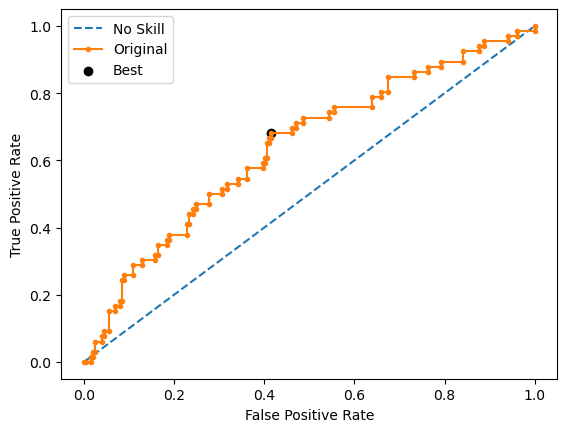

Learning rate set to 0.006922
0:	learn: 0.6922601	total: 4.26ms	remaining: 4.26s
1:	learn: 0.6909232	total: 11.1ms	remaining: 5.53s
2:	learn: 0.6899002	total: 17.3ms	remaining: 5.75s
3:	learn: 0.6889524	total: 23ms	remaining: 5.71s
4:	learn: 0.6879574	total: 28.8ms	remaining: 5.73s
5:	learn: 0.6859248	total: 32.9ms	remaining: 5.45s
6:	learn: 0.6848696	total: 38.2ms	remaining: 5.41s
7:	learn: 0.6835790	total: 43.3ms	remaining: 5.37s
8:	learn: 0.6823333	total: 47.4ms	remaining: 5.21s
9:	learn: 0.6807834	total: 51.2ms	remaining: 5.07s
10:	learn: 0.6796708	total: 55ms	remaining: 4.95s
11:	learn: 0.6784646	total: 58.3ms	remaining: 4.8s
12:	learn: 0.6774212	total: 61.3ms	remaining: 4.65s
13:	learn: 0.6761061	total: 63.3ms	remaining: 4.46s
14:	learn: 0.6749847	total: 65.9ms	remaining: 4.33s
15:	learn: 0.6740852	total: 69.1ms	remaining: 4.25s
16:	learn: 0.6728785	total: 72.1ms	remaining: 4.17s
17:	learn: 0.6712976	total: 73.9ms	remaining: 4.03s
18:	learn: 0.6703444	total: 76.1ms	remaining: 3.9

184:	learn: 0.5395919	total: 386ms	remaining: 1.7s
185:	learn: 0.5391087	total: 388ms	remaining: 1.7s
186:	learn: 0.5379177	total: 390ms	remaining: 1.7s
187:	learn: 0.5370060	total: 392ms	remaining: 1.69s
188:	learn: 0.5362478	total: 394ms	remaining: 1.69s
189:	learn: 0.5354579	total: 395ms	remaining: 1.69s
190:	learn: 0.5347655	total: 397ms	remaining: 1.68s
191:	learn: 0.5342786	total: 399ms	remaining: 1.68s
192:	learn: 0.5337412	total: 401ms	remaining: 1.68s
193:	learn: 0.5329992	total: 403ms	remaining: 1.67s
194:	learn: 0.5317761	total: 405ms	remaining: 1.67s
195:	learn: 0.5311760	total: 407ms	remaining: 1.67s
196:	learn: 0.5306491	total: 408ms	remaining: 1.66s
197:	learn: 0.5300767	total: 410ms	remaining: 1.66s
198:	learn: 0.5296202	total: 412ms	remaining: 1.66s
199:	learn: 0.5293012	total: 414ms	remaining: 1.66s
200:	learn: 0.5288736	total: 416ms	remaining: 1.65s
201:	learn: 0.5284629	total: 418ms	remaining: 1.65s
202:	learn: 0.5279476	total: 420ms	remaining: 1.65s
203:	learn: 0.5

392:	learn: 0.4395048	total: 775ms	remaining: 1.2s
393:	learn: 0.4386888	total: 776ms	remaining: 1.19s
394:	learn: 0.4381195	total: 778ms	remaining: 1.19s
395:	learn: 0.4378972	total: 780ms	remaining: 1.19s
396:	learn: 0.4373356	total: 782ms	remaining: 1.19s
397:	learn: 0.4367039	total: 783ms	remaining: 1.18s
398:	learn: 0.4363884	total: 785ms	remaining: 1.18s
399:	learn: 0.4360694	total: 787ms	remaining: 1.18s
400:	learn: 0.4357844	total: 789ms	remaining: 1.18s
401:	learn: 0.4353256	total: 791ms	remaining: 1.18s
402:	learn: 0.4349643	total: 793ms	remaining: 1.17s
403:	learn: 0.4346470	total: 795ms	remaining: 1.17s
404:	learn: 0.4344834	total: 797ms	remaining: 1.17s
405:	learn: 0.4343536	total: 798ms	remaining: 1.17s
406:	learn: 0.4337196	total: 801ms	remaining: 1.17s
407:	learn: 0.4335540	total: 803ms	remaining: 1.16s
408:	learn: 0.4333527	total: 804ms	remaining: 1.16s
409:	learn: 0.4329768	total: 806ms	remaining: 1.16s
410:	learn: 0.4326912	total: 808ms	remaining: 1.16s
411:	learn: 0

605:	learn: 0.3633896	total: 1.17s	remaining: 762ms
606:	learn: 0.3631554	total: 1.17s	remaining: 760ms
607:	learn: 0.3629683	total: 1.18s	remaining: 758ms
608:	learn: 0.3624762	total: 1.18s	remaining: 756ms
609:	learn: 0.3622597	total: 1.18s	remaining: 754ms
610:	learn: 0.3620295	total: 1.18s	remaining: 752ms
611:	learn: 0.3617787	total: 1.18s	remaining: 750ms
612:	learn: 0.3616043	total: 1.19s	remaining: 748ms
613:	learn: 0.3611465	total: 1.19s	remaining: 746ms
614:	learn: 0.3608989	total: 1.19s	remaining: 744ms
615:	learn: 0.3608167	total: 1.19s	remaining: 742ms
616:	learn: 0.3605219	total: 1.19s	remaining: 740ms
617:	learn: 0.3601456	total: 1.19s	remaining: 738ms
618:	learn: 0.3596950	total: 1.2s	remaining: 736ms
619:	learn: 0.3589971	total: 1.2s	remaining: 734ms
620:	learn: 0.3587104	total: 1.2s	remaining: 732ms
621:	learn: 0.3583527	total: 1.2s	remaining: 730ms
622:	learn: 0.3578497	total: 1.2s	remaining: 728ms
623:	learn: 0.3576416	total: 1.21s	remaining: 726ms
624:	learn: 0.357

813:	learn: 0.2988316	total: 1.56s	remaining: 356ms
814:	learn: 0.2985518	total: 1.56s	remaining: 354ms
815:	learn: 0.2984205	total: 1.56s	remaining: 352ms
816:	learn: 0.2981913	total: 1.56s	remaining: 350ms
817:	learn: 0.2979809	total: 1.56s	remaining: 348ms
818:	learn: 0.2977859	total: 1.57s	remaining: 346ms
819:	learn: 0.2974215	total: 1.57s	remaining: 344ms
820:	learn: 0.2972236	total: 1.57s	remaining: 342ms
821:	learn: 0.2969064	total: 1.57s	remaining: 340ms
822:	learn: 0.2968234	total: 1.57s	remaining: 338ms
823:	learn: 0.2965235	total: 1.57s	remaining: 337ms
824:	learn: 0.2962625	total: 1.58s	remaining: 335ms
825:	learn: 0.2959092	total: 1.58s	remaining: 333ms
826:	learn: 0.2957757	total: 1.58s	remaining: 331ms
827:	learn: 0.2955494	total: 1.58s	remaining: 329ms
828:	learn: 0.2952067	total: 1.58s	remaining: 327ms
829:	learn: 0.2949785	total: 1.59s	remaining: 325ms
830:	learn: 0.2947912	total: 1.59s	remaining: 323ms
831:	learn: 0.2944759	total: 1.59s	remaining: 321ms
832:	learn: 

Best Threshold=0.513182, G-Mean=0.604


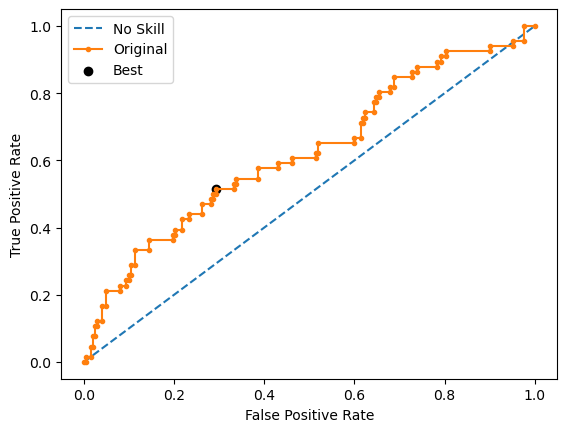

Ave Test G-mean: 0.5971605194673438
Stdev Test G-mean: 0.006121382176301351
Ave Test Specificity: 0.6207920792079208
Ave Test Recall: 0.5757575757575758
Ave Test NPV: 0.8176973117569064
Ave Test Accuracy: 0.6097014925373134
Ave Test Precision: 0.33175582126873066
Ave Test F1-Score: 0.420549919614709
Ave Runtime: 2.1150551795959474


In [29]:
ho_t02_catboost_gs, ho_t02_catboost_be, ho_t02_catboost_model_info, ho_t02_catboost_metrics_df = catboost_class2(ho_t02, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [31]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t02_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t02_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t02_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.625461,0.026161,0.594305,NaN,0.624752,0.627273,0.353527,0.451897,0.625373
7,Extreme Gradient Boosting (XGBoost),0.622618,0.022083,0.592548,0.846407,0.650495,0.596970,0.357998,0.447367,0.637313
4,Random Forest,0.617310,0.032057,0.599838,0.620181,0.656436,0.581818,0.356451,0.441724,0.638060
6,LightGBM,0.612052,0.022366,0.600812,0.736435,0.684158,0.548485,0.362336,0.436021,0.650746
8,AdaBoost,0.600709,0.033175,0.587284,0.942311,0.622772,0.581818,0.334928,0.424616,0.612687
9,CatBoost,0.597161,0.006121,0.581457,0.942990,0.620792,0.575758,0.331756,0.420550,0.609701
5,Gradient Boosting Machine (GBM),0.587710,0.036857,0.574141,0.873161,0.669307,0.518182,0.338459,0.408967,0.632090
2,Logistic Regression,0.582239,0.017399,0.601485,NaN,0.638614,0.533333,0.325947,0.403751,0.612687
0,k-Nearest Neighbors,0.515852,0.035862,0.560274,0.688048,0.476238,0.563636,0.259329,0.354834,0.497761
1,SVM Classifier,0.491628,0.049644,0.555277,0.254625,0.412871,0.639394,0.266711,0.370287,0.468657


In [130]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t02_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.650746,LightGBM
Highest Test G-mean,0.625461,Decision Tree
Highest Test Recall,0.639394,SVM Classifier
Highest Test Precision,0.362336,LightGBM
Highest Test Specificity,0.684158,LightGBM
Highest Test F1-score,0.451897,Decision Tree


In [81]:
# var_df

# HO-T03 Runs

In [80]:
ho_t03.shape, ho_t02.shape

((1070, 51), (1070, 55))

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2132 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.594305156716838
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 65.96702003479004 secs
Run 1 - Random State: 0
Test G-mean: 0.65248952041962
Best Threshold=0.571125, G-Mean=0.652


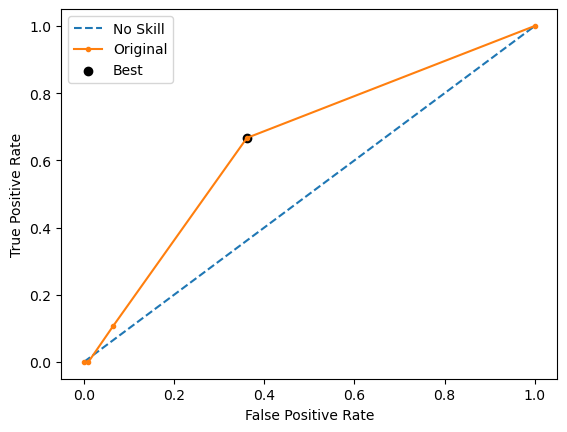

Run 2 - Random State: 1
Test G-mean: 0.6221243475949056
Best Threshold=0.549689, G-Mean=0.622


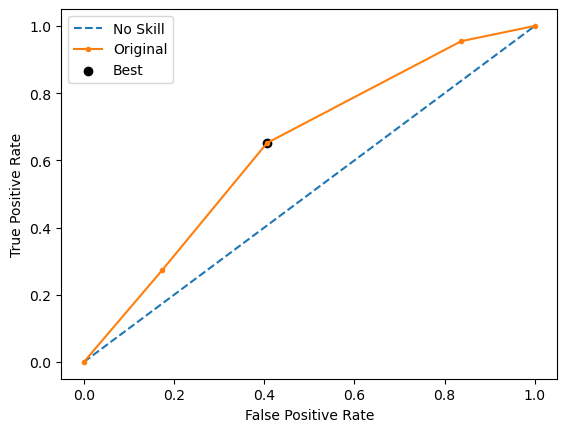

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.575309, G-Mean=0.587


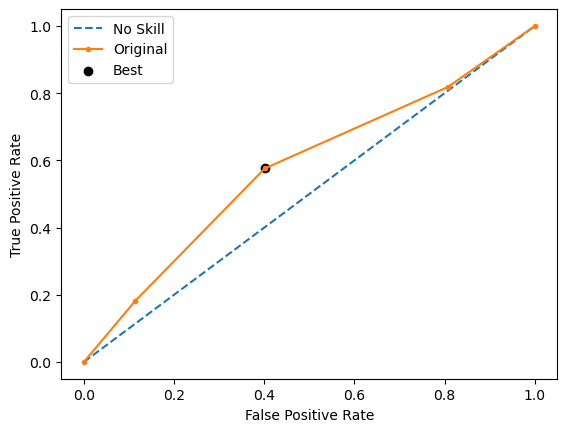

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.567033, G-Mean=0.647


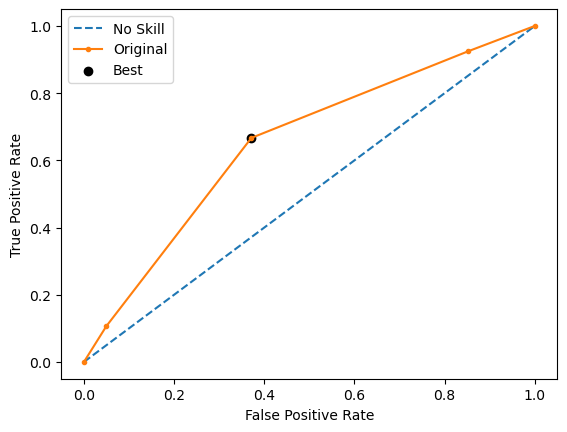

Run 5 - Random State: 4
Test G-mean: 0.6180114835659464
Best Threshold=0.556373, G-Mean=0.618


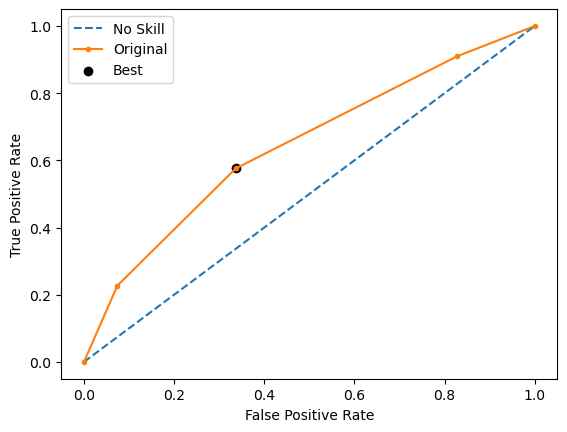

Ave Test G-mean: 0.6254611446779585
Stdev Test G-mean: 0.02616131245822572
Ave Test Specificity: 0.6247524752475248
Ave Test Recall: 0.6272727272727272
Ave Test NPV: 0.8370110997901863
Ave Test Accuracy: 0.6253731343283582
Ave Test Precision: 0.35352691447164253
Ave Test F1-Score: 0.45189660972947365
Ave Runtime: 0.0235349178314209


In [82]:
ho_t03_dt_gs, ho_t03_dt_be, ho_t03_dt_model_info, ho_t03_dt_metrics_df = dt_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 0.1, 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.6093468420193593
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.1, max_iter=1000, random_state=0,
                                    solver='liblinear'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 51.30167055130005 secs
Run 1 - Random State: 0
Test G-mean: 0.5864378832741741
Best Threshold=0.468996, G-Mean=0.611


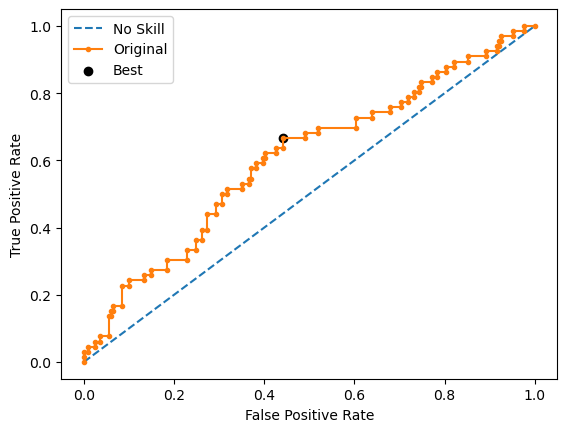

Run 2 - Random State: 1
Test G-mean: 0.5607418685494373
Best Threshold=0.525048, G-Mean=0.581


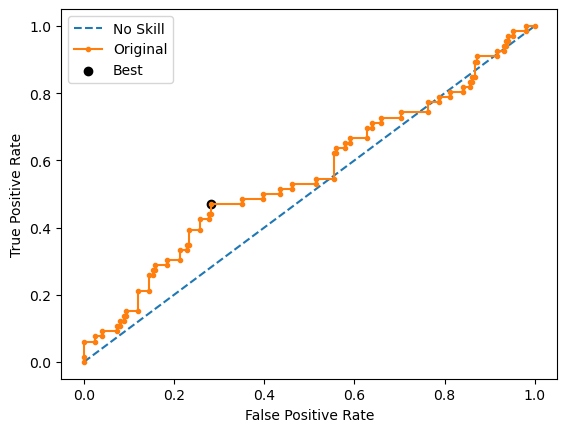

Run 3 - Random State: 2
Test G-mean: 0.6411248740381323
Best Threshold=0.535599, G-Mean=0.660


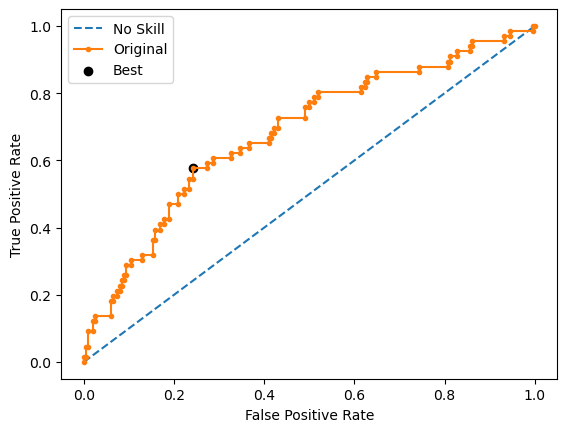

Run 4 - Random State: 3
Test G-mean: 0.5624781223868323
Best Threshold=0.512490, G-Mean=0.575


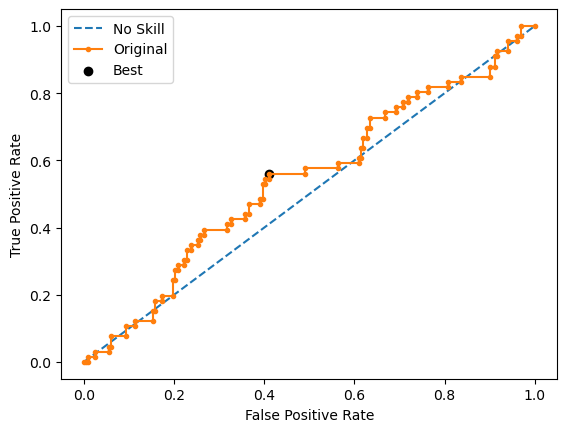

Run 5 - Random State: 4
Test G-mean: 0.5391234231662919
Best Threshold=0.418372, G-Mean=0.551


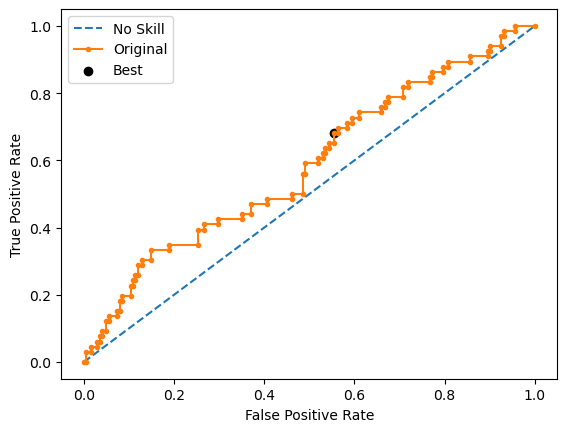

Ave Test G-mean: 0.5779812342829735
Stdev Test G-mean: 0.039070787833841575
Ave Test Specificity: 0.6316831683168317
Ave Test Recall: 0.5303030303030303
Ave Test NPV: 0.8043049927993691
Ave Test Accuracy: 0.6067164179104478
Ave Test Precision: 0.32097154177703724
Ave Test F1-Score: 0.39945352408046814
Ave Runtime: 0.049697494506835936


In [83]:
ho_t03_logreg_gs, ho_t03_logreg_be, ho_t03_logreg_model_info, ho_t03_logreg_metrics_df = logreg_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5272377428700029
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.25098504786204423
Std Train Score (G-mean) 0.05124868855949938
GridSearchCV Runtime: 119.67576289176941 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.5241683653631958
Best Threshold=0.505089, G-Mean=0.401


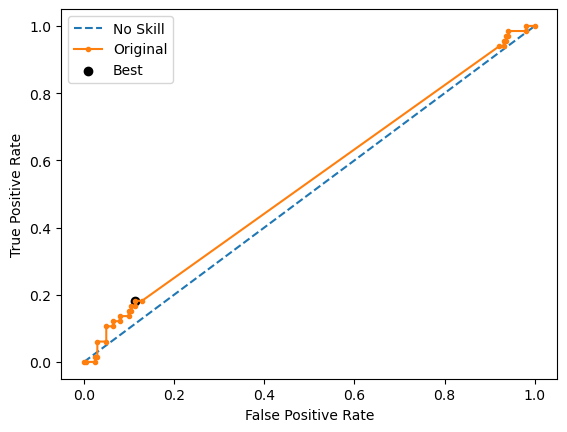

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 2 - Random State: 1
Test G-mean: 0.4925182813112043
Best Threshold=0.505573, G-Mean=0.298


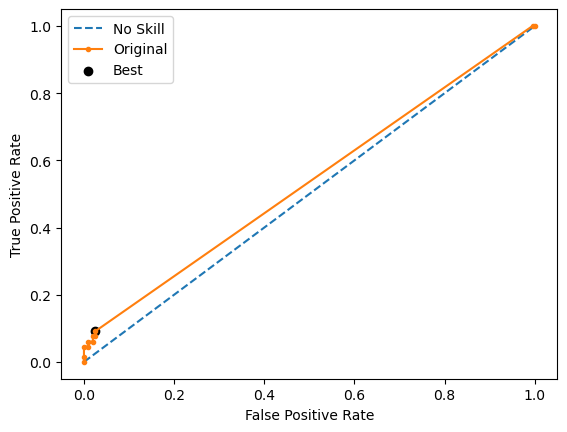

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5450043146345697
Best Threshold=0.494800, G-Mean=0.403


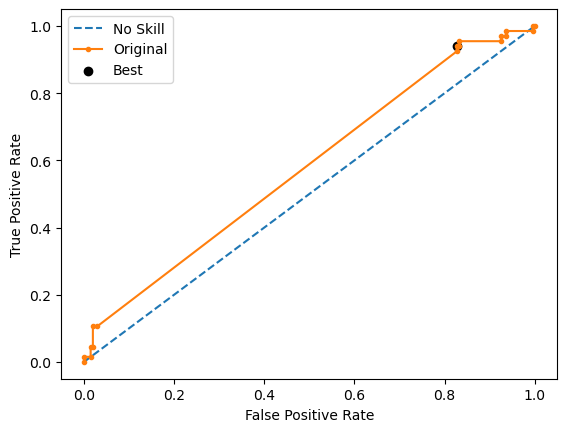

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.5398186180691079
Best Threshold=0.500000, G-Mean=0.280


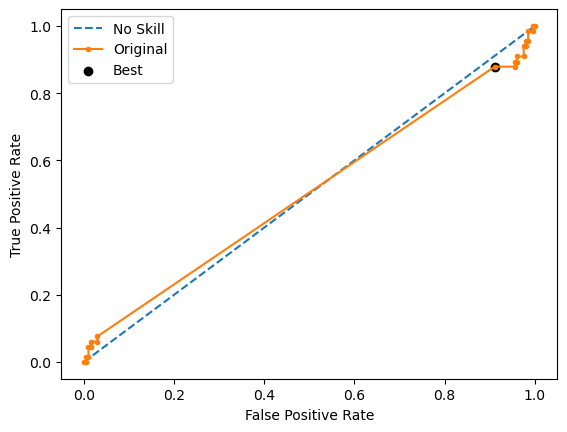

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.534933281224431
Best Threshold=0.505216, G-Mean=0.481


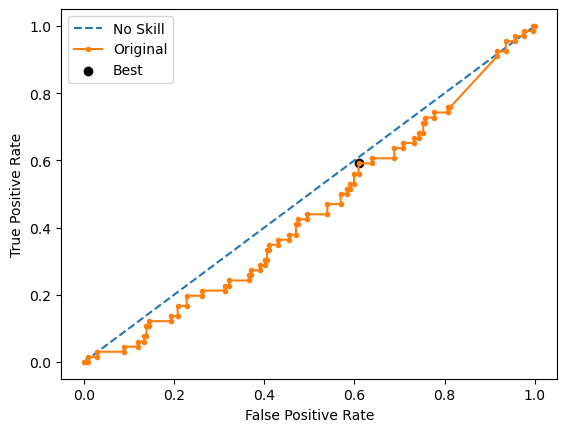

Ave Test G-mean: 0.5272885721205017
Stdev Test G-mean: 0.020904544809407396
Ave Test Specificity: 0.4792079207920793
Ave Test Recall: 0.593939393939394
Ave Test NPV: 0.784175958461613
Ave Test Accuracy: 0.5074626865671641
Ave Test Precision: 0.27201722732972733
Ave Test F1-Score: 0.3715689486402851
Ave Runtime: 0.45612339973449706


In [84]:
ho_t03_svm_gs, ho_t03_svm_be, ho_t03_svm_model_info, ho_t03_svm_metrics_df = svm_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [85]:
ho_t03_knn_gs, ho_t03_knn_be, ho_t03_knn_model_info, ho_t03_knn_metrics_df = knn_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 14, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5716716311474498
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=14))])
Mean Train Score (G-mean) 0.686911391527203
Std Train Score (G-mean) 0.014026027407791327
GridSearchCV Runtime: 77.63297033309937 secs
Run 1 - Random State: 0
Test G-mean: 0.549527249569848
Run 2 - Random State: 1
Test G-mean: 0.5485709553096125
Run 3 - Random State: 2
Test G-mean: 0.567258475668563
Run 4 - Random State: 3
Test G-mean: 0.46032183265511306
Run 5 - Random State: 4
Test G-mean: 0.5691066580517433
Ave Test G-mean: 0.538957034250976
Stdev Test G-mean: 0.04499339746471676
Ave Test Specificity: 0.61683

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.592547724973347
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_ty

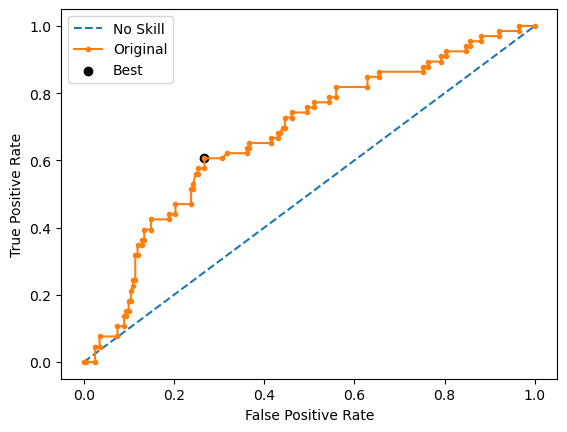

Run 2 - Random State: 1
Test G-mean: 0.5931148105703076
Best Threshold=0.468157, G-Mean=0.620


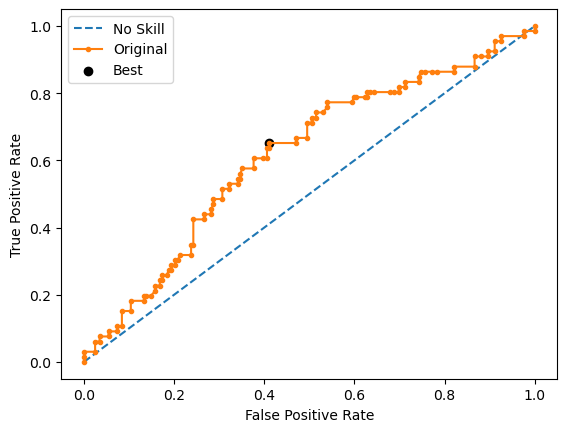

Run 3 - Random State: 2
Test G-mean: 0.6087175483796821
Best Threshold=0.519548, G-Mean=0.614


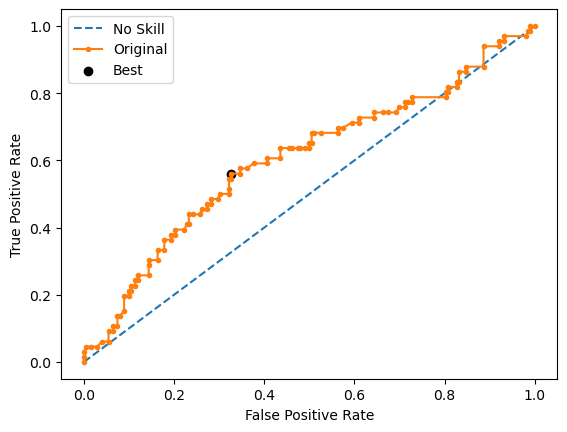

Run 4 - Random State: 3
Test G-mean: 0.6119129380429658
Best Threshold=0.513312, G-Mean=0.642


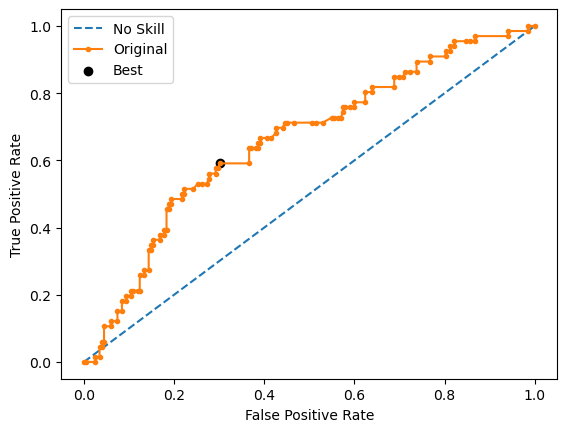

Run 5 - Random State: 4
Test G-mean: 0.6200108396988995
Best Threshold=0.521908, G-Mean=0.646


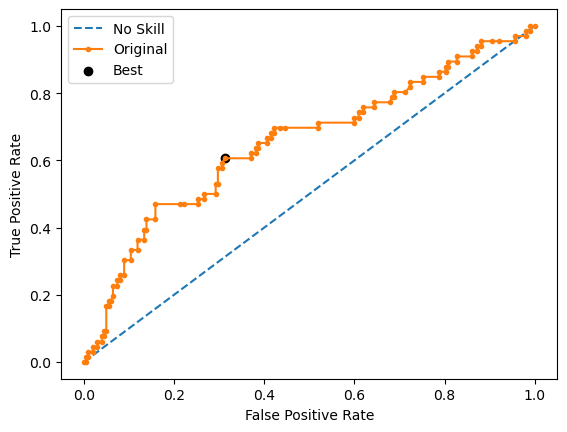

Ave Test G-mean: 0.6160944643757079
Stdev Test G-mean: 0.019704037163722328
Ave Test Specificity: 0.6465346534653466
Ave Test Recall: 0.5878787878787878
Ave Test NPV: 0.8277532608176882
Ave Test Accuracy: 0.6320895522388059
Ave Test Precision: 0.35220566225443956
Ave Test F1-Score: 0.4402828336827341
Ave Runtime: 0.15713047981262207


In [86]:
ho_t03_xgb_gs, ho_t03_xgb_be, ho_t03_xgb_model_info, ho_t03_xgb_metrics_df = xgb_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1174
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5957912487802123
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGB

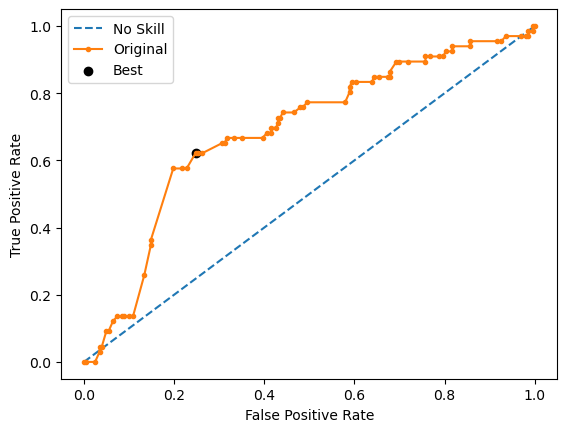

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1138
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Run 2 - Random State: 1
Test G-mean: 0.6247111543766769
Best Threshold=0.507420, G-Mean=0.635


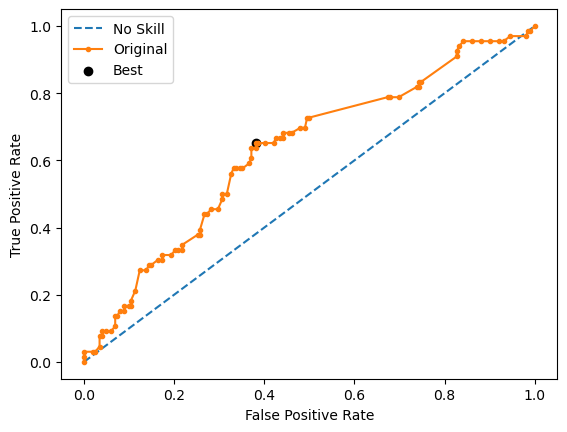

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001169 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1134
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.533153, G-Mean=0.587


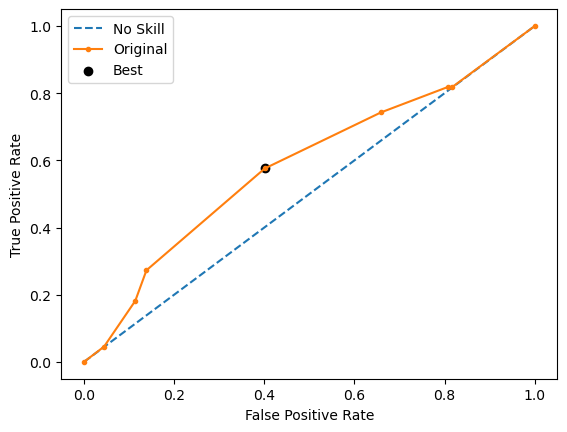

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1129
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Run 4 - Random State: 3
Test G-mean: 0.644857801502328
Best Threshold=0.504052, G-Mean=0.663


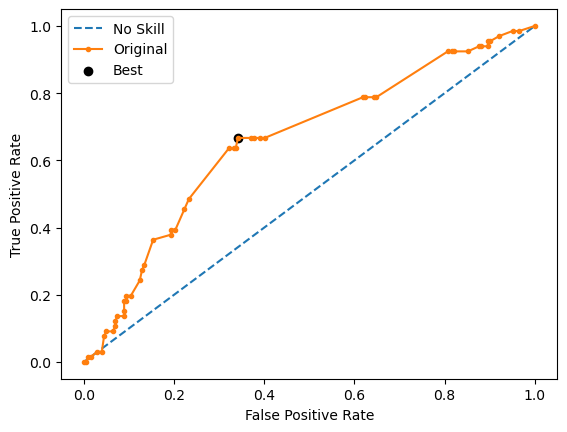

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001006 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1166
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


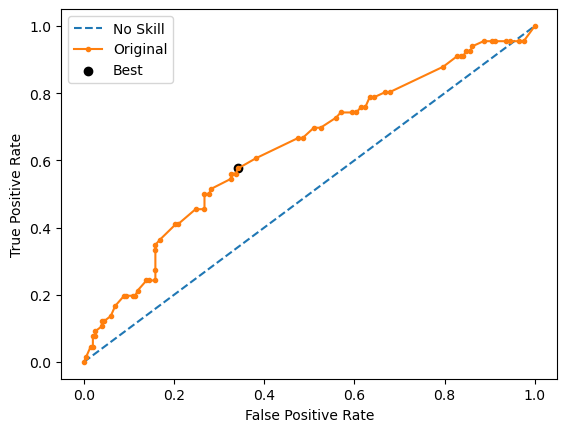

Ave Test G-mean: 0.6253537609763395
Stdev Test G-mean: 0.02754181025025378
Ave Test Specificity: 0.6178217821782178
Ave Test Recall: 0.6333333333333333
Ave Test NPV: 0.8375466771810205
Ave Test Accuracy: 0.6216417910447761
Ave Test Precision: 0.35145152576800137
Ave Test F1-Score: 0.45198139691545886
Ave Runtime: 0.2968695640563965


In [87]:
ho_t03_lgbm_gs, ho_t03_lgbm_be, ho_t03_lgbm_model_info, ho_t03_lgbm_metrics_df = lgbm_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5560299365274767
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8739305088029223
Std Train Score (G-mean) 0.010566993909947217
GridSearchCV Runtime: 148.3054654598236 secs
Run 1 - Random State: 0
Test G-mean: 0.5949457084807016
Best Threshold=0.448082, G-Mean=0.611


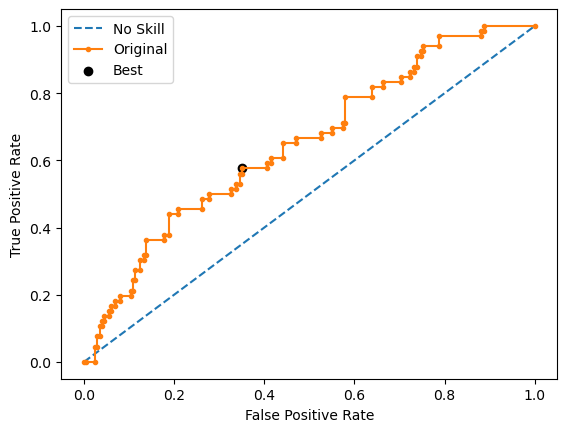

Run 2 - Random State: 1
Test G-mean: 0.4874666782214325
Best Threshold=0.271447, G-Mean=0.551


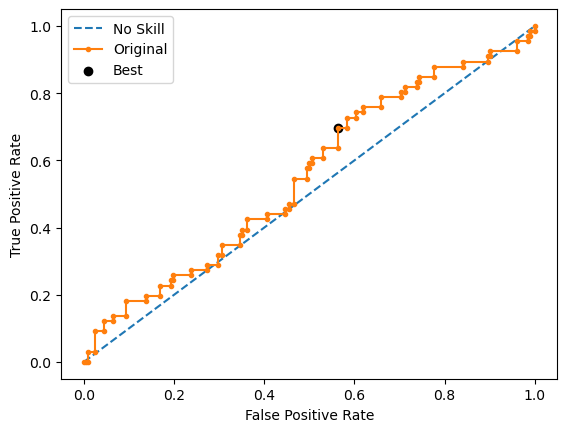

Run 3 - Random State: 2
Test G-mean: 0.5766352840618432
Best Threshold=0.433101, G-Mean=0.622


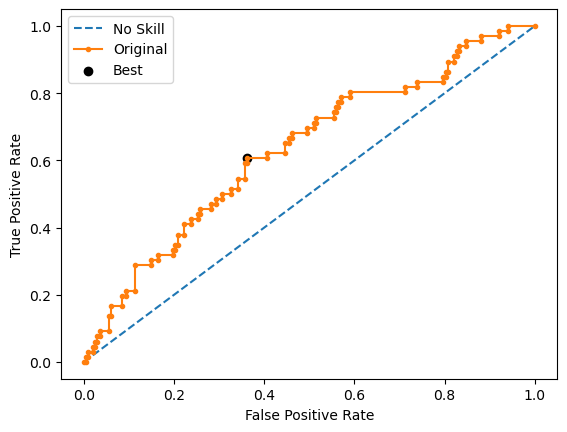

Run 4 - Random State: 3
Test G-mean: 0.5286567390989918
Best Threshold=0.382770, G-Mean=0.572


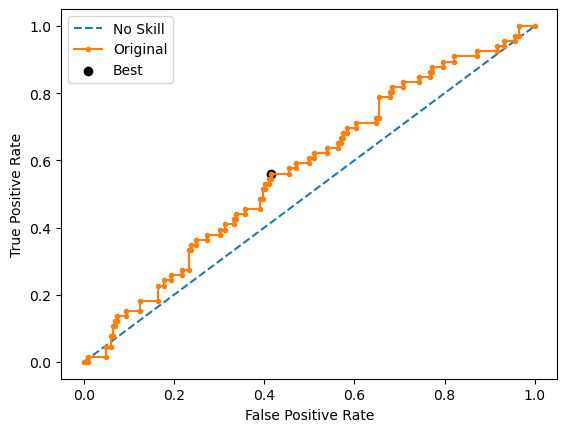

Run 5 - Random State: 4
Test G-mean: 0.5975246468308709
Best Threshold=0.419692, G-Mean=0.603


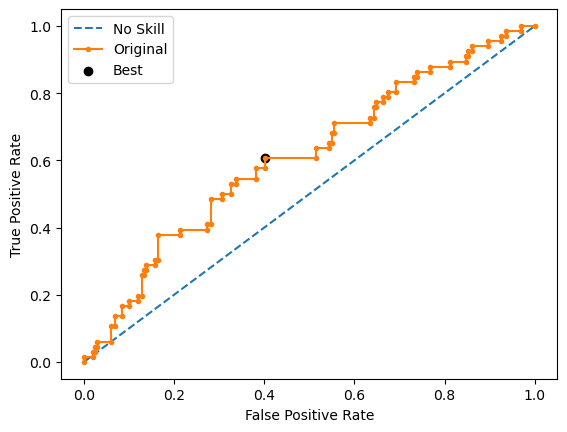

Ave Test G-mean: 0.557045811338768
Stdev Test G-mean: 0.04771236987335964
Ave Test Specificity: 0.6851485148514852
Ave Test Recall: 0.4545454545454546
Ave Test NPV: 0.7937047501212418
Ave Test Accuracy: 0.6283582089552239
Ave Test Precision: 0.32033943914463414
Ave Test F1-Score: 0.37565362753118653
Ave Runtime: 0.7147488594055176


In [88]:
ho_t03_gbm_gs, ho_t03_gbm_be, ho_t03_gbm_model_info, ho_t03_gbm_metrics_df = gbm_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6074666113834067
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9428822635922554
Std Train Score (G-mean) 0.005686654312223512
GridSearchCV Runtime: 13.929941415786743 secs
Run 1 - Random State: 0
Test G-mean: 0.5759194113040744
Best Threshold=0.880797, G-Mean=0.576


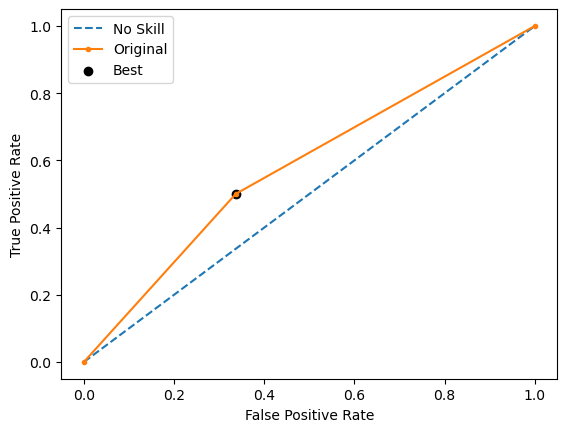

Run 2 - Random State: 1
Test G-mean: 0.5921022365317079
Best Threshold=0.880797, G-Mean=0.592


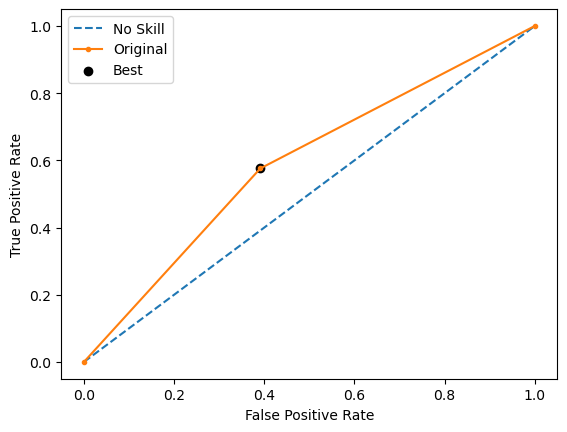

Run 3 - Random State: 2
Test G-mean: 0.6199503478855257
Best Threshold=0.880797, G-Mean=0.620


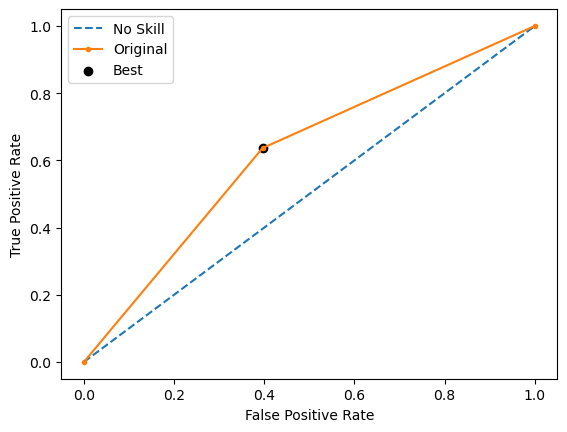

Run 4 - Random State: 3
Test G-mean: 0.612525524979878
Best Threshold=0.880797, G-Mean=0.613


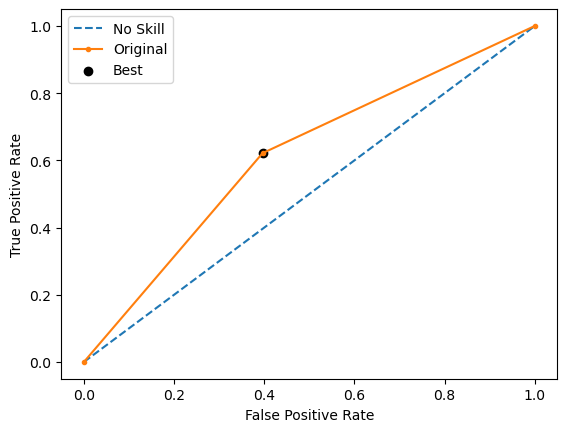

Run 5 - Random State: 4
Test G-mean: 0.5705546014671388
Best Threshold=0.880797, G-Mean=0.571


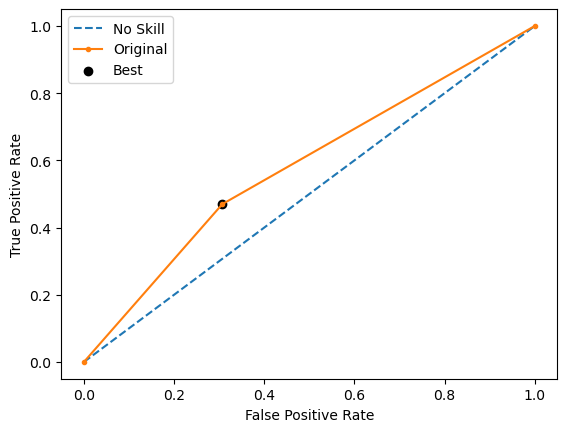

Ave Test G-mean: 0.5942104244336649
Stdev Test G-mean: 0.02177492907615306
Ave Test Specificity: 0.6346534653465346
Ave Test Recall: 0.5606060606060606
Ave Test NPV: 0.8165026314299919
Ave Test Accuracy: 0.6164179104477612
Ave Test Precision: 0.3335915203351127
Ave Test F1-Score: 0.4171516837279478
Ave Runtime: 0.28856849670410156


In [89]:
ho_t03_adaboost_gs, ho_t03_adaboost_be, ho_t03_adaboost_model_info, ho_t03_adaboost_metrics_df = adaboost_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6063235902696703
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=2, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.6208596635107925
Std Train Score (G-mean) 0.021537647305848485
GridSearchCV Runtime: 365.64288568496704 secs
Run 1 - Random State: 0
Test G-mean: 0.6245310271719012
Best Threshold=0.515489, G-Mean=0

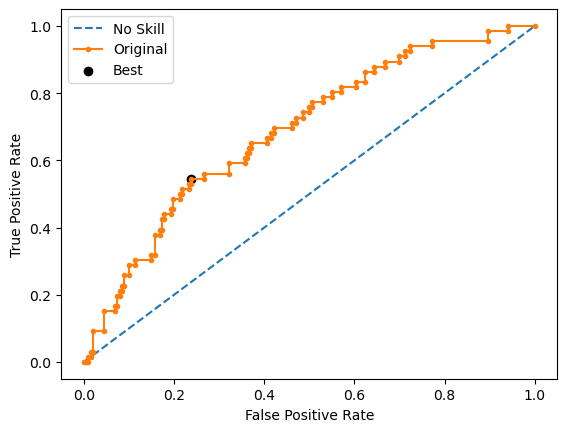

Run 2 - Random State: 1
Test G-mean: 0.5949457084807016
Best Threshold=0.494358, G-Mean=0.600


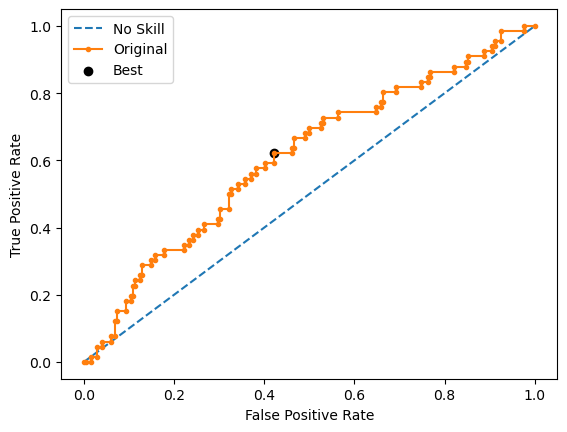

Run 3 - Random State: 2
Test G-mean: 0.5896904047696111
Best Threshold=0.508894, G-Mean=0.612


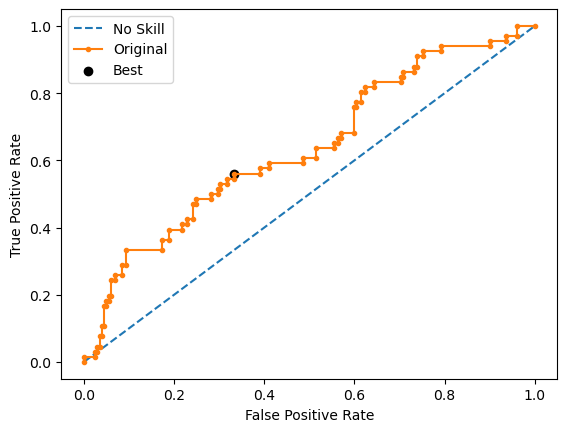

Run 4 - Random State: 3
Test G-mean: 0.6521445616218272
Best Threshold=0.500341, G-Mean=0.655


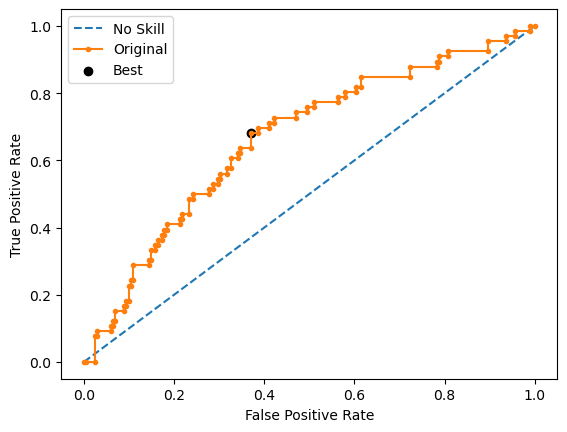

Run 5 - Random State: 4
Test G-mean: 0.5802013989696481
Best Threshold=0.510452, G-Mean=0.600


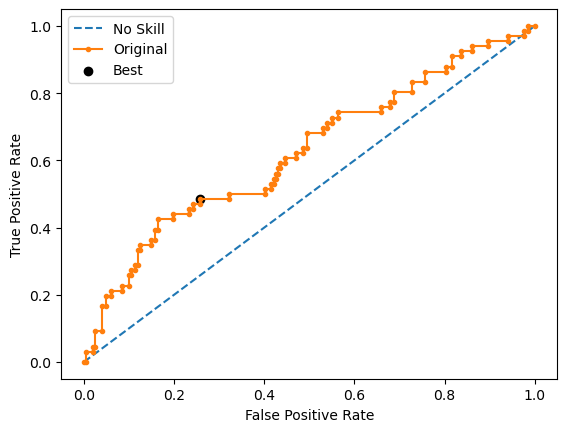

Ave Test G-mean: 0.6083026202027378
Stdev Test G-mean: 0.029580303028460094
Ave Test Specificity: 0.6287128712871287
Ave Test Recall: 0.5909090909090909
Ave Test NPV: 0.8252221638375484
Ave Test Accuracy: 0.619402985074627
Ave Test Precision: 0.34188218304551127
Ave Test F1-Score: 0.4326239883355262
Ave Runtime: 0.6282795906066895


In [90]:
ho_t03_rf_gs, ho_t03_rf_be, ho_t03_rf_model_info, ho_t03_rf_metrics_df = rf_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6920673	total: 2.26ms	remaining: 2.25s
1:	learn: 0.6908058	total: 4.28ms	remaining: 2.13s
2:	learn: 0.6899679	total: 6.35ms	remaining: 2.11s
3:	learn: 0.6888508	total: 8.04ms	remaining: 2s
4:	learn: 0.6877537	total: 10ms	remaining: 1.99s
5:	learn: 0.6864676	total: 11.8ms	remaining: 1.96s
6:	learn: 0.6848858	total: 13.5ms	remaining: 1.92s
7:	learn: 0.6839263	total: 15.3ms	remaining: 1.89s
8:	learn: 0.6831386	total: 17.2ms	remaining: 1.89s
9:	learn: 0.6818549	total: 18.9ms	remaining: 1.87s
10:	learn: 0.6806051	total: 20.9ms	remaining: 1.88s
11:	learn: 0.6800029	total: 22.7ms	remaining: 1.87s
12:	learn: 0.6793316	total: 24.4ms	remaining: 1.85s
13:	learn: 0.6783092	total: 26.5ms	remaining: 1.86s
14:	learn: 0.6773532	total: 28.2ms	remaining: 1.85s
15:	learn: 0.6760787	total: 30.3ms	remaining: 1.86s
16:	learn: 0.6747166	total: 32.1ms	remaining: 1.86s
17:	learn: 0.6735146	total: 34ms	remaini

213:	learn: 0.5238134	total: 400ms	remaining: 1.47s
214:	learn: 0.5233053	total: 402ms	remaining: 1.47s
215:	learn: 0.5227856	total: 404ms	remaining: 1.47s
216:	learn: 0.5220788	total: 406ms	remaining: 1.47s
217:	learn: 0.5215409	total: 408ms	remaining: 1.46s
218:	learn: 0.5208776	total: 410ms	remaining: 1.46s
219:	learn: 0.5201912	total: 411ms	remaining: 1.46s
220:	learn: 0.5194917	total: 413ms	remaining: 1.46s
221:	learn: 0.5193336	total: 415ms	remaining: 1.45s
222:	learn: 0.5189219	total: 417ms	remaining: 1.45s
223:	learn: 0.5184302	total: 419ms	remaining: 1.45s
224:	learn: 0.5178104	total: 420ms	remaining: 1.45s
225:	learn: 0.5167216	total: 422ms	remaining: 1.45s
226:	learn: 0.5163400	total: 424ms	remaining: 1.44s
227:	learn: 0.5160829	total: 426ms	remaining: 1.44s
228:	learn: 0.5153475	total: 428ms	remaining: 1.44s
229:	learn: 0.5147345	total: 430ms	remaining: 1.44s
230:	learn: 0.5142204	total: 432ms	remaining: 1.44s
231:	learn: 0.5137965	total: 434ms	remaining: 1.44s
232:	learn: 

428:	learn: 0.4214589	total: 790ms	remaining: 1.05s
429:	learn: 0.4208016	total: 792ms	remaining: 1.05s
430:	learn: 0.4201810	total: 793ms	remaining: 1.05s
431:	learn: 0.4196669	total: 795ms	remaining: 1.04s
432:	learn: 0.4193467	total: 797ms	remaining: 1.04s
433:	learn: 0.4189473	total: 799ms	remaining: 1.04s
434:	learn: 0.4184679	total: 801ms	remaining: 1.04s
435:	learn: 0.4181021	total: 803ms	remaining: 1.04s
436:	learn: 0.4174474	total: 804ms	remaining: 1.04s
437:	learn: 0.4171383	total: 806ms	remaining: 1.03s
438:	learn: 0.4167697	total: 808ms	remaining: 1.03s
439:	learn: 0.4161779	total: 809ms	remaining: 1.03s
440:	learn: 0.4157593	total: 811ms	remaining: 1.03s
441:	learn: 0.4153234	total: 813ms	remaining: 1.03s
442:	learn: 0.4150943	total: 815ms	remaining: 1.02s
443:	learn: 0.4145662	total: 817ms	remaining: 1.02s
444:	learn: 0.4141669	total: 819ms	remaining: 1.02s
445:	learn: 0.4138919	total: 821ms	remaining: 1.02s
446:	learn: 0.4137978	total: 822ms	remaining: 1.02s
447:	learn: 

639:	learn: 0.3432757	total: 1.18s	remaining: 662ms
640:	learn: 0.3429229	total: 1.18s	remaining: 661ms
641:	learn: 0.3424826	total: 1.18s	remaining: 659ms
642:	learn: 0.3421587	total: 1.18s	remaining: 657ms
643:	learn: 0.3420033	total: 1.18s	remaining: 655ms
644:	learn: 0.3417803	total: 1.19s	remaining: 653ms
645:	learn: 0.3412982	total: 1.19s	remaining: 651ms
646:	learn: 0.3409849	total: 1.19s	remaining: 650ms
647:	learn: 0.3405874	total: 1.19s	remaining: 648ms
648:	learn: 0.3401930	total: 1.19s	remaining: 646ms
649:	learn: 0.3396908	total: 1.2s	remaining: 644ms
650:	learn: 0.3394560	total: 1.2s	remaining: 642ms
651:	learn: 0.3392819	total: 1.2s	remaining: 640ms
652:	learn: 0.3389133	total: 1.2s	remaining: 639ms
653:	learn: 0.3384729	total: 1.2s	remaining: 637ms
654:	learn: 0.3381646	total: 1.21s	remaining: 635ms
655:	learn: 0.3379988	total: 1.21s	remaining: 633ms
656:	learn: 0.3377664	total: 1.21s	remaining: 631ms
657:	learn: 0.3376196	total: 1.21s	remaining: 629ms
658:	learn: 0.337

866:	learn: 0.2721456	total: 1.59s	remaining: 244ms
867:	learn: 0.2717211	total: 1.59s	remaining: 242ms
868:	learn: 0.2714204	total: 1.59s	remaining: 240ms
869:	learn: 0.2710415	total: 1.6s	remaining: 238ms
870:	learn: 0.2708698	total: 1.6s	remaining: 237ms
871:	learn: 0.2706966	total: 1.6s	remaining: 235ms
872:	learn: 0.2704463	total: 1.6s	remaining: 233ms
873:	learn: 0.2702212	total: 1.6s	remaining: 231ms
874:	learn: 0.2698940	total: 1.6s	remaining: 229ms
875:	learn: 0.2697482	total: 1.61s	remaining: 227ms
876:	learn: 0.2694939	total: 1.61s	remaining: 226ms
877:	learn: 0.2690876	total: 1.61s	remaining: 224ms
878:	learn: 0.2687143	total: 1.61s	remaining: 222ms
879:	learn: 0.2680995	total: 1.61s	remaining: 220ms
880:	learn: 0.2676832	total: 1.62s	remaining: 218ms
881:	learn: 0.2672397	total: 1.62s	remaining: 216ms
882:	learn: 0.2668641	total: 1.62s	remaining: 215ms
883:	learn: 0.2665016	total: 1.62s	remaining: 213ms
884:	learn: 0.2663844	total: 1.62s	remaining: 211ms
885:	learn: 0.2661

42:	learn: 0.6507984	total: 78.2ms	remaining: 1.74s
43:	learn: 0.6495673	total: 80.4ms	remaining: 1.75s
44:	learn: 0.6489898	total: 82.1ms	remaining: 1.74s
45:	learn: 0.6477782	total: 83.7ms	remaining: 1.74s
46:	learn: 0.6470478	total: 85.4ms	remaining: 1.73s
47:	learn: 0.6464076	total: 87.1ms	remaining: 1.73s
48:	learn: 0.6455377	total: 88.8ms	remaining: 1.72s
49:	learn: 0.6448149	total: 90.6ms	remaining: 1.72s
50:	learn: 0.6439983	total: 92.4ms	remaining: 1.72s
51:	learn: 0.6429995	total: 94.2ms	remaining: 1.72s
52:	learn: 0.6421318	total: 96ms	remaining: 1.72s
53:	learn: 0.6409416	total: 97.8ms	remaining: 1.71s
54:	learn: 0.6399519	total: 99.5ms	remaining: 1.71s
55:	learn: 0.6392368	total: 101ms	remaining: 1.71s
56:	learn: 0.6386373	total: 103ms	remaining: 1.7s
57:	learn: 0.6375260	total: 105ms	remaining: 1.7s
58:	learn: 0.6361332	total: 107ms	remaining: 1.7s
59:	learn: 0.6351834	total: 108ms	remaining: 1.7s
60:	learn: 0.6338876	total: 110ms	remaining: 1.7s
61:	learn: 0.6331731	tota

253:	learn: 0.5025716	total: 464ms	remaining: 1.36s
254:	learn: 0.5020070	total: 466ms	remaining: 1.36s
255:	learn: 0.5014499	total: 468ms	remaining: 1.36s
256:	learn: 0.5008942	total: 470ms	remaining: 1.36s
257:	learn: 0.5003237	total: 472ms	remaining: 1.36s
258:	learn: 0.4997132	total: 473ms	remaining: 1.35s
259:	learn: 0.4994620	total: 475ms	remaining: 1.35s
260:	learn: 0.4988524	total: 477ms	remaining: 1.35s
261:	learn: 0.4985046	total: 479ms	remaining: 1.35s
262:	learn: 0.4978448	total: 481ms	remaining: 1.35s
263:	learn: 0.4975709	total: 482ms	remaining: 1.34s
264:	learn: 0.4970841	total: 484ms	remaining: 1.34s
265:	learn: 0.4969277	total: 486ms	remaining: 1.34s
266:	learn: 0.4965877	total: 488ms	remaining: 1.34s
267:	learn: 0.4958777	total: 489ms	remaining: 1.34s
268:	learn: 0.4953056	total: 491ms	remaining: 1.33s
269:	learn: 0.4946595	total: 493ms	remaining: 1.33s
270:	learn: 0.4944961	total: 495ms	remaining: 1.33s
271:	learn: 0.4939164	total: 496ms	remaining: 1.33s
272:	learn: 

473:	learn: 0.4029397	total: 861ms	remaining: 956ms
474:	learn: 0.4027032	total: 863ms	remaining: 954ms
475:	learn: 0.4025130	total: 865ms	remaining: 952ms
476:	learn: 0.4023272	total: 867ms	remaining: 951ms
477:	learn: 0.4020381	total: 869ms	remaining: 949ms
478:	learn: 0.4017257	total: 872ms	remaining: 949ms
479:	learn: 0.4010625	total: 874ms	remaining: 947ms
480:	learn: 0.4008185	total: 876ms	remaining: 945ms
481:	learn: 0.4005274	total: 878ms	remaining: 944ms
482:	learn: 0.4004112	total: 880ms	remaining: 942ms
483:	learn: 0.3999967	total: 882ms	remaining: 941ms
484:	learn: 0.3995102	total: 884ms	remaining: 939ms
485:	learn: 0.3990645	total: 886ms	remaining: 937ms
486:	learn: 0.3989149	total: 888ms	remaining: 935ms
487:	learn: 0.3986265	total: 890ms	remaining: 933ms
488:	learn: 0.3980166	total: 892ms	remaining: 932ms
489:	learn: 0.3976612	total: 894ms	remaining: 930ms
490:	learn: 0.3973895	total: 895ms	remaining: 928ms
491:	learn: 0.3969315	total: 897ms	remaining: 926ms
492:	learn: 

691:	learn: 0.3259735	total: 1.26s	remaining: 560ms
692:	learn: 0.3255364	total: 1.26s	remaining: 559ms
693:	learn: 0.3251789	total: 1.26s	remaining: 557ms
694:	learn: 0.3247759	total: 1.26s	remaining: 555ms
695:	learn: 0.3244324	total: 1.27s	remaining: 553ms
696:	learn: 0.3240183	total: 1.27s	remaining: 551ms
697:	learn: 0.3237400	total: 1.27s	remaining: 550ms
698:	learn: 0.3235222	total: 1.27s	remaining: 548ms
699:	learn: 0.3230775	total: 1.27s	remaining: 546ms
700:	learn: 0.3228930	total: 1.27s	remaining: 544ms
701:	learn: 0.3225633	total: 1.28s	remaining: 542ms
702:	learn: 0.3222753	total: 1.28s	remaining: 540ms
703:	learn: 0.3218823	total: 1.28s	remaining: 539ms
704:	learn: 0.3215345	total: 1.28s	remaining: 537ms
705:	learn: 0.3211877	total: 1.28s	remaining: 535ms
706:	learn: 0.3207995	total: 1.29s	remaining: 533ms
707:	learn: 0.3203275	total: 1.29s	remaining: 532ms
708:	learn: 0.3199426	total: 1.29s	remaining: 530ms
709:	learn: 0.3195682	total: 1.29s	remaining: 528ms
710:	learn: 

913:	learn: 0.2573377	total: 1.66s	remaining: 156ms
914:	learn: 0.2571372	total: 1.66s	remaining: 154ms
915:	learn: 0.2569128	total: 1.66s	remaining: 152ms
916:	learn: 0.2566345	total: 1.66s	remaining: 151ms
917:	learn: 0.2565244	total: 1.67s	remaining: 149ms
918:	learn: 0.2559798	total: 1.67s	remaining: 147ms
919:	learn: 0.2556594	total: 1.67s	remaining: 145ms
920:	learn: 0.2555504	total: 1.67s	remaining: 143ms
921:	learn: 0.2551821	total: 1.67s	remaining: 142ms
922:	learn: 0.2548646	total: 1.68s	remaining: 140ms
923:	learn: 0.2547275	total: 1.68s	remaining: 138ms
924:	learn: 0.2546649	total: 1.68s	remaining: 136ms
925:	learn: 0.2544280	total: 1.68s	remaining: 134ms
926:	learn: 0.2540979	total: 1.68s	remaining: 132ms
927:	learn: 0.2538025	total: 1.68s	remaining: 131ms
928:	learn: 0.2534737	total: 1.69s	remaining: 129ms
929:	learn: 0.2533299	total: 1.69s	remaining: 127ms
930:	learn: 0.2528310	total: 1.69s	remaining: 125ms
931:	learn: 0.2525786	total: 1.69s	remaining: 123ms
932:	learn: 

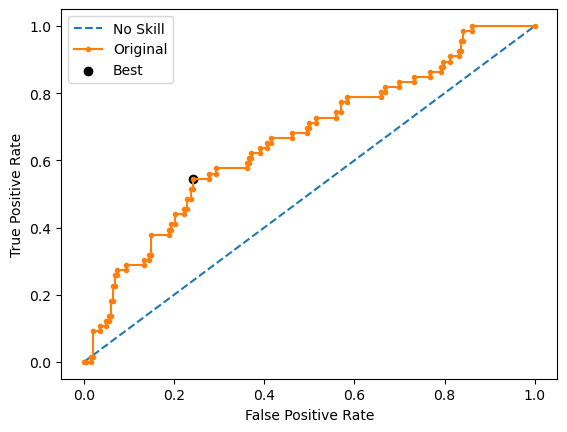

Learning rate set to 0.006922
0:	learn: 0.6918880	total: 2.27ms	remaining: 2.26s
1:	learn: 0.6904218	total: 4.6ms	remaining: 2.29s
2:	learn: 0.6891579	total: 7.08ms	remaining: 2.35s
3:	learn: 0.6878458	total: 8.7ms	remaining: 2.17s
4:	learn: 0.6866511	total: 10.3ms	remaining: 2.05s
5:	learn: 0.6849158	total: 13.3ms	remaining: 2.21s
6:	learn: 0.6835245	total: 15.2ms	remaining: 2.16s
7:	learn: 0.6823877	total: 16.9ms	remaining: 2.1s
8:	learn: 0.6812500	total: 18.9ms	remaining: 2.08s
9:	learn: 0.6799343	total: 21ms	remaining: 2.07s
10:	learn: 0.6786539	total: 23ms	remaining: 2.07s
11:	learn: 0.6774369	total: 24.9ms	remaining: 2.05s
12:	learn: 0.6760979	total: 26.8ms	remaining: 2.03s
13:	learn: 0.6754439	total: 28.7ms	remaining: 2.02s
14:	learn: 0.6741798	total: 30.5ms	remaining: 2s
15:	learn: 0.6730779	total: 32.3ms	remaining: 1.99s
16:	learn: 0.6719609	total: 34ms	remaining: 1.97s
17:	learn: 0.6710414	total: 35.9ms	remaining: 1.96s
18:	learn: 0.6695650	total: 37.7ms	remaining: 1.95s
19:	

217:	learn: 0.5083918	total: 395ms	remaining: 1.42s
218:	learn: 0.5073868	total: 397ms	remaining: 1.42s
219:	learn: 0.5069418	total: 399ms	remaining: 1.41s
220:	learn: 0.5063437	total: 401ms	remaining: 1.41s
221:	learn: 0.5060992	total: 402ms	remaining: 1.41s
222:	learn: 0.5058823	total: 404ms	remaining: 1.41s
223:	learn: 0.5052283	total: 406ms	remaining: 1.41s
224:	learn: 0.5048524	total: 408ms	remaining: 1.41s
225:	learn: 0.5043071	total: 410ms	remaining: 1.4s
226:	learn: 0.5037606	total: 412ms	remaining: 1.4s
227:	learn: 0.5032840	total: 414ms	remaining: 1.4s
228:	learn: 0.5028455	total: 415ms	remaining: 1.4s
229:	learn: 0.5022580	total: 417ms	remaining: 1.4s
230:	learn: 0.5015857	total: 419ms	remaining: 1.4s
231:	learn: 0.5011915	total: 421ms	remaining: 1.39s
232:	learn: 0.5007223	total: 423ms	remaining: 1.39s
233:	learn: 0.5001418	total: 424ms	remaining: 1.39s
234:	learn: 0.4995901	total: 426ms	remaining: 1.39s
235:	learn: 0.4994305	total: 428ms	remaining: 1.39s
236:	learn: 0.4993

433:	learn: 0.4113158	total: 785ms	remaining: 1.02s
434:	learn: 0.4107626	total: 786ms	remaining: 1.02s
435:	learn: 0.4103331	total: 788ms	remaining: 1.02s
436:	learn: 0.4100883	total: 790ms	remaining: 1.02s
437:	learn: 0.4096134	total: 791ms	remaining: 1.01s
438:	learn: 0.4090099	total: 793ms	remaining: 1.01s
439:	learn: 0.4085901	total: 795ms	remaining: 1.01s
440:	learn: 0.4082730	total: 797ms	remaining: 1.01s
441:	learn: 0.4080265	total: 799ms	remaining: 1.01s
442:	learn: 0.4075793	total: 800ms	remaining: 1.01s
443:	learn: 0.4072848	total: 802ms	remaining: 1s
444:	learn: 0.4069881	total: 804ms	remaining: 1s
445:	learn: 0.4065293	total: 806ms	remaining: 1s
446:	learn: 0.4063084	total: 808ms	remaining: 999ms
447:	learn: 0.4058698	total: 810ms	remaining: 998ms
448:	learn: 0.4055745	total: 811ms	remaining: 996ms
449:	learn: 0.4050439	total: 813ms	remaining: 994ms
450:	learn: 0.4047631	total: 815ms	remaining: 992ms
451:	learn: 0.4042192	total: 817ms	remaining: 990ms
452:	learn: 0.4037895

647:	learn: 0.3383766	total: 1.17s	remaining: 636ms
648:	learn: 0.3381733	total: 1.17s	remaining: 634ms
649:	learn: 0.3379489	total: 1.17s	remaining: 632ms
650:	learn: 0.3376850	total: 1.18s	remaining: 630ms
651:	learn: 0.3372078	total: 1.18s	remaining: 628ms
652:	learn: 0.3368191	total: 1.18s	remaining: 626ms
653:	learn: 0.3363595	total: 1.18s	remaining: 625ms
654:	learn: 0.3360333	total: 1.18s	remaining: 623ms
655:	learn: 0.3358352	total: 1.18s	remaining: 621ms
656:	learn: 0.3357714	total: 1.19s	remaining: 619ms
657:	learn: 0.3353854	total: 1.19s	remaining: 617ms
658:	learn: 0.3352256	total: 1.19s	remaining: 616ms
659:	learn: 0.3347487	total: 1.19s	remaining: 614ms
660:	learn: 0.3341848	total: 1.19s	remaining: 612ms
661:	learn: 0.3340520	total: 1.19s	remaining: 610ms
662:	learn: 0.3338297	total: 1.2s	remaining: 608ms
663:	learn: 0.3335374	total: 1.2s	remaining: 607ms
664:	learn: 0.3331928	total: 1.2s	remaining: 605ms
665:	learn: 0.3327649	total: 1.2s	remaining: 603ms
666:	learn: 0.33

862:	learn: 0.2766385	total: 1.56s	remaining: 247ms
863:	learn: 0.2762187	total: 1.56s	remaining: 246ms
864:	learn: 0.2758225	total: 1.56s	remaining: 244ms
865:	learn: 0.2754079	total: 1.56s	remaining: 242ms
866:	learn: 0.2750776	total: 1.57s	remaining: 240ms
867:	learn: 0.2748655	total: 1.57s	remaining: 238ms
868:	learn: 0.2745451	total: 1.57s	remaining: 237ms
869:	learn: 0.2742419	total: 1.57s	remaining: 235ms
870:	learn: 0.2739093	total: 1.57s	remaining: 233ms
871:	learn: 0.2735985	total: 1.57s	remaining: 231ms
872:	learn: 0.2733540	total: 1.58s	remaining: 229ms
873:	learn: 0.2729531	total: 1.58s	remaining: 228ms
874:	learn: 0.2727389	total: 1.58s	remaining: 226ms
875:	learn: 0.2726045	total: 1.58s	remaining: 224ms
876:	learn: 0.2723213	total: 1.58s	remaining: 222ms
877:	learn: 0.2719936	total: 1.58s	remaining: 220ms
878:	learn: 0.2717003	total: 1.59s	remaining: 219ms
879:	learn: 0.2714985	total: 1.59s	remaining: 217ms
880:	learn: 0.2711427	total: 1.59s	remaining: 215ms
881:	learn: 

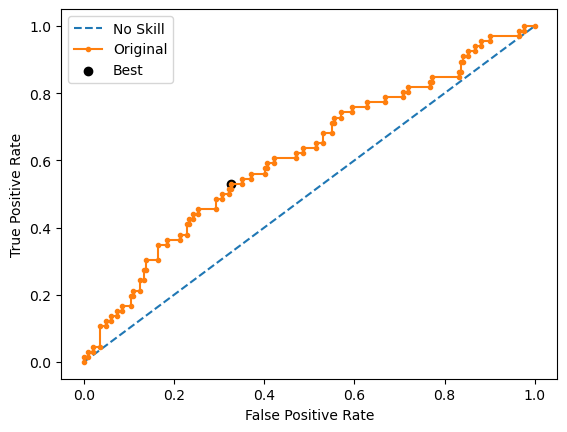

Learning rate set to 0.006922
0:	learn: 0.6919232	total: 2.15ms	remaining: 2.15s
1:	learn: 0.6903905	total: 4.28ms	remaining: 2.14s
2:	learn: 0.6892476	total: 6.11ms	remaining: 2.03s
3:	learn: 0.6880111	total: 8.05ms	remaining: 2s
4:	learn: 0.6869433	total: 9.9ms	remaining: 1.97s
5:	learn: 0.6855054	total: 11.8ms	remaining: 1.95s
6:	learn: 0.6844812	total: 13.8ms	remaining: 1.95s
7:	learn: 0.6833005	total: 15.5ms	remaining: 1.92s
8:	learn: 0.6822615	total: 17.1ms	remaining: 1.89s
9:	learn: 0.6810277	total: 18.9ms	remaining: 1.87s
10:	learn: 0.6801359	total: 20.9ms	remaining: 1.88s
11:	learn: 0.6790116	total: 22.8ms	remaining: 1.87s
12:	learn: 0.6780280	total: 24.5ms	remaining: 1.86s
13:	learn: 0.6772028	total: 26.1ms	remaining: 1.84s
14:	learn: 0.6759762	total: 27.8ms	remaining: 1.82s
15:	learn: 0.6746589	total: 29.6ms	remaining: 1.82s
16:	learn: 0.6733042	total: 31.6ms	remaining: 1.82s
17:	learn: 0.6714887	total: 33.2ms	remaining: 1.81s
18:	learn: 0.6703806	total: 35ms	remaining: 1.81

208:	learn: 0.5166043	total: 386ms	remaining: 1.46s
209:	learn: 0.5159012	total: 388ms	remaining: 1.46s
210:	learn: 0.5151984	total: 390ms	remaining: 1.46s
211:	learn: 0.5143361	total: 392ms	remaining: 1.46s
212:	learn: 0.5135863	total: 393ms	remaining: 1.45s
213:	learn: 0.5132586	total: 395ms	remaining: 1.45s
214:	learn: 0.5127370	total: 397ms	remaining: 1.45s
215:	learn: 0.5117471	total: 399ms	remaining: 1.45s
216:	learn: 0.5111738	total: 401ms	remaining: 1.45s
217:	learn: 0.5106431	total: 403ms	remaining: 1.44s
218:	learn: 0.5100300	total: 405ms	remaining: 1.44s
219:	learn: 0.5095525	total: 406ms	remaining: 1.44s
220:	learn: 0.5093685	total: 408ms	remaining: 1.44s
221:	learn: 0.5087330	total: 410ms	remaining: 1.44s
222:	learn: 0.5084527	total: 412ms	remaining: 1.43s
223:	learn: 0.5079151	total: 414ms	remaining: 1.43s
224:	learn: 0.5075588	total: 415ms	remaining: 1.43s
225:	learn: 0.5071820	total: 417ms	remaining: 1.43s
226:	learn: 0.5065583	total: 419ms	remaining: 1.43s
227:	learn: 

417:	learn: 0.4173458	total: 772ms	remaining: 1.07s
418:	learn: 0.4169813	total: 774ms	remaining: 1.07s
419:	learn: 0.4165653	total: 776ms	remaining: 1.07s
420:	learn: 0.4162128	total: 778ms	remaining: 1.07s
421:	learn: 0.4158112	total: 779ms	remaining: 1.07s
422:	learn: 0.4152519	total: 781ms	remaining: 1.06s
423:	learn: 0.4150562	total: 783ms	remaining: 1.06s
424:	learn: 0.4143836	total: 785ms	remaining: 1.06s
425:	learn: 0.4142124	total: 787ms	remaining: 1.06s
426:	learn: 0.4137302	total: 789ms	remaining: 1.06s
427:	learn: 0.4135629	total: 790ms	remaining: 1.05s
428:	learn: 0.4129052	total: 792ms	remaining: 1.05s
429:	learn: 0.4122445	total: 794ms	remaining: 1.05s
430:	learn: 0.4118088	total: 796ms	remaining: 1.05s
431:	learn: 0.4115367	total: 798ms	remaining: 1.05s
432:	learn: 0.4110981	total: 799ms	remaining: 1.05s
433:	learn: 0.4108780	total: 801ms	remaining: 1.04s
434:	learn: 0.4106435	total: 803ms	remaining: 1.04s
435:	learn: 0.4101513	total: 805ms	remaining: 1.04s
436:	learn: 

627:	learn: 0.3442379	total: 1.16s	remaining: 687ms
628:	learn: 0.3440768	total: 1.16s	remaining: 686ms
629:	learn: 0.3434483	total: 1.16s	remaining: 684ms
630:	learn: 0.3431443	total: 1.17s	remaining: 682ms
631:	learn: 0.3427527	total: 1.17s	remaining: 680ms
632:	learn: 0.3425582	total: 1.17s	remaining: 678ms
633:	learn: 0.3421811	total: 1.17s	remaining: 676ms
634:	learn: 0.3417831	total: 1.17s	remaining: 674ms
635:	learn: 0.3416367	total: 1.18s	remaining: 673ms
636:	learn: 0.3412069	total: 1.18s	remaining: 671ms
637:	learn: 0.3408668	total: 1.18s	remaining: 669ms
638:	learn: 0.3405233	total: 1.18s	remaining: 667ms
639:	learn: 0.3402779	total: 1.18s	remaining: 665ms
640:	learn: 0.3396543	total: 1.18s	remaining: 663ms
641:	learn: 0.3392722	total: 1.19s	remaining: 661ms
642:	learn: 0.3391352	total: 1.19s	remaining: 660ms
643:	learn: 0.3390140	total: 1.19s	remaining: 658ms
644:	learn: 0.3385439	total: 1.19s	remaining: 656ms
645:	learn: 0.3381665	total: 1.19s	remaining: 654ms
646:	learn: 

834:	learn: 0.2820246	total: 1.54s	remaining: 305ms
835:	learn: 0.2815867	total: 1.55s	remaining: 304ms
836:	learn: 0.2814068	total: 1.55s	remaining: 302ms
837:	learn: 0.2812134	total: 1.55s	remaining: 300ms
838:	learn: 0.2810492	total: 1.55s	remaining: 298ms
839:	learn: 0.2807823	total: 1.55s	remaining: 296ms
840:	learn: 0.2806144	total: 1.56s	remaining: 294ms
841:	learn: 0.2803252	total: 1.56s	remaining: 293ms
842:	learn: 0.2800510	total: 1.56s	remaining: 291ms
843:	learn: 0.2796553	total: 1.56s	remaining: 289ms
844:	learn: 0.2792062	total: 1.56s	remaining: 287ms
845:	learn: 0.2787366	total: 1.57s	remaining: 285ms
846:	learn: 0.2786021	total: 1.57s	remaining: 283ms
847:	learn: 0.2783064	total: 1.57s	remaining: 281ms
848:	learn: 0.2780045	total: 1.57s	remaining: 280ms
849:	learn: 0.2777363	total: 1.57s	remaining: 278ms
850:	learn: 0.2774274	total: 1.57s	remaining: 276ms
851:	learn: 0.2769788	total: 1.58s	remaining: 274ms
852:	learn: 0.2767044	total: 1.58s	remaining: 272ms
853:	learn: 

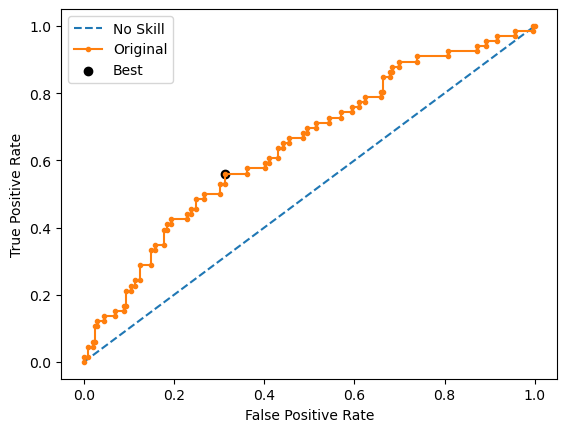

Learning rate set to 0.006922
0:	learn: 0.6922716	total: 2.01ms	remaining: 2.01s
1:	learn: 0.6912078	total: 4.17ms	remaining: 2.08s
2:	learn: 0.6905710	total: 6ms	remaining: 1.99s
3:	learn: 0.6893109	total: 7.88ms	remaining: 1.96s
4:	learn: 0.6883369	total: 10ms	remaining: 2s
5:	learn: 0.6872621	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6864907	total: 13.4ms	remaining: 1.9s
7:	learn: 0.6854785	total: 15.3ms	remaining: 1.89s
8:	learn: 0.6846482	total: 17.3ms	remaining: 1.9s
9:	learn: 0.6831712	total: 19.2ms	remaining: 1.91s
10:	learn: 0.6816205	total: 21.1ms	remaining: 1.9s
11:	learn: 0.6798842	total: 22.8ms	remaining: 1.88s
12:	learn: 0.6788486	total: 24.6ms	remaining: 1.86s
13:	learn: 0.6779078	total: 26.2ms	remaining: 1.84s
14:	learn: 0.6767846	total: 28ms	remaining: 1.84s
15:	learn: 0.6755551	total: 29.8ms	remaining: 1.83s
16:	learn: 0.6746073	total: 31.5ms	remaining: 1.82s
17:	learn: 0.6737495	total: 33.4ms	remaining: 1.82s
18:	learn: 0.6728252	total: 35.2ms	remaining: 1.82s
19:	l

212:	learn: 0.5276276	total: 388ms	remaining: 1.43s
213:	learn: 0.5271680	total: 390ms	remaining: 1.43s
214:	learn: 0.5266043	total: 392ms	remaining: 1.43s
215:	learn: 0.5260857	total: 394ms	remaining: 1.43s
216:	learn: 0.5255305	total: 396ms	remaining: 1.43s
217:	learn: 0.5251518	total: 398ms	remaining: 1.43s
218:	learn: 0.5248286	total: 399ms	remaining: 1.42s
219:	learn: 0.5242417	total: 401ms	remaining: 1.42s
220:	learn: 0.5235040	total: 403ms	remaining: 1.42s
221:	learn: 0.5228307	total: 405ms	remaining: 1.42s
222:	learn: 0.5220567	total: 407ms	remaining: 1.42s
223:	learn: 0.5212106	total: 409ms	remaining: 1.42s
224:	learn: 0.5208686	total: 411ms	remaining: 1.42s
225:	learn: 0.5204276	total: 413ms	remaining: 1.41s
226:	learn: 0.5199490	total: 415ms	remaining: 1.41s
227:	learn: 0.5187261	total: 417ms	remaining: 1.41s
228:	learn: 0.5178097	total: 419ms	remaining: 1.41s
229:	learn: 0.5172997	total: 421ms	remaining: 1.41s
230:	learn: 0.5166220	total: 423ms	remaining: 1.41s
231:	learn: 

431:	learn: 0.4244951	total: 786ms	remaining: 1.03s
432:	learn: 0.4242589	total: 788ms	remaining: 1.03s
433:	learn: 0.4239325	total: 790ms	remaining: 1.03s
434:	learn: 0.4236749	total: 792ms	remaining: 1.03s
435:	learn: 0.4235175	total: 793ms	remaining: 1.03s
436:	learn: 0.4230775	total: 795ms	remaining: 1.02s
437:	learn: 0.4228243	total: 797ms	remaining: 1.02s
438:	learn: 0.4225006	total: 799ms	remaining: 1.02s
439:	learn: 0.4221200	total: 801ms	remaining: 1.02s
440:	learn: 0.4219585	total: 803ms	remaining: 1.02s
441:	learn: 0.4216587	total: 805ms	remaining: 1.01s
442:	learn: 0.4213575	total: 806ms	remaining: 1.01s
443:	learn: 0.4205507	total: 808ms	remaining: 1.01s
444:	learn: 0.4200280	total: 810ms	remaining: 1.01s
445:	learn: 0.4196909	total: 812ms	remaining: 1.01s
446:	learn: 0.4190256	total: 813ms	remaining: 1.01s
447:	learn: 0.4185836	total: 815ms	remaining: 1s
448:	learn: 0.4180195	total: 817ms	remaining: 1s
449:	learn: 0.4176862	total: 819ms	remaining: 1s
450:	learn: 0.4175474

645:	learn: 0.3550059	total: 1.18s	remaining: 644ms
646:	learn: 0.3544205	total: 1.18s	remaining: 642ms
647:	learn: 0.3538928	total: 1.18s	remaining: 641ms
648:	learn: 0.3538005	total: 1.18s	remaining: 639ms
649:	learn: 0.3535624	total: 1.18s	remaining: 637ms
650:	learn: 0.3532501	total: 1.18s	remaining: 635ms
651:	learn: 0.3525933	total: 1.19s	remaining: 633ms
652:	learn: 0.3521986	total: 1.19s	remaining: 631ms
653:	learn: 0.3519790	total: 1.19s	remaining: 630ms
654:	learn: 0.3517107	total: 1.19s	remaining: 628ms
655:	learn: 0.3513730	total: 1.19s	remaining: 626ms
656:	learn: 0.3509895	total: 1.2s	remaining: 624ms
657:	learn: 0.3504145	total: 1.2s	remaining: 622ms
658:	learn: 0.3501092	total: 1.2s	remaining: 620ms
659:	learn: 0.3499086	total: 1.2s	remaining: 619ms
660:	learn: 0.3496025	total: 1.2s	remaining: 617ms
661:	learn: 0.3493312	total: 1.2s	remaining: 615ms
662:	learn: 0.3492476	total: 1.21s	remaining: 613ms
663:	learn: 0.3485668	total: 1.21s	remaining: 611ms
664:	learn: 0.3482

857:	learn: 0.2902233	total: 1.56s	remaining: 258ms
858:	learn: 0.2900100	total: 1.56s	remaining: 257ms
859:	learn: 0.2897989	total: 1.56s	remaining: 255ms
860:	learn: 0.2896234	total: 1.57s	remaining: 253ms
861:	learn: 0.2892460	total: 1.57s	remaining: 251ms
862:	learn: 0.2887472	total: 1.57s	remaining: 249ms
863:	learn: 0.2884279	total: 1.57s	remaining: 247ms
864:	learn: 0.2882880	total: 1.57s	remaining: 246ms
865:	learn: 0.2881203	total: 1.57s	remaining: 244ms
866:	learn: 0.2877744	total: 1.58s	remaining: 242ms
867:	learn: 0.2876096	total: 1.58s	remaining: 240ms
868:	learn: 0.2872444	total: 1.58s	remaining: 238ms
869:	learn: 0.2870075	total: 1.58s	remaining: 236ms
870:	learn: 0.2867096	total: 1.58s	remaining: 235ms
871:	learn: 0.2865012	total: 1.59s	remaining: 233ms
872:	learn: 0.2861796	total: 1.59s	remaining: 231ms
873:	learn: 0.2859327	total: 1.59s	remaining: 229ms
874:	learn: 0.2854913	total: 1.59s	remaining: 227ms
875:	learn: 0.2853289	total: 1.59s	remaining: 226ms
876:	learn: 

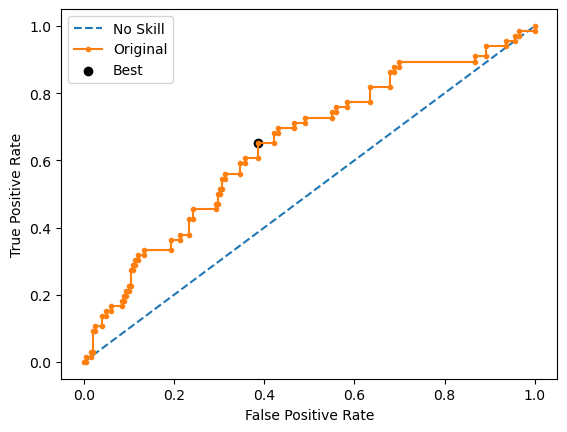

Learning rate set to 0.006922
0:	learn: 0.6918407	total: 3.42ms	remaining: 3.42s
1:	learn: 0.6907510	total: 6.32ms	remaining: 3.15s
2:	learn: 0.6896425	total: 11.8ms	remaining: 3.93s
3:	learn: 0.6886382	total: 16.6ms	remaining: 4.14s
4:	learn: 0.6879910	total: 19.9ms	remaining: 3.96s
5:	learn: 0.6864685	total: 22.4ms	remaining: 3.71s
6:	learn: 0.6849221	total: 24.4ms	remaining: 3.47s
7:	learn: 0.6837183	total: 26.8ms	remaining: 3.33s
8:	learn: 0.6829523	total: 29.8ms	remaining: 3.28s
9:	learn: 0.6820119	total: 32ms	remaining: 3.17s
10:	learn: 0.6808589	total: 33.7ms	remaining: 3.03s
11:	learn: 0.6794416	total: 35.4ms	remaining: 2.91s
12:	learn: 0.6777141	total: 37.6ms	remaining: 2.86s
13:	learn: 0.6770997	total: 39.4ms	remaining: 2.77s
14:	learn: 0.6759202	total: 41.1ms	remaining: 2.7s
15:	learn: 0.6747026	total: 43.5ms	remaining: 2.67s
16:	learn: 0.6735657	total: 45.5ms	remaining: 2.63s
17:	learn: 0.6723484	total: 47.4ms	remaining: 2.58s
18:	learn: 0.6718290	total: 49.3ms	remaining: 2

210:	learn: 0.5231010	total: 396ms	remaining: 1.48s
211:	learn: 0.5226836	total: 398ms	remaining: 1.48s
212:	learn: 0.5220716	total: 399ms	remaining: 1.48s
213:	learn: 0.5217768	total: 401ms	remaining: 1.47s
214:	learn: 0.5208076	total: 403ms	remaining: 1.47s
215:	learn: 0.5204352	total: 404ms	remaining: 1.47s
216:	learn: 0.5196858	total: 406ms	remaining: 1.47s
217:	learn: 0.5191213	total: 408ms	remaining: 1.46s
218:	learn: 0.5184361	total: 410ms	remaining: 1.46s
219:	learn: 0.5179633	total: 411ms	remaining: 1.46s
220:	learn: 0.5171982	total: 413ms	remaining: 1.46s
221:	learn: 0.5165431	total: 415ms	remaining: 1.45s
222:	learn: 0.5156535	total: 417ms	remaining: 1.45s
223:	learn: 0.5147365	total: 418ms	remaining: 1.45s
224:	learn: 0.5142244	total: 420ms	remaining: 1.45s
225:	learn: 0.5137813	total: 422ms	remaining: 1.44s
226:	learn: 0.5134026	total: 423ms	remaining: 1.44s
227:	learn: 0.5129308	total: 425ms	remaining: 1.44s
228:	learn: 0.5123302	total: 427ms	remaining: 1.44s
229:	learn: 

432:	learn: 0.4154878	total: 796ms	remaining: 1.04s
433:	learn: 0.4150181	total: 798ms	remaining: 1.04s
434:	learn: 0.4143747	total: 800ms	remaining: 1.04s
435:	learn: 0.4139602	total: 802ms	remaining: 1.04s
436:	learn: 0.4139176	total: 803ms	remaining: 1.03s
437:	learn: 0.4136685	total: 805ms	remaining: 1.03s
438:	learn: 0.4134150	total: 807ms	remaining: 1.03s
439:	learn: 0.4129831	total: 809ms	remaining: 1.03s
440:	learn: 0.4124569	total: 811ms	remaining: 1.03s
441:	learn: 0.4121341	total: 812ms	remaining: 1.02s
442:	learn: 0.4116797	total: 814ms	remaining: 1.02s
443:	learn: 0.4115041	total: 816ms	remaining: 1.02s
444:	learn: 0.4113562	total: 818ms	remaining: 1.02s
445:	learn: 0.4111601	total: 819ms	remaining: 1.02s
446:	learn: 0.4109210	total: 821ms	remaining: 1.02s
447:	learn: 0.4103423	total: 823ms	remaining: 1.01s
448:	learn: 0.4101632	total: 825ms	remaining: 1.01s
449:	learn: 0.4097806	total: 827ms	remaining: 1.01s
450:	learn: 0.4095395	total: 829ms	remaining: 1.01s
451:	learn: 

646:	learn: 0.3445801	total: 1.19s	remaining: 647ms
647:	learn: 0.3443111	total: 1.19s	remaining: 645ms
648:	learn: 0.3440360	total: 1.19s	remaining: 643ms
649:	learn: 0.3438742	total: 1.19s	remaining: 641ms
650:	learn: 0.3435596	total: 1.19s	remaining: 639ms
651:	learn: 0.3433770	total: 1.19s	remaining: 638ms
652:	learn: 0.3430481	total: 1.2s	remaining: 636ms
653:	learn: 0.3429140	total: 1.2s	remaining: 634ms
654:	learn: 0.3426658	total: 1.2s	remaining: 632ms
655:	learn: 0.3422475	total: 1.2s	remaining: 630ms
656:	learn: 0.3419850	total: 1.2s	remaining: 628ms
657:	learn: 0.3416691	total: 1.21s	remaining: 627ms
658:	learn: 0.3413495	total: 1.21s	remaining: 625ms
659:	learn: 0.3410458	total: 1.21s	remaining: 623ms
660:	learn: 0.3406194	total: 1.21s	remaining: 621ms
661:	learn: 0.3401805	total: 1.21s	remaining: 619ms
662:	learn: 0.3400724	total: 1.21s	remaining: 617ms
663:	learn: 0.3399354	total: 1.22s	remaining: 615ms
664:	learn: 0.3396189	total: 1.22s	remaining: 613ms
665:	learn: 0.339

858:	learn: 0.2821953	total: 1.57s	remaining: 258ms
859:	learn: 0.2817691	total: 1.57s	remaining: 256ms
860:	learn: 0.2815739	total: 1.57s	remaining: 254ms
861:	learn: 0.2813530	total: 1.58s	remaining: 252ms
862:	learn: 0.2811650	total: 1.58s	remaining: 251ms
863:	learn: 0.2808026	total: 1.58s	remaining: 249ms
864:	learn: 0.2804472	total: 1.58s	remaining: 247ms
865:	learn: 0.2800817	total: 1.58s	remaining: 245ms
866:	learn: 0.2796533	total: 1.59s	remaining: 243ms
867:	learn: 0.2792005	total: 1.59s	remaining: 241ms
868:	learn: 0.2788017	total: 1.59s	remaining: 240ms
869:	learn: 0.2785288	total: 1.59s	remaining: 238ms
870:	learn: 0.2782086	total: 1.59s	remaining: 236ms
871:	learn: 0.2777491	total: 1.59s	remaining: 234ms
872:	learn: 0.2774480	total: 1.6s	remaining: 232ms
873:	learn: 0.2772915	total: 1.6s	remaining: 230ms
874:	learn: 0.2770511	total: 1.6s	remaining: 229ms
875:	learn: 0.2767104	total: 1.6s	remaining: 227ms
876:	learn: 0.2763011	total: 1.6s	remaining: 225ms
877:	learn: 0.275

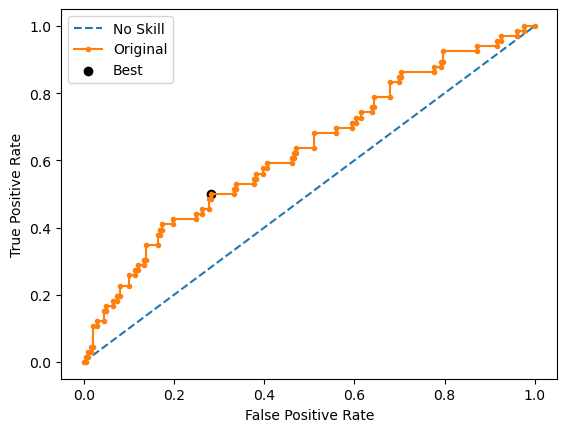

Ave Test G-mean: 0.603135949218022
Stdev Test G-mean: 0.015549252415290168
Ave Test Specificity: 0.6108910891089109
Ave Test Recall: 0.5969696969696969
Ave Test NPV: 0.8229710322552432
Ave Test Accuracy: 0.6074626865671642
Ave Test Precision: 0.3339706030233755
Ave Test F1-Score: 0.4279461156085643
Ave Runtime: 1.9771630764007568


In [91]:
ho_t03_catboost_gs, ho_t03_catboost_be, ho_t03_catboost_model_info, ho_t03_catboost_metrics_df = catboost_class2(ho_t03, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [115]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t03_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t03_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t03_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.625461,0.026161,0.594305,NaN,0.624752,0.627273,0.353527,0.451897,0.625373
6,LightGBM,0.625354,0.027542,0.595791,0.736876,0.617822,0.633333,0.351452,0.451981,0.621642
7,Extreme Gradient Boosting (XGBoost),0.616094,0.019704,0.592548,0.847731,0.646535,0.587879,0.352206,0.440283,0.632090
4,Random Forest,0.608303,0.029580,0.606324,0.620860,0.628713,0.590909,0.341882,0.432624,0.619403
9,CatBoost,0.603136,0.015549,0.560588,0.942325,0.610891,0.596970,0.333971,0.427946,0.607463
8,AdaBoost,0.594210,0.021775,0.607467,0.942882,0.634653,0.560606,0.333592,0.417152,0.616418
2,Logistic Regression,0.577981,0.039071,0.609347,NaN,0.631683,0.530303,0.320972,0.399454,0.606716
5,Gradient Boosting Machine (GBM),0.557046,0.047712,0.556030,0.873931,0.685149,0.454545,0.320339,0.375654,0.628358
0,k-Nearest Neighbors,0.538957,0.044993,0.571672,0.686911,0.616832,0.472727,0.289695,0.358345,0.581343
1,SVM Classifier,0.527289,0.020905,0.527238,0.250985,0.479208,0.593939,0.272017,0.371569,0.507463


In [131]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t03_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.632090,Extreme Gradient Boosting (XGBoost)
Highest Test G-mean,0.625461,Decision Tree
Highest Test Recall,0.633333,LightGBM
Highest Test Precision,0.353527,Decision Tree
Highest Test Specificity,0.685149,Gradient Boosting Machine (GBM)
Highest Test F1-score,0.451981,LightGBM


# HO-T04 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2176 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5735210065262974
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 137.0485918521881 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


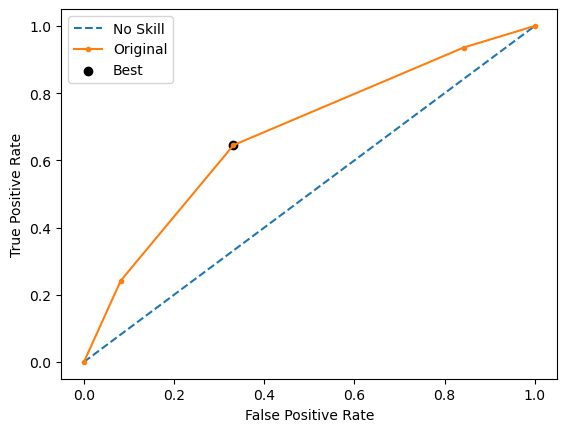

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


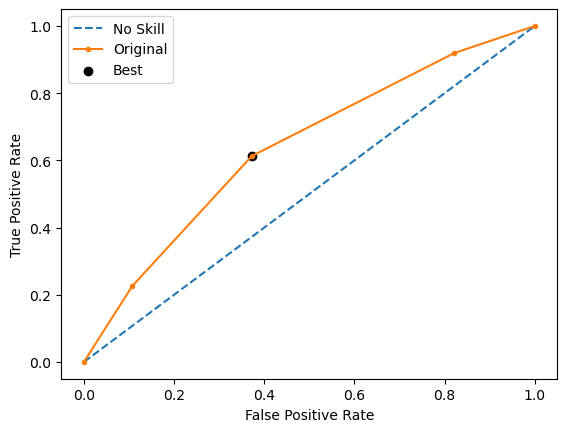

Run 3 - Random State: 2
Test G-mean: 0.6415757839135445
Best Threshold=0.544160, G-Mean=0.642


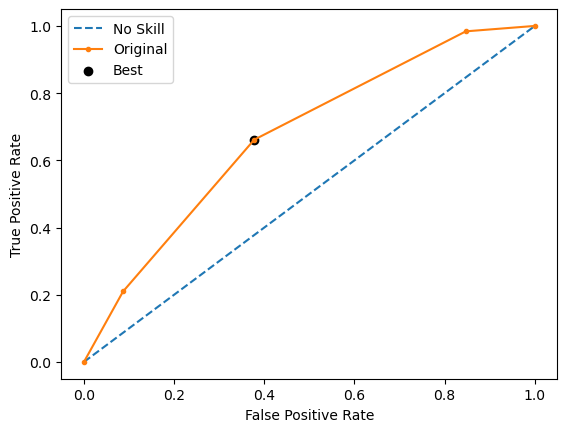

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


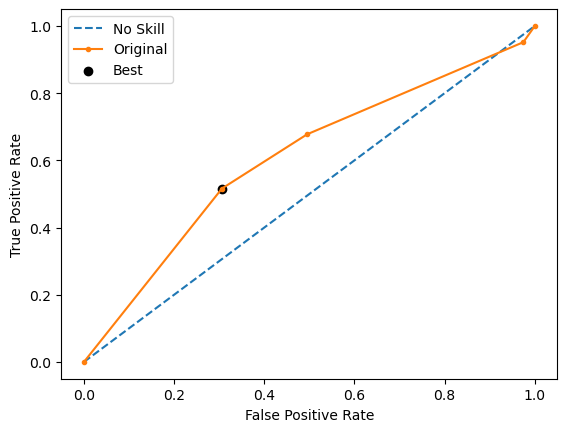

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


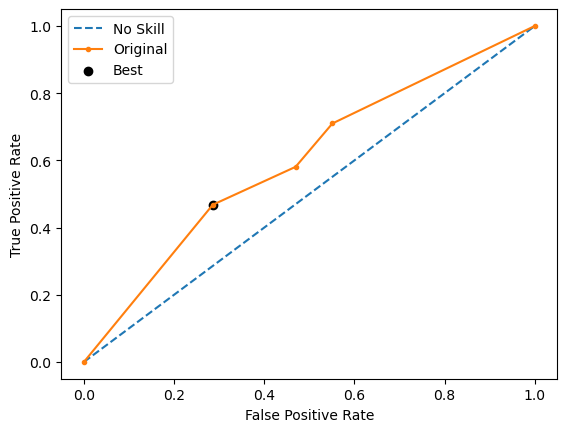

Ave Test G-mean: 0.6116872427478487
Stdev Test G-mean: 0.04156076174606436
Ave Test Specificity: 0.5908163265306122
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835604694092089
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3326449471612906
Ave Test F1-Score: 0.4356965853779212
Ave Runtime: 0.02649798393249512


In [93]:
ho_t04_dt_gs, ho_t04_dt_be, ho_t04_dt_model_info, ho_t04_dt_metrics_df = dt_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.566396197328405
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1000000.0, max_iter=1000,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 60.46552872657776 secs


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 1 - Random State: 0
Test G-mean: 0.5878963512522154
Best Threshold=0.548362, G-Mean=0.598


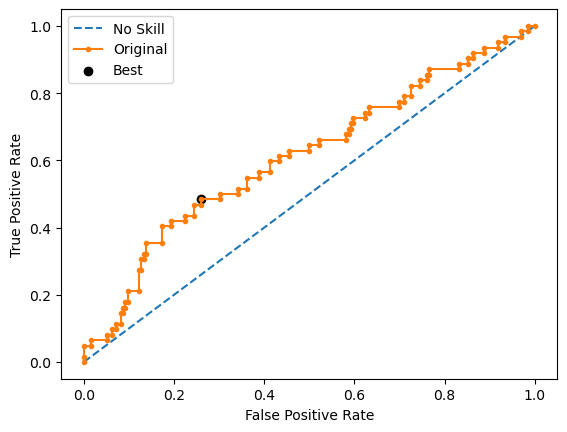

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 2 - Random State: 1
Test G-mean: 0.5395027335179478
Best Threshold=0.499837, G-Mean=0.549


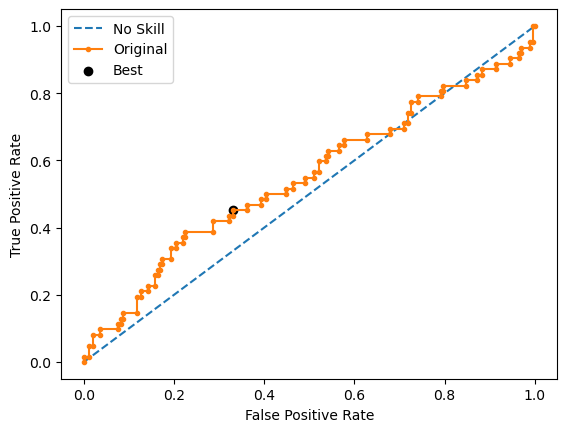

Run 3 - Random State: 2
Test G-mean: 0.6085305366932837
Best Threshold=0.524177, G-Mean=0.628


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


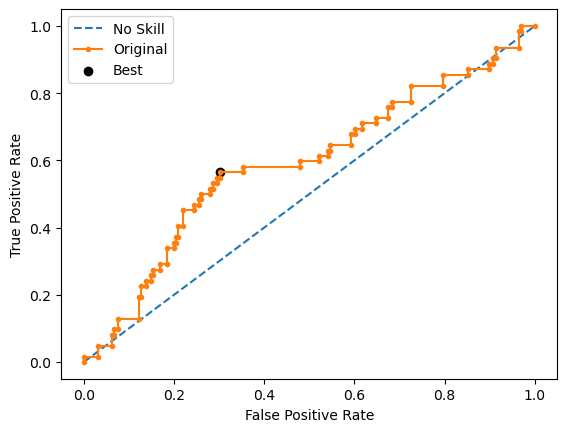

Run 4 - Random State: 3
Test G-mean: 0.58184628163935
Best Threshold=0.534601, G-Mean=0.607


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


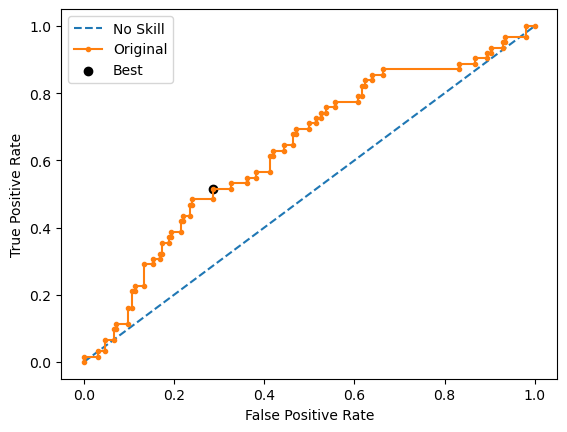

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 5 - Random State: 4
Test G-mean: 0.5782997029327555
Best Threshold=0.502373, G-Mean=0.578


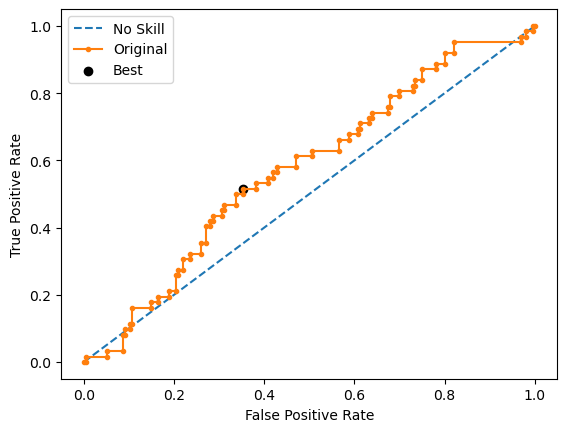

Ave Test G-mean: 0.5792151212071105
Stdev Test G-mean: 0.025097769183906406
Ave Test Specificity: 0.636734693877551
Ave Test Recall: 0.5290322580645161
Ave Test NPV: 0.8108590922039347
Ave Test Accuracy: 0.6108527131782946
Ave Test Precision: 0.3148000925977251
Ave Test F1-Score: 0.39432159731756883
Ave Runtime: 0.7005253791809082


In [94]:
ho_t04_logreg_gs, ho_t04_logreg_be, ho_t04_logreg_model_info, ho_t04_logreg_metrics_df = logreg_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5465020377701582
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.28942545253010576
Std Train Score (G-mean) 0.04002896322053357
GridSearchCV Runtime: 121.1893994808197 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.56542060523958
Best Threshold=0.500000, G-Mean=0.456


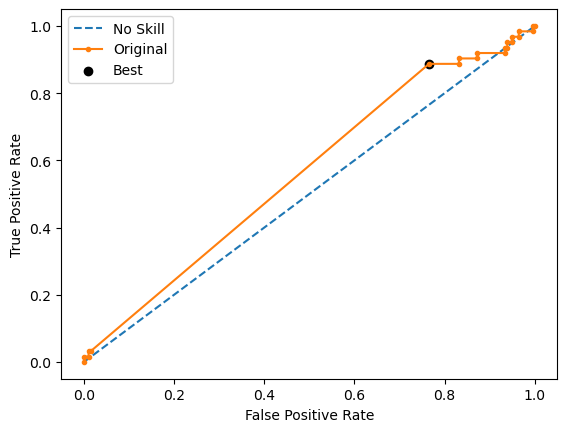

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 2 - Random State: 1
Test G-mean: 0.524890659167824
Best Threshold=0.505328, G-Mean=0.348


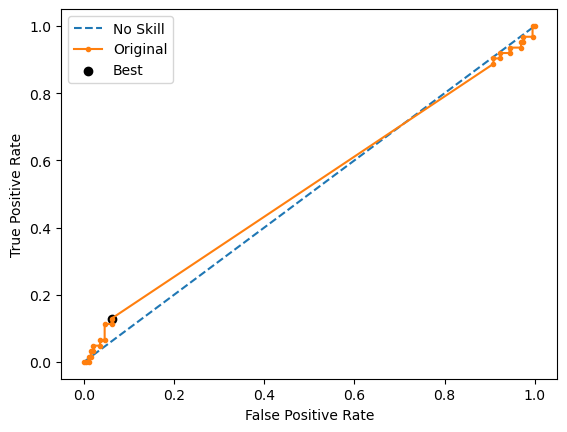

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.46032518488495494
Best Threshold=0.506122, G-Mean=0.392


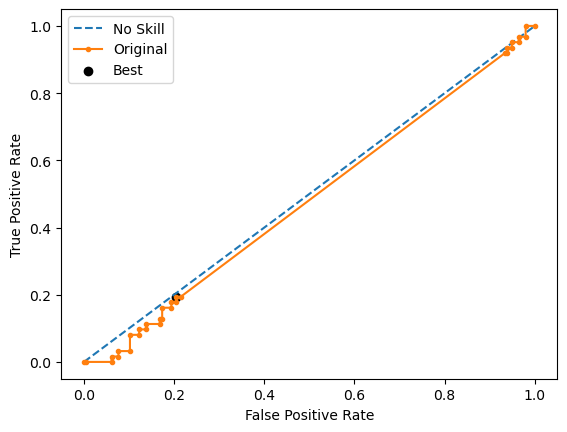

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.5018071358400424
Best Threshold=0.500000, G-Mean=0.398


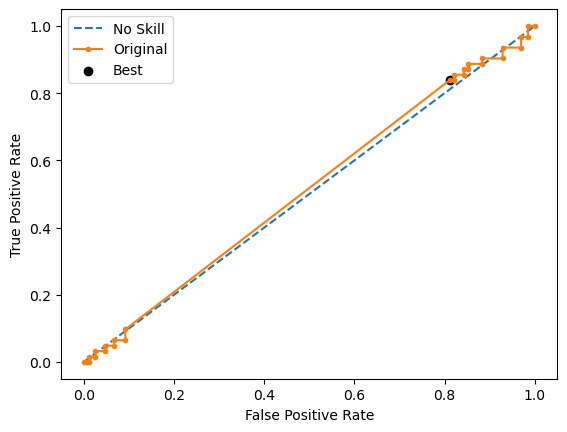

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.5497021756333007
Best Threshold=0.500000, G-Mean=0.071


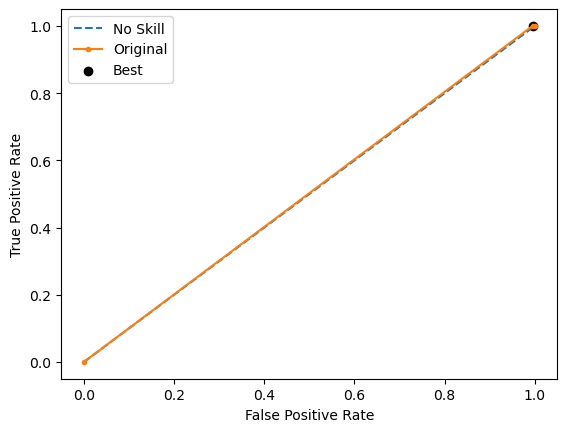

Ave Test G-mean: 0.5204291521531405
Stdev Test G-mean: 0.04141350073430699
Ave Test Specificity: 0.48673469387755103
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.7838073691014869
Ave Test Accuracy: 0.5069767441860465
Ave Test Precision: 0.2597447688123274
Ave Test F1-Score: 0.3556008716015488
Ave Runtime: 0.3760417938232422


In [95]:
ho_t04_svm_gs, ho_t04_svm_be, ho_t04_svm_model_info, ho_t04_svm_metrics_df = svm_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [96]:
ho_t04_knn_gs, ho_t04_knn_be, ho_t04_knn_model_info, ho_t04_knn_metrics_df = knn_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'braycurtis', 'classifier__n_neighbors': 15, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5826196210316088
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='braycurtis', n_neighbors=15))])
Mean Train Score (G-mean) 0.6932164601447329
Std Train Score (G-mean) 0.014660210807965587
GridSearchCV Runtime: 102.55508732795715 secs
Run 1 - Random State: 0
Test G-mean: 0.4786419234137801
Run 2 - Random State: 1
Test G-mean: 0.5329035326540886
Run 3 - Random State: 2
Test G-mean: 0.5420136546650075
Run 4 - Random State: 3
Test G-mean: 0.5395789937110657
Run 5 - Random State: 4
Test G-mean: 0.5054834277410774
Ave Test G-mean: 0.5197243064370038
Stdev Test G-mean: 0.027181245720901265
Ave Test Specificity: 0.58571428571428

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 1, 'classifier__max_depth': 3, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5912739890267533
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
         

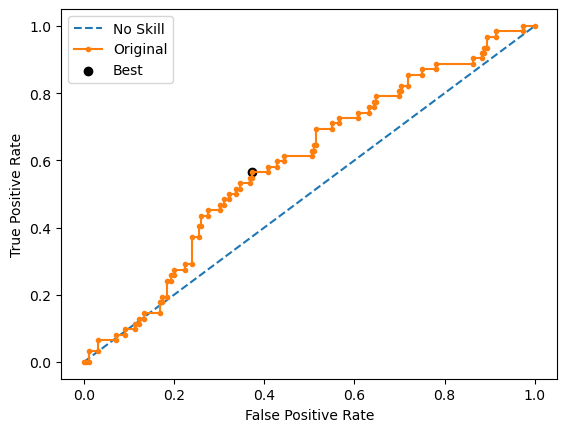

Run 2 - Random State: 1
Test G-mean: 0.5494026919959077
Best Threshold=0.311381, G-Mean=0.568


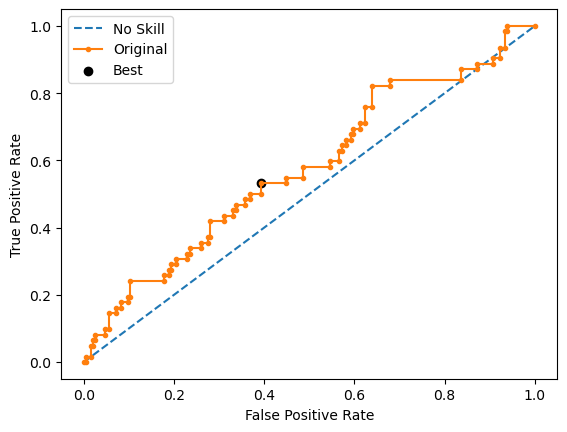

Run 3 - Random State: 2
Test G-mean: 0.5027901086446398
Best Threshold=0.096407, G-Mean=0.542


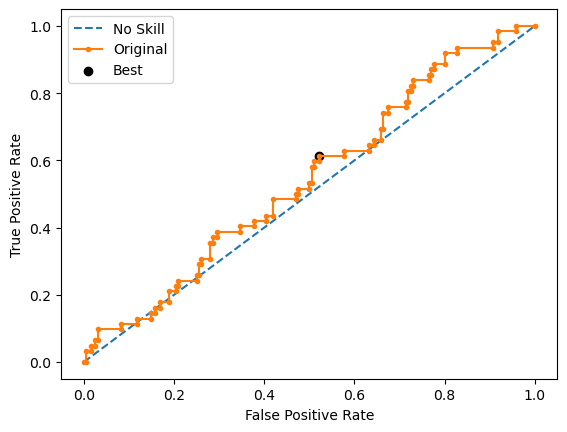

Run 4 - Random State: 3
Test G-mean: 0.5665110992232372
Best Threshold=0.150865, G-Mean=0.620


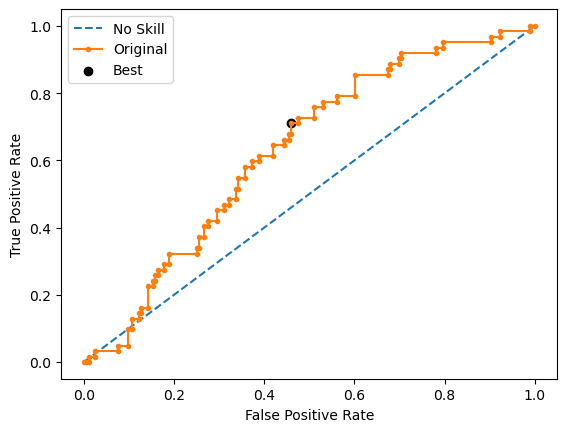

Run 5 - Random State: 4
Test G-mean: 0.5120342421893841
Best Threshold=0.398840, G-Mean=0.536


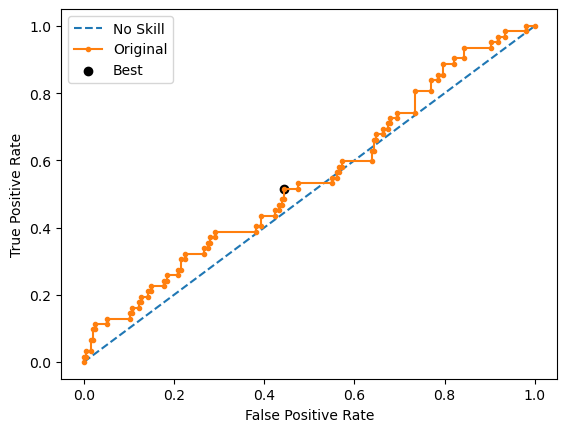

Ave Test G-mean: 0.541322739100613
Stdev Test G-mean: 0.03254310896752524
Ave Test Specificity: 0.65
Ave Test Recall: 0.4516129032258065
Ave Test NPV: 0.7892376226611377
Ave Test Accuracy: 0.6023255813953489
Ave Test Precision: 0.2902350640086864
Ave Test F1-Score: 0.3532031740086815
Ave Runtime: 0.1808323383331299


In [97]:
ho_t04_xgb_gs, ho_t04_xgb_be, ho_t04_xgb_model_info, ho_t04_xgb_metrics_df = xgb_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002645 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 707
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

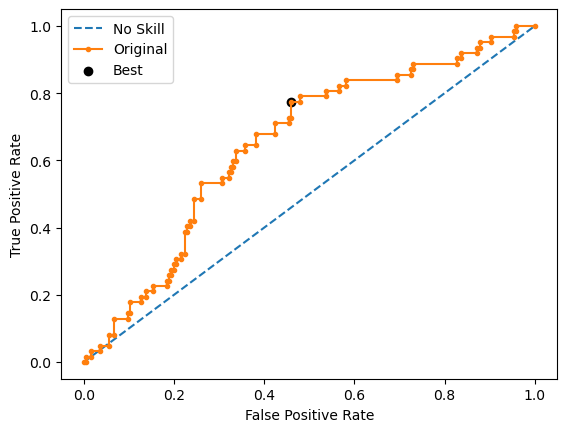

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 718
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

Best Threshold=0.485530, G-Mean=0.598


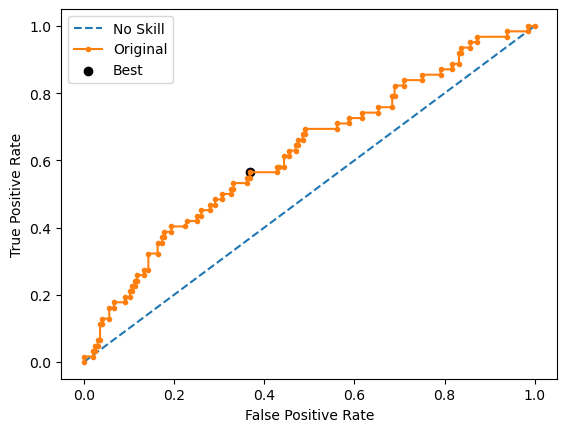

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001000 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 712
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

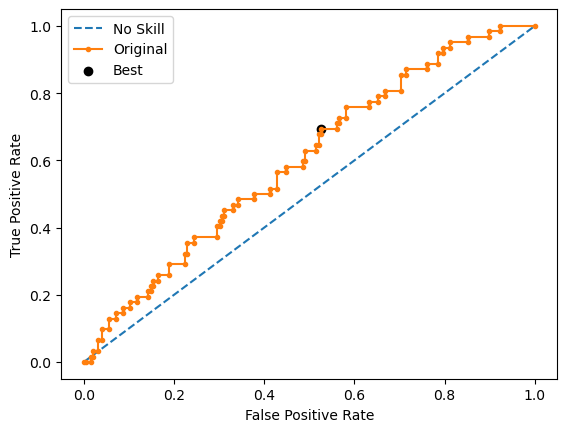

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 726
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

Run 4 - Random State: 3
Test G-mean: 0.5887356041438042
Best Threshold=0.558969, G-Mean=0.608


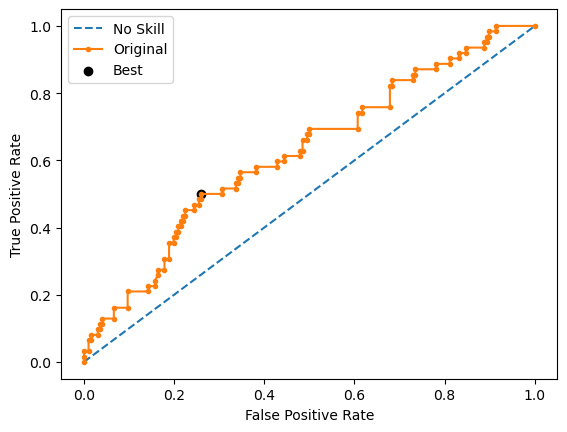

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001000 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 701
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

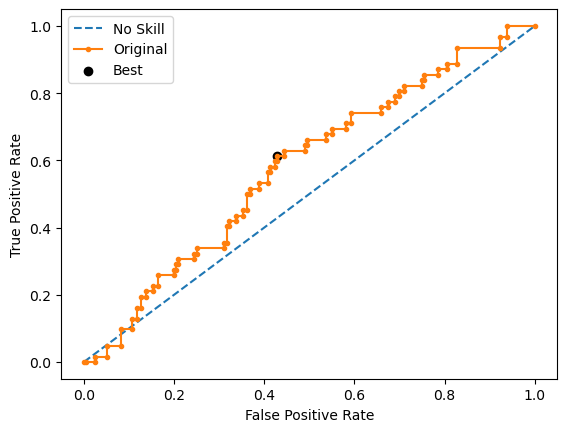

Ave Test G-mean: 0.5921028348222019
Stdev Test G-mean: 0.02883261836274458
Ave Test Specificity: 0.6214285714285714
Ave Test Recall: 0.5677419354838709
Ave Test NPV: 0.8202319796664259
Ave Test Accuracy: 0.6085271317829457
Ave Test Precision: 0.3218362919045908
Ave Test F1-Score: 0.4099620423940956
Ave Runtime: 0.21264591217041015


In [98]:
ho_t04_lgbm_gs, ho_t04_lgbm_be, ho_t04_lgbm_model_info, ho_t04_lgbm_metrics_df = lgbm_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5911804668139743
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9483786822029643
Std Train Score (G-mean) 0.0055816521260718
GridSearchCV Runtime: 14.247954607009888 secs
Run 1 - Random State: 0
Test G-mean: 0.601183822262458
Best Threshold=0.880797, G-Mean=0.601


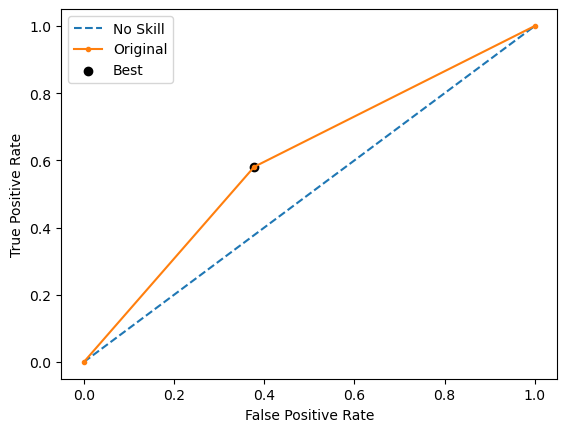

Run 2 - Random State: 1
Test G-mean: 0.580572009143728
Best Threshold=0.880797, G-Mean=0.581


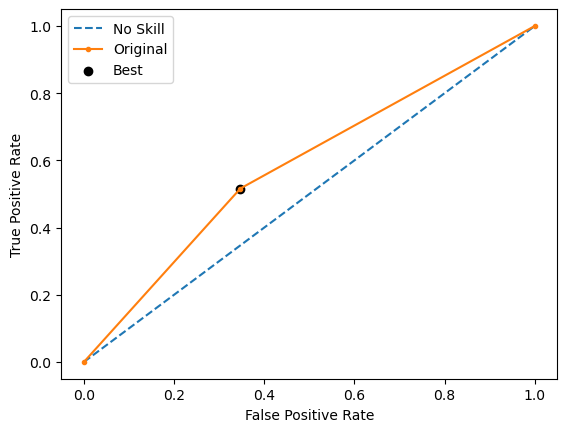

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.880797, G-Mean=0.556


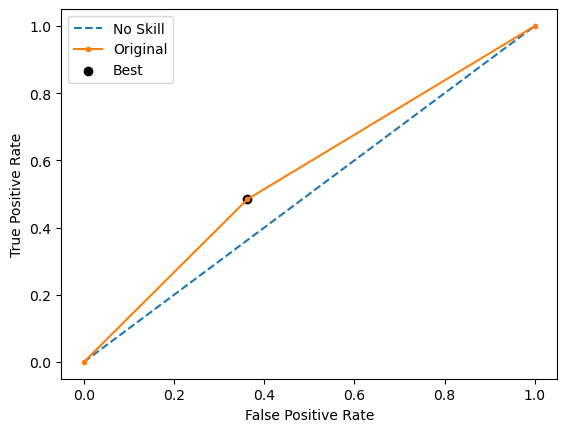

Run 4 - Random State: 3
Test G-mean: 0.5887356041438042
Best Threshold=0.880797, G-Mean=0.589


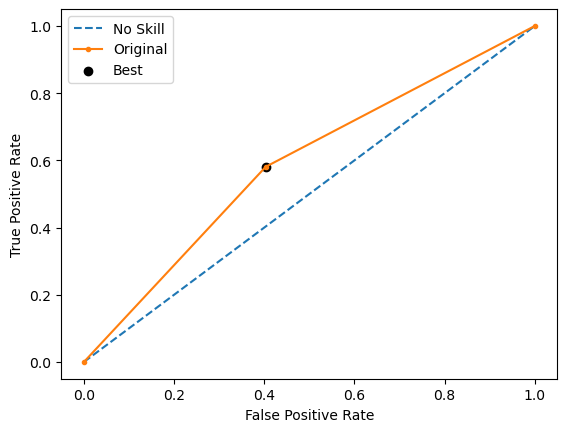

Run 5 - Random State: 4
Test G-mean: 0.5684687168417007
Best Threshold=0.880797, G-Mean=0.568


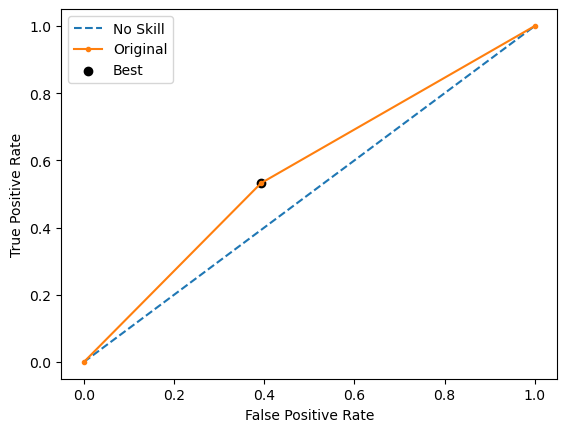

Ave Test G-mean: 0.5788939977708838
Stdev Test G-mean: 0.017691909850058078
Ave Test Specificity: 0.6234693877551021
Ave Test Recall: 0.5387096774193548
Ave Test NPV: 0.8105730245575445
Ave Test Accuracy: 0.6031007751937985
Ave Test Precision: 0.31146918170077875
Ave Test F1-Score: 0.39445302606331245
Ave Runtime: 0.2738607883453369


In [99]:
ho_t04_adaboost_gs, ho_t04_adaboost_be, ho_t04_adaboost_model_info, ho_t04_adaboost_metrics_df = adaboost_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.569496788354359
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8832905760613396
Std Train Score (G-mean) 0.009894942354084993
GridSearchCV Runtime: 148.93202877044678 secs
Run 1 - Random State: 0
Test G-mean: 0.5511971530352403
Best Threshold=0.443356, G-Mean=0.608


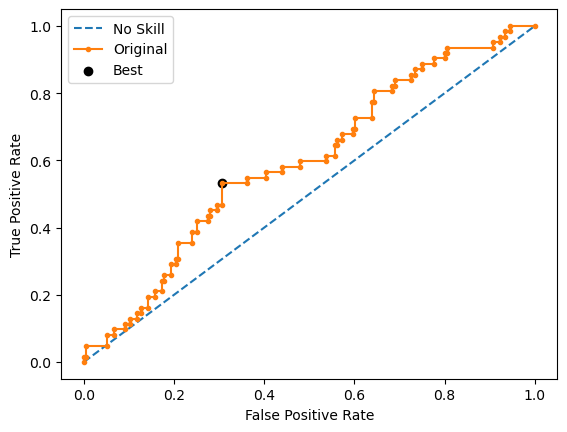

Run 2 - Random State: 1
Test G-mean: 0.5374396179933225
Best Threshold=0.432180, G-Mean=0.572


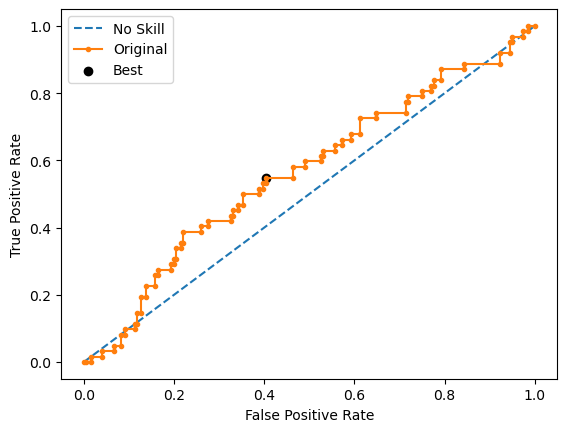

Run 3 - Random State: 2
Test G-mean: 0.5105857690125177
Best Threshold=0.283692, G-Mean=0.584


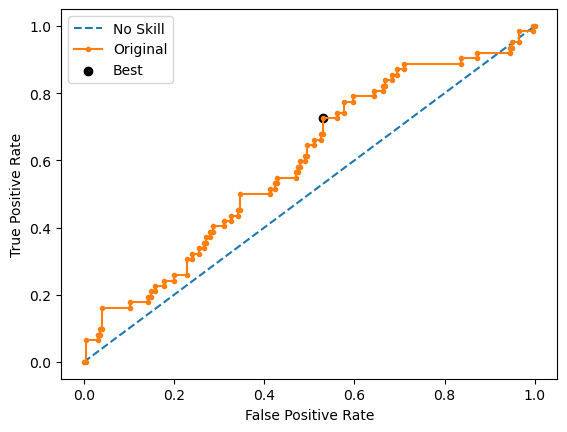

Run 4 - Random State: 3
Test G-mean: 0.533443728973888
Best Threshold=0.324085, G-Mean=0.625


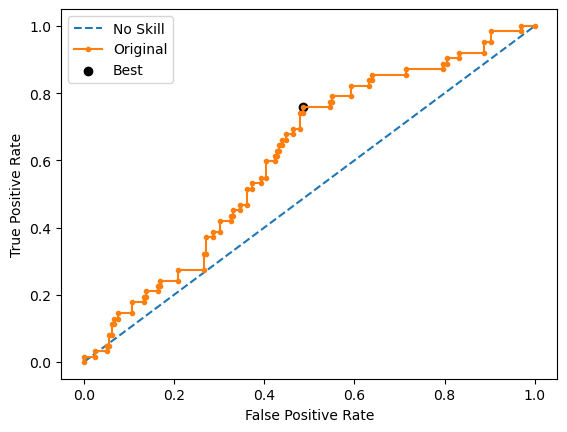

Run 5 - Random State: 4
Test G-mean: 0.47136572685434985
Best Threshold=0.397780, G-Mean=0.566


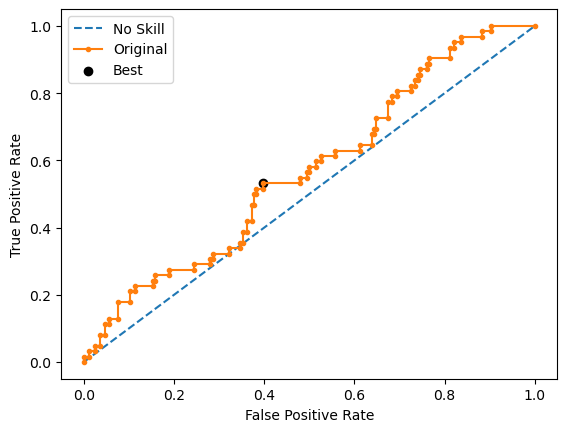

Ave Test G-mean: 0.5208063991738637
Stdev Test G-mean: 0.03126021974224556
Ave Test Specificity: 0.703061224489796
Ave Test Recall: 0.3870967741935484
Ave Test NPV: 0.7839058603557907
Ave Test Accuracy: 0.6271317829457365
Ave Test Precision: 0.2920392567435058
Ave Test F1-Score: 0.3325622048202667
Ave Runtime: 0.7204466819763183


In [100]:
ho_t04_gbm_gs, ho_t04_gbm_be, ho_t04_gbm_model_info, ho_t04_gbm_metrics_df = gbm_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5867223262619821
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=2,
                                        min_samples_leaf=2, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.6142979946444345
Std Train Score (G-mean) 0.022890461687223782
GridSearchCV Runtime: 368.93217635154724 secs
Run 1 - Random State: 0
Test G-mean: 0.6165908950002709
Best Threshold=0.490636, G-Mean=0

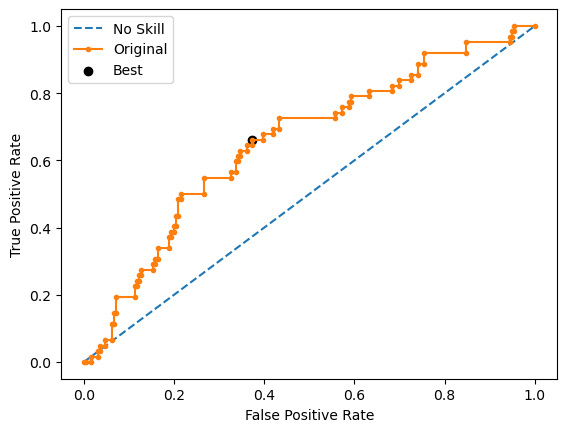

Run 2 - Random State: 1
Test G-mean: 0.6006360464564467
Best Threshold=0.492155, G-Mean=0.618


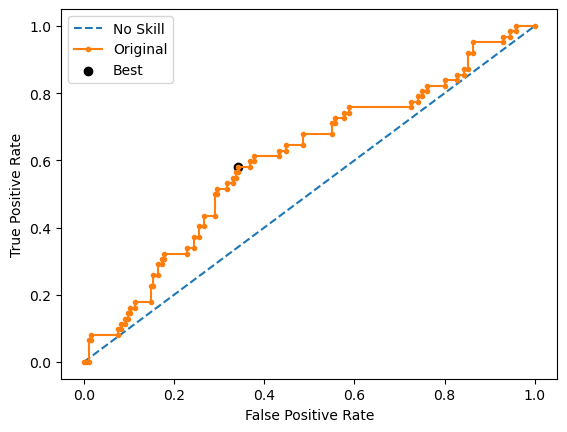

Run 3 - Random State: 2
Test G-mean: 0.5612574052230482
Best Threshold=0.482957, G-Mean=0.589


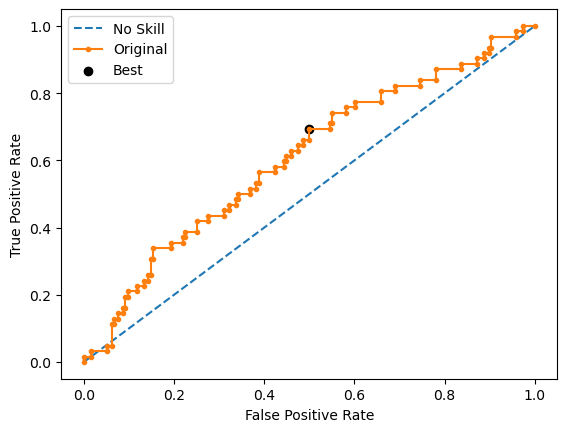

Run 4 - Random State: 3
Test G-mean: 0.6242836579493493
Best Threshold=0.498552, G-Mean=0.630


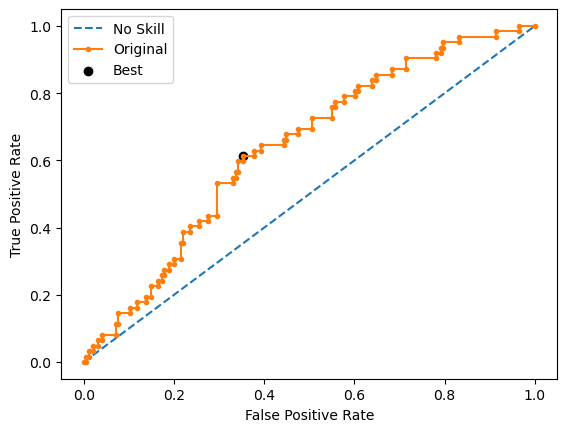

Run 5 - Random State: 4
Test G-mean: 0.5785842292490759
Best Threshold=0.505205, G-Mean=0.598


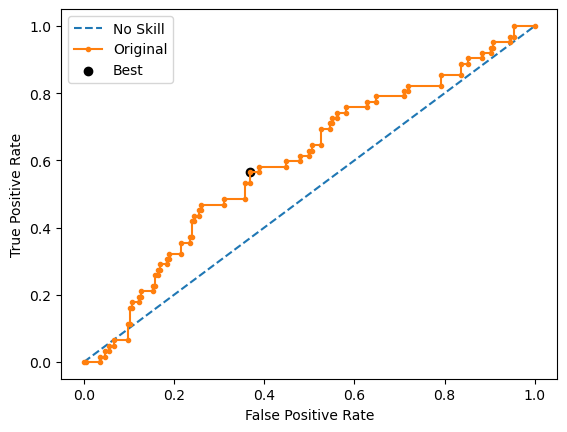

Ave Test G-mean: 0.5962704467756382
Stdev Test G-mean: 0.026246116122420154
Ave Test Specificity: 0.6551020408163265
Ave Test Recall: 0.5451612903225806
Ave Test NPV: 0.8200197816319441
Ave Test Accuracy: 0.6286821705426358
Ave Test Precision: 0.3343827245914533
Ave Test F1-Score: 0.41363612767624575
Ave Runtime: 0.5926367282867432


In [101]:
ho_t04_rf_gs, ho_t04_rf_be, ho_t04_rf_model_info, ho_t04_rf_metrics_df = rf_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6912202	total: 2.69ms	remaining: 2.69s
1:	learn: 0.6901033	total: 4.74ms	remaining: 2.37s
2:	learn: 0.6886959	total: 6.95ms	remaining: 2.31s
3:	learn: 0.6878366	total: 8.78ms	remaining: 2.19s
4:	learn: 0.6868945	total: 10.6ms	remaining: 2.11s
5:	learn: 0.6858509	total: 12.3ms	remaining: 2.04s
6:	learn: 0.6850191	total: 14.3ms	remaining: 2.02s
7:	learn: 0.6839898	total: 16.3ms	remaining: 2.02s
8:	learn: 0.6827189	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6813587	total: 19.7ms	remaining: 1.95s
10:	learn: 0.6798945	total: 21.4ms	remaining: 1.93s
11:	learn: 0.6787746	total: 23.4ms	remaining: 1.93s
12:	learn: 0.6776396	total: 25.2ms	remaining: 1.91s
13:	learn: 0.6768444	total: 27.1ms	remaining: 1.91s
14:	learn: 0.6758580	total: 29ms	remaining: 1.9s
15:	learn: 0.6750210	total: 30.7ms	remaining: 1.89s
16:	learn: 0.6738575	total: 32.6ms	remaining: 1.88s
17:	learn: 0.6730025	total: 34.6ms	rem

218:	learn: 0.5171492	total: 398ms	remaining: 1.42s
219:	learn: 0.5165941	total: 400ms	remaining: 1.42s
220:	learn: 0.5160082	total: 402ms	remaining: 1.42s
221:	learn: 0.5150614	total: 404ms	remaining: 1.42s
222:	learn: 0.5141560	total: 406ms	remaining: 1.41s
223:	learn: 0.5134395	total: 408ms	remaining: 1.41s
224:	learn: 0.5128833	total: 409ms	remaining: 1.41s
225:	learn: 0.5121608	total: 411ms	remaining: 1.41s
226:	learn: 0.5116542	total: 413ms	remaining: 1.41s
227:	learn: 0.5113933	total: 415ms	remaining: 1.4s
228:	learn: 0.5108533	total: 416ms	remaining: 1.4s
229:	learn: 0.5103182	total: 418ms	remaining: 1.4s
230:	learn: 0.5097704	total: 420ms	remaining: 1.4s
231:	learn: 0.5088617	total: 422ms	remaining: 1.4s
232:	learn: 0.5080041	total: 424ms	remaining: 1.4s
233:	learn: 0.5073549	total: 426ms	remaining: 1.39s
234:	learn: 0.5070632	total: 427ms	remaining: 1.39s
235:	learn: 0.5065140	total: 429ms	remaining: 1.39s
236:	learn: 0.5061607	total: 431ms	remaining: 1.39s
237:	learn: 0.5057

432:	learn: 0.4128983	total: 786ms	remaining: 1.03s
433:	learn: 0.4120317	total: 788ms	remaining: 1.03s
434:	learn: 0.4118172	total: 790ms	remaining: 1.03s
435:	learn: 0.4113517	total: 792ms	remaining: 1.02s
436:	learn: 0.4110332	total: 794ms	remaining: 1.02s
437:	learn: 0.4104990	total: 796ms	remaining: 1.02s
438:	learn: 0.4102531	total: 798ms	remaining: 1.02s
439:	learn: 0.4097270	total: 800ms	remaining: 1.02s
440:	learn: 0.4092251	total: 802ms	remaining: 1.02s
441:	learn: 0.4090319	total: 804ms	remaining: 1.01s
442:	learn: 0.4085261	total: 806ms	remaining: 1.01s
443:	learn: 0.4081967	total: 807ms	remaining: 1.01s
444:	learn: 0.4078724	total: 809ms	remaining: 1.01s
445:	learn: 0.4074244	total: 811ms	remaining: 1.01s
446:	learn: 0.4069969	total: 813ms	remaining: 1s
447:	learn: 0.4069309	total: 815ms	remaining: 1s
448:	learn: 0.4066615	total: 817ms	remaining: 1s
449:	learn: 0.4062683	total: 819ms	remaining: 1s
450:	learn: 0.4060702	total: 820ms	remaining: 998ms
451:	learn: 0.4055246	to

651:	learn: 0.3364410	total: 1.19s	remaining: 633ms
652:	learn: 0.3361062	total: 1.19s	remaining: 631ms
653:	learn: 0.3356790	total: 1.19s	remaining: 629ms
654:	learn: 0.3354894	total: 1.19s	remaining: 627ms
655:	learn: 0.3352595	total: 1.19s	remaining: 625ms
656:	learn: 0.3348074	total: 1.19s	remaining: 624ms
657:	learn: 0.3345026	total: 1.2s	remaining: 622ms
658:	learn: 0.3342394	total: 1.2s	remaining: 620ms
659:	learn: 0.3340188	total: 1.2s	remaining: 618ms
660:	learn: 0.3339206	total: 1.2s	remaining: 616ms
661:	learn: 0.3337593	total: 1.2s	remaining: 615ms
662:	learn: 0.3337055	total: 1.21s	remaining: 613ms
663:	learn: 0.3334501	total: 1.21s	remaining: 611ms
664:	learn: 0.3330217	total: 1.21s	remaining: 609ms
665:	learn: 0.3325309	total: 1.21s	remaining: 607ms
666:	learn: 0.3322326	total: 1.21s	remaining: 605ms
667:	learn: 0.3320032	total: 1.21s	remaining: 603ms
668:	learn: 0.3317781	total: 1.22s	remaining: 602ms
669:	learn: 0.3316228	total: 1.22s	remaining: 600ms
670:	learn: 0.331

872:	learn: 0.2678953	total: 1.58s	remaining: 230ms
873:	learn: 0.2676026	total: 1.59s	remaining: 229ms
874:	learn: 0.2672758	total: 1.59s	remaining: 227ms
875:	learn: 0.2671647	total: 1.59s	remaining: 225ms
876:	learn: 0.2669019	total: 1.59s	remaining: 223ms
877:	learn: 0.2667495	total: 1.59s	remaining: 221ms
878:	learn: 0.2664863	total: 1.59s	remaining: 220ms
879:	learn: 0.2662242	total: 1.6s	remaining: 218ms
880:	learn: 0.2661277	total: 1.6s	remaining: 216ms
881:	learn: 0.2660146	total: 1.6s	remaining: 214ms
882:	learn: 0.2656992	total: 1.6s	remaining: 212ms
883:	learn: 0.2656167	total: 1.6s	remaining: 211ms
884:	learn: 0.2654976	total: 1.61s	remaining: 209ms
885:	learn: 0.2651929	total: 1.61s	remaining: 207ms
886:	learn: 0.2647130	total: 1.61s	remaining: 205ms
887:	learn: 0.2645115	total: 1.61s	remaining: 203ms
888:	learn: 0.2642440	total: 1.61s	remaining: 201ms
889:	learn: 0.2639725	total: 1.61s	remaining: 200ms
890:	learn: 0.2637215	total: 1.62s	remaining: 198ms
891:	learn: 0.263

54:	learn: 0.6370838	total: 101ms	remaining: 1.74s
55:	learn: 0.6363146	total: 103ms	remaining: 1.74s
56:	learn: 0.6358579	total: 105ms	remaining: 1.74s
57:	learn: 0.6351173	total: 107ms	remaining: 1.74s
58:	learn: 0.6340768	total: 109ms	remaining: 1.73s
59:	learn: 0.6334407	total: 111ms	remaining: 1.73s
60:	learn: 0.6325506	total: 112ms	remaining: 1.73s
61:	learn: 0.6318450	total: 114ms	remaining: 1.73s
62:	learn: 0.6313354	total: 116ms	remaining: 1.73s
63:	learn: 0.6302116	total: 118ms	remaining: 1.73s
64:	learn: 0.6291914	total: 120ms	remaining: 1.72s
65:	learn: 0.6282263	total: 121ms	remaining: 1.72s
66:	learn: 0.6269591	total: 123ms	remaining: 1.72s
67:	learn: 0.6261414	total: 125ms	remaining: 1.71s
68:	learn: 0.6253633	total: 127ms	remaining: 1.71s
69:	learn: 0.6241839	total: 129ms	remaining: 1.71s
70:	learn: 0.6229898	total: 131ms	remaining: 1.71s
71:	learn: 0.6219926	total: 132ms	remaining: 1.71s
72:	learn: 0.6209754	total: 134ms	remaining: 1.71s
73:	learn: 0.6200669	total: 136

273:	learn: 0.4861029	total: 501ms	remaining: 1.33s
274:	learn: 0.4855901	total: 503ms	remaining: 1.32s
275:	learn: 0.4854731	total: 505ms	remaining: 1.32s
276:	learn: 0.4850153	total: 507ms	remaining: 1.32s
277:	learn: 0.4844889	total: 508ms	remaining: 1.32s
278:	learn: 0.4839056	total: 510ms	remaining: 1.32s
279:	learn: 0.4832319	total: 512ms	remaining: 1.31s
280:	learn: 0.4828318	total: 514ms	remaining: 1.31s
281:	learn: 0.4819089	total: 516ms	remaining: 1.31s
282:	learn: 0.4815502	total: 517ms	remaining: 1.31s
283:	learn: 0.4811274	total: 519ms	remaining: 1.31s
284:	learn: 0.4807320	total: 521ms	remaining: 1.3s
285:	learn: 0.4800572	total: 522ms	remaining: 1.3s
286:	learn: 0.4793655	total: 524ms	remaining: 1.3s
287:	learn: 0.4787910	total: 526ms	remaining: 1.3s
288:	learn: 0.4783846	total: 528ms	remaining: 1.3s
289:	learn: 0.4778972	total: 530ms	remaining: 1.3s
290:	learn: 0.4771885	total: 532ms	remaining: 1.29s
291:	learn: 0.4766277	total: 533ms	remaining: 1.29s
292:	learn: 0.4760

492:	learn: 0.3891148	total: 900ms	remaining: 925ms
493:	learn: 0.3888724	total: 902ms	remaining: 924ms
494:	learn: 0.3885268	total: 904ms	remaining: 922ms
495:	learn: 0.3881086	total: 905ms	remaining: 920ms
496:	learn: 0.3877735	total: 907ms	remaining: 918ms
497:	learn: 0.3873887	total: 909ms	remaining: 916ms
498:	learn: 0.3872456	total: 910ms	remaining: 914ms
499:	learn: 0.3870941	total: 912ms	remaining: 912ms
500:	learn: 0.3866787	total: 914ms	remaining: 911ms
501:	learn: 0.3861773	total: 916ms	remaining: 909ms
502:	learn: 0.3857458	total: 918ms	remaining: 907ms
503:	learn: 0.3853718	total: 919ms	remaining: 905ms
504:	learn: 0.3852532	total: 921ms	remaining: 903ms
505:	learn: 0.3850338	total: 923ms	remaining: 901ms
506:	learn: 0.3847456	total: 925ms	remaining: 899ms
507:	learn: 0.3843451	total: 927ms	remaining: 898ms
508:	learn: 0.3840958	total: 929ms	remaining: 896ms
509:	learn: 0.3836871	total: 931ms	remaining: 894ms
510:	learn: 0.3832292	total: 932ms	remaining: 892ms
511:	learn: 

706:	learn: 0.3187154	total: 1.29s	remaining: 534ms
707:	learn: 0.3185673	total: 1.29s	remaining: 532ms
708:	learn: 0.3184133	total: 1.29s	remaining: 530ms
709:	learn: 0.3181170	total: 1.29s	remaining: 528ms
710:	learn: 0.3179197	total: 1.29s	remaining: 527ms
711:	learn: 0.3176111	total: 1.3s	remaining: 525ms
712:	learn: 0.3174261	total: 1.3s	remaining: 523ms
713:	learn: 0.3170125	total: 1.3s	remaining: 521ms
714:	learn: 0.3166566	total: 1.3s	remaining: 519ms
715:	learn: 0.3163929	total: 1.3s	remaining: 517ms
716:	learn: 0.3160221	total: 1.31s	remaining: 515ms
717:	learn: 0.3158573	total: 1.31s	remaining: 514ms
718:	learn: 0.3155488	total: 1.31s	remaining: 512ms
719:	learn: 0.3151202	total: 1.31s	remaining: 510ms
720:	learn: 0.3149632	total: 1.31s	remaining: 508ms
721:	learn: 0.3145886	total: 1.31s	remaining: 506ms
722:	learn: 0.3143173	total: 1.32s	remaining: 505ms
723:	learn: 0.3138118	total: 1.32s	remaining: 503ms
724:	learn: 0.3134974	total: 1.32s	remaining: 501ms
725:	learn: 0.313

926:	learn: 0.2544383	total: 1.69s	remaining: 133ms
927:	learn: 0.2540837	total: 1.69s	remaining: 131ms
928:	learn: 0.2538082	total: 1.69s	remaining: 129ms
929:	learn: 0.2535101	total: 1.69s	remaining: 127ms
930:	learn: 0.2533415	total: 1.7s	remaining: 126ms
931:	learn: 0.2529972	total: 1.7s	remaining: 124ms
932:	learn: 0.2527725	total: 1.7s	remaining: 122ms
933:	learn: 0.2524619	total: 1.7s	remaining: 120ms
934:	learn: 0.2521310	total: 1.7s	remaining: 118ms
935:	learn: 0.2517330	total: 1.7s	remaining: 117ms
936:	learn: 0.2513559	total: 1.71s	remaining: 115ms
937:	learn: 0.2508267	total: 1.71s	remaining: 113ms
938:	learn: 0.2504593	total: 1.71s	remaining: 111ms
939:	learn: 0.2502649	total: 1.71s	remaining: 109ms
940:	learn: 0.2501177	total: 1.71s	remaining: 107ms
941:	learn: 0.2498471	total: 1.72s	remaining: 106ms
942:	learn: 0.2494147	total: 1.72s	remaining: 104ms
943:	learn: 0.2491109	total: 1.72s	remaining: 102ms
944:	learn: 0.2488252	total: 1.72s	remaining: 100ms
945:	learn: 0.2486

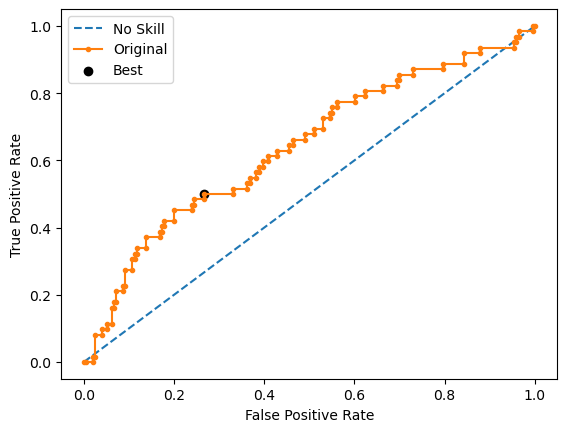

Learning rate set to 0.006754
0:	learn: 0.6917289	total: 1.93ms	remaining: 1.93s
1:	learn: 0.6902904	total: 3.7ms	remaining: 1.85s
2:	learn: 0.6887415	total: 5.64ms	remaining: 1.87s
3:	learn: 0.6872900	total: 7.6ms	remaining: 1.89s
4:	learn: 0.6860188	total: 9.52ms	remaining: 1.89s
5:	learn: 0.6850444	total: 11.4ms	remaining: 1.88s
6:	learn: 0.6836120	total: 13.2ms	remaining: 1.88s
7:	learn: 0.6826308	total: 14.9ms	remaining: 1.85s
8:	learn: 0.6809650	total: 16.7ms	remaining: 1.84s
9:	learn: 0.6793503	total: 18.6ms	remaining: 1.84s
10:	learn: 0.6783052	total: 20.3ms	remaining: 1.83s
11:	learn: 0.6769061	total: 22.2ms	remaining: 1.82s
12:	learn: 0.6759778	total: 24ms	remaining: 1.82s
13:	learn: 0.6751908	total: 25.7ms	remaining: 1.81s
14:	learn: 0.6740277	total: 27.4ms	remaining: 1.8s
15:	learn: 0.6729283	total: 29.2ms	remaining: 1.79s
16:	learn: 0.6716298	total: 30.9ms	remaining: 1.79s
17:	learn: 0.6696057	total: 33ms	remaining: 1.8s
18:	learn: 0.6680976	total: 34.7ms	remaining: 1.79s


212:	learn: 0.4974198	total: 388ms	remaining: 1.43s
213:	learn: 0.4970721	total: 390ms	remaining: 1.43s
214:	learn: 0.4967836	total: 392ms	remaining: 1.43s
215:	learn: 0.4960838	total: 394ms	remaining: 1.43s
216:	learn: 0.4957222	total: 395ms	remaining: 1.43s
217:	learn: 0.4947621	total: 397ms	remaining: 1.42s
218:	learn: 0.4940700	total: 399ms	remaining: 1.42s
219:	learn: 0.4931376	total: 401ms	remaining: 1.42s
220:	learn: 0.4924292	total: 403ms	remaining: 1.42s
221:	learn: 0.4918117	total: 405ms	remaining: 1.42s
222:	learn: 0.4914587	total: 406ms	remaining: 1.42s
223:	learn: 0.4909415	total: 408ms	remaining: 1.41s
224:	learn: 0.4905916	total: 410ms	remaining: 1.41s
225:	learn: 0.4896418	total: 412ms	remaining: 1.41s
226:	learn: 0.4888000	total: 414ms	remaining: 1.41s
227:	learn: 0.4877236	total: 416ms	remaining: 1.41s
228:	learn: 0.4870981	total: 417ms	remaining: 1.4s
229:	learn: 0.4868082	total: 419ms	remaining: 1.4s
230:	learn: 0.4864293	total: 421ms	remaining: 1.4s
231:	learn: 0.4

415:	learn: 0.4017044	total: 759ms	remaining: 1.06s
416:	learn: 0.4013588	total: 761ms	remaining: 1.06s
417:	learn: 0.4009219	total: 763ms	remaining: 1.06s
418:	learn: 0.4006458	total: 765ms	remaining: 1.06s
419:	learn: 0.4002349	total: 767ms	remaining: 1.06s
420:	learn: 0.4000563	total: 769ms	remaining: 1.06s
421:	learn: 0.3993406	total: 771ms	remaining: 1.05s
422:	learn: 0.3988497	total: 773ms	remaining: 1.05s
423:	learn: 0.3985765	total: 775ms	remaining: 1.05s
424:	learn: 0.3982392	total: 776ms	remaining: 1.05s
425:	learn: 0.3980535	total: 778ms	remaining: 1.05s
426:	learn: 0.3978037	total: 780ms	remaining: 1.05s
427:	learn: 0.3976321	total: 782ms	remaining: 1.04s
428:	learn: 0.3970292	total: 784ms	remaining: 1.04s
429:	learn: 0.3965532	total: 785ms	remaining: 1.04s
430:	learn: 0.3961247	total: 787ms	remaining: 1.04s
431:	learn: 0.3959004	total: 789ms	remaining: 1.04s
432:	learn: 0.3955838	total: 791ms	remaining: 1.03s
433:	learn: 0.3948789	total: 793ms	remaining: 1.03s
434:	learn: 

643:	learn: 0.3232432	total: 1.17s	remaining: 648ms
644:	learn: 0.3230964	total: 1.17s	remaining: 647ms
645:	learn: 0.3228531	total: 1.18s	remaining: 645ms
646:	learn: 0.3226860	total: 1.18s	remaining: 643ms
647:	learn: 0.3223075	total: 1.18s	remaining: 641ms
648:	learn: 0.3220744	total: 1.18s	remaining: 639ms
649:	learn: 0.3218208	total: 1.18s	remaining: 637ms
650:	learn: 0.3215984	total: 1.19s	remaining: 636ms
651:	learn: 0.3213202	total: 1.19s	remaining: 634ms
652:	learn: 0.3208965	total: 1.19s	remaining: 632ms
653:	learn: 0.3201441	total: 1.19s	remaining: 630ms
654:	learn: 0.3200129	total: 1.19s	remaining: 628ms
655:	learn: 0.3198450	total: 1.19s	remaining: 627ms
656:	learn: 0.3196424	total: 1.2s	remaining: 625ms
657:	learn: 0.3192236	total: 1.2s	remaining: 623ms
658:	learn: 0.3189102	total: 1.2s	remaining: 621ms
659:	learn: 0.3184632	total: 1.2s	remaining: 619ms
660:	learn: 0.3181677	total: 1.2s	remaining: 617ms
661:	learn: 0.3178854	total: 1.21s	remaining: 616ms
662:	learn: 0.317

864:	learn: 0.2593507	total: 1.57s	remaining: 245ms
865:	learn: 0.2590245	total: 1.57s	remaining: 244ms
866:	learn: 0.2587118	total: 1.58s	remaining: 242ms
867:	learn: 0.2586571	total: 1.58s	remaining: 240ms
868:	learn: 0.2584434	total: 1.58s	remaining: 238ms
869:	learn: 0.2582626	total: 1.58s	remaining: 236ms
870:	learn: 0.2579587	total: 1.58s	remaining: 235ms
871:	learn: 0.2577386	total: 1.58s	remaining: 233ms
872:	learn: 0.2574532	total: 1.59s	remaining: 231ms
873:	learn: 0.2572683	total: 1.59s	remaining: 229ms
874:	learn: 0.2570255	total: 1.59s	remaining: 227ms
875:	learn: 0.2567531	total: 1.59s	remaining: 225ms
876:	learn: 0.2564002	total: 1.59s	remaining: 224ms
877:	learn: 0.2562690	total: 1.6s	remaining: 222ms
878:	learn: 0.2560591	total: 1.6s	remaining: 220ms
879:	learn: 0.2558419	total: 1.6s	remaining: 218ms
880:	learn: 0.2556238	total: 1.6s	remaining: 216ms
881:	learn: 0.2554179	total: 1.6s	remaining: 215ms
882:	learn: 0.2551656	total: 1.6s	remaining: 213ms
883:	learn: 0.2549

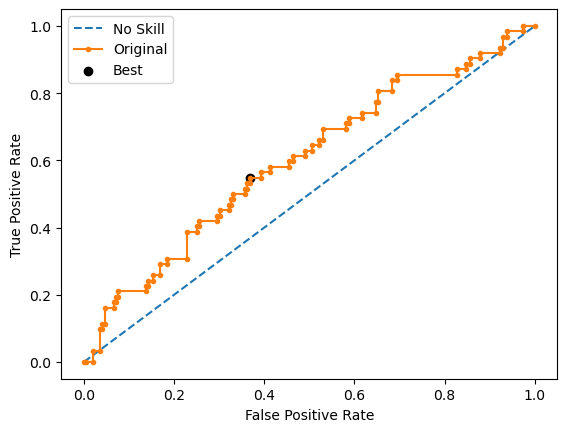

Learning rate set to 0.006754
0:	learn: 0.6925900	total: 3.64ms	remaining: 3.64s
1:	learn: 0.6912428	total: 5.66ms	remaining: 2.82s
2:	learn: 0.6903214	total: 7.66ms	remaining: 2.54s
3:	learn: 0.6891849	total: 9.46ms	remaining: 2.36s
4:	learn: 0.6882245	total: 11.6ms	remaining: 2.31s
5:	learn: 0.6869975	total: 13.5ms	remaining: 2.24s
6:	learn: 0.6860357	total: 15.3ms	remaining: 2.18s
7:	learn: 0.6856075	total: 17.1ms	remaining: 2.12s
8:	learn: 0.6844440	total: 18.8ms	remaining: 2.07s
9:	learn: 0.6839372	total: 20.9ms	remaining: 2.07s
10:	learn: 0.6828732	total: 22.7ms	remaining: 2.04s
11:	learn: 0.6822025	total: 24.3ms	remaining: 2s
12:	learn: 0.6814569	total: 25.9ms	remaining: 1.97s
13:	learn: 0.6806074	total: 27.9ms	remaining: 1.96s
14:	learn: 0.6797781	total: 29.6ms	remaining: 1.95s
15:	learn: 0.6792976	total: 31.3ms	remaining: 1.92s
16:	learn: 0.6783452	total: 33.1ms	remaining: 1.91s
17:	learn: 0.6772332	total: 35ms	remaining: 1.91s
18:	learn: 0.6758575	total: 36.8ms	remaining: 1.9

218:	learn: 0.5315294	total: 403ms	remaining: 1.44s
219:	learn: 0.5309885	total: 405ms	remaining: 1.44s
220:	learn: 0.5303250	total: 407ms	remaining: 1.43s
221:	learn: 0.5293605	total: 408ms	remaining: 1.43s
222:	learn: 0.5290578	total: 410ms	remaining: 1.43s
223:	learn: 0.5286314	total: 412ms	remaining: 1.43s
224:	learn: 0.5278435	total: 414ms	remaining: 1.42s
225:	learn: 0.5271427	total: 415ms	remaining: 1.42s
226:	learn: 0.5267768	total: 417ms	remaining: 1.42s
227:	learn: 0.5263825	total: 419ms	remaining: 1.42s
228:	learn: 0.5260738	total: 420ms	remaining: 1.42s
229:	learn: 0.5256370	total: 422ms	remaining: 1.41s
230:	learn: 0.5248245	total: 424ms	remaining: 1.41s
231:	learn: 0.5243539	total: 426ms	remaining: 1.41s
232:	learn: 0.5238309	total: 428ms	remaining: 1.41s
233:	learn: 0.5235929	total: 429ms	remaining: 1.41s
234:	learn: 0.5231833	total: 431ms	remaining: 1.4s
235:	learn: 0.5227504	total: 433ms	remaining: 1.4s
236:	learn: 0.5221747	total: 435ms	remaining: 1.4s
237:	learn: 0.5

440:	learn: 0.4300166	total: 802ms	remaining: 1.02s
441:	learn: 0.4296727	total: 804ms	remaining: 1.01s
442:	learn: 0.4291153	total: 805ms	remaining: 1.01s
443:	learn: 0.4287728	total: 807ms	remaining: 1.01s
444:	learn: 0.4283264	total: 809ms	remaining: 1.01s
445:	learn: 0.4280450	total: 811ms	remaining: 1.01s
446:	learn: 0.4277685	total: 813ms	remaining: 1s
447:	learn: 0.4274249	total: 814ms	remaining: 1s
448:	learn: 0.4272083	total: 816ms	remaining: 1s
449:	learn: 0.4269917	total: 818ms	remaining: 1000ms
450:	learn: 0.4266181	total: 820ms	remaining: 998ms
451:	learn: 0.4263389	total: 822ms	remaining: 996ms
452:	learn: 0.4261995	total: 824ms	remaining: 995ms
453:	learn: 0.4259605	total: 826ms	remaining: 993ms
454:	learn: 0.4255363	total: 827ms	remaining: 991ms
455:	learn: 0.4252877	total: 829ms	remaining: 989ms
456:	learn: 0.4249562	total: 831ms	remaining: 987ms
457:	learn: 0.4244191	total: 833ms	remaining: 986ms
458:	learn: 0.4239076	total: 835ms	remaining: 984ms
459:	learn: 0.423655

663:	learn: 0.3582899	total: 1.2s	remaining: 609ms
664:	learn: 0.3579946	total: 1.21s	remaining: 607ms
665:	learn: 0.3575010	total: 1.21s	remaining: 605ms
666:	learn: 0.3572675	total: 1.21s	remaining: 604ms
667:	learn: 0.3569511	total: 1.21s	remaining: 602ms
668:	learn: 0.3566812	total: 1.21s	remaining: 600ms
669:	learn: 0.3562270	total: 1.21s	remaining: 598ms
670:	learn: 0.3558969	total: 1.22s	remaining: 596ms
671:	learn: 0.3553888	total: 1.22s	remaining: 595ms
672:	learn: 0.3550299	total: 1.22s	remaining: 593ms
673:	learn: 0.3546170	total: 1.22s	remaining: 591ms
674:	learn: 0.3543942	total: 1.22s	remaining: 589ms
675:	learn: 0.3542575	total: 1.23s	remaining: 587ms
676:	learn: 0.3540890	total: 1.23s	remaining: 586ms
677:	learn: 0.3538911	total: 1.23s	remaining: 584ms
678:	learn: 0.3536703	total: 1.23s	remaining: 582ms
679:	learn: 0.3535549	total: 1.23s	remaining: 580ms
680:	learn: 0.3533471	total: 1.23s	remaining: 578ms
681:	learn: 0.3529437	total: 1.24s	remaining: 577ms
682:	learn: 0

890:	learn: 0.2940230	total: 1.61s	remaining: 197ms
891:	learn: 0.2936763	total: 1.61s	remaining: 196ms
892:	learn: 0.2933391	total: 1.62s	remaining: 194ms
893:	learn: 0.2928757	total: 1.62s	remaining: 192ms
894:	learn: 0.2927108	total: 1.62s	remaining: 190ms
895:	learn: 0.2923637	total: 1.62s	remaining: 188ms
896:	learn: 0.2920604	total: 1.62s	remaining: 187ms
897:	learn: 0.2917515	total: 1.63s	remaining: 185ms
898:	learn: 0.2915962	total: 1.63s	remaining: 183ms
899:	learn: 0.2910864	total: 1.63s	remaining: 181ms
900:	learn: 0.2908785	total: 1.63s	remaining: 179ms
901:	learn: 0.2903142	total: 1.63s	remaining: 177ms
902:	learn: 0.2900300	total: 1.64s	remaining: 176ms
903:	learn: 0.2898294	total: 1.64s	remaining: 174ms
904:	learn: 0.2896788	total: 1.64s	remaining: 172ms
905:	learn: 0.2893455	total: 1.64s	remaining: 170ms
906:	learn: 0.2888282	total: 1.64s	remaining: 168ms
907:	learn: 0.2887248	total: 1.64s	remaining: 167ms
908:	learn: 0.2882052	total: 1.65s	remaining: 165ms
909:	learn: 

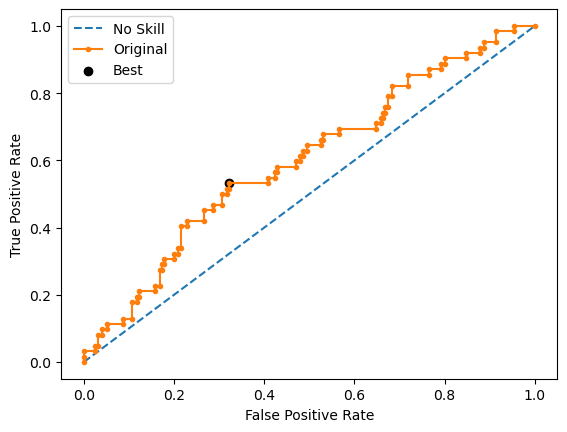

Learning rate set to 0.006754
0:	learn: 0.6921698	total: 5.82ms	remaining: 5.81s
1:	learn: 0.6908277	total: 11.7ms	remaining: 5.84s
2:	learn: 0.6895982	total: 18.2ms	remaining: 6.05s
3:	learn: 0.6882903	total: 25.1ms	remaining: 6.24s
4:	learn: 0.6870308	total: 30.9ms	remaining: 6.15s
5:	learn: 0.6859095	total: 36.1ms	remaining: 5.99s
6:	learn: 0.6846291	total: 41.9ms	remaining: 5.95s
7:	learn: 0.6833793	total: 46.8ms	remaining: 5.8s
8:	learn: 0.6820021	total: 52.4ms	remaining: 5.76s
9:	learn: 0.6804164	total: 56.9ms	remaining: 5.63s
10:	learn: 0.6789586	total: 60.1ms	remaining: 5.4s
11:	learn: 0.6781544	total: 63.5ms	remaining: 5.23s
12:	learn: 0.6769886	total: 65.8ms	remaining: 4.99s
13:	learn: 0.6759117	total: 68.6ms	remaining: 4.83s
14:	learn: 0.6746674	total: 71.6ms	remaining: 4.7s
15:	learn: 0.6739820	total: 73.4ms	remaining: 4.51s
16:	learn: 0.6726952	total: 75.2ms	remaining: 4.35s
17:	learn: 0.6717030	total: 76.9ms	remaining: 4.2s
18:	learn: 0.6701852	total: 78.6ms	remaining: 4.

190:	learn: 0.5293094	total: 393ms	remaining: 1.67s
191:	learn: 0.5286152	total: 395ms	remaining: 1.66s
192:	learn: 0.5276219	total: 397ms	remaining: 1.66s
193:	learn: 0.5271743	total: 399ms	remaining: 1.66s
194:	learn: 0.5265043	total: 401ms	remaining: 1.66s
195:	learn: 0.5259922	total: 403ms	remaining: 1.65s
196:	learn: 0.5256448	total: 405ms	remaining: 1.65s
197:	learn: 0.5250406	total: 406ms	remaining: 1.65s
198:	learn: 0.5243521	total: 408ms	remaining: 1.64s
199:	learn: 0.5239730	total: 410ms	remaining: 1.64s
200:	learn: 0.5234996	total: 412ms	remaining: 1.64s
201:	learn: 0.5231048	total: 414ms	remaining: 1.63s
202:	learn: 0.5224035	total: 416ms	remaining: 1.63s
203:	learn: 0.5216293	total: 417ms	remaining: 1.63s
204:	learn: 0.5210218	total: 419ms	remaining: 1.63s
205:	learn: 0.5202820	total: 421ms	remaining: 1.62s
206:	learn: 0.5198894	total: 423ms	remaining: 1.62s
207:	learn: 0.5192063	total: 425ms	remaining: 1.62s
208:	learn: 0.5186298	total: 426ms	remaining: 1.61s
209:	learn: 

406:	learn: 0.4211875	total: 792ms	remaining: 1.15s
407:	learn: 0.4208813	total: 794ms	remaining: 1.15s
408:	learn: 0.4203627	total: 796ms	remaining: 1.15s
409:	learn: 0.4200547	total: 798ms	remaining: 1.15s
410:	learn: 0.4193593	total: 800ms	remaining: 1.15s
411:	learn: 0.4189626	total: 802ms	remaining: 1.14s
412:	learn: 0.4183820	total: 803ms	remaining: 1.14s
413:	learn: 0.4180394	total: 805ms	remaining: 1.14s
414:	learn: 0.4177102	total: 807ms	remaining: 1.14s
415:	learn: 0.4172589	total: 809ms	remaining: 1.14s
416:	learn: 0.4163036	total: 810ms	remaining: 1.13s
417:	learn: 0.4161041	total: 812ms	remaining: 1.13s
418:	learn: 0.4154495	total: 814ms	remaining: 1.13s
419:	learn: 0.4149172	total: 816ms	remaining: 1.13s
420:	learn: 0.4146845	total: 818ms	remaining: 1.12s
421:	learn: 0.4141222	total: 819ms	remaining: 1.12s
422:	learn: 0.4136579	total: 821ms	remaining: 1.12s
423:	learn: 0.4133904	total: 823ms	remaining: 1.12s
424:	learn: 0.4131489	total: 825ms	remaining: 1.12s
425:	learn: 

615:	learn: 0.3471921	total: 1.18s	remaining: 735ms
616:	learn: 0.3470025	total: 1.18s	remaining: 734ms
617:	learn: 0.3468763	total: 1.18s	remaining: 732ms
618:	learn: 0.3463867	total: 1.19s	remaining: 730ms
619:	learn: 0.3462592	total: 1.19s	remaining: 728ms
620:	learn: 0.3459428	total: 1.19s	remaining: 726ms
621:	learn: 0.3457377	total: 1.19s	remaining: 724ms
622:	learn: 0.3455617	total: 1.19s	remaining: 722ms
623:	learn: 0.3452488	total: 1.19s	remaining: 720ms
624:	learn: 0.3449965	total: 1.2s	remaining: 718ms
625:	learn: 0.3448344	total: 1.2s	remaining: 716ms
626:	learn: 0.3444915	total: 1.2s	remaining: 714ms
627:	learn: 0.3440378	total: 1.2s	remaining: 712ms
628:	learn: 0.3438968	total: 1.2s	remaining: 710ms
629:	learn: 0.3435636	total: 1.21s	remaining: 708ms
630:	learn: 0.3434140	total: 1.21s	remaining: 706ms
631:	learn: 0.3430772	total: 1.21s	remaining: 704ms
632:	learn: 0.3428913	total: 1.21s	remaining: 702ms
633:	learn: 0.3426640	total: 1.21s	remaining: 700ms
634:	learn: 0.342

833:	learn: 0.2840428	total: 1.58s	remaining: 314ms
834:	learn: 0.2837353	total: 1.58s	remaining: 312ms
835:	learn: 0.2833877	total: 1.58s	remaining: 311ms
836:	learn: 0.2831225	total: 1.58s	remaining: 309ms
837:	learn: 0.2828965	total: 1.59s	remaining: 307ms
838:	learn: 0.2826430	total: 1.59s	remaining: 305ms
839:	learn: 0.2825572	total: 1.59s	remaining: 303ms
840:	learn: 0.2823971	total: 1.59s	remaining: 301ms
841:	learn: 0.2821449	total: 1.59s	remaining: 299ms
842:	learn: 0.2818767	total: 1.6s	remaining: 297ms
843:	learn: 0.2813362	total: 1.6s	remaining: 295ms
844:	learn: 0.2811098	total: 1.6s	remaining: 293ms
845:	learn: 0.2809336	total: 1.6s	remaining: 292ms
846:	learn: 0.2808636	total: 1.6s	remaining: 290ms
847:	learn: 0.2806076	total: 1.6s	remaining: 288ms
848:	learn: 0.2801794	total: 1.61s	remaining: 286ms
849:	learn: 0.2797713	total: 1.61s	remaining: 284ms
850:	learn: 0.2794004	total: 1.61s	remaining: 282ms
851:	learn: 0.2792719	total: 1.61s	remaining: 280ms
852:	learn: 0.2790

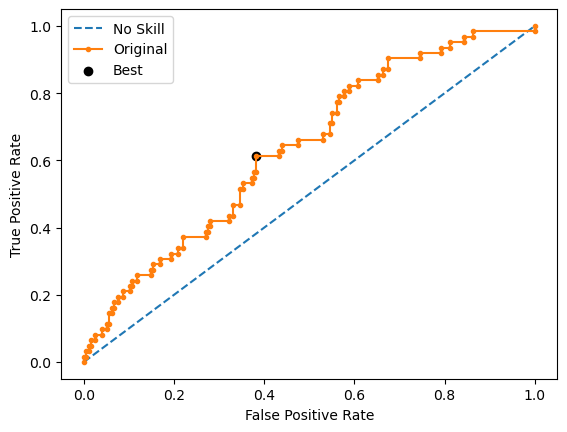

Learning rate set to 0.006754
0:	learn: 0.6923820	total: 2.27ms	remaining: 2.26s
1:	learn: 0.6918217	total: 4.58ms	remaining: 2.28s
2:	learn: 0.6908313	total: 7.12ms	remaining: 2.37s
3:	learn: 0.6897882	total: 9.49ms	remaining: 2.36s
4:	learn: 0.6888118	total: 11.9ms	remaining: 2.36s
5:	learn: 0.6872772	total: 14.2ms	remaining: 2.36s
6:	learn: 0.6860441	total: 16.6ms	remaining: 2.35s
7:	learn: 0.6850615	total: 18.5ms	remaining: 2.29s
8:	learn: 0.6835670	total: 20.6ms	remaining: 2.27s
9:	learn: 0.6823291	total: 22.4ms	remaining: 2.22s
10:	learn: 0.6810308	total: 24.4ms	remaining: 2.19s
11:	learn: 0.6796718	total: 26.3ms	remaining: 2.17s
12:	learn: 0.6783633	total: 28.3ms	remaining: 2.15s
13:	learn: 0.6773526	total: 30.2ms	remaining: 2.13s
14:	learn: 0.6766391	total: 32.1ms	remaining: 2.1s
15:	learn: 0.6759354	total: 33.9ms	remaining: 2.08s
16:	learn: 0.6748091	total: 35.7ms	remaining: 2.06s
17:	learn: 0.6734633	total: 37.5ms	remaining: 2.05s
18:	learn: 0.6719152	total: 39.3ms	remaining:

209:	learn: 0.5188425	total: 388ms	remaining: 1.46s
210:	learn: 0.5187469	total: 389ms	remaining: 1.46s
211:	learn: 0.5179523	total: 391ms	remaining: 1.45s
212:	learn: 0.5176756	total: 393ms	remaining: 1.45s
213:	learn: 0.5168238	total: 395ms	remaining: 1.45s
214:	learn: 0.5161947	total: 397ms	remaining: 1.45s
215:	learn: 0.5156688	total: 399ms	remaining: 1.45s
216:	learn: 0.5153266	total: 400ms	remaining: 1.44s
217:	learn: 0.5144076	total: 402ms	remaining: 1.44s
218:	learn: 0.5139387	total: 404ms	remaining: 1.44s
219:	learn: 0.5133317	total: 406ms	remaining: 1.44s
220:	learn: 0.5129847	total: 408ms	remaining: 1.44s
221:	learn: 0.5121967	total: 409ms	remaining: 1.43s
222:	learn: 0.5115524	total: 411ms	remaining: 1.43s
223:	learn: 0.5109403	total: 413ms	remaining: 1.43s
224:	learn: 0.5105927	total: 415ms	remaining: 1.43s
225:	learn: 0.5101525	total: 417ms	remaining: 1.43s
226:	learn: 0.5092166	total: 419ms	remaining: 1.43s
227:	learn: 0.5080551	total: 421ms	remaining: 1.42s
228:	learn: 

428:	learn: 0.4120478	total: 790ms	remaining: 1.05s
429:	learn: 0.4117343	total: 792ms	remaining: 1.05s
430:	learn: 0.4113457	total: 794ms	remaining: 1.05s
431:	learn: 0.4109830	total: 796ms	remaining: 1.05s
432:	learn: 0.4102679	total: 798ms	remaining: 1.04s
433:	learn: 0.4100578	total: 800ms	remaining: 1.04s
434:	learn: 0.4097475	total: 801ms	remaining: 1.04s
435:	learn: 0.4094437	total: 803ms	remaining: 1.04s
436:	learn: 0.4090073	total: 805ms	remaining: 1.04s
437:	learn: 0.4086589	total: 807ms	remaining: 1.03s
438:	learn: 0.4084546	total: 809ms	remaining: 1.03s
439:	learn: 0.4081253	total: 811ms	remaining: 1.03s
440:	learn: 0.4079692	total: 813ms	remaining: 1.03s
441:	learn: 0.4075840	total: 814ms	remaining: 1.03s
442:	learn: 0.4074036	total: 816ms	remaining: 1.03s
443:	learn: 0.4068809	total: 818ms	remaining: 1.02s
444:	learn: 0.4060429	total: 820ms	remaining: 1.02s
445:	learn: 0.4057678	total: 821ms	remaining: 1.02s
446:	learn: 0.4054603	total: 823ms	remaining: 1.02s
447:	learn: 

646:	learn: 0.3387443	total: 1.19s	remaining: 647ms
647:	learn: 0.3383667	total: 1.19s	remaining: 645ms
648:	learn: 0.3382144	total: 1.19s	remaining: 644ms
649:	learn: 0.3380884	total: 1.19s	remaining: 642ms
650:	learn: 0.3378378	total: 1.19s	remaining: 640ms
651:	learn: 0.3376366	total: 1.2s	remaining: 638ms
652:	learn: 0.3372624	total: 1.2s	remaining: 636ms
653:	learn: 0.3369333	total: 1.2s	remaining: 634ms
654:	learn: 0.3365507	total: 1.2s	remaining: 632ms
655:	learn: 0.3363803	total: 1.2s	remaining: 631ms
656:	learn: 0.3359718	total: 1.2s	remaining: 629ms
657:	learn: 0.3357502	total: 1.21s	remaining: 627ms
658:	learn: 0.3355534	total: 1.21s	remaining: 625ms
659:	learn: 0.3352617	total: 1.21s	remaining: 623ms
660:	learn: 0.3350605	total: 1.21s	remaining: 621ms
661:	learn: 0.3347766	total: 1.21s	remaining: 619ms
662:	learn: 0.3343054	total: 1.22s	remaining: 618ms
663:	learn: 0.3341543	total: 1.22s	remaining: 616ms
664:	learn: 0.3337423	total: 1.22s	remaining: 614ms
665:	learn: 0.3331

860:	learn: 0.2727778	total: 1.57s	remaining: 254ms
861:	learn: 0.2724414	total: 1.57s	remaining: 252ms
862:	learn: 0.2721129	total: 1.58s	remaining: 250ms
863:	learn: 0.2718453	total: 1.58s	remaining: 248ms
864:	learn: 0.2715153	total: 1.58s	remaining: 247ms
865:	learn: 0.2712046	total: 1.58s	remaining: 245ms
866:	learn: 0.2707326	total: 1.58s	remaining: 243ms
867:	learn: 0.2705771	total: 1.58s	remaining: 241ms
868:	learn: 0.2703828	total: 1.59s	remaining: 239ms
869:	learn: 0.2701894	total: 1.59s	remaining: 237ms
870:	learn: 0.2700207	total: 1.59s	remaining: 236ms
871:	learn: 0.2695240	total: 1.59s	remaining: 234ms
872:	learn: 0.2692079	total: 1.59s	remaining: 232ms
873:	learn: 0.2687679	total: 1.6s	remaining: 230ms
874:	learn: 0.2686910	total: 1.6s	remaining: 228ms
875:	learn: 0.2685021	total: 1.6s	remaining: 226ms
876:	learn: 0.2681145	total: 1.6s	remaining: 225ms
877:	learn: 0.2679971	total: 1.6s	remaining: 223ms
878:	learn: 0.2677827	total: 1.6s	remaining: 221ms
879:	learn: 0.2675

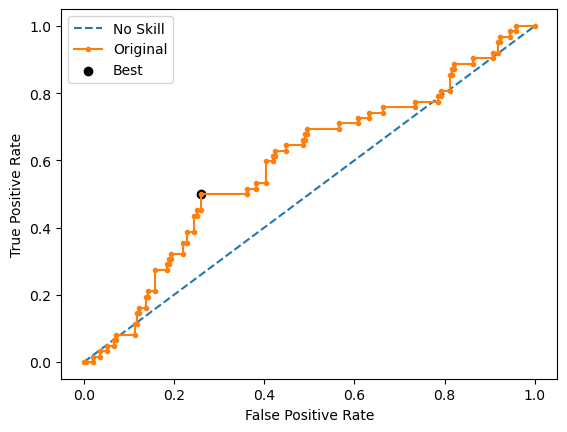

Ave Test G-mean: 0.5881992688619447
Stdev Test G-mean: 0.009463946498823914
Ave Test Specificity: 0.613265306122449
Ave Test Recall: 0.5677419354838709
Ave Test NPV: 0.8183035752136407
Ave Test Accuracy: 0.6023255813953489
Ave Test Precision: 0.31746401567392013
Ave Test F1-Score: 0.40624796443573485
Ave Runtime: 1.989664125442505


In [102]:
ho_t04_catboost_gs, ho_t04_catboost_be, ho_t04_catboost_model_info, ho_t04_catboost_metrics_df = catboost_class2(ho_t04, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [116]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t04_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t04_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t04_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.611687,0.041561,0.573521,NaN,0.590816,0.635484,0.332645,0.435697,0.601550
4,Random Forest,0.596270,0.026246,0.586722,0.614298,0.655102,0.545161,0.334383,0.413636,0.628682
6,LightGBM,0.592103,0.028833,0.610242,0.737797,0.621429,0.567742,0.321836,0.409962,0.608527
9,CatBoost,0.588199,0.009464,0.594784,0.946857,0.613265,0.567742,0.317464,0.406248,0.602326
2,Logistic Regression,0.579215,0.025098,0.566396,NaN,0.636735,0.529032,0.314800,0.394322,0.610853
8,AdaBoost,0.578894,0.017692,0.591180,0.948379,0.623469,0.538710,0.311469,0.394453,0.603101
7,Extreme Gradient Boosting (XGBoost),0.541323,0.032543,0.591274,0.851856,0.650000,0.451613,0.290235,0.353203,0.602326
5,Gradient Boosting Machine (GBM),0.520806,0.031260,0.569497,0.883291,0.703061,0.387097,0.292039,0.332562,0.627132
1,SVM Classifier,0.520429,0.041414,0.546502,0.289425,0.486735,0.570968,0.259745,0.355601,0.506977
0,k-Nearest Neighbors,0.519724,0.027181,0.582620,0.693216,0.585714,0.464516,0.261445,0.334010,0.556589


In [132]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t04_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.628682,Random Forest
Highest Test G-mean,0.611687,Decision Tree
Highest Test Recall,0.635484,Decision Tree
Highest Test Precision,0.334383,Random Forest
Highest Test Specificity,0.703061,Gradient Boosting Machine (GBM)
Highest Test F1-score,0.435697,Decision Tree


# HO-T05 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2148 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5882193401183704
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=3, max_features='sqrt',
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 132.19378399848938 secs
Run 1 - Random State: 0
Test G-mean: 0.5679618342470648
Best Threshold=0.638235, G-Mean=0.568


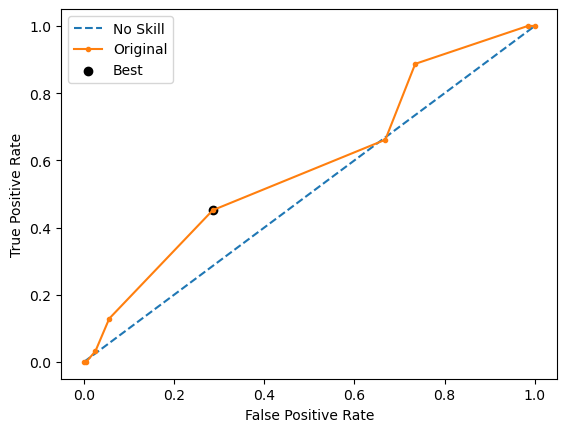

Run 2 - Random State: 1
Test G-mean: 0.6282912027221439
Best Threshold=0.560102, G-Mean=0.628


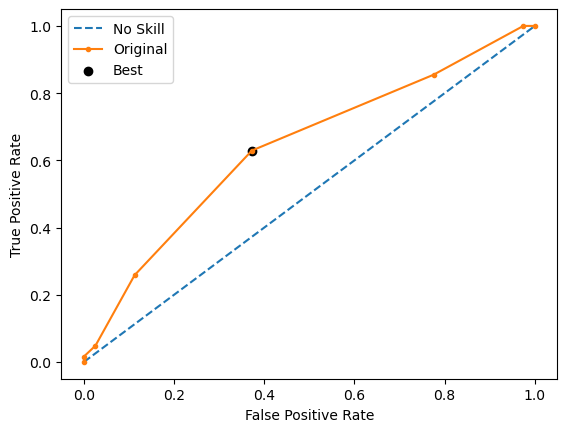

Run 3 - Random State: 2
Test G-mean: 0.6277015346403589
Best Threshold=0.572864, G-Mean=0.639


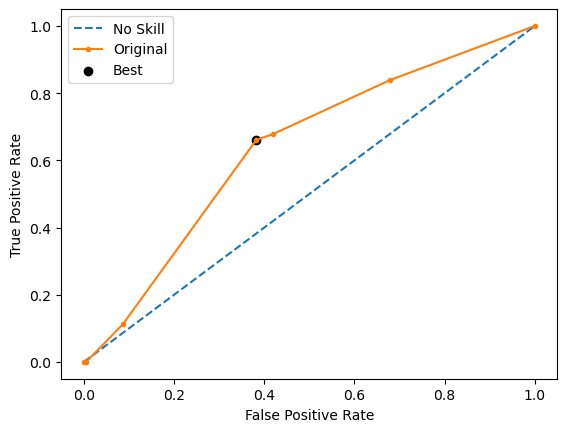

Run 4 - Random State: 3
Test G-mean: 0.5828354563599033
Best Threshold=0.559829, G-Mean=0.599


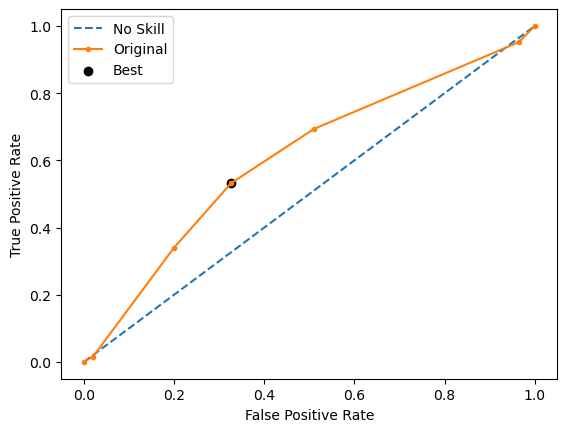

Run 5 - Random State: 4
Test G-mean: 0.5717884811269289
Best Threshold=0.600543, G-Mean=0.572


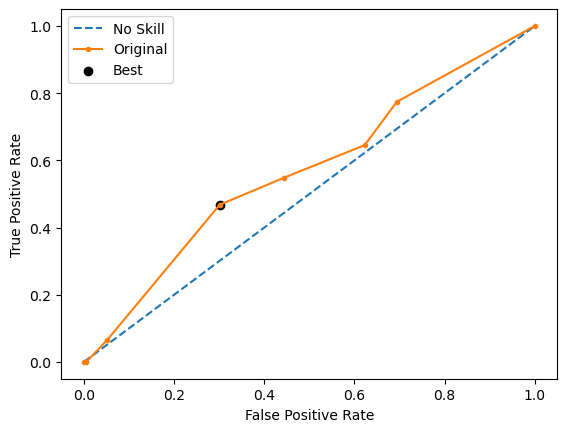

Ave Test G-mean: 0.5957157018192799
Stdev Test G-mean: 0.029970596168164648
Ave Test Specificity: 0.6224489795918368
Ave Test Recall: 0.5838709677419354
Ave Test NPV: 0.8276949369735256
Ave Test Accuracy: 0.6131782945736435
Ave Test Precision: 0.33010041034234583
Ave Test F1-Score: 0.41792585418380124
Ave Runtime: 0.019459009170532227


In [104]:
ho_t05_dt_gs, ho_t05_dt_be, ho_t05_dt_model_info, ho_t05_dt_metrics_df = dt_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
Setting penalty=None will ignore the C and l1_ratio parameters


Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': None, 'classifier__solver': 'lbfgs', 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5614600299693807
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, penalty=None,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 56.42722272872925 secs


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 1 - Random State: 0
Test G-mean: 0.58184628163935
Best Threshold=0.510044, G-Mean=0.591


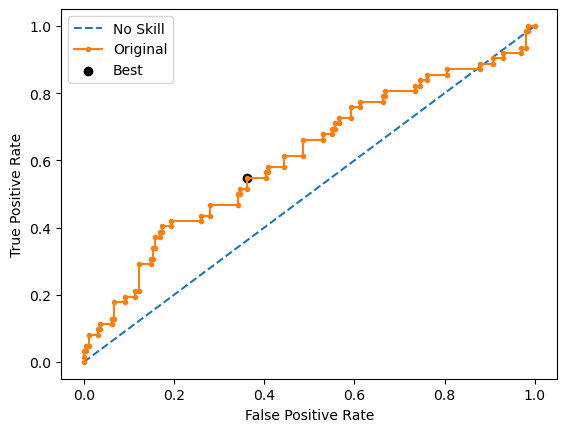

Setting penalty=None will ignore the C and l1_ratio parameters


Run 2 - Random State: 1
Test G-mean: 0.569192051803901
Best Threshold=0.541754, G-Mean=0.574


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


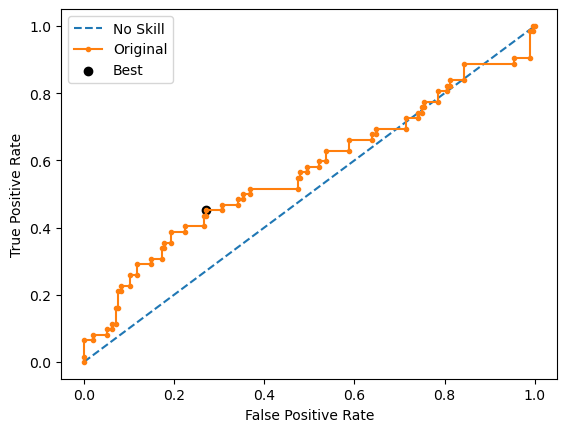

Setting penalty=None will ignore the C and l1_ratio parameters


Run 3 - Random State: 2
Test G-mean: 0.5636714267085828
Best Threshold=0.512322, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


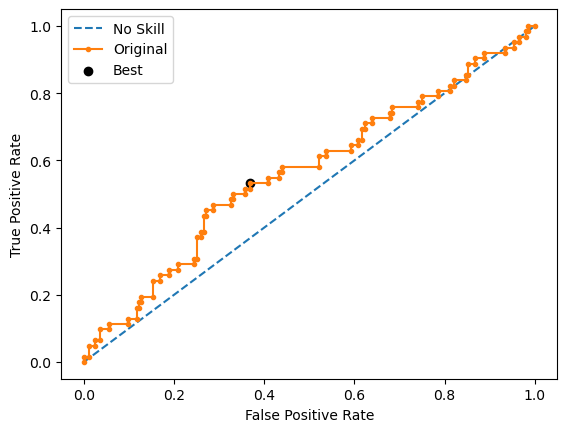

Setting penalty=None will ignore the C and l1_ratio parameters


Run 4 - Random State: 3
Test G-mean: 0.5951996915414691
Best Threshold=0.488220, G-Mean=0.610


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


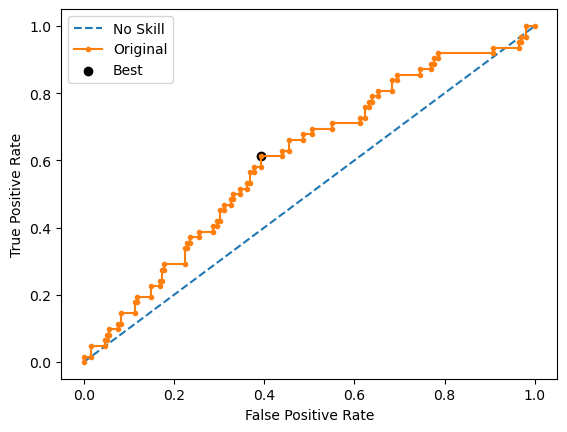

Setting penalty=None will ignore the C and l1_ratio parameters


Run 5 - Random State: 4
Test G-mean: 0.539273888233625
Best Threshold=0.489920, G-Mean=0.565


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


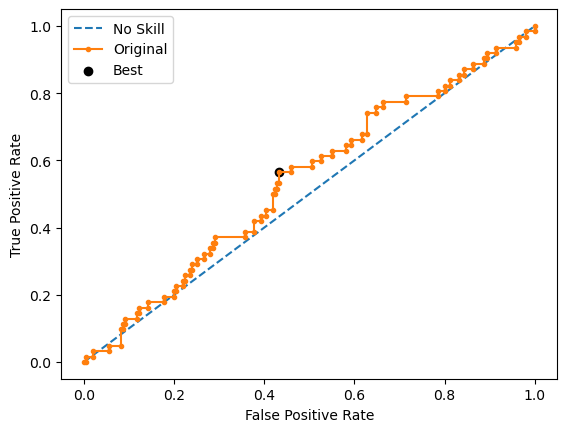

Ave Test G-mean: 0.5698366679853856
Stdev Test G-mean: 0.02097631414358341
Ave Test Specificity: 0.6142857142857143
Ave Test Recall: 0.5290322580645161
Ave Test NPV: 0.8046909529665209
Ave Test Accuracy: 0.5937984496124031
Ave Test Precision: 0.30299596398147177
Ave Test F1-Score: 0.3851475266183639
Ave Runtime: 0.6746843814849853


In [105]:
ho_t05_logreg_gs, ho_t05_logreg_be, ho_t05_logreg_model_info, ho_t05_logreg_metrics_df = logreg_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 100000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5429950763900592
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=100000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2872778417050305
Std Train Score (G-mean) 0.04560825876753685
GridSearchCV Runtime: 116.1483142375946 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.5034443575988877
Best Threshold=0.500000, G-Mean=0.346


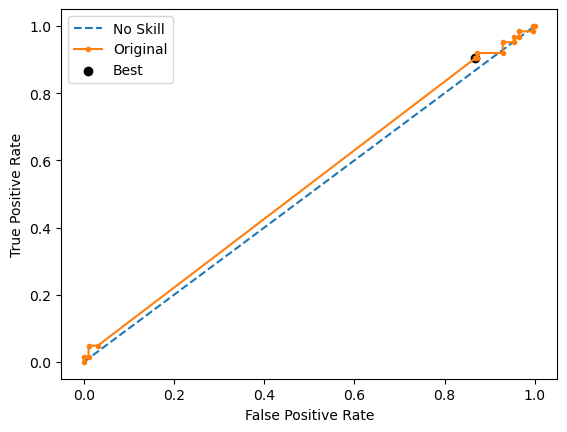

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5263779371505743
Best Threshold=0.505006, G-Mean=0.305


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


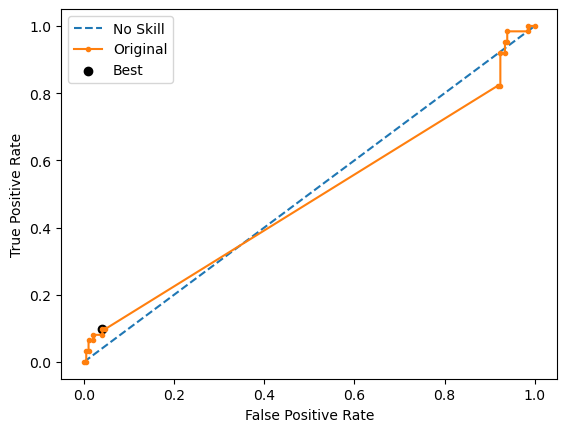

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5284063760237141
Best Threshold=0.511266, G-Mean=0.443


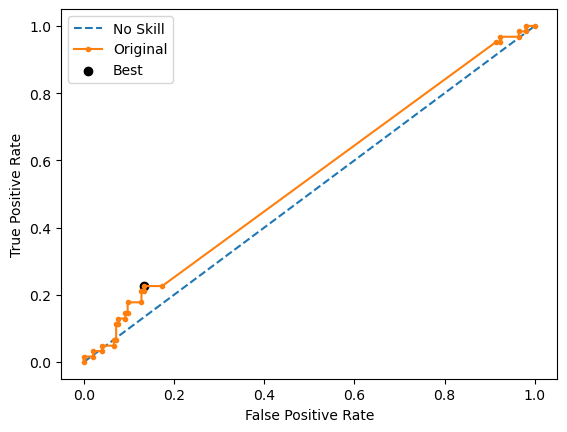

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.5497021756333007
Best Threshold=0.500000, G-Mean=0.396


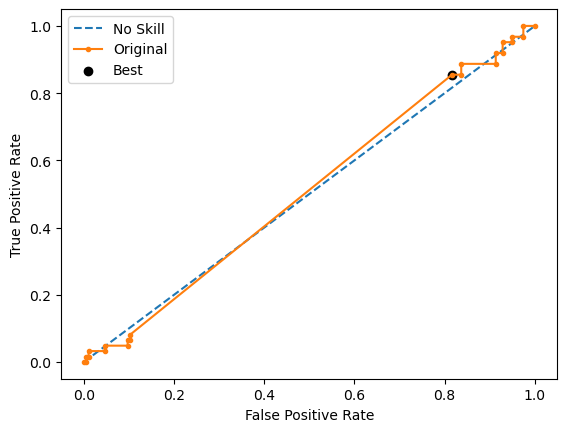

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.5562500231154435
Best Threshold=0.494494, G-Mean=0.143


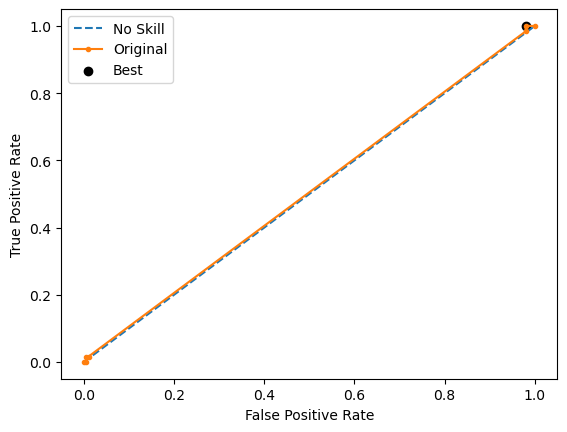

Ave Test G-mean: 0.5328361739043841
Stdev Test G-mean: 0.02096354661171347
Ave Test Specificity: 0.4897959183673469
Ave Test Recall: 0.5935483870967742
Ave Test NPV: 0.792879955744053
Ave Test Accuracy: 0.5147286821705427
Ave Test Precision: 0.2696568187294416
Ave Test F1-Score: 0.36899079871828794
Ave Runtime: 0.3669994831085205


In [106]:
ho_t05_svm_gs, ho_t05_svm_be, ho_t05_svm_model_info, ho_t05_svm_metrics_df = svm_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [107]:
ho_t05_knn_gs, ho_t05_knn_be, ho_t05_knn_model_info, ho_t05_knn_metrics_df = knn_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 11, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5582815646133021
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=11))])
Mean Train Score (G-mean) 0.69379125155105
Std Train Score (G-mean) 0.014689486936425258
GridSearchCV Runtime: 98.90652203559875 secs
Run 1 - Random State: 0
Test G-mean: 0.4807006078538353
Run 2 - Random State: 1
Test G-mean: 0.47031708100177233
Run 3 - Random State: 2
Test G-mean: 0.5654206052395802
Run 4 - Random State: 3
Test G-mean: 0.5057275636779099
Run 5 - Random State: 4
Test G-mean: 0.5052391738356632
Ave Test G-mean: 0.5054810063217522
Stdev Test G-mean: 0.03688985153144814
Ave Test Specificity: 0.5306122448979591
Ave Test R

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5903444676005928
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importan

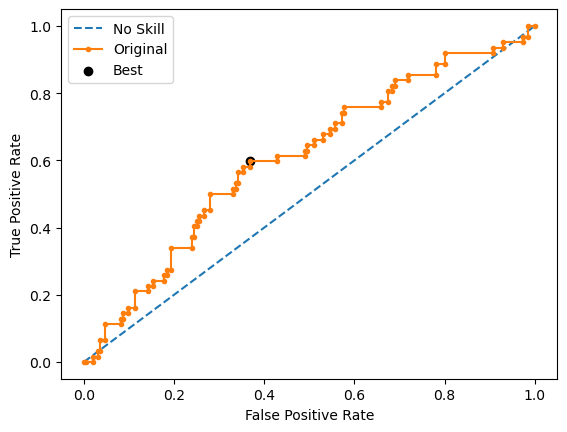

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.397429, G-Mean=0.631


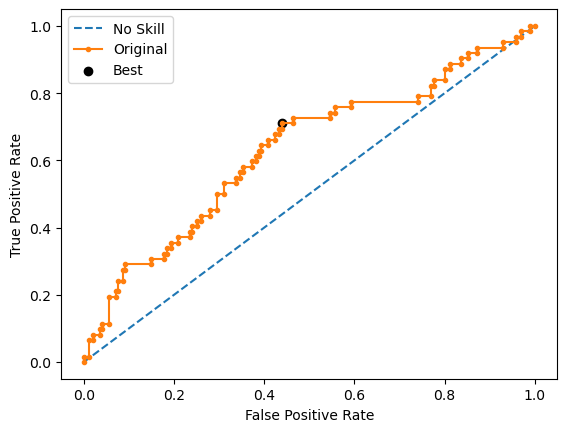

Run 3 - Random State: 2
Test G-mean: 0.5312021964706288
Best Threshold=0.382905, G-Mean=0.594


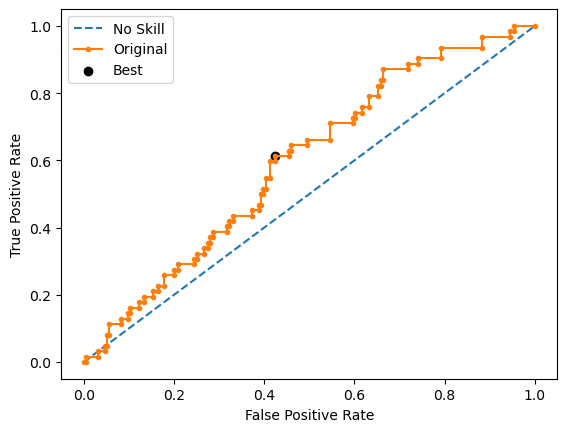

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.642425, G-Mean=0.587


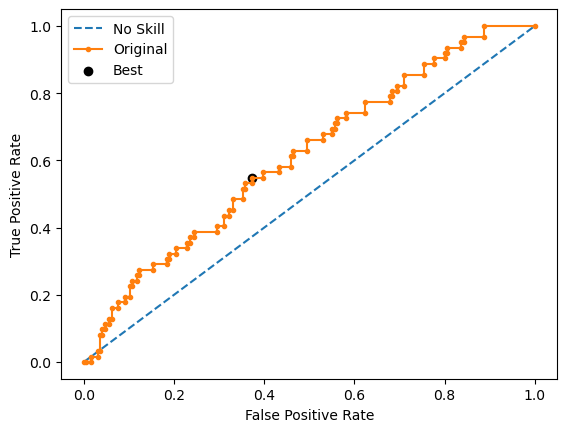

Run 5 - Random State: 4
Test G-mean: 0.5521667178180558
Best Threshold=0.666844, G-Mean=0.594


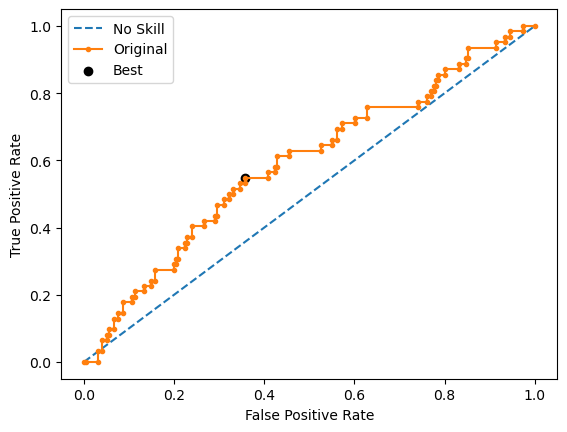

Ave Test G-mean: 0.5723916519163362
Stdev Test G-mean: 0.031446415182837424
Ave Test Specificity: 0.5806122448979592
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8109762192024684
Ave Test Accuracy: 0.5782945736434109
Ave Test Precision: 0.3018463409697703
Ave Test F1-Score: 0.3934647403911834
Ave Runtime: 0.35921363830566405


In [108]:
ho_t05_xgb_gs, ho_t05_xgb_be, ho_t05_xgb_model_info, ho_t05_xgb_metrics_df = xgb_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002018 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 689
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Best Hyperparameters: {'classifier__boosting_type': 'gbdt', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6113861776406283
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
               

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

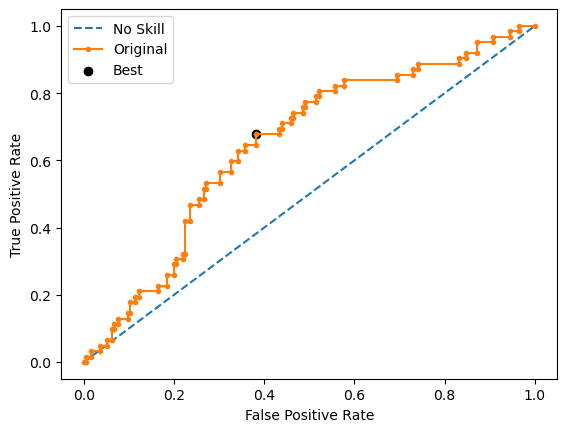

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 700
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

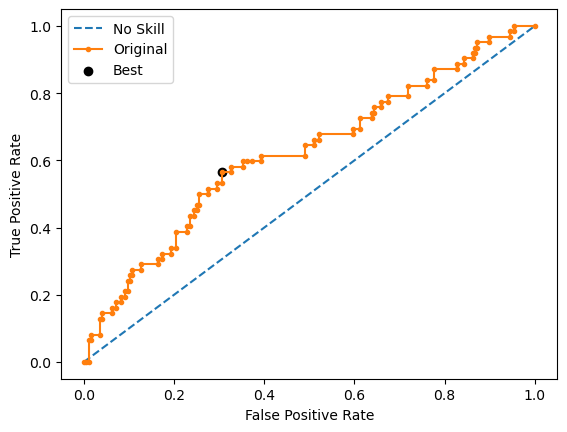

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 693
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

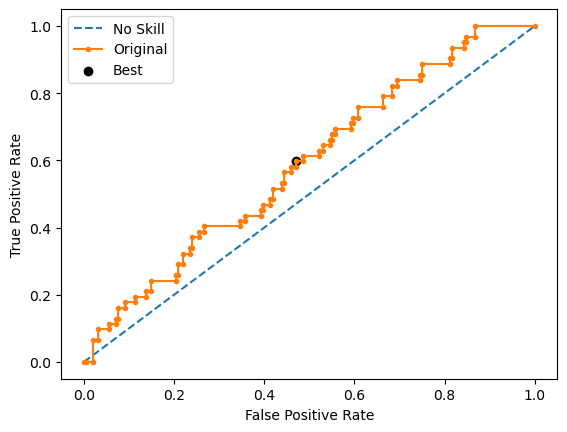

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 693
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

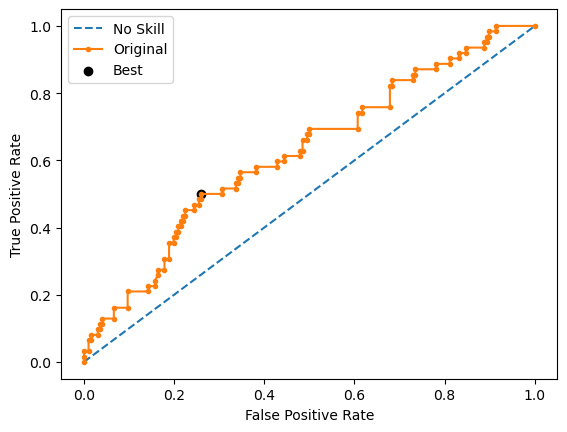

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001248 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 684
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

Run 5 - Random State: 4
Test G-mean: 0.5914549516590434
Best Threshold=0.507592, G-Mean=0.592


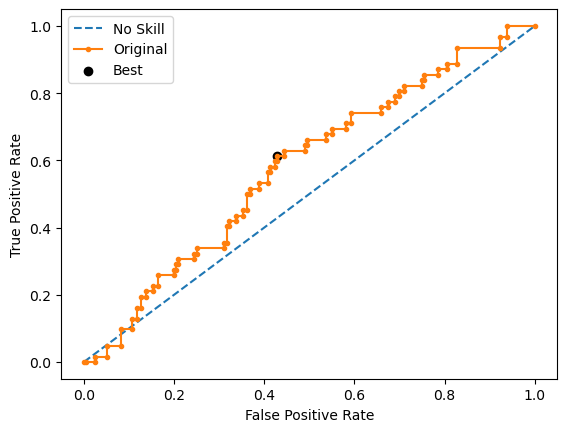

Ave Test G-mean: 0.5945713161869624
Stdev Test G-mean: 0.046127515612995135
Ave Test Specificity: 0.6244897959183674
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8222443176286957
Ave Test Accuracy: 0.6116279069767442
Ave Test Precision: 0.32455987922037877
Ave Test F1-Score: 0.4129134669771542
Ave Runtime: 0.21635007858276367


In [109]:
ho_t05_lgbm_gs, ho_t05_lgbm_be, ho_t05_lgbm_model_info, ho_t05_lgbm_metrics_df = lgbm_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.587471696840875
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9478261660647472
Std Train Score (G-mean) 0.005565821749660911
GridSearchCV Runtime: 14.042999744415283 secs
Run 1 - Random State: 0
Test G-mean: 0.6060915267313265
Best Threshold=0.880797, G-Mean=0.606


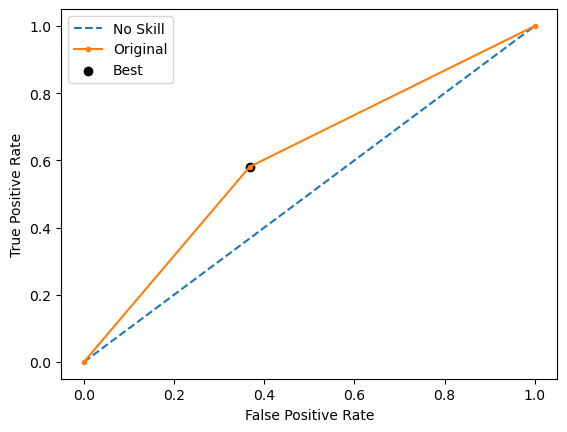

Run 2 - Random State: 1
Test G-mean: 0.6071767407189163
Best Threshold=0.880797, G-Mean=0.607


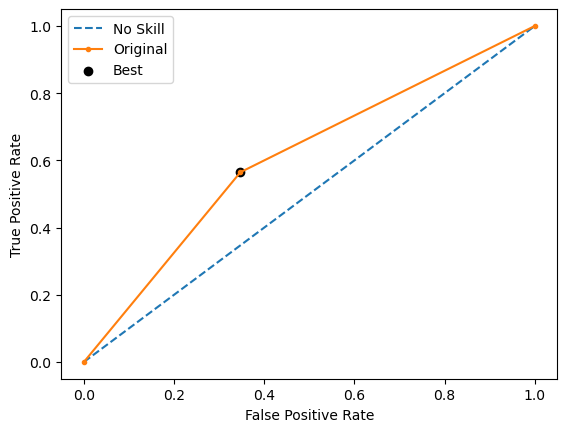

Run 3 - Random State: 2
Test G-mean: 0.5669467095138409
Best Threshold=0.880797, G-Mean=0.567


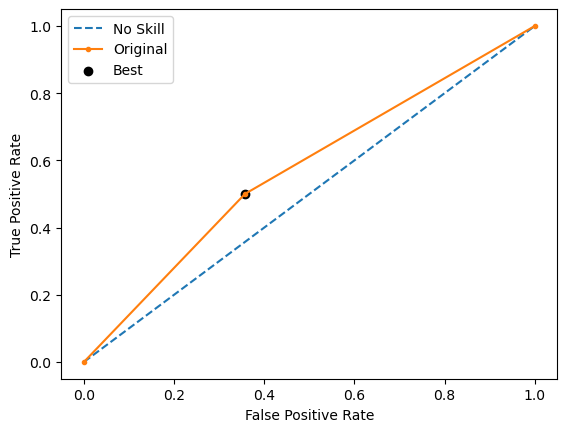

Run 4 - Random State: 3
Test G-mean: 0.5878963512522154
Best Threshold=0.880797, G-Mean=0.588


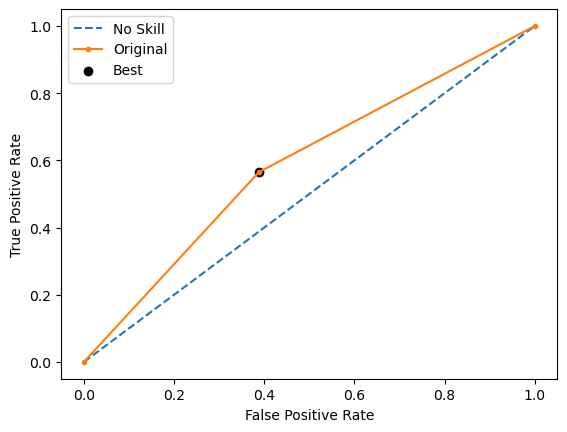

Run 5 - Random State: 4
Test G-mean: 0.5465494128601982
Best Threshold=0.880797, G-Mean=0.547


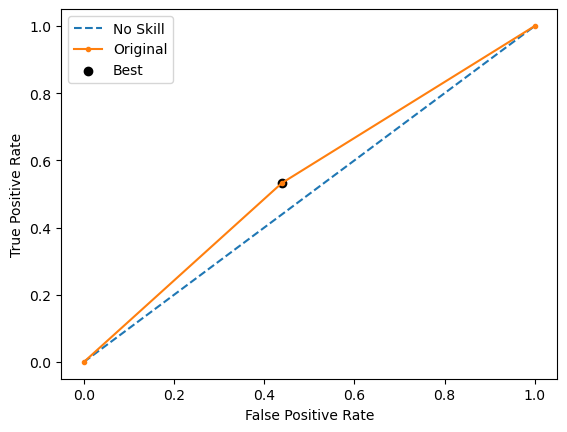

Ave Test G-mean: 0.5829321482152994
Stdev Test G-mean: 0.026115311950578902
Ave Test Specificity: 0.620408163265306
Ave Test Recall: 0.5483870967741936
Ave Test NPV: 0.8125428652134545
Ave Test Accuracy: 0.6031007751937985
Ave Test Precision: 0.3145392182660844
Ave Test F1-Score: 0.3994810191202375
Ave Runtime: 0.30096096992492677


In [110]:
ho_t05_adaboost_gs, ho_t05_adaboost_be, ho_t05_adaboost_model_info, ho_t05_adaboost_metrics_df = adaboost_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5828116611563584
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8833761066250382
Std Train Score (G-mean) 0.010514679929685893
GridSearchCV Runtime: 146.90177512168884 secs
Run 1 - Random State: 0
Test G-mean: 0.5497021756333007
Best Threshold=0.591010, G-Mean=0.585


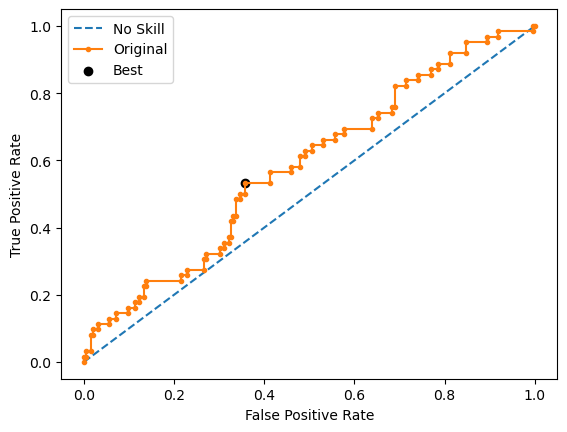

Run 2 - Random State: 1
Test G-mean: 0.5696978398265997
Best Threshold=0.678212, G-Mean=0.582


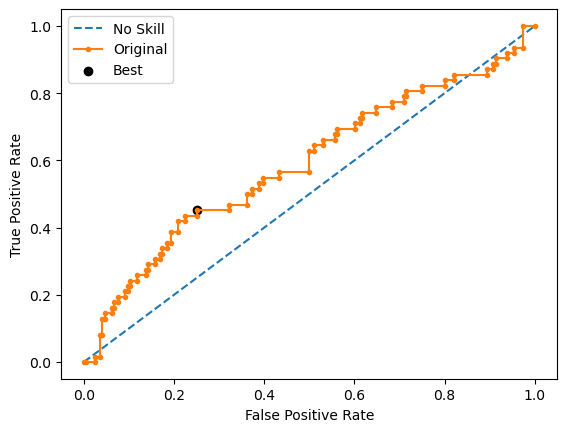

Run 3 - Random State: 2
Test G-mean: 0.5294176810178568
Best Threshold=0.504854, G-Mean=0.529


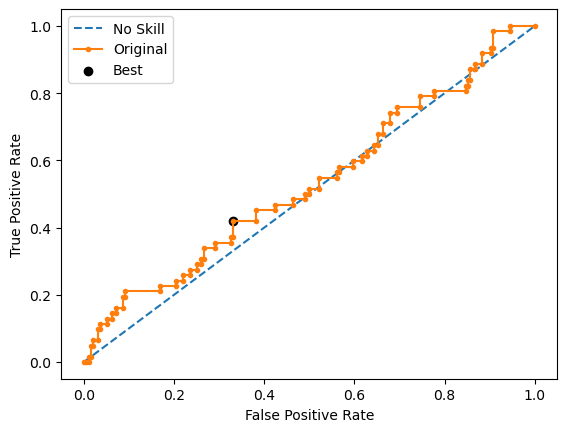

Run 4 - Random State: 3
Test G-mean: 0.5864949276826683
Best Threshold=0.529375, G-Mean=0.602


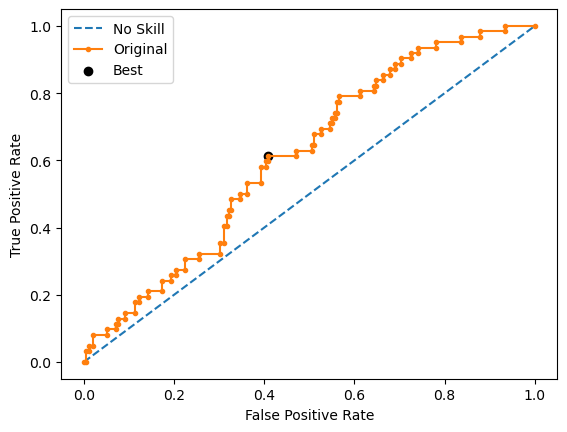

Run 5 - Random State: 4
Test G-mean: 0.56542060523958
Best Threshold=0.449592, G-Mean=0.579


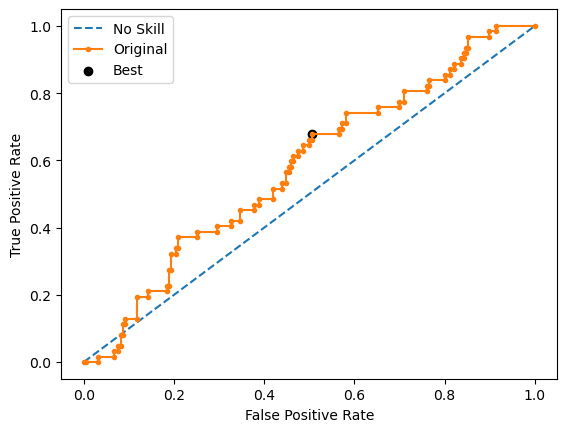

Ave Test G-mean: 0.5601466458800012
Stdev Test G-mean: 0.021602246106122304
Ave Test Specificity: 0.5755102040816327
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8030899046720947
Ave Test Accuracy: 0.5697674418604651
Ave Test Precision: 0.29127941791513523
Ave Test F1-Score: 0.3798617504315097
Ave Runtime: 0.7119327545166015


In [111]:
ho_t05_gbm_gs, ho_t05_gbm_be, ho_t05_gbm_model_info, ho_t05_gbm_metrics_df = gbm_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.595930959178998
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6099318861568523
Std Train Score (G-mean) 0.024214352161286905
GridSearchCV Runtime: 377.5539903640747 secs
Run 1 - Random State: 0
Test G-mean: 0.6315571110069641
Best Threshold=0.495801, G-Mean=0.655


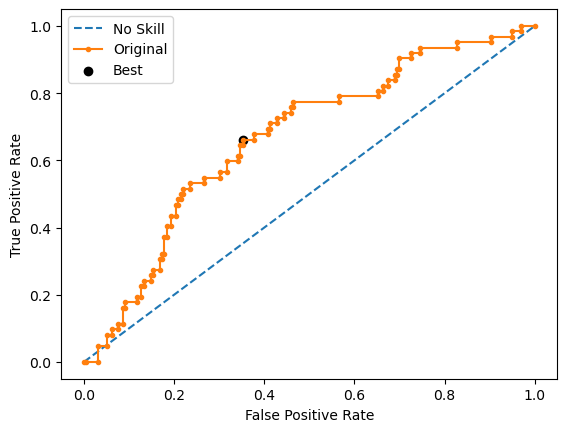

Run 2 - Random State: 1
Test G-mean: 0.5815633512644206
Best Threshold=0.493450, G-Mean=0.603


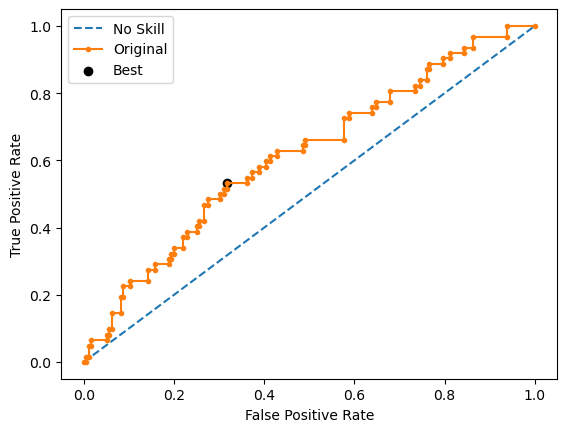

Run 3 - Random State: 2
Test G-mean: 0.5850901473955347
Best Threshold=0.492791, G-Mean=0.610


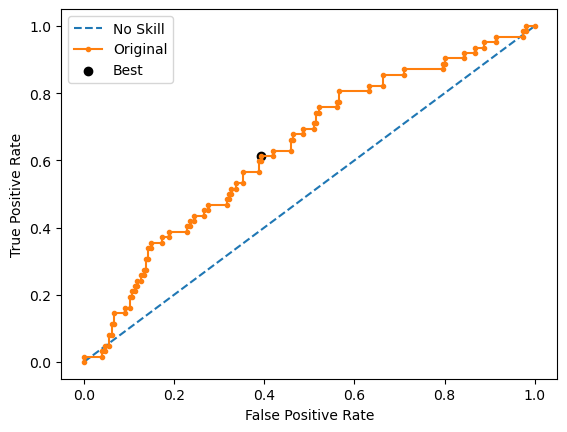

Run 4 - Random State: 3
Test G-mean: 0.601183822262458
Best Threshold=0.508115, G-Mean=0.617


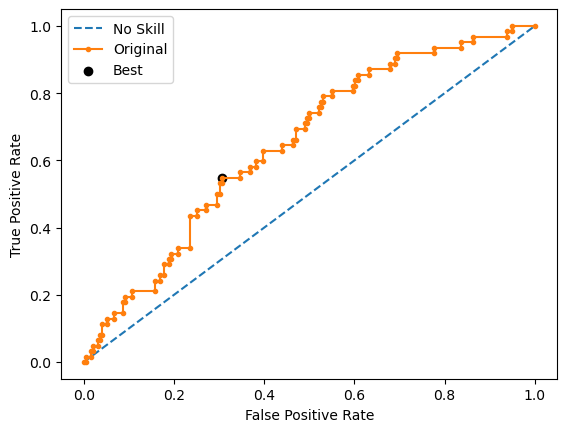

Run 5 - Random State: 4
Test G-mean: 0.5755181996745907
Best Threshold=0.505181, G-Mean=0.598


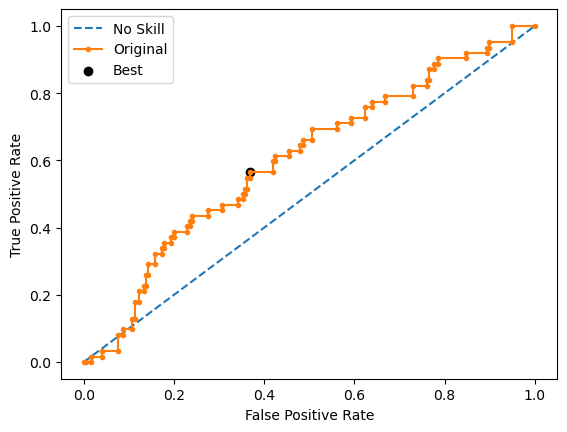

Ave Test G-mean: 0.5949825263207936
Stdev Test G-mean: 0.02254412200611578
Ave Test Specificity: 0.6479591836734695
Ave Test Recall: 0.5483870967741935
Ave Test NPV: 0.8194155913142911
Ave Test Accuracy: 0.624031007751938
Ave Test Precision: 0.3310702454346537
Ave Test F1-Score: 0.4120867167403376
Ave Runtime: 0.6723258018493652


In [112]:
ho_t05_rf_gs, ho_t05_rf_be, ho_t05_rf_model_info, ho_t05_rf_metrics_df = rf_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6917977	total: 1.98ms	remaining: 1.98s
1:	learn: 0.6902348	total: 4ms	remaining: 2s
2:	learn: 0.6893033	total: 5.77ms	remaining: 1.92s
3:	learn: 0.6885068	total: 7.67ms	remaining: 1.91s
4:	learn: 0.6875450	total: 9.58ms	remaining: 1.91s
5:	learn: 0.6861445	total: 11.4ms	remaining: 1.88s
6:	learn: 0.6853292	total: 13.3ms	remaining: 1.89s
7:	learn: 0.6845619	total: 15.3ms	remaining: 1.89s
8:	learn: 0.6833746	total: 17.2ms	remaining: 1.89s
9:	learn: 0.6821821	total: 19.2ms	remaining: 1.9s
10:	learn: 0.6809110	total: 20.9ms	remaining: 1.88s
11:	learn: 0.6797924	total: 22.8ms	remaining: 1.88s
12:	learn: 0.6787607	total: 24.7ms	remaining: 1.87s
13:	learn: 0.6772935	total: 26.7ms	remaining: 1.88s
14:	learn: 0.6761927	total: 28.9ms	remaining: 1.9s
15:	learn: 0.6751500	total: 30.8ms	remaining: 1.9s
16:	learn: 0.6738294	total: 32.7ms	remaining: 1.89s
17:	learn: 0.6727370	total: 34.6ms	remaining

209:	learn: 0.5182057	total: 385ms	remaining: 1.45s
210:	learn: 0.5171163	total: 387ms	remaining: 1.45s
211:	learn: 0.5165411	total: 389ms	remaining: 1.45s
212:	learn: 0.5160632	total: 391ms	remaining: 1.44s
213:	learn: 0.5152359	total: 393ms	remaining: 1.44s
214:	learn: 0.5148164	total: 394ms	remaining: 1.44s
215:	learn: 0.5138131	total: 396ms	remaining: 1.44s
216:	learn: 0.5134295	total: 398ms	remaining: 1.44s
217:	learn: 0.5126399	total: 400ms	remaining: 1.43s
218:	learn: 0.5119034	total: 402ms	remaining: 1.43s
219:	learn: 0.5113070	total: 404ms	remaining: 1.43s
220:	learn: 0.5103779	total: 405ms	remaining: 1.43s
221:	learn: 0.5098628	total: 407ms	remaining: 1.43s
222:	learn: 0.5094772	total: 409ms	remaining: 1.42s
223:	learn: 0.5089241	total: 411ms	remaining: 1.42s
224:	learn: 0.5082908	total: 413ms	remaining: 1.42s
225:	learn: 0.5076882	total: 415ms	remaining: 1.42s
226:	learn: 0.5073757	total: 417ms	remaining: 1.42s
227:	learn: 0.5067931	total: 419ms	remaining: 1.42s
228:	learn: 

421:	learn: 0.4127050	total: 771ms	remaining: 1.06s
422:	learn: 0.4123471	total: 773ms	remaining: 1.05s
423:	learn: 0.4121011	total: 775ms	remaining: 1.05s
424:	learn: 0.4117057	total: 776ms	remaining: 1.05s
425:	learn: 0.4111709	total: 778ms	remaining: 1.05s
426:	learn: 0.4108548	total: 780ms	remaining: 1.05s
427:	learn: 0.4105841	total: 782ms	remaining: 1.04s
428:	learn: 0.4102102	total: 784ms	remaining: 1.04s
429:	learn: 0.4097310	total: 786ms	remaining: 1.04s
430:	learn: 0.4094256	total: 788ms	remaining: 1.04s
431:	learn: 0.4088337	total: 790ms	remaining: 1.04s
432:	learn: 0.4083765	total: 792ms	remaining: 1.04s
433:	learn: 0.4079315	total: 794ms	remaining: 1.03s
434:	learn: 0.4075237	total: 795ms	remaining: 1.03s
435:	learn: 0.4070136	total: 797ms	remaining: 1.03s
436:	learn: 0.4065106	total: 799ms	remaining: 1.03s
437:	learn: 0.4060589	total: 801ms	remaining: 1.03s
438:	learn: 0.4056106	total: 803ms	remaining: 1.02s
439:	learn: 0.4051909	total: 804ms	remaining: 1.02s
440:	learn: 

637:	learn: 0.3325240	total: 1.16s	remaining: 658ms
638:	learn: 0.3322742	total: 1.16s	remaining: 657ms
639:	learn: 0.3319312	total: 1.16s	remaining: 655ms
640:	learn: 0.3314869	total: 1.17s	remaining: 653ms
641:	learn: 0.3311765	total: 1.17s	remaining: 651ms
642:	learn: 0.3310559	total: 1.17s	remaining: 649ms
643:	learn: 0.3305643	total: 1.17s	remaining: 648ms
644:	learn: 0.3303318	total: 1.17s	remaining: 646ms
645:	learn: 0.3299882	total: 1.18s	remaining: 644ms
646:	learn: 0.3296761	total: 1.18s	remaining: 642ms
647:	learn: 0.3291308	total: 1.18s	remaining: 640ms
648:	learn: 0.3286656	total: 1.18s	remaining: 639ms
649:	learn: 0.3283450	total: 1.18s	remaining: 637ms
650:	learn: 0.3280588	total: 1.18s	remaining: 635ms
651:	learn: 0.3277035	total: 1.19s	remaining: 633ms
652:	learn: 0.3274166	total: 1.19s	remaining: 631ms
653:	learn: 0.3269967	total: 1.19s	remaining: 629ms
654:	learn: 0.3265809	total: 1.19s	remaining: 627ms
655:	learn: 0.3262355	total: 1.19s	remaining: 626ms
656:	learn: 

854:	learn: 0.2674979	total: 1.55s	remaining: 263ms
855:	learn: 0.2672352	total: 1.55s	remaining: 261ms
856:	learn: 0.2668640	total: 1.55s	remaining: 259ms
857:	learn: 0.2665318	total: 1.55s	remaining: 257ms
858:	learn: 0.2664205	total: 1.55s	remaining: 255ms
859:	learn: 0.2660474	total: 1.56s	remaining: 253ms
860:	learn: 0.2656724	total: 1.56s	remaining: 252ms
861:	learn: 0.2653528	total: 1.56s	remaining: 250ms
862:	learn: 0.2648672	total: 1.56s	remaining: 248ms
863:	learn: 0.2645359	total: 1.56s	remaining: 246ms
864:	learn: 0.2640791	total: 1.57s	remaining: 244ms
865:	learn: 0.2636212	total: 1.57s	remaining: 243ms
866:	learn: 0.2635299	total: 1.57s	remaining: 241ms
867:	learn: 0.2632813	total: 1.57s	remaining: 239ms
868:	learn: 0.2628705	total: 1.57s	remaining: 237ms
869:	learn: 0.2626254	total: 1.57s	remaining: 235ms
870:	learn: 0.2624175	total: 1.58s	remaining: 234ms
871:	learn: 0.2621435	total: 1.58s	remaining: 232ms
872:	learn: 0.2617040	total: 1.58s	remaining: 230ms
873:	learn: 

37:	learn: 0.6512141	total: 72.8ms	remaining: 1.84s
38:	learn: 0.6501259	total: 74.9ms	remaining: 1.84s
39:	learn: 0.6487563	total: 76.7ms	remaining: 1.84s
40:	learn: 0.6481056	total: 78.5ms	remaining: 1.84s
41:	learn: 0.6469914	total: 80.2ms	remaining: 1.83s
42:	learn: 0.6458757	total: 82ms	remaining: 1.82s
43:	learn: 0.6448965	total: 84ms	remaining: 1.82s
44:	learn: 0.6435167	total: 85.9ms	remaining: 1.82s
45:	learn: 0.6422189	total: 87.6ms	remaining: 1.82s
46:	learn: 0.6409662	total: 89.4ms	remaining: 1.81s
47:	learn: 0.6400286	total: 91.2ms	remaining: 1.81s
48:	learn: 0.6391414	total: 93ms	remaining: 1.8s
49:	learn: 0.6377608	total: 94.7ms	remaining: 1.8s
50:	learn: 0.6371928	total: 96.5ms	remaining: 1.79s
51:	learn: 0.6360025	total: 98.3ms	remaining: 1.79s
52:	learn: 0.6351765	total: 100ms	remaining: 1.79s
53:	learn: 0.6339356	total: 102ms	remaining: 1.78s
54:	learn: 0.6332021	total: 104ms	remaining: 1.78s
55:	learn: 0.6325167	total: 106ms	remaining: 1.78s
56:	learn: 0.6317388	tot

253:	learn: 0.4919913	total: 460ms	remaining: 1.35s
254:	learn: 0.4917121	total: 462ms	remaining: 1.35s
255:	learn: 0.4910679	total: 464ms	remaining: 1.35s
256:	learn: 0.4901206	total: 466ms	remaining: 1.35s
257:	learn: 0.4893245	total: 468ms	remaining: 1.34s
258:	learn: 0.4888252	total: 469ms	remaining: 1.34s
259:	learn: 0.4883181	total: 471ms	remaining: 1.34s
260:	learn: 0.4879173	total: 473ms	remaining: 1.34s
261:	learn: 0.4876884	total: 475ms	remaining: 1.34s
262:	learn: 0.4870915	total: 477ms	remaining: 1.33s
263:	learn: 0.4864285	total: 478ms	remaining: 1.33s
264:	learn: 0.4855256	total: 480ms	remaining: 1.33s
265:	learn: 0.4851893	total: 482ms	remaining: 1.33s
266:	learn: 0.4846848	total: 484ms	remaining: 1.33s
267:	learn: 0.4841734	total: 486ms	remaining: 1.33s
268:	learn: 0.4837675	total: 488ms	remaining: 1.32s
269:	learn: 0.4830839	total: 489ms	remaining: 1.32s
270:	learn: 0.4829239	total: 491ms	remaining: 1.32s
271:	learn: 0.4822645	total: 493ms	remaining: 1.32s
272:	learn: 

468:	learn: 0.3942860	total: 850ms	remaining: 963ms
469:	learn: 0.3940785	total: 852ms	remaining: 961ms
470:	learn: 0.3936435	total: 854ms	remaining: 959ms
471:	learn: 0.3934576	total: 856ms	remaining: 957ms
472:	learn: 0.3928617	total: 858ms	remaining: 955ms
473:	learn: 0.3921838	total: 859ms	remaining: 954ms
474:	learn: 0.3914312	total: 861ms	remaining: 952ms
475:	learn: 0.3911634	total: 863ms	remaining: 950ms
476:	learn: 0.3909102	total: 865ms	remaining: 948ms
477:	learn: 0.3904985	total: 867ms	remaining: 946ms
478:	learn: 0.3902310	total: 868ms	remaining: 944ms
479:	learn: 0.3892969	total: 870ms	remaining: 942ms
480:	learn: 0.3888393	total: 872ms	remaining: 941ms
481:	learn: 0.3886383	total: 874ms	remaining: 939ms
482:	learn: 0.3878745	total: 876ms	remaining: 937ms
483:	learn: 0.3876477	total: 878ms	remaining: 936ms
484:	learn: 0.3872208	total: 879ms	remaining: 934ms
485:	learn: 0.3869447	total: 881ms	remaining: 932ms
486:	learn: 0.3866540	total: 883ms	remaining: 930ms
487:	learn: 

681:	learn: 0.3188674	total: 1.24s	remaining: 576ms
682:	learn: 0.3185530	total: 1.24s	remaining: 575ms
683:	learn: 0.3183753	total: 1.24s	remaining: 573ms
684:	learn: 0.3180101	total: 1.24s	remaining: 571ms
685:	learn: 0.3178741	total: 1.24s	remaining: 569ms
686:	learn: 0.3176467	total: 1.25s	remaining: 567ms
687:	learn: 0.3171569	total: 1.25s	remaining: 566ms
688:	learn: 0.3168753	total: 1.25s	remaining: 564ms
689:	learn: 0.3164523	total: 1.25s	remaining: 562ms
690:	learn: 0.3161997	total: 1.25s	remaining: 560ms
691:	learn: 0.3156277	total: 1.25s	remaining: 558ms
692:	learn: 0.3153580	total: 1.26s	remaining: 557ms
693:	learn: 0.3150614	total: 1.26s	remaining: 555ms
694:	learn: 0.3148165	total: 1.26s	remaining: 553ms
695:	learn: 0.3145208	total: 1.26s	remaining: 551ms
696:	learn: 0.3141571	total: 1.26s	remaining: 549ms
697:	learn: 0.3137985	total: 1.26s	remaining: 547ms
698:	learn: 0.3135181	total: 1.27s	remaining: 546ms
699:	learn: 0.3131037	total: 1.27s	remaining: 544ms
700:	learn: 

894:	learn: 0.2557850	total: 1.62s	remaining: 191ms
895:	learn: 0.2555186	total: 1.63s	remaining: 189ms
896:	learn: 0.2550701	total: 1.63s	remaining: 187ms
897:	learn: 0.2549218	total: 1.63s	remaining: 185ms
898:	learn: 0.2547016	total: 1.63s	remaining: 183ms
899:	learn: 0.2543623	total: 1.63s	remaining: 182ms
900:	learn: 0.2540480	total: 1.64s	remaining: 180ms
901:	learn: 0.2536534	total: 1.64s	remaining: 178ms
902:	learn: 0.2534835	total: 1.64s	remaining: 176ms
903:	learn: 0.2531608	total: 1.64s	remaining: 174ms
904:	learn: 0.2527962	total: 1.64s	remaining: 172ms
905:	learn: 0.2524504	total: 1.64s	remaining: 171ms
906:	learn: 0.2520841	total: 1.65s	remaining: 169ms
907:	learn: 0.2518681	total: 1.65s	remaining: 167ms
908:	learn: 0.2514260	total: 1.65s	remaining: 165ms
909:	learn: 0.2511442	total: 1.65s	remaining: 163ms
910:	learn: 0.2510307	total: 1.65s	remaining: 162ms
911:	learn: 0.2506081	total: 1.66s	remaining: 160ms
912:	learn: 0.2503972	total: 1.66s	remaining: 158ms
913:	learn: 

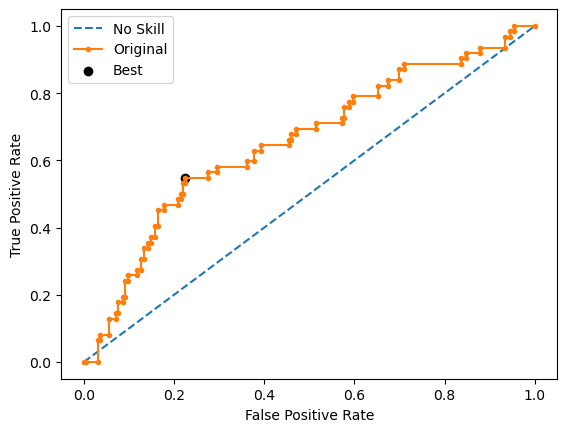

Learning rate set to 0.006754
0:	learn: 0.6914433	total: 2.23ms	remaining: 2.23s
1:	learn: 0.6900294	total: 4.05ms	remaining: 2.02s
2:	learn: 0.6886887	total: 6.01ms	remaining: 2s
3:	learn: 0.6876392	total: 7.87ms	remaining: 1.96s
4:	learn: 0.6864282	total: 9.56ms	remaining: 1.9s
5:	learn: 0.6847816	total: 11.5ms	remaining: 1.9s
6:	learn: 0.6831166	total: 13.3ms	remaining: 1.88s
7:	learn: 0.6815465	total: 15.2ms	remaining: 1.88s
8:	learn: 0.6804804	total: 17ms	remaining: 1.87s
9:	learn: 0.6788058	total: 18.8ms	remaining: 1.86s
10:	learn: 0.6772484	total: 20.6ms	remaining: 1.85s
11:	learn: 0.6750571	total: 22.3ms	remaining: 1.84s
12:	learn: 0.6733833	total: 24.2ms	remaining: 1.84s
13:	learn: 0.6724862	total: 26.3ms	remaining: 1.85s
14:	learn: 0.6709660	total: 28.1ms	remaining: 1.84s
15:	learn: 0.6693293	total: 29.8ms	remaining: 1.83s
16:	learn: 0.6678461	total: 31.7ms	remaining: 1.83s
17:	learn: 0.6666597	total: 33.3ms	remaining: 1.82s
18:	learn: 0.6654598	total: 35.2ms	remaining: 1.82s

211:	learn: 0.4928196	total: 387ms	remaining: 1.44s
212:	learn: 0.4921410	total: 389ms	remaining: 1.44s
213:	learn: 0.4916169	total: 391ms	remaining: 1.44s
214:	learn: 0.4910839	total: 393ms	remaining: 1.43s
215:	learn: 0.4902932	total: 394ms	remaining: 1.43s
216:	learn: 0.4895780	total: 396ms	remaining: 1.43s
217:	learn: 0.4891704	total: 398ms	remaining: 1.43s
218:	learn: 0.4887203	total: 400ms	remaining: 1.43s
219:	learn: 0.4882922	total: 402ms	remaining: 1.42s
220:	learn: 0.4876701	total: 404ms	remaining: 1.42s
221:	learn: 0.4873804	total: 405ms	remaining: 1.42s
222:	learn: 0.4864901	total: 407ms	remaining: 1.42s
223:	learn: 0.4858402	total: 409ms	remaining: 1.42s
224:	learn: 0.4854607	total: 411ms	remaining: 1.42s
225:	learn: 0.4848347	total: 413ms	remaining: 1.41s
226:	learn: 0.4843823	total: 415ms	remaining: 1.41s
227:	learn: 0.4838582	total: 417ms	remaining: 1.41s
228:	learn: 0.4830484	total: 419ms	remaining: 1.41s
229:	learn: 0.4826095	total: 421ms	remaining: 1.41s
230:	learn: 

426:	learn: 0.3926577	total: 775ms	remaining: 1.04s
427:	learn: 0.3921253	total: 777ms	remaining: 1.04s
428:	learn: 0.3920320	total: 779ms	remaining: 1.04s
429:	learn: 0.3915561	total: 781ms	remaining: 1.03s
430:	learn: 0.3913069	total: 783ms	remaining: 1.03s
431:	learn: 0.3909844	total: 784ms	remaining: 1.03s
432:	learn: 0.3904192	total: 786ms	remaining: 1.03s
433:	learn: 0.3901324	total: 788ms	remaining: 1.03s
434:	learn: 0.3895719	total: 790ms	remaining: 1.02s
435:	learn: 0.3894390	total: 792ms	remaining: 1.02s
436:	learn: 0.3892074	total: 794ms	remaining: 1.02s
437:	learn: 0.3889102	total: 796ms	remaining: 1.02s
438:	learn: 0.3887250	total: 798ms	remaining: 1.02s
439:	learn: 0.3880523	total: 799ms	remaining: 1.02s
440:	learn: 0.3871268	total: 801ms	remaining: 1.01s
441:	learn: 0.3866948	total: 803ms	remaining: 1.01s
442:	learn: 0.3865057	total: 805ms	remaining: 1.01s
443:	learn: 0.3861749	total: 807ms	remaining: 1.01s
444:	learn: 0.3859036	total: 809ms	remaining: 1.01s
445:	learn: 

643:	learn: 0.3189639	total: 1.17s	remaining: 644ms
644:	learn: 0.3185439	total: 1.17s	remaining: 643ms
645:	learn: 0.3180030	total: 1.17s	remaining: 641ms
646:	learn: 0.3177111	total: 1.17s	remaining: 639ms
647:	learn: 0.3175763	total: 1.17s	remaining: 637ms
648:	learn: 0.3172356	total: 1.18s	remaining: 636ms
649:	learn: 0.3169796	total: 1.18s	remaining: 634ms
650:	learn: 0.3164208	total: 1.18s	remaining: 632ms
651:	learn: 0.3161503	total: 1.18s	remaining: 630ms
652:	learn: 0.3158622	total: 1.18s	remaining: 628ms
653:	learn: 0.3154026	total: 1.18s	remaining: 626ms
654:	learn: 0.3149772	total: 1.19s	remaining: 624ms
655:	learn: 0.3148215	total: 1.19s	remaining: 622ms
656:	learn: 0.3146334	total: 1.19s	remaining: 621ms
657:	learn: 0.3145232	total: 1.19s	remaining: 619ms
658:	learn: 0.3142103	total: 1.19s	remaining: 617ms
659:	learn: 0.3139992	total: 1.19s	remaining: 615ms
660:	learn: 0.3136175	total: 1.2s	remaining: 613ms
661:	learn: 0.3134417	total: 1.2s	remaining: 611ms
662:	learn: 0.

861:	learn: 0.2576291	total: 1.56s	remaining: 249ms
862:	learn: 0.2573222	total: 1.56s	remaining: 248ms
863:	learn: 0.2572360	total: 1.56s	remaining: 246ms
864:	learn: 0.2570422	total: 1.56s	remaining: 244ms
865:	learn: 0.2567624	total: 1.56s	remaining: 242ms
866:	learn: 0.2562177	total: 1.57s	remaining: 240ms
867:	learn: 0.2558454	total: 1.57s	remaining: 239ms
868:	learn: 0.2554064	total: 1.57s	remaining: 237ms
869:	learn: 0.2549497	total: 1.57s	remaining: 235ms
870:	learn: 0.2544730	total: 1.57s	remaining: 233ms
871:	learn: 0.2543358	total: 1.57s	remaining: 231ms
872:	learn: 0.2540019	total: 1.58s	remaining: 229ms
873:	learn: 0.2536442	total: 1.58s	remaining: 228ms
874:	learn: 0.2532555	total: 1.58s	remaining: 226ms
875:	learn: 0.2530109	total: 1.58s	remaining: 224ms
876:	learn: 0.2529301	total: 1.58s	remaining: 222ms
877:	learn: 0.2524819	total: 1.59s	remaining: 221ms
878:	learn: 0.2522565	total: 1.59s	remaining: 219ms
879:	learn: 0.2520008	total: 1.59s	remaining: 217ms
880:	learn: 

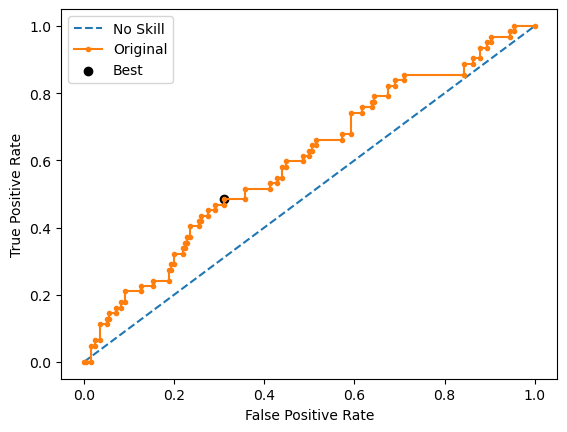

Learning rate set to 0.006754
0:	learn: 0.6924791	total: 4.17ms	remaining: 4.17s
1:	learn: 0.6909744	total: 9.3ms	remaining: 4.64s
2:	learn: 0.6900791	total: 14.7ms	remaining: 4.89s
3:	learn: 0.6893194	total: 20.5ms	remaining: 5.09s
4:	learn: 0.6887967	total: 25.5ms	remaining: 5.07s
5:	learn: 0.6876795	total: 29.3ms	remaining: 4.86s
6:	learn: 0.6867252	total: 31.3ms	remaining: 4.44s
7:	learn: 0.6860541	total: 34.7ms	remaining: 4.31s
8:	learn: 0.6852618	total: 38.6ms	remaining: 4.25s
9:	learn: 0.6844782	total: 42.1ms	remaining: 4.17s
10:	learn: 0.6835143	total: 45.6ms	remaining: 4.1s
11:	learn: 0.6824772	total: 48.7ms	remaining: 4.01s
12:	learn: 0.6815703	total: 51.7ms	remaining: 3.92s
13:	learn: 0.6808079	total: 54.3ms	remaining: 3.82s
14:	learn: 0.6800360	total: 56.5ms	remaining: 3.71s
15:	learn: 0.6792798	total: 58.9ms	remaining: 3.62s
16:	learn: 0.6781292	total: 61.3ms	remaining: 3.55s
17:	learn: 0.6772525	total: 63.1ms	remaining: 3.44s
18:	learn: 0.6764761	total: 65.1ms	remaining: 

197:	learn: 0.5504303	total: 388ms	remaining: 1.57s
198:	learn: 0.5496875	total: 390ms	remaining: 1.57s
199:	learn: 0.5492370	total: 392ms	remaining: 1.57s
200:	learn: 0.5486552	total: 394ms	remaining: 1.56s
201:	learn: 0.5482467	total: 396ms	remaining: 1.56s
202:	learn: 0.5476879	total: 398ms	remaining: 1.56s
203:	learn: 0.5469310	total: 399ms	remaining: 1.56s
204:	learn: 0.5463549	total: 401ms	remaining: 1.55s
205:	learn: 0.5457186	total: 403ms	remaining: 1.55s
206:	learn: 0.5450682	total: 405ms	remaining: 1.55s
207:	learn: 0.5443798	total: 406ms	remaining: 1.55s
208:	learn: 0.5437347	total: 408ms	remaining: 1.54s
209:	learn: 0.5428018	total: 410ms	remaining: 1.54s
210:	learn: 0.5421609	total: 412ms	remaining: 1.54s
211:	learn: 0.5414611	total: 414ms	remaining: 1.54s
212:	learn: 0.5411677	total: 415ms	remaining: 1.53s
213:	learn: 0.5408100	total: 417ms	remaining: 1.53s
214:	learn: 0.5401507	total: 419ms	remaining: 1.53s
215:	learn: 0.5397614	total: 421ms	remaining: 1.53s
216:	learn: 

412:	learn: 0.4432560	total: 777ms	remaining: 1.1s
413:	learn: 0.4428279	total: 779ms	remaining: 1.1s
414:	learn: 0.4422579	total: 781ms	remaining: 1.1s
415:	learn: 0.4418737	total: 783ms	remaining: 1.1s
416:	learn: 0.4413674	total: 785ms	remaining: 1.1s
417:	learn: 0.4408714	total: 787ms	remaining: 1.09s
418:	learn: 0.4404053	total: 789ms	remaining: 1.09s
419:	learn: 0.4401565	total: 790ms	remaining: 1.09s
420:	learn: 0.4394326	total: 792ms	remaining: 1.09s
421:	learn: 0.4389298	total: 794ms	remaining: 1.09s
422:	learn: 0.4388048	total: 796ms	remaining: 1.08s
423:	learn: 0.4386292	total: 798ms	remaining: 1.08s
424:	learn: 0.4381449	total: 800ms	remaining: 1.08s
425:	learn: 0.4375097	total: 802ms	remaining: 1.08s
426:	learn: 0.4368946	total: 803ms	remaining: 1.08s
427:	learn: 0.4366925	total: 805ms	remaining: 1.08s
428:	learn: 0.4364095	total: 807ms	remaining: 1.07s
429:	learn: 0.4360232	total: 809ms	remaining: 1.07s
430:	learn: 0.4356331	total: 811ms	remaining: 1.07s
431:	learn: 0.435

628:	learn: 0.3660034	total: 1.17s	remaining: 688ms
629:	learn: 0.3656888	total: 1.17s	remaining: 686ms
630:	learn: 0.3654241	total: 1.17s	remaining: 685ms
631:	learn: 0.3652199	total: 1.17s	remaining: 683ms
632:	learn: 0.3649905	total: 1.17s	remaining: 681ms
633:	learn: 0.3645130	total: 1.18s	remaining: 679ms
634:	learn: 0.3642809	total: 1.18s	remaining: 677ms
635:	learn: 0.3639396	total: 1.18s	remaining: 675ms
636:	learn: 0.3635313	total: 1.18s	remaining: 673ms
637:	learn: 0.3628543	total: 1.18s	remaining: 671ms
638:	learn: 0.3622732	total: 1.18s	remaining: 669ms
639:	learn: 0.3617915	total: 1.19s	remaining: 668ms
640:	learn: 0.3616343	total: 1.19s	remaining: 666ms
641:	learn: 0.3615021	total: 1.19s	remaining: 664ms
642:	learn: 0.3613061	total: 1.19s	remaining: 662ms
643:	learn: 0.3610778	total: 1.19s	remaining: 660ms
644:	learn: 0.3607039	total: 1.2s	remaining: 658ms
645:	learn: 0.3601763	total: 1.2s	remaining: 656ms
646:	learn: 0.3597959	total: 1.2s	remaining: 654ms
647:	learn: 0.3

843:	learn: 0.3010430	total: 1.55s	remaining: 287ms
844:	learn: 0.3006830	total: 1.55s	remaining: 285ms
845:	learn: 0.3005685	total: 1.56s	remaining: 283ms
846:	learn: 0.3001695	total: 1.56s	remaining: 282ms
847:	learn: 0.2996892	total: 1.56s	remaining: 280ms
848:	learn: 0.2995073	total: 1.56s	remaining: 278ms
849:	learn: 0.2992585	total: 1.56s	remaining: 276ms
850:	learn: 0.2990496	total: 1.57s	remaining: 274ms
851:	learn: 0.2987047	total: 1.57s	remaining: 272ms
852:	learn: 0.2983457	total: 1.57s	remaining: 271ms
853:	learn: 0.2980479	total: 1.57s	remaining: 269ms
854:	learn: 0.2978529	total: 1.57s	remaining: 267ms
855:	learn: 0.2974755	total: 1.57s	remaining: 265ms
856:	learn: 0.2974340	total: 1.58s	remaining: 263ms
857:	learn: 0.2971129	total: 1.58s	remaining: 261ms
858:	learn: 0.2969498	total: 1.58s	remaining: 259ms
859:	learn: 0.2967791	total: 1.58s	remaining: 258ms
860:	learn: 0.2963406	total: 1.58s	remaining: 256ms
861:	learn: 0.2960038	total: 1.58s	remaining: 254ms
862:	learn: 

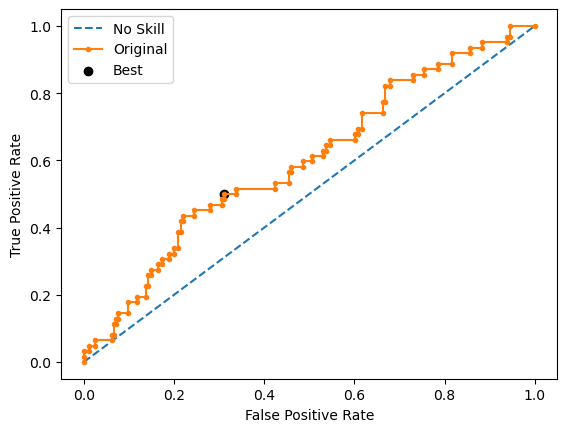

Learning rate set to 0.006754
0:	learn: 0.6922129	total: 3.14ms	remaining: 3.13s
1:	learn: 0.6912579	total: 6.51ms	remaining: 3.25s
2:	learn: 0.6903449	total: 10.6ms	remaining: 3.54s
3:	learn: 0.6887396	total: 14.7ms	remaining: 3.65s
4:	learn: 0.6879495	total: 18.5ms	remaining: 3.69s
5:	learn: 0.6867959	total: 22.1ms	remaining: 3.65s
6:	learn: 0.6852498	total: 25.4ms	remaining: 3.61s
7:	learn: 0.6835548	total: 28.7ms	remaining: 3.56s
8:	learn: 0.6825712	total: 30.6ms	remaining: 3.37s
9:	learn: 0.6809767	total: 32.4ms	remaining: 3.2s
10:	learn: 0.6797229	total: 34ms	remaining: 3.06s
11:	learn: 0.6781012	total: 35.8ms	remaining: 2.95s
12:	learn: 0.6770691	total: 38ms	remaining: 2.88s
13:	learn: 0.6766071	total: 39.7ms	remaining: 2.8s
14:	learn: 0.6753485	total: 41.7ms	remaining: 2.74s
15:	learn: 0.6736385	total: 43.6ms	remaining: 2.68s
16:	learn: 0.6718781	total: 45.5ms	remaining: 2.63s
17:	learn: 0.6708526	total: 47.2ms	remaining: 2.57s
18:	learn: 0.6693183	total: 49ms	remaining: 2.53s


218:	learn: 0.5121674	total: 410ms	remaining: 1.46s
219:	learn: 0.5114471	total: 412ms	remaining: 1.46s
220:	learn: 0.5106455	total: 414ms	remaining: 1.46s
221:	learn: 0.5098963	total: 416ms	remaining: 1.46s
222:	learn: 0.5092248	total: 418ms	remaining: 1.45s
223:	learn: 0.5087164	total: 419ms	remaining: 1.45s
224:	learn: 0.5077632	total: 421ms	remaining: 1.45s
225:	learn: 0.5072300	total: 422ms	remaining: 1.45s
226:	learn: 0.5066473	total: 424ms	remaining: 1.44s
227:	learn: 0.5062627	total: 426ms	remaining: 1.44s
228:	learn: 0.5054566	total: 428ms	remaining: 1.44s
229:	learn: 0.5050751	total: 430ms	remaining: 1.44s
230:	learn: 0.5043478	total: 431ms	remaining: 1.44s
231:	learn: 0.5036132	total: 433ms	remaining: 1.43s
232:	learn: 0.5032685	total: 435ms	remaining: 1.43s
233:	learn: 0.5025051	total: 437ms	remaining: 1.43s
234:	learn: 0.5021759	total: 438ms	remaining: 1.43s
235:	learn: 0.5014245	total: 440ms	remaining: 1.43s
236:	learn: 0.5011057	total: 442ms	remaining: 1.42s
237:	learn: 

432:	learn: 0.4113804	total: 799ms	remaining: 1.04s
433:	learn: 0.4111289	total: 800ms	remaining: 1.04s
434:	learn: 0.4108068	total: 802ms	remaining: 1.04s
435:	learn: 0.4102193	total: 804ms	remaining: 1.04s
436:	learn: 0.4100487	total: 806ms	remaining: 1.04s
437:	learn: 0.4093978	total: 807ms	remaining: 1.03s
438:	learn: 0.4086800	total: 809ms	remaining: 1.03s
439:	learn: 0.4083226	total: 811ms	remaining: 1.03s
440:	learn: 0.4078427	total: 813ms	remaining: 1.03s
441:	learn: 0.4076410	total: 815ms	remaining: 1.03s
442:	learn: 0.4073988	total: 817ms	remaining: 1.03s
443:	learn: 0.4071052	total: 818ms	remaining: 1.02s
444:	learn: 0.4068279	total: 820ms	remaining: 1.02s
445:	learn: 0.4061269	total: 822ms	remaining: 1.02s
446:	learn: 0.4059725	total: 823ms	remaining: 1.02s
447:	learn: 0.4052381	total: 825ms	remaining: 1.02s
448:	learn: 0.4045535	total: 827ms	remaining: 1.01s
449:	learn: 0.4037695	total: 829ms	remaining: 1.01s
450:	learn: 0.4029580	total: 831ms	remaining: 1.01s
451:	learn: 

645:	learn: 0.3366906	total: 1.19s	remaining: 651ms
646:	learn: 0.3363832	total: 1.19s	remaining: 649ms
647:	learn: 0.3360785	total: 1.19s	remaining: 647ms
648:	learn: 0.3356926	total: 1.19s	remaining: 646ms
649:	learn: 0.3354827	total: 1.2s	remaining: 644ms
650:	learn: 0.3353376	total: 1.2s	remaining: 642ms
651:	learn: 0.3350678	total: 1.2s	remaining: 640ms
652:	learn: 0.3348949	total: 1.2s	remaining: 638ms
653:	learn: 0.3346773	total: 1.2s	remaining: 636ms
654:	learn: 0.3344327	total: 1.2s	remaining: 634ms
655:	learn: 0.3343672	total: 1.21s	remaining: 632ms
656:	learn: 0.3338880	total: 1.21s	remaining: 631ms
657:	learn: 0.3336962	total: 1.21s	remaining: 629ms
658:	learn: 0.3331828	total: 1.21s	remaining: 627ms
659:	learn: 0.3329927	total: 1.21s	remaining: 625ms
660:	learn: 0.3325691	total: 1.22s	remaining: 623ms
661:	learn: 0.3322112	total: 1.22s	remaining: 621ms
662:	learn: 0.3319193	total: 1.22s	remaining: 620ms
663:	learn: 0.3316246	total: 1.22s	remaining: 618ms
664:	learn: 0.3312

860:	learn: 0.2764522	total: 1.58s	remaining: 255ms
861:	learn: 0.2761777	total: 1.58s	remaining: 253ms
862:	learn: 0.2759837	total: 1.58s	remaining: 251ms
863:	learn: 0.2757902	total: 1.58s	remaining: 249ms
864:	learn: 0.2755785	total: 1.58s	remaining: 247ms
865:	learn: 0.2749869	total: 1.59s	remaining: 246ms
866:	learn: 0.2748675	total: 1.59s	remaining: 244ms
867:	learn: 0.2746857	total: 1.59s	remaining: 242ms
868:	learn: 0.2743443	total: 1.59s	remaining: 240ms
869:	learn: 0.2740564	total: 1.59s	remaining: 238ms
870:	learn: 0.2739307	total: 1.6s	remaining: 236ms
871:	learn: 0.2735394	total: 1.6s	remaining: 235ms
872:	learn: 0.2731763	total: 1.6s	remaining: 233ms
873:	learn: 0.2728143	total: 1.6s	remaining: 231ms
874:	learn: 0.2726510	total: 1.6s	remaining: 229ms
875:	learn: 0.2724019	total: 1.6s	remaining: 227ms
876:	learn: 0.2720299	total: 1.61s	remaining: 225ms
877:	learn: 0.2716105	total: 1.61s	remaining: 224ms
878:	learn: 0.2713847	total: 1.61s	remaining: 222ms
879:	learn: 0.2710

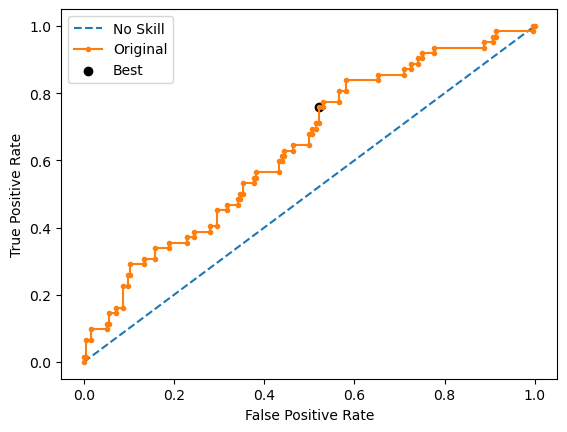

Learning rate set to 0.006754
0:	learn: 0.6914568	total: 2.51ms	remaining: 2.5s
1:	learn: 0.6902125	total: 4.95ms	remaining: 2.47s
2:	learn: 0.6887068	total: 6.99ms	remaining: 2.32s
3:	learn: 0.6874764	total: 9.92ms	remaining: 2.47s
4:	learn: 0.6860968	total: 13.2ms	remaining: 2.62s
5:	learn: 0.6846044	total: 15.6ms	remaining: 2.58s
6:	learn: 0.6838692	total: 17.9ms	remaining: 2.54s
7:	learn: 0.6832762	total: 20.1ms	remaining: 2.49s
8:	learn: 0.6825057	total: 22ms	remaining: 2.42s
9:	learn: 0.6814077	total: 23.8ms	remaining: 2.35s
10:	learn: 0.6804399	total: 26ms	remaining: 2.33s
11:	learn: 0.6791093	total: 28.2ms	remaining: 2.33s
12:	learn: 0.6777054	total: 30.8ms	remaining: 2.33s
13:	learn: 0.6770722	total: 32.9ms	remaining: 2.31s
14:	learn: 0.6761980	total: 34.9ms	remaining: 2.29s
15:	learn: 0.6749047	total: 36.9ms	remaining: 2.27s
16:	learn: 0.6739490	total: 38.7ms	remaining: 2.24s
17:	learn: 0.6730143	total: 40.5ms	remaining: 2.21s
18:	learn: 0.6711545	total: 42.3ms	remaining: 2.1

212:	learn: 0.5133790	total: 392ms	remaining: 1.45s
213:	learn: 0.5127564	total: 394ms	remaining: 1.45s
214:	learn: 0.5123313	total: 396ms	remaining: 1.44s
215:	learn: 0.5114401	total: 398ms	remaining: 1.44s
216:	learn: 0.5108984	total: 399ms	remaining: 1.44s
217:	learn: 0.5104248	total: 401ms	remaining: 1.44s
218:	learn: 0.5097991	total: 403ms	remaining: 1.44s
219:	learn: 0.5090622	total: 405ms	remaining: 1.44s
220:	learn: 0.5085664	total: 407ms	remaining: 1.43s
221:	learn: 0.5077878	total: 408ms	remaining: 1.43s
222:	learn: 0.5066996	total: 410ms	remaining: 1.43s
223:	learn: 0.5058839	total: 412ms	remaining: 1.43s
224:	learn: 0.5052236	total: 413ms	remaining: 1.42s
225:	learn: 0.5045612	total: 415ms	remaining: 1.42s
226:	learn: 0.5041735	total: 417ms	remaining: 1.42s
227:	learn: 0.5032126	total: 419ms	remaining: 1.42s
228:	learn: 0.5028265	total: 421ms	remaining: 1.42s
229:	learn: 0.5021297	total: 423ms	remaining: 1.41s
230:	learn: 0.5013938	total: 424ms	remaining: 1.41s
231:	learn: 

426:	learn: 0.4018190	total: 778ms	remaining: 1.04s
427:	learn: 0.4013921	total: 780ms	remaining: 1.04s
428:	learn: 0.4008502	total: 782ms	remaining: 1.04s
429:	learn: 0.4004738	total: 784ms	remaining: 1.04s
430:	learn: 0.3999118	total: 785ms	remaining: 1.04s
431:	learn: 0.3996495	total: 787ms	remaining: 1.03s
432:	learn: 0.3994639	total: 789ms	remaining: 1.03s
433:	learn: 0.3992274	total: 791ms	remaining: 1.03s
434:	learn: 0.3986539	total: 793ms	remaining: 1.03s
435:	learn: 0.3982798	total: 795ms	remaining: 1.03s
436:	learn: 0.3979346	total: 797ms	remaining: 1.03s
437:	learn: 0.3974169	total: 798ms	remaining: 1.02s
438:	learn: 0.3969480	total: 800ms	remaining: 1.02s
439:	learn: 0.3966059	total: 802ms	remaining: 1.02s
440:	learn: 0.3960835	total: 804ms	remaining: 1.02s
441:	learn: 0.3958507	total: 806ms	remaining: 1.02s
442:	learn: 0.3953870	total: 807ms	remaining: 1.01s
443:	learn: 0.3950633	total: 809ms	remaining: 1.01s
444:	learn: 0.3945678	total: 811ms	remaining: 1.01s
445:	learn: 

641:	learn: 0.3262197	total: 1.17s	remaining: 651ms
642:	learn: 0.3260095	total: 1.17s	remaining: 649ms
643:	learn: 0.3257895	total: 1.17s	remaining: 647ms
644:	learn: 0.3255619	total: 1.17s	remaining: 646ms
645:	learn: 0.3253359	total: 1.17s	remaining: 644ms
646:	learn: 0.3250034	total: 1.18s	remaining: 642ms
647:	learn: 0.3246210	total: 1.18s	remaining: 640ms
648:	learn: 0.3244399	total: 1.18s	remaining: 638ms
649:	learn: 0.3241980	total: 1.18s	remaining: 636ms
650:	learn: 0.3237971	total: 1.18s	remaining: 635ms
651:	learn: 0.3234890	total: 1.19s	remaining: 633ms
652:	learn: 0.3230889	total: 1.19s	remaining: 631ms
653:	learn: 0.3229218	total: 1.19s	remaining: 629ms
654:	learn: 0.3223482	total: 1.19s	remaining: 627ms
655:	learn: 0.3219546	total: 1.19s	remaining: 626ms
656:	learn: 0.3217429	total: 1.19s	remaining: 624ms
657:	learn: 0.3215623	total: 1.2s	remaining: 622ms
658:	learn: 0.3212284	total: 1.2s	remaining: 620ms
659:	learn: 0.3209350	total: 1.2s	remaining: 618ms
660:	learn: 0.3

856:	learn: 0.2638079	total: 1.55s	remaining: 260ms
857:	learn: 0.2635259	total: 1.56s	remaining: 258ms
858:	learn: 0.2633058	total: 1.56s	remaining: 256ms
859:	learn: 0.2630239	total: 1.56s	remaining: 254ms
860:	learn: 0.2627822	total: 1.56s	remaining: 252ms
861:	learn: 0.2624127	total: 1.56s	remaining: 251ms
862:	learn: 0.2622007	total: 1.57s	remaining: 249ms
863:	learn: 0.2621133	total: 1.57s	remaining: 247ms
864:	learn: 0.2617472	total: 1.57s	remaining: 245ms
865:	learn: 0.2616584	total: 1.57s	remaining: 243ms
866:	learn: 0.2613098	total: 1.57s	remaining: 241ms
867:	learn: 0.2609488	total: 1.57s	remaining: 240ms
868:	learn: 0.2605431	total: 1.58s	remaining: 238ms
869:	learn: 0.2603465	total: 1.58s	remaining: 236ms
870:	learn: 0.2600658	total: 1.58s	remaining: 234ms
871:	learn: 0.2598024	total: 1.58s	remaining: 232ms
872:	learn: 0.2594865	total: 1.58s	remaining: 231ms
873:	learn: 0.2591960	total: 1.59s	remaining: 229ms
874:	learn: 0.2590625	total: 1.59s	remaining: 227ms
875:	learn: 

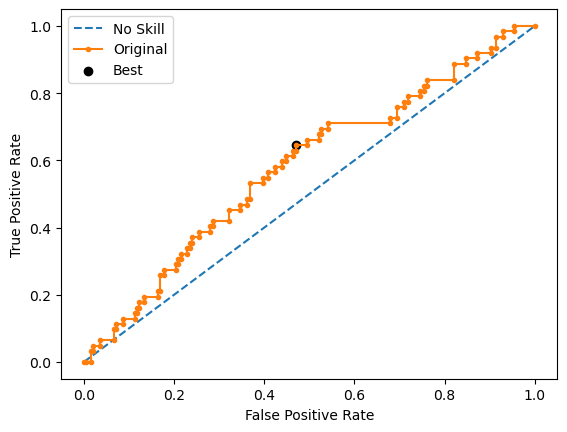

Ave Test G-mean: 0.5814443187899833
Stdev Test G-mean: 0.018374617350089432
Ave Test Specificity: 0.6091836734693877
Ave Test Recall: 0.5580645161290322
Ave Test NPV: 0.8136491858338042
Ave Test Accuracy: 0.5968992248062015
Ave Test Precision: 0.31170357468316395
Ave Test F1-Score: 0.39914401146298845
Ave Runtime: 1.9785992622375488


In [114]:
ho_t05_catboost_gs, ho_t05_catboost_be, ho_t05_catboost_model_info, ho_t05_catboost_metrics_df = catboost_class2(ho_t05, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [117]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t05_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t05_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t05_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.595716,0.029971,0.588219,NaN,0.622449,0.583871,0.330100,0.417926,0.613178
4,Random Forest,0.594983,0.022544,0.595931,0.609932,0.647959,0.548387,0.331070,0.412087,0.624031
6,LightGBM,0.594571,0.046128,0.611386,0.738260,0.624490,0.570968,0.324560,0.412913,0.611628
8,AdaBoost,0.582932,0.026115,0.587472,0.947826,0.620408,0.548387,0.314539,0.399481,0.603101
9,CatBoost,0.581444,0.018375,0.598435,0.947852,0.609184,0.558065,0.311704,0.399144,0.596899
7,Extreme Gradient Boosting (XGBoost),0.572392,0.031446,0.590344,0.851932,0.580612,0.570968,0.301846,0.393465,0.578295
2,Logistic Regression,0.569837,0.020976,0.561460,NaN,0.614286,0.529032,0.302996,0.385148,0.593798
5,Gradient Boosting Machine (GBM),0.560147,0.021602,0.582812,0.883376,0.575510,0.551613,0.291279,0.379862,0.569767
1,SVM Classifier,0.532836,0.020964,0.542995,0.287278,0.489796,0.593548,0.269657,0.368991,0.514729
0,k-Nearest Neighbors,0.505481,0.036890,0.558282,0.693791,0.530612,0.483871,0.246144,0.325966,0.519380


In [133]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t05_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.624031,Random Forest
Highest Test G-mean,0.595716,Decision Tree
Highest Test Recall,0.593548,SVM Classifier
Highest Test Precision,0.331070,Random Forest
Highest Test Specificity,0.647959,Random Forest
Highest Test F1-score,0.417926,Decision Tree


# HO-T06 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2344 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 69.69009971618652 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


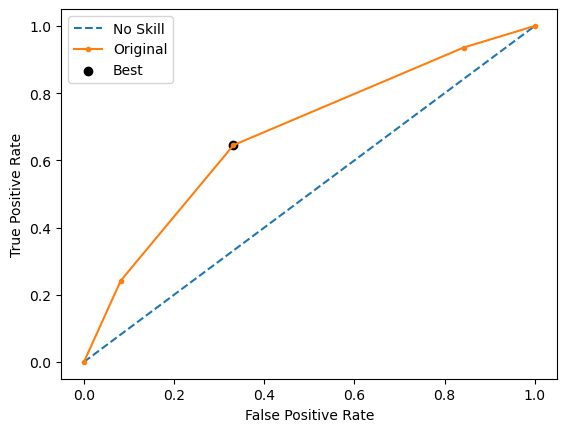

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


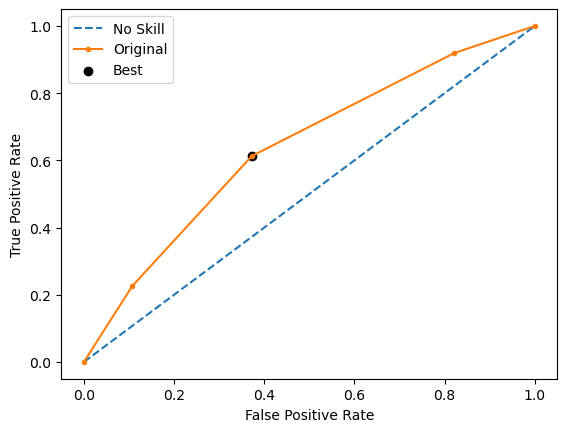

Run 3 - Random State: 2
Test G-mean: 0.6415757839135445
Best Threshold=0.544160, G-Mean=0.642


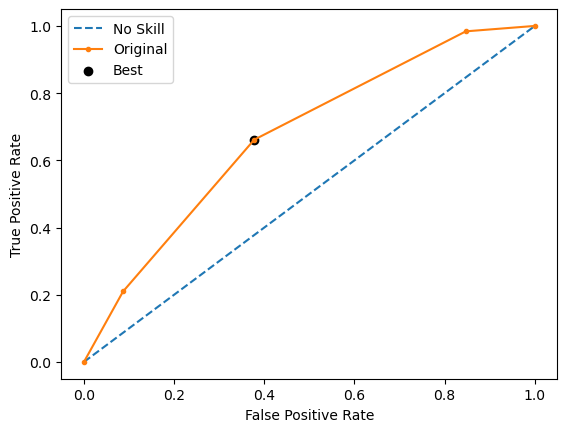

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


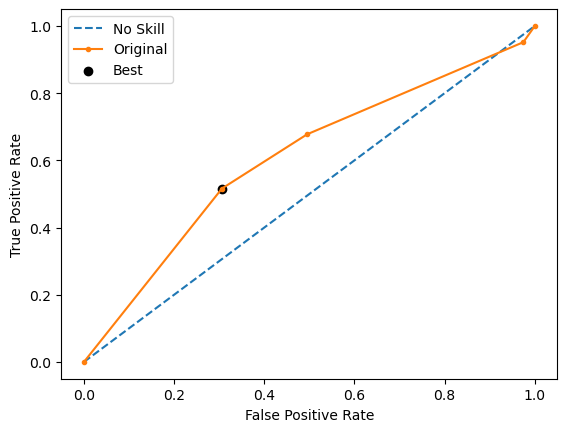

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


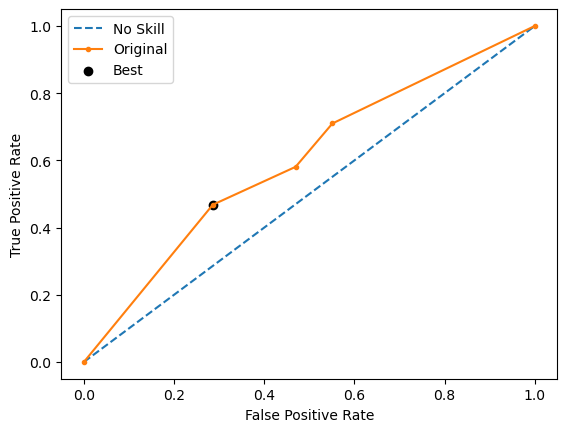

Ave Test G-mean: 0.6116872427478487
Stdev Test G-mean: 0.04156076174606436
Ave Test Specificity: 0.5908163265306122
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835604694092089
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3326449471612906
Ave Test F1-Score: 0.4356965853779212
Ave Runtime: 0.02745671272277832


In [118]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "C:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5407262229941359
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1000000.0, max_iter=1000,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 48.88470816612244 secs
Run 1 - Random State: 0
Test G-mean: 0.5866352206945261
Best Threshold=0.498398, G-Mean=0.595


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


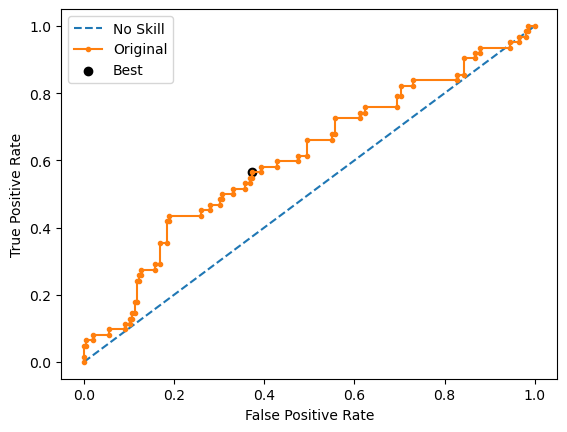

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 2 - Random State: 1
Test G-mean: 0.5395789937110657
Best Threshold=0.451954, G-Mean=0.584


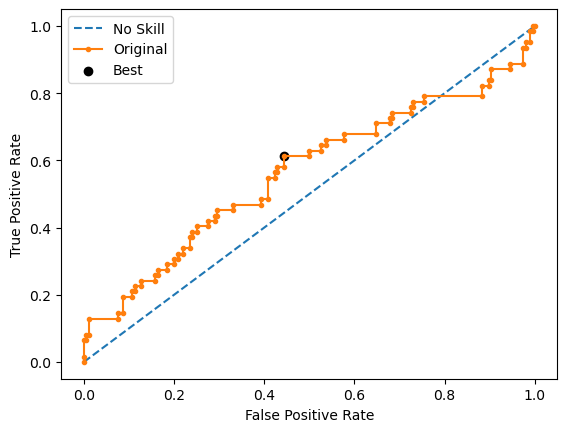

Run 3 - Random State: 2
Test G-mean: 0.5280168968110512
Best Threshold=0.513453, G-Mean=0.547


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


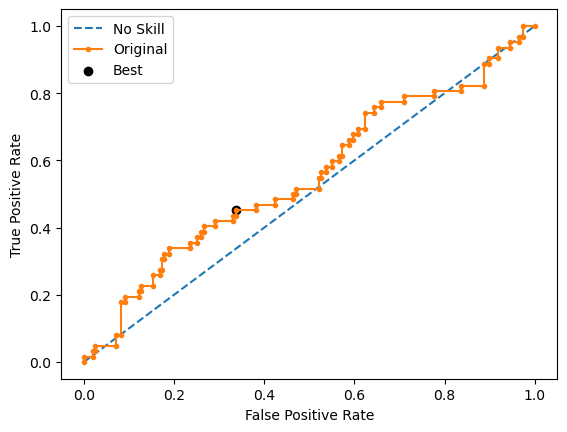

Run 4 - Random State: 3
Test G-mean: 0.5736563715788933
Best Threshold=0.441269, G-Mean=0.611


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


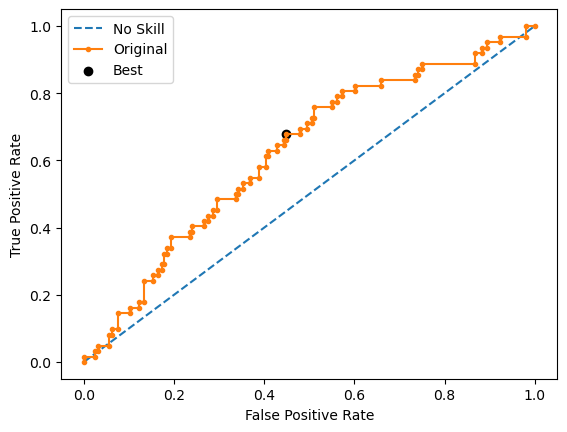

Run 5 - Random State: 4
Test G-mean: 0.4718891759072044
Best Threshold=0.415607, G-Mean=0.575


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


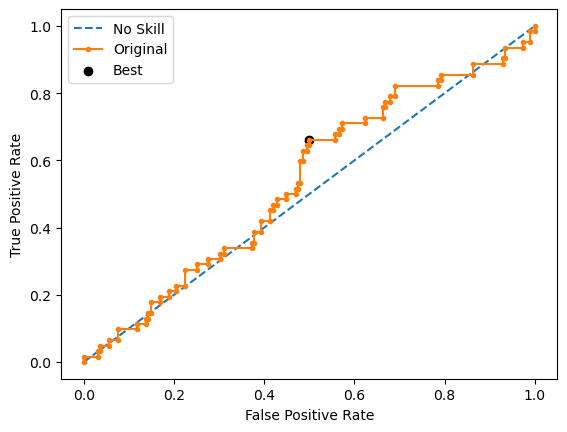

Ave Test G-mean: 0.5399553317405481
Stdev Test G-mean: 0.044973440906130195
Ave Test Specificity: 0.6306122448979592
Ave Test Recall: 0.4645161290322581
Ave Test NPV: 0.7886325397803154
Ave Test Accuracy: 0.5906976744186047
Ave Test Precision: 0.28381210911577753
Ave Test F1-Score: 0.352206146376896
Ave Runtime: 0.6732406139373779


In [119]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                       'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5385868057379548
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2875372679815223
Std Train Score (G-mean) 0.041880632126316444
GridSearchCV Runtime: 118.98988151550293 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.561037433666403
Best Threshold=0.500000, G-Mean=0.441


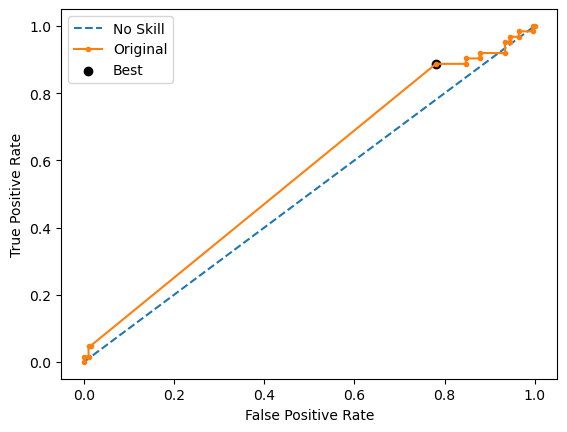

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 2 - Random State: 1
Test G-mean: 0.507676424709084
Best Threshold=0.506332, G-Mean=0.345


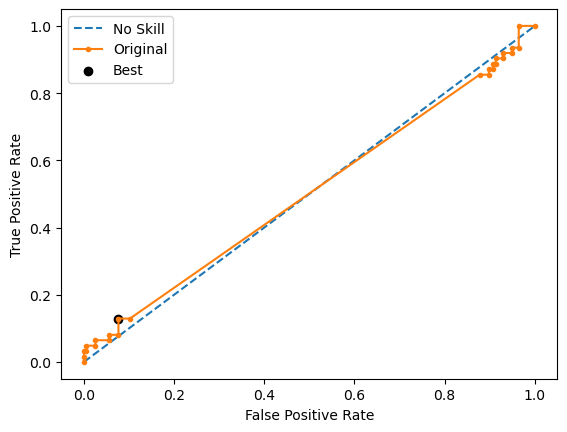

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5378222735191904
Best Threshold=0.513109, G-Mean=0.437


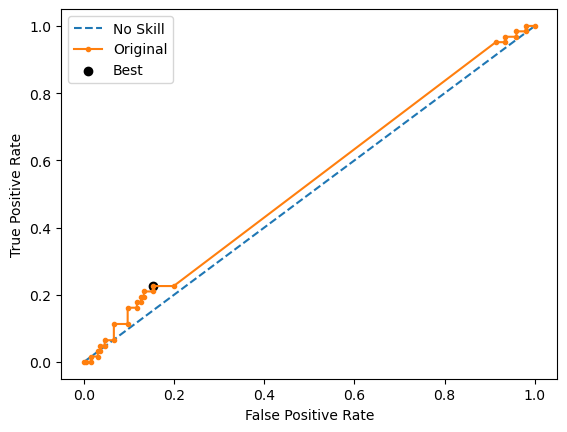

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.5248906591678238
Best Threshold=0.500000, G-Mean=0.396


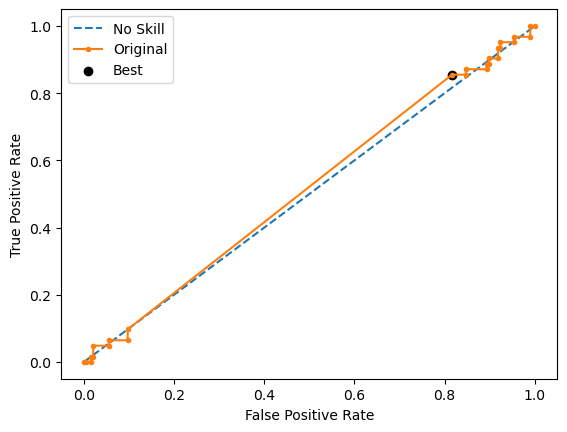

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.49337280177095355
Best Threshold=0.505415, G-Mean=0.277


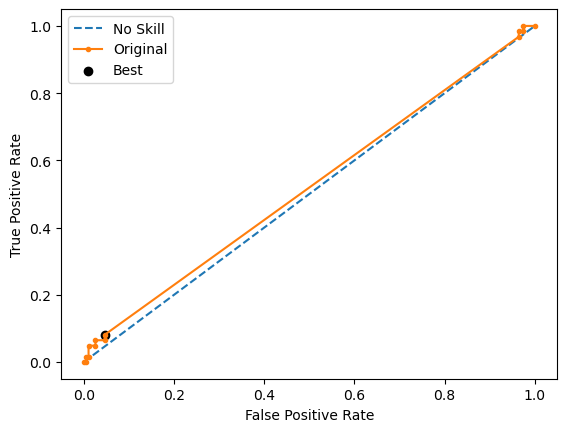

Ave Test G-mean: 0.5249599185666909
Stdev Test G-mean: 0.026284487701645733
Ave Test Specificity: 0.5081632653061223
Ave Test Recall: 0.5516129032258065
Ave Test NPV: 0.7846982839260506
Ave Test Accuracy: 0.5186046511627908
Ave Test Precision: 0.2601434575516043
Ave Test F1-Score: 0.35258426660871295
Ave Runtime: 0.4423836231231689


In [120]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [121]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'braycurtis', 'classifier__n_neighbors': 14, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5551739420431089
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='braycurtis', n_neighbors=14))])
Mean Train Score (G-mean) 0.6882488586018697
Std Train Score (G-mean) 0.015106552621573476
GridSearchCV Runtime: 72.39678883552551 secs
Run 1 - Random State: 0
Test G-mean: 0.4280911287135166
Run 2 - Random State: 1
Test G-mean: 0.4553825555391872
Run 3 - Random State: 2
Test G-mean: 0.5730104831718917
Run 4 - Random State: 3
Test G-mean: 0.5163552828658922
Run 5 - Random State: 4
Test G-mean: 0.4678611003455939
Ave Test G-mean: 0.48814011012721636
Stdev Test G-mean: 0.05720413442783087
Ave Test Specificity: 0.656122448979591

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5695273785971662
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance

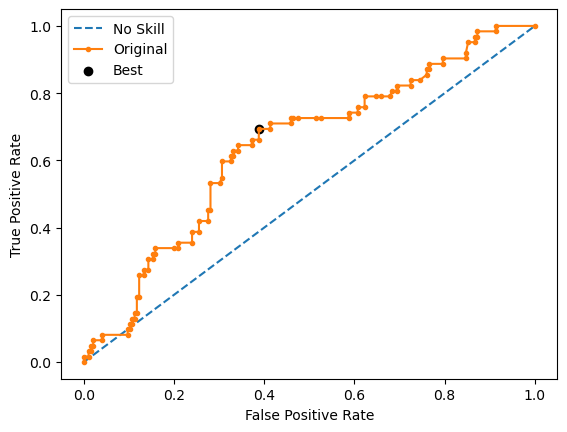

Run 2 - Random State: 1
Test G-mean: 0.6326636793264705
Best Threshold=0.493293, G-Mean=0.636


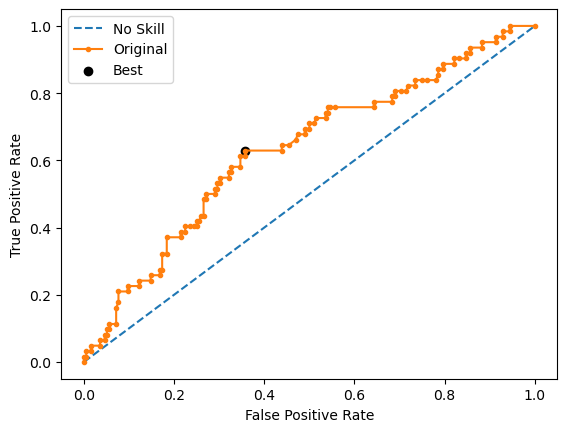

Run 3 - Random State: 2
Test G-mean: 0.5476774830239554
Best Threshold=0.458993, G-Mean=0.564


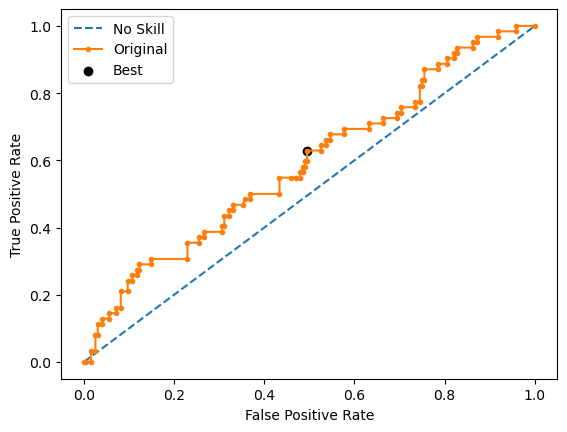

Run 4 - Random State: 3
Test G-mean: 0.6048683337050778
Best Threshold=0.481042, G-Mean=0.614


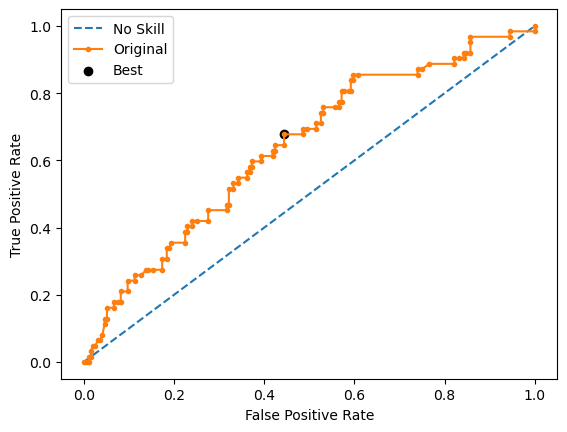

Run 5 - Random State: 4
Test G-mean: 0.5745880397335743
Best Threshold=0.543877, G-Mean=0.611


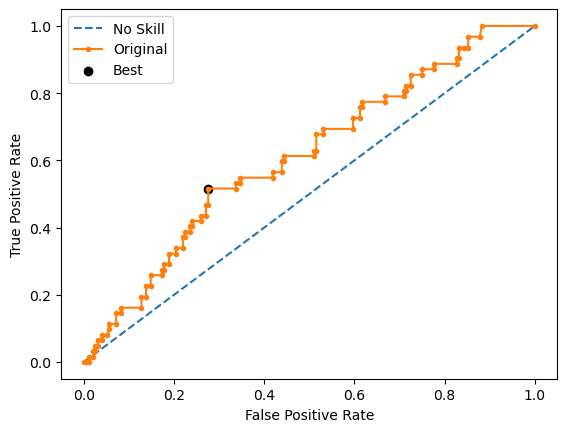

Ave Test G-mean: 0.5987521174719939
Stdev Test G-mean: 0.03748243903978868
Ave Test Specificity: 0.6428571428571429
Ave Test Recall: 0.5612903225806452
Ave Test NPV: 0.8229987307103309
Ave Test Accuracy: 0.6232558139534884
Ave Test Precision: 0.3320006269754075
Ave Test F1-Score: 0.4163508571460087
Ave Runtime: 0.17641987800598144


In [122]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002531 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 661
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Best Hyperparameters: {'c

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

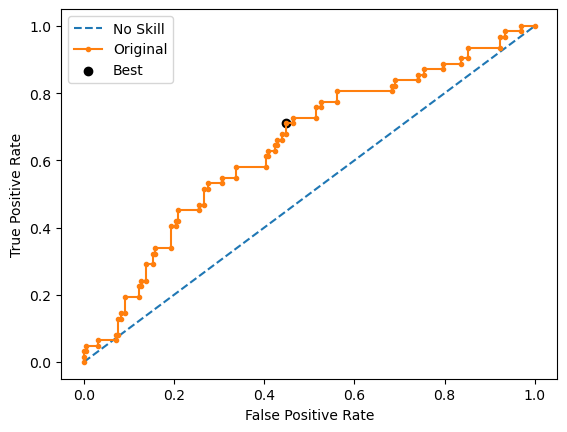

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 673
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with po

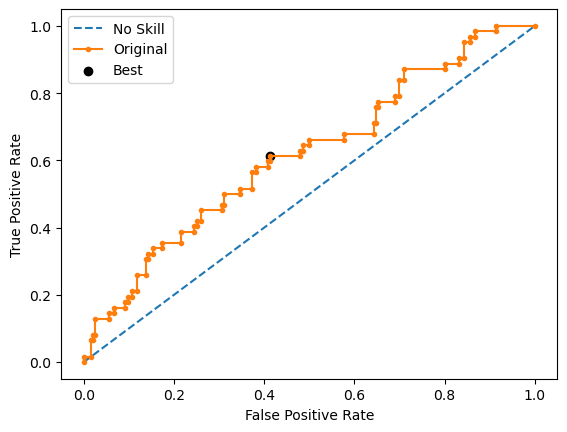

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 670
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with po

Run 3 - Random State: 2
Test G-mean: 0.5597892954492245
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
Best Threshold=0.513757, G-Mean=0.569


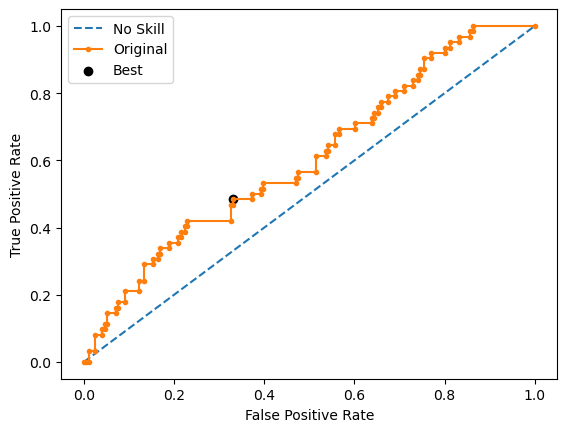

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 662
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with po

Run 4 - Random State: 3
Test G-mean: 0.609881327560031
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
Best Threshold=0.504948, G-Mean=0.613


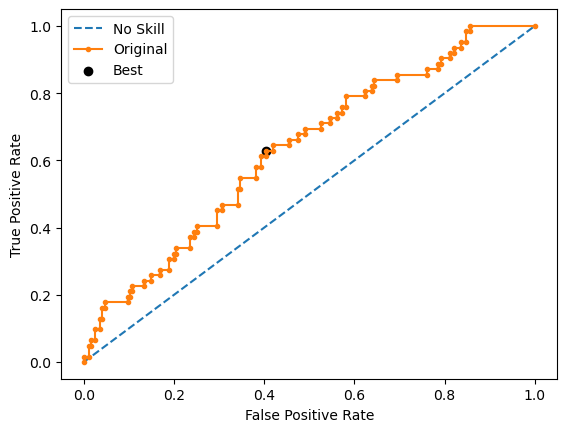

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 658
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with po

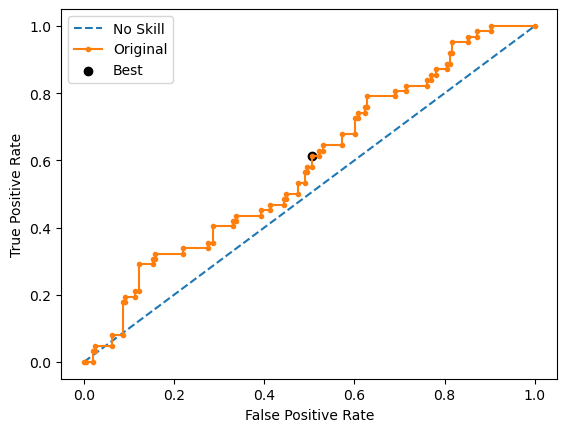

Ave Test G-mean: 0.5747302102021193
Stdev Test G-mean: 0.04083957545129802
Ave Test Specificity: 0.596938775510204
Ave Test Recall: 0.5548387096774194
Ave Test NPV: 0.8092833319187417
Ave Test Accuracy: 0.5868217054263567
Ave Test Precision: 0.3034309756775633
Ave Test F1-Score: 0.3921011022437177
Ave Runtime: 0.21434473991394043


In [124]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5694582600112983
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9483809603185211
Std Train Score (G-mean) 0.0048070063615157175
GridSearchCV Runtime: 14.121961832046509 secs
Run 1 - Random State: 0
Test G-mean: 0.5976143046671969
Best Threshold=0.880797, G-Mean=0.598


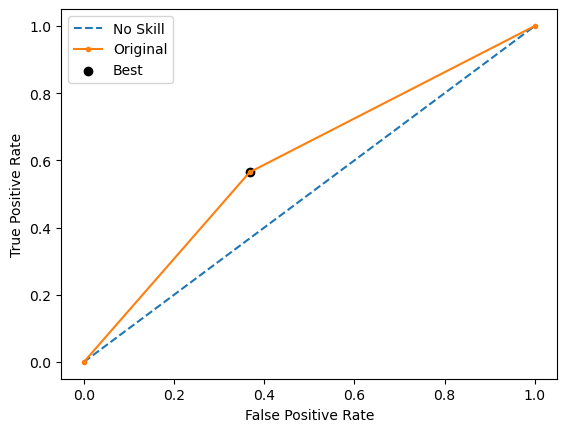

Run 2 - Random State: 1
Test G-mean: 0.5514956622112163
Best Threshold=0.880797, G-Mean=0.551


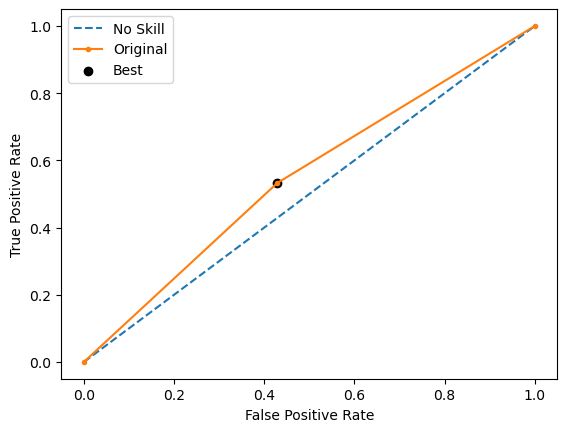

Run 3 - Random State: 2
Test G-mean: 0.5514956622112163
Best Threshold=0.880797, G-Mean=0.551


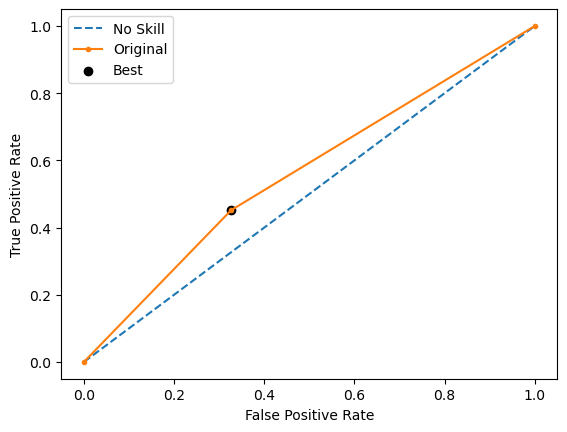

Run 4 - Random State: 3
Test G-mean: 0.6044600526368193
Best Threshold=0.880797, G-Mean=0.604


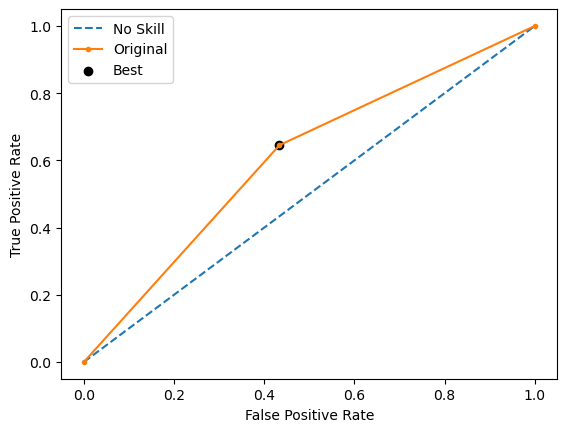

Run 5 - Random State: 4
Test G-mean: 0.5588329558532932
Best Threshold=0.880797, G-Mean=0.559


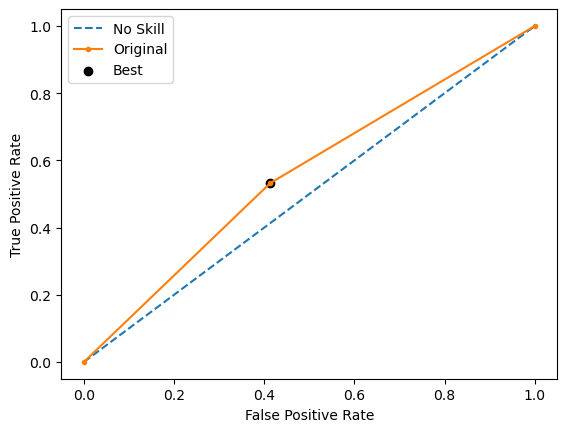

Ave Test G-mean: 0.5727797275159483
Stdev Test G-mean: 0.02608128895227308
Ave Test Specificity: 0.6061224489795919
Ave Test Recall: 0.5451612903225806
Ave Test NPV: 0.808779318856595
Ave Test Accuracy: 0.5914728682170542
Ave Test Precision: 0.30459511921741655
Ave Test F1-Score: 0.389872023499643
Ave Runtime: 0.3593174934387207


In [125]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5768650062665048
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.6088025799686707
Std Train Score (G-mean) 0.022195997583714367
GridSearchCV Runtime: 371.75051498413086 secs
Run 1 - Random State: 0
Test G-mean: 0.6347413981520182
Best Threshold=0.487503, G-Mean=0

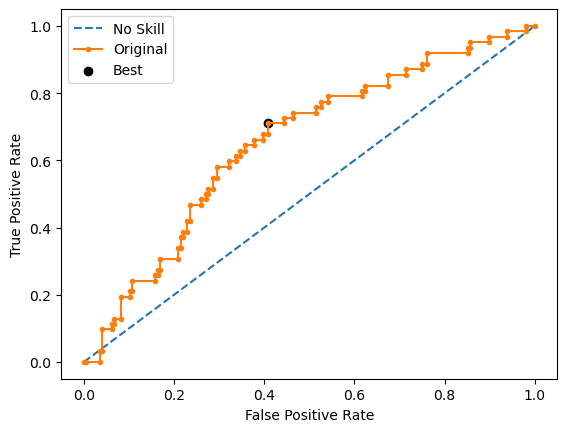

Run 2 - Random State: 1
Test G-mean: 0.6242836579493493
Best Threshold=0.502520, G-Mean=0.627


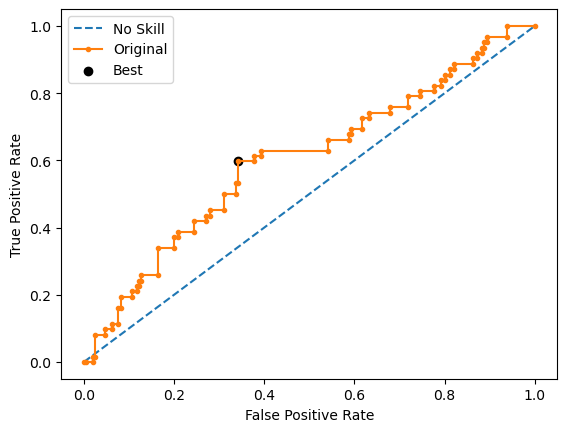

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.483924, G-Mean=0.589


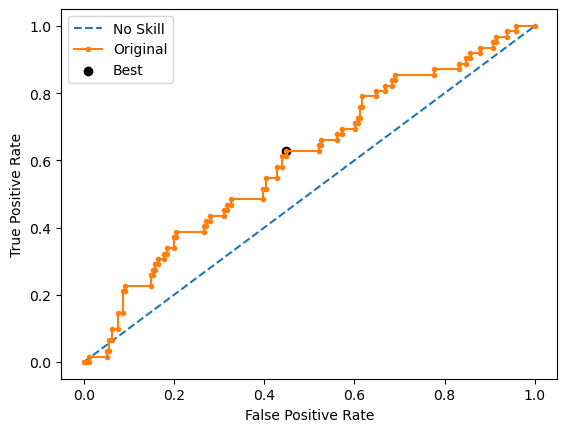

Run 4 - Random State: 3
Test G-mean: 0.591246215124694
Best Threshold=0.465005, G-Mean=0.621


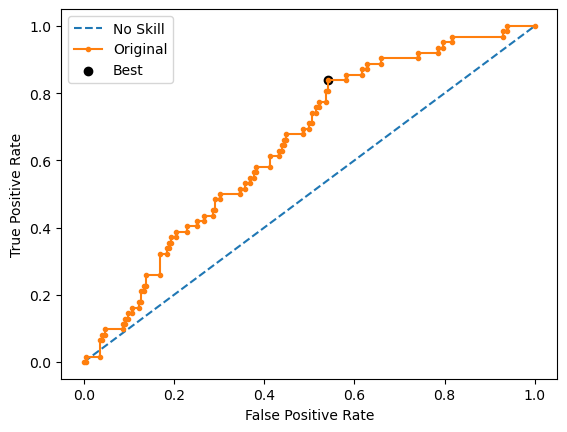

Run 5 - Random State: 4
Test G-mean: 0.6019362000578568
Best Threshold=0.509206, G-Mean=0.623


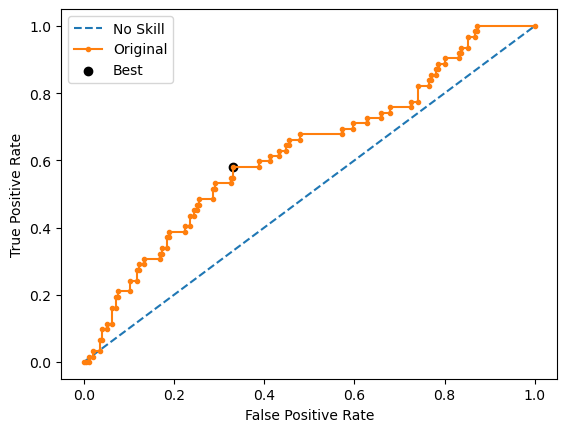

Ave Test G-mean: 0.6015434615493291
Stdev Test G-mean: 0.031002022889914615
Ave Test Specificity: 0.6387755102040816
Ave Test Recall: 0.567741935483871
Ave Test NPV: 0.8236238314622852
Ave Test Accuracy: 0.6217054263565892
Ave Test Precision: 0.33295230650884633
Ave Test F1-Score: 0.4192907178082785
Ave Runtime: 0.8930131435394287


In [126]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5725397589609043
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8744686992050319
Std Train Score (G-mean) 0.011527105788742243
GridSearchCV Runtime: 142.25064277648926 secs
Run 1 - Random State: 0
Test G-mean: 0.5622828013112511
Best Threshold=0.555999, G-Mean=0.580


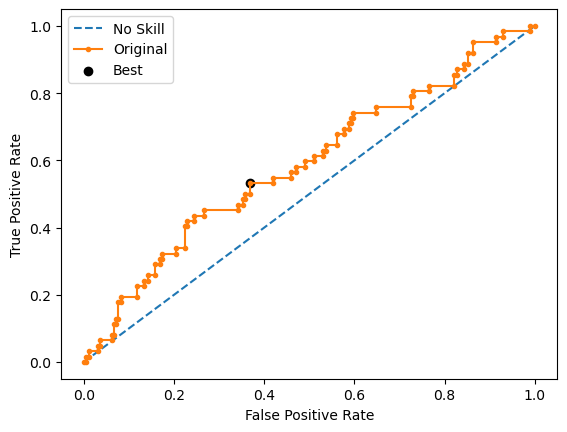

Run 2 - Random State: 1
Test G-mean: 0.5995389934010088
Best Threshold=0.521194, G-Mean=0.615


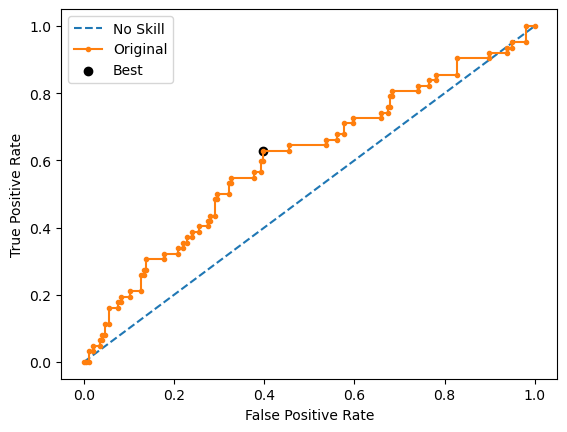

Run 3 - Random State: 2
Test G-mean: 0.484791750625621
Best Threshold=0.365845, G-Mean=0.529


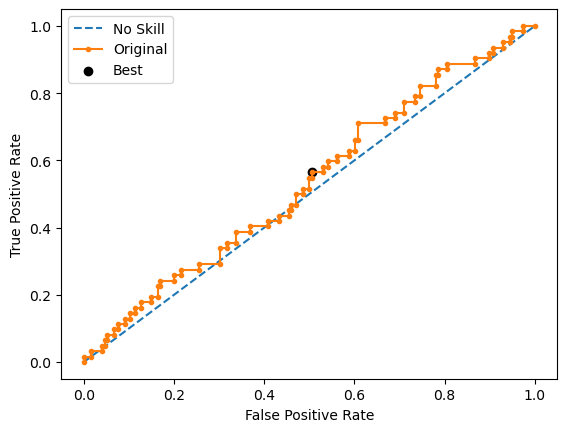

Run 4 - Random State: 3
Test G-mean: 0.5365201312326561
Best Threshold=0.446577, G-Mean=0.552


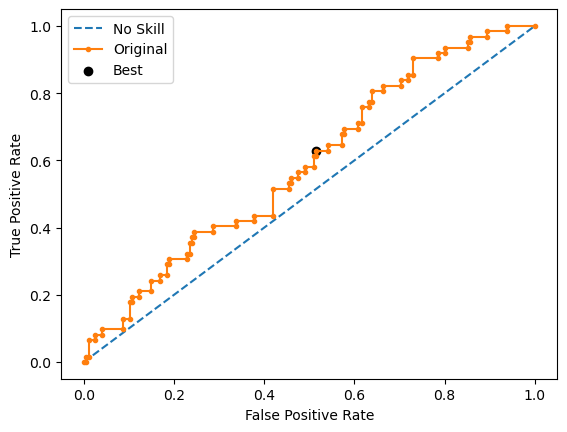

Run 5 - Random State: 4
Test G-mean: 0.568251536808238
Best Threshold=0.634908, G-Mean=0.584


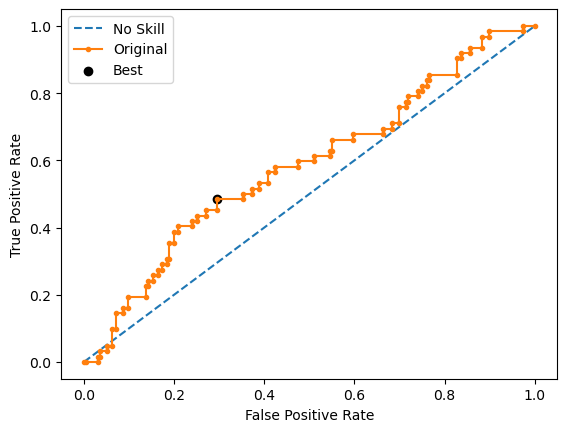

Ave Test G-mean: 0.550277042675755
Stdev Test G-mean: 0.042928826434967905
Ave Test Specificity: 0.5877551020408164
Ave Test Recall: 0.5258064516129031
Ave Test NPV: 0.7984004487718876
Ave Test Accuracy: 0.5728682170542636
Ave Test Precision: 0.28558126606907097
Ave Test F1-Score: 0.36823242588605715
Ave Runtime: 0.9931846618652344


In [127]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6918734	total: 2.06ms	remaining: 2.05s
1:	learn: 0.6904773	total: 3.96ms	remaining: 1.97s
2:	learn: 0.6892748	total: 5.93ms	remaining: 1.97s
3:	learn: 0.6883518	total: 7.73ms	remaining: 1.93s
4:	learn: 0.6874894	total: 9.48ms	remaining: 1.89s
5:	learn: 0.6864793	total: 11.3ms	remaining: 1.88s
6:	learn: 0.6849713	total: 13ms	remaining: 1.84s
7:	learn: 0.6835259	total: 14.7ms	remaining: 1.82s
8:	learn: 0.6820508	total: 16.6ms	remaining: 1.82s
9:	learn: 0.6808529	total: 18.3ms	remaining: 1.81s
10:	learn: 0.6794658	total: 20.2ms	remaining: 1.81s
11:	learn: 0.6782565	total: 21.8ms	remaining: 1.8s
12:	learn: 0.6770542	total: 23.7ms	remaining: 1.8s
13:	learn: 0.6758270	total: 25.4ms	remaining: 1.79s
14:	learn: 0.6747007	total: 27.1ms	remaining: 1.78s
15:	learn: 0.6735646	total: 28.8ms	remaining: 1.77s
16:	learn: 0.6724274	total: 30.5ms	remaining: 1.76s
17:	learn: 0.6714028	total: 32.4ms	rema

216:	learn: 0.5260379	total: 393ms	remaining: 1.42s
217:	learn: 0.5254829	total: 395ms	remaining: 1.42s
218:	learn: 0.5249075	total: 396ms	remaining: 1.41s
219:	learn: 0.5241437	total: 398ms	remaining: 1.41s
220:	learn: 0.5234606	total: 400ms	remaining: 1.41s
221:	learn: 0.5225357	total: 402ms	remaining: 1.41s
222:	learn: 0.5215805	total: 404ms	remaining: 1.41s
223:	learn: 0.5212093	total: 405ms	remaining: 1.4s
224:	learn: 0.5203902	total: 407ms	remaining: 1.4s
225:	learn: 0.5193754	total: 409ms	remaining: 1.4s
226:	learn: 0.5187862	total: 411ms	remaining: 1.4s
227:	learn: 0.5180426	total: 412ms	remaining: 1.4s
228:	learn: 0.5172610	total: 414ms	remaining: 1.39s
229:	learn: 0.5167259	total: 416ms	remaining: 1.39s
230:	learn: 0.5163185	total: 418ms	remaining: 1.39s
231:	learn: 0.5157194	total: 420ms	remaining: 1.39s
232:	learn: 0.5153452	total: 421ms	remaining: 1.39s
233:	learn: 0.5147449	total: 423ms	remaining: 1.38s
234:	learn: 0.5142519	total: 425ms	remaining: 1.38s
235:	learn: 0.513

431:	learn: 0.4215898	total: 779ms	remaining: 1.02s
432:	learn: 0.4212175	total: 781ms	remaining: 1.02s
433:	learn: 0.4203150	total: 783ms	remaining: 1.02s
434:	learn: 0.4199286	total: 784ms	remaining: 1.02s
435:	learn: 0.4195555	total: 786ms	remaining: 1.02s
436:	learn: 0.4189550	total: 788ms	remaining: 1.01s
437:	learn: 0.4186534	total: 790ms	remaining: 1.01s
438:	learn: 0.4183762	total: 791ms	remaining: 1.01s
439:	learn: 0.4181029	total: 793ms	remaining: 1.01s
440:	learn: 0.4176382	total: 795ms	remaining: 1.01s
441:	learn: 0.4171787	total: 796ms	remaining: 1s
442:	learn: 0.4167806	total: 798ms	remaining: 1s
443:	learn: 0.4165349	total: 800ms	remaining: 1s
444:	learn: 0.4160963	total: 802ms	remaining: 1s
445:	learn: 0.4157031	total: 804ms	remaining: 998ms
446:	learn: 0.4149711	total: 806ms	remaining: 997ms
447:	learn: 0.4143273	total: 807ms	remaining: 995ms
448:	learn: 0.4140180	total: 809ms	remaining: 993ms
449:	learn: 0.4134368	total: 811ms	remaining: 991ms
450:	learn: 0.4129281	to

654:	learn: 0.3391247	total: 1.18s	remaining: 621ms
655:	learn: 0.3389132	total: 1.18s	remaining: 619ms
656:	learn: 0.3386577	total: 1.18s	remaining: 617ms
657:	learn: 0.3381187	total: 1.18s	remaining: 616ms
658:	learn: 0.3377033	total: 1.19s	remaining: 614ms
659:	learn: 0.3375100	total: 1.19s	remaining: 612ms
660:	learn: 0.3371406	total: 1.19s	remaining: 610ms
661:	learn: 0.3369431	total: 1.19s	remaining: 608ms
662:	learn: 0.3365509	total: 1.19s	remaining: 606ms
663:	learn: 0.3362083	total: 1.19s	remaining: 604ms
664:	learn: 0.3358074	total: 1.2s	remaining: 603ms
665:	learn: 0.3353372	total: 1.2s	remaining: 601ms
666:	learn: 0.3350564	total: 1.2s	remaining: 599ms
667:	learn: 0.3347108	total: 1.2s	remaining: 597ms
668:	learn: 0.3346213	total: 1.2s	remaining: 595ms
669:	learn: 0.3344584	total: 1.21s	remaining: 594ms
670:	learn: 0.3341688	total: 1.21s	remaining: 592ms
671:	learn: 0.3340115	total: 1.21s	remaining: 590ms
672:	learn: 0.3337903	total: 1.21s	remaining: 588ms
673:	learn: 0.333

884:	learn: 0.2722158	total: 1.59s	remaining: 207ms
885:	learn: 0.2718161	total: 1.59s	remaining: 205ms
886:	learn: 0.2716001	total: 1.6s	remaining: 203ms
887:	learn: 0.2713060	total: 1.6s	remaining: 202ms
888:	learn: 0.2710417	total: 1.6s	remaining: 200ms
889:	learn: 0.2707474	total: 1.6s	remaining: 198ms
890:	learn: 0.2703679	total: 1.6s	remaining: 196ms
891:	learn: 0.2701453	total: 1.61s	remaining: 194ms
892:	learn: 0.2698673	total: 1.61s	remaining: 193ms
893:	learn: 0.2697405	total: 1.61s	remaining: 191ms
894:	learn: 0.2692973	total: 1.61s	remaining: 189ms
895:	learn: 0.2691405	total: 1.61s	remaining: 187ms
896:	learn: 0.2688615	total: 1.61s	remaining: 185ms
897:	learn: 0.2686933	total: 1.62s	remaining: 184ms
898:	learn: 0.2682504	total: 1.62s	remaining: 182ms
899:	learn: 0.2677388	total: 1.62s	remaining: 180ms
900:	learn: 0.2674931	total: 1.62s	remaining: 178ms
901:	learn: 0.2671079	total: 1.62s	remaining: 176ms
902:	learn: 0.2667251	total: 1.63s	remaining: 175ms
903:	learn: 0.266

69:	learn: 0.6263810	total: 132ms	remaining: 1.75s
70:	learn: 0.6253484	total: 134ms	remaining: 1.76s
71:	learn: 0.6249245	total: 136ms	remaining: 1.75s
72:	learn: 0.6237231	total: 138ms	remaining: 1.75s
73:	learn: 0.6227617	total: 139ms	remaining: 1.74s
74:	learn: 0.6219691	total: 141ms	remaining: 1.74s
75:	learn: 0.6212929	total: 143ms	remaining: 1.74s
76:	learn: 0.6204489	total: 145ms	remaining: 1.73s
77:	learn: 0.6194451	total: 146ms	remaining: 1.73s
78:	learn: 0.6186491	total: 148ms	remaining: 1.73s
79:	learn: 0.6175677	total: 150ms	remaining: 1.73s
80:	learn: 0.6162837	total: 152ms	remaining: 1.73s
81:	learn: 0.6155640	total: 154ms	remaining: 1.72s
82:	learn: 0.6148008	total: 156ms	remaining: 1.72s
83:	learn: 0.6141722	total: 157ms	remaining: 1.71s
84:	learn: 0.6133858	total: 159ms	remaining: 1.71s
85:	learn: 0.6126727	total: 161ms	remaining: 1.71s
86:	learn: 0.6120537	total: 163ms	remaining: 1.71s
87:	learn: 0.6115817	total: 165ms	remaining: 1.71s
88:	learn: 0.6105439	total: 166

283:	learn: 0.4891116	total: 518ms	remaining: 1.31s
284:	learn: 0.4888838	total: 520ms	remaining: 1.3s
285:	learn: 0.4884058	total: 522ms	remaining: 1.3s
286:	learn: 0.4877011	total: 523ms	remaining: 1.3s
287:	learn: 0.4871656	total: 525ms	remaining: 1.3s
288:	learn: 0.4868783	total: 527ms	remaining: 1.3s
289:	learn: 0.4864143	total: 529ms	remaining: 1.29s
290:	learn: 0.4857858	total: 531ms	remaining: 1.29s
291:	learn: 0.4850330	total: 533ms	remaining: 1.29s
292:	learn: 0.4847229	total: 534ms	remaining: 1.29s
293:	learn: 0.4840578	total: 536ms	remaining: 1.29s
294:	learn: 0.4835627	total: 538ms	remaining: 1.29s
295:	learn: 0.4832518	total: 540ms	remaining: 1.28s
296:	learn: 0.4829800	total: 542ms	remaining: 1.28s
297:	learn: 0.4827392	total: 543ms	remaining: 1.28s
298:	learn: 0.4821348	total: 545ms	remaining: 1.28s
299:	learn: 0.4814199	total: 547ms	remaining: 1.28s
300:	learn: 0.4810817	total: 549ms	remaining: 1.27s
301:	learn: 0.4807171	total: 551ms	remaining: 1.27s
302:	learn: 0.480

496:	learn: 0.3952186	total: 903ms	remaining: 914ms
497:	learn: 0.3949685	total: 905ms	remaining: 912ms
498:	learn: 0.3945123	total: 907ms	remaining: 911ms
499:	learn: 0.3940010	total: 909ms	remaining: 909ms
500:	learn: 0.3935113	total: 911ms	remaining: 907ms
501:	learn: 0.3927927	total: 913ms	remaining: 905ms
502:	learn: 0.3925541	total: 914ms	remaining: 904ms
503:	learn: 0.3922152	total: 916ms	remaining: 902ms
504:	learn: 0.3919783	total: 918ms	remaining: 900ms
505:	learn: 0.3916108	total: 920ms	remaining: 898ms
506:	learn: 0.3910847	total: 922ms	remaining: 896ms
507:	learn: 0.3906111	total: 924ms	remaining: 894ms
508:	learn: 0.3903561	total: 925ms	remaining: 893ms
509:	learn: 0.3901033	total: 927ms	remaining: 891ms
510:	learn: 0.3898712	total: 929ms	remaining: 889ms
511:	learn: 0.3895448	total: 931ms	remaining: 887ms
512:	learn: 0.3890344	total: 933ms	remaining: 885ms
513:	learn: 0.3886817	total: 934ms	remaining: 883ms
514:	learn: 0.3880724	total: 936ms	remaining: 882ms
515:	learn: 

725:	learn: 0.3175637	total: 1.32s	remaining: 497ms
726:	learn: 0.3171423	total: 1.32s	remaining: 496ms
727:	learn: 0.3169120	total: 1.32s	remaining: 494ms
728:	learn: 0.3167711	total: 1.32s	remaining: 492ms
729:	learn: 0.3165731	total: 1.32s	remaining: 490ms
730:	learn: 0.3163708	total: 1.33s	remaining: 488ms
731:	learn: 0.3162198	total: 1.33s	remaining: 487ms
732:	learn: 0.3159857	total: 1.33s	remaining: 485ms
733:	learn: 0.3158643	total: 1.33s	remaining: 483ms
734:	learn: 0.3156200	total: 1.33s	remaining: 481ms
735:	learn: 0.3152480	total: 1.34s	remaining: 479ms
736:	learn: 0.3147722	total: 1.34s	remaining: 477ms
737:	learn: 0.3145636	total: 1.34s	remaining: 476ms
738:	learn: 0.3142694	total: 1.34s	remaining: 474ms
739:	learn: 0.3138583	total: 1.34s	remaining: 472ms
740:	learn: 0.3135283	total: 1.34s	remaining: 470ms
741:	learn: 0.3132960	total: 1.35s	remaining: 468ms
742:	learn: 0.3129214	total: 1.35s	remaining: 467ms
743:	learn: 0.3126525	total: 1.35s	remaining: 465ms
744:	learn: 

937:	learn: 0.2561118	total: 1.7s	remaining: 112ms
938:	learn: 0.2557949	total: 1.7s	remaining: 111ms
939:	learn: 0.2556320	total: 1.71s	remaining: 109ms
940:	learn: 0.2554040	total: 1.71s	remaining: 107ms
941:	learn: 0.2552063	total: 1.71s	remaining: 105ms
942:	learn: 0.2548313	total: 1.71s	remaining: 103ms
943:	learn: 0.2545488	total: 1.71s	remaining: 102ms
944:	learn: 0.2541265	total: 1.71s	remaining: 99.8ms
945:	learn: 0.2538024	total: 1.72s	remaining: 97.9ms
946:	learn: 0.2533675	total: 1.72s	remaining: 96.1ms
947:	learn: 0.2532574	total: 1.72s	remaining: 94.3ms
948:	learn: 0.2529557	total: 1.72s	remaining: 92.5ms
949:	learn: 0.2528016	total: 1.72s	remaining: 90.7ms
950:	learn: 0.2525537	total: 1.72s	remaining: 88.9ms
951:	learn: 0.2522428	total: 1.73s	remaining: 87ms
952:	learn: 0.2517935	total: 1.73s	remaining: 85.2ms
953:	learn: 0.2514930	total: 1.73s	remaining: 83.4ms
954:	learn: 0.2513443	total: 1.73s	remaining: 81.6ms
955:	learn: 0.2509216	total: 1.73s	remaining: 79.8ms
956:

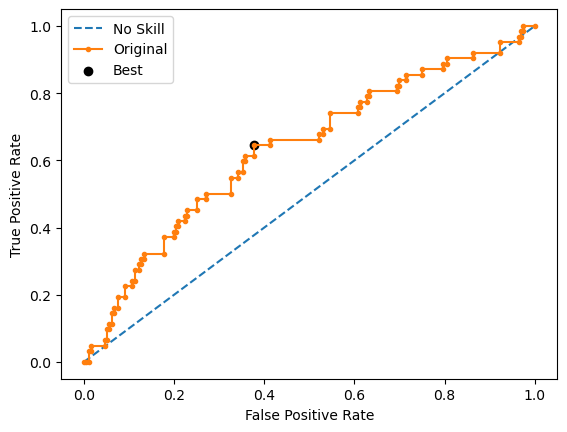

Learning rate set to 0.006754
0:	learn: 0.6909056	total: 6.01ms	remaining: 6.01s
1:	learn: 0.6892966	total: 12.4ms	remaining: 6.18s
2:	learn: 0.6879854	total: 18.5ms	remaining: 6.14s
3:	learn: 0.6869652	total: 25.2ms	remaining: 6.26s
4:	learn: 0.6857235	total: 31ms	remaining: 6.18s
5:	learn: 0.6845124	total: 37.7ms	remaining: 6.24s
6:	learn: 0.6829168	total: 43ms	remaining: 6.11s
7:	learn: 0.6809996	total: 46.5ms	remaining: 5.76s
8:	learn: 0.6789838	total: 51ms	remaining: 5.62s
9:	learn: 0.6771489	total: 55.2ms	remaining: 5.47s
10:	learn: 0.6755326	total: 58ms	remaining: 5.22s
11:	learn: 0.6742410	total: 61.2ms	remaining: 5.04s
12:	learn: 0.6725502	total: 64.1ms	remaining: 4.87s
13:	learn: 0.6705914	total: 67.8ms	remaining: 4.78s
14:	learn: 0.6692993	total: 71.5ms	remaining: 4.7s
15:	learn: 0.6680835	total: 73.6ms	remaining: 4.52s
16:	learn: 0.6669018	total: 75.2ms	remaining: 4.35s
17:	learn: 0.6658209	total: 77.3ms	remaining: 4.22s
18:	learn: 0.6646626	total: 80.3ms	remaining: 4.15s
1

191:	learn: 0.5127904	total: 396ms	remaining: 1.67s
192:	learn: 0.5118477	total: 398ms	remaining: 1.67s
193:	learn: 0.5108360	total: 400ms	remaining: 1.66s
194:	learn: 0.5101735	total: 402ms	remaining: 1.66s
195:	learn: 0.5093241	total: 404ms	remaining: 1.66s
196:	learn: 0.5084634	total: 405ms	remaining: 1.65s
197:	learn: 0.5076391	total: 407ms	remaining: 1.65s
198:	learn: 0.5068879	total: 409ms	remaining: 1.65s
199:	learn: 0.5064198	total: 411ms	remaining: 1.64s
200:	learn: 0.5060827	total: 412ms	remaining: 1.64s
201:	learn: 0.5057729	total: 414ms	remaining: 1.64s
202:	learn: 0.5052046	total: 416ms	remaining: 1.63s
203:	learn: 0.5043124	total: 418ms	remaining: 1.63s
204:	learn: 0.5032521	total: 419ms	remaining: 1.63s
205:	learn: 0.5027053	total: 421ms	remaining: 1.62s
206:	learn: 0.5022289	total: 423ms	remaining: 1.62s
207:	learn: 0.5016766	total: 425ms	remaining: 1.62s
208:	learn: 0.5011059	total: 426ms	remaining: 1.61s
209:	learn: 0.5007613	total: 428ms	remaining: 1.61s
210:	learn: 

407:	learn: 0.4077098	total: 788ms	remaining: 1.14s
408:	learn: 0.4071544	total: 790ms	remaining: 1.14s
409:	learn: 0.4068785	total: 792ms	remaining: 1.14s
410:	learn: 0.4065366	total: 794ms	remaining: 1.14s
411:	learn: 0.4061911	total: 795ms	remaining: 1.13s
412:	learn: 0.4058728	total: 797ms	remaining: 1.13s
413:	learn: 0.4057222	total: 799ms	remaining: 1.13s
414:	learn: 0.4052428	total: 801ms	remaining: 1.13s
415:	learn: 0.4046399	total: 802ms	remaining: 1.13s
416:	learn: 0.4042913	total: 804ms	remaining: 1.12s
417:	learn: 0.4037060	total: 806ms	remaining: 1.12s
418:	learn: 0.4034902	total: 808ms	remaining: 1.12s
419:	learn: 0.4032340	total: 810ms	remaining: 1.12s
420:	learn: 0.4029262	total: 811ms	remaining: 1.11s
421:	learn: 0.4024906	total: 813ms	remaining: 1.11s
422:	learn: 0.4021834	total: 815ms	remaining: 1.11s
423:	learn: 0.4018409	total: 817ms	remaining: 1.11s
424:	learn: 0.4014353	total: 819ms	remaining: 1.11s
425:	learn: 0.4008964	total: 821ms	remaining: 1.1s
426:	learn: 0

621:	learn: 0.3314486	total: 1.18s	remaining: 715ms
622:	learn: 0.3311712	total: 1.18s	remaining: 713ms
623:	learn: 0.3309800	total: 1.18s	remaining: 712ms
624:	learn: 0.3308035	total: 1.18s	remaining: 710ms
625:	learn: 0.3305792	total: 1.18s	remaining: 708ms
626:	learn: 0.3303077	total: 1.19s	remaining: 706ms
627:	learn: 0.3300739	total: 1.19s	remaining: 704ms
628:	learn: 0.3295516	total: 1.19s	remaining: 702ms
629:	learn: 0.3291347	total: 1.19s	remaining: 700ms
630:	learn: 0.3289783	total: 1.19s	remaining: 698ms
631:	learn: 0.3285283	total: 1.2s	remaining: 696ms
632:	learn: 0.3282839	total: 1.2s	remaining: 694ms
633:	learn: 0.3278928	total: 1.2s	remaining: 692ms
634:	learn: 0.3273143	total: 1.2s	remaining: 690ms
635:	learn: 0.3269808	total: 1.2s	remaining: 689ms
636:	learn: 0.3266657	total: 1.2s	remaining: 687ms
637:	learn: 0.3263857	total: 1.21s	remaining: 685ms
638:	learn: 0.3261942	total: 1.21s	remaining: 683ms
639:	learn: 0.3258461	total: 1.21s	remaining: 681ms
640:	learn: 0.3254

834:	learn: 0.2742269	total: 1.56s	remaining: 309ms
835:	learn: 0.2738385	total: 1.57s	remaining: 308ms
836:	learn: 0.2736981	total: 1.57s	remaining: 306ms
837:	learn: 0.2732613	total: 1.57s	remaining: 304ms
838:	learn: 0.2729863	total: 1.57s	remaining: 302ms
839:	learn: 0.2728920	total: 1.57s	remaining: 300ms
840:	learn: 0.2727078	total: 1.58s	remaining: 298ms
841:	learn: 0.2725420	total: 1.58s	remaining: 296ms
842:	learn: 0.2723139	total: 1.58s	remaining: 294ms
843:	learn: 0.2720702	total: 1.58s	remaining: 292ms
844:	learn: 0.2718987	total: 1.58s	remaining: 291ms
845:	learn: 0.2715497	total: 1.58s	remaining: 289ms
846:	learn: 0.2714260	total: 1.59s	remaining: 287ms
847:	learn: 0.2712632	total: 1.59s	remaining: 285ms
848:	learn: 0.2708605	total: 1.59s	remaining: 283ms
849:	learn: 0.2705688	total: 1.59s	remaining: 281ms
850:	learn: 0.2704513	total: 1.59s	remaining: 279ms
851:	learn: 0.2701400	total: 1.6s	remaining: 277ms
852:	learn: 0.2700015	total: 1.6s	remaining: 275ms
853:	learn: 0.

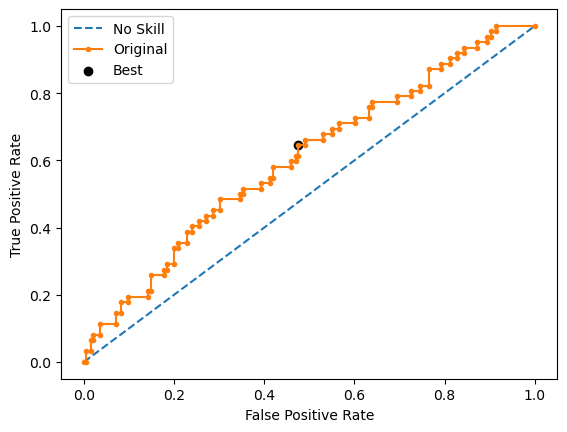

Learning rate set to 0.006754
0:	learn: 0.6912841	total: 6.71ms	remaining: 6.7s
1:	learn: 0.6900261	total: 10.7ms	remaining: 5.34s
2:	learn: 0.6889845	total: 15.5ms	remaining: 5.17s
3:	learn: 0.6882180	total: 20.1ms	remaining: 5.01s
4:	learn: 0.6870207	total: 23.7ms	remaining: 4.72s
5:	learn: 0.6858179	total: 27.9ms	remaining: 4.63s
6:	learn: 0.6851150	total: 32.8ms	remaining: 4.65s
7:	learn: 0.6832779	total: 35.8ms	remaining: 4.44s
8:	learn: 0.6823443	total: 39.3ms	remaining: 4.32s
9:	learn: 0.6812690	total: 42ms	remaining: 4.16s
10:	learn: 0.6800280	total: 47.5ms	remaining: 4.27s
11:	learn: 0.6792044	total: 50.7ms	remaining: 4.17s
12:	learn: 0.6783522	total: 53.1ms	remaining: 4.04s
13:	learn: 0.6772651	total: 55.4ms	remaining: 3.9s
14:	learn: 0.6763484	total: 57.9ms	remaining: 3.8s
15:	learn: 0.6753359	total: 61.8ms	remaining: 3.8s
16:	learn: 0.6745798	total: 63.9ms	remaining: 3.69s
17:	learn: 0.6740406	total: 66.8ms	remaining: 3.64s
18:	learn: 0.6730462	total: 69.2ms	remaining: 3.57

192:	learn: 0.5425845	total: 387ms	remaining: 1.62s
193:	learn: 0.5421391	total: 389ms	remaining: 1.61s
194:	learn: 0.5417235	total: 390ms	remaining: 1.61s
195:	learn: 0.5410230	total: 392ms	remaining: 1.61s
196:	learn: 0.5405509	total: 394ms	remaining: 1.61s
197:	learn: 0.5400290	total: 396ms	remaining: 1.6s
198:	learn: 0.5396598	total: 398ms	remaining: 1.6s
199:	learn: 0.5391740	total: 400ms	remaining: 1.6s
200:	learn: 0.5383538	total: 402ms	remaining: 1.6s
201:	learn: 0.5376197	total: 404ms	remaining: 1.59s
202:	learn: 0.5370034	total: 405ms	remaining: 1.59s
203:	learn: 0.5359600	total: 407ms	remaining: 1.59s
204:	learn: 0.5355152	total: 409ms	remaining: 1.58s
205:	learn: 0.5345892	total: 411ms	remaining: 1.58s
206:	learn: 0.5339680	total: 413ms	remaining: 1.58s
207:	learn: 0.5335415	total: 415ms	remaining: 1.58s
208:	learn: 0.5327815	total: 416ms	remaining: 1.57s
209:	learn: 0.5322265	total: 418ms	remaining: 1.57s
210:	learn: 0.5317578	total: 420ms	remaining: 1.57s
211:	learn: 0.53

407:	learn: 0.4436122	total: 780ms	remaining: 1.13s
408:	learn: 0.4431171	total: 781ms	remaining: 1.13s
409:	learn: 0.4426304	total: 783ms	remaining: 1.13s
410:	learn: 0.4425165	total: 785ms	remaining: 1.12s
411:	learn: 0.4417945	total: 787ms	remaining: 1.12s
412:	learn: 0.4414293	total: 789ms	remaining: 1.12s
413:	learn: 0.4411899	total: 790ms	remaining: 1.12s
414:	learn: 0.4404041	total: 792ms	remaining: 1.12s
415:	learn: 0.4400279	total: 794ms	remaining: 1.11s
416:	learn: 0.4394772	total: 796ms	remaining: 1.11s
417:	learn: 0.4390710	total: 798ms	remaining: 1.11s
418:	learn: 0.4386657	total: 800ms	remaining: 1.11s
419:	learn: 0.4381186	total: 801ms	remaining: 1.11s
420:	learn: 0.4378268	total: 803ms	remaining: 1.1s
421:	learn: 0.4377025	total: 805ms	remaining: 1.1s
422:	learn: 0.4371323	total: 807ms	remaining: 1.1s
423:	learn: 0.4366579	total: 809ms	remaining: 1.1s
424:	learn: 0.4362039	total: 811ms	remaining: 1.1s
425:	learn: 0.4358832	total: 812ms	remaining: 1.09s
426:	learn: 0.435

628:	learn: 0.3690473	total: 1.18s	remaining: 696ms
629:	learn: 0.3687260	total: 1.18s	remaining: 694ms
630:	learn: 0.3684920	total: 1.18s	remaining: 692ms
631:	learn: 0.3683139	total: 1.18s	remaining: 690ms
632:	learn: 0.3681760	total: 1.19s	remaining: 688ms
633:	learn: 0.3677485	total: 1.19s	remaining: 686ms
634:	learn: 0.3673881	total: 1.19s	remaining: 684ms
635:	learn: 0.3670950	total: 1.19s	remaining: 682ms
636:	learn: 0.3668930	total: 1.19s	remaining: 680ms
637:	learn: 0.3667227	total: 1.2s	remaining: 678ms
638:	learn: 0.3665709	total: 1.2s	remaining: 676ms
639:	learn: 0.3662557	total: 1.2s	remaining: 674ms
640:	learn: 0.3659520	total: 1.2s	remaining: 672ms
641:	learn: 0.3657398	total: 1.2s	remaining: 670ms
642:	learn: 0.3655841	total: 1.2s	remaining: 669ms
643:	learn: 0.3651508	total: 1.21s	remaining: 667ms
644:	learn: 0.3648678	total: 1.21s	remaining: 665ms
645:	learn: 0.3644987	total: 1.21s	remaining: 663ms
646:	learn: 0.3642968	total: 1.21s	remaining: 661ms
647:	learn: 0.3639

840:	learn: 0.3054579	total: 1.57s	remaining: 296ms
841:	learn: 0.3049883	total: 1.57s	remaining: 294ms
842:	learn: 0.3048006	total: 1.57s	remaining: 292ms
843:	learn: 0.3045958	total: 1.57s	remaining: 291ms
844:	learn: 0.3044353	total: 1.57s	remaining: 289ms
845:	learn: 0.3041041	total: 1.57s	remaining: 287ms
846:	learn: 0.3039920	total: 1.58s	remaining: 285ms
847:	learn: 0.3038696	total: 1.58s	remaining: 283ms
848:	learn: 0.3035237	total: 1.58s	remaining: 281ms
849:	learn: 0.3033252	total: 1.58s	remaining: 279ms
850:	learn: 0.3030525	total: 1.58s	remaining: 277ms
851:	learn: 0.3027355	total: 1.59s	remaining: 276ms
852:	learn: 0.3026459	total: 1.59s	remaining: 274ms
853:	learn: 0.3024365	total: 1.59s	remaining: 272ms
854:	learn: 0.3020697	total: 1.59s	remaining: 270ms
855:	learn: 0.3018315	total: 1.59s	remaining: 268ms
856:	learn: 0.3017258	total: 1.59s	remaining: 266ms
857:	learn: 0.3015537	total: 1.6s	remaining: 264ms
858:	learn: 0.3013890	total: 1.6s	remaining: 262ms
859:	learn: 0.

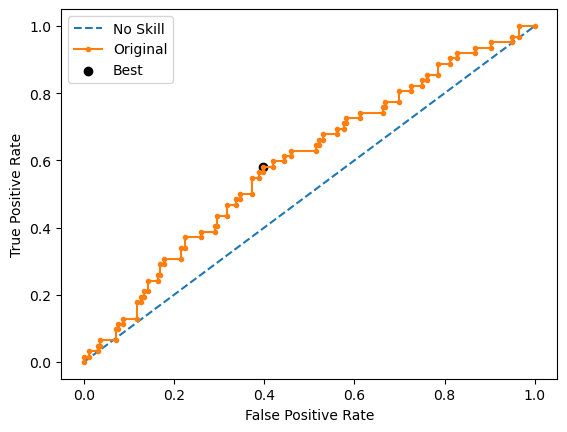

Learning rate set to 0.006754
0:	learn: 0.6916853	total: 4.99ms	remaining: 4.99s
1:	learn: 0.6903289	total: 10.6ms	remaining: 5.3s
2:	learn: 0.6890073	total: 15.6ms	remaining: 5.2s
3:	learn: 0.6876582	total: 20.3ms	remaining: 5.04s
4:	learn: 0.6870475	total: 25.3ms	remaining: 5.04s
5:	learn: 0.6853816	total: 29.9ms	remaining: 4.95s
6:	learn: 0.6842847	total: 34.4ms	remaining: 4.88s
7:	learn: 0.6824566	total: 37.8ms	remaining: 4.68s
8:	learn: 0.6813194	total: 42.4ms	remaining: 4.67s
9:	learn: 0.6800294	total: 46.8ms	remaining: 4.63s
10:	learn: 0.6789221	total: 49.5ms	remaining: 4.45s
11:	learn: 0.6774388	total: 51.7ms	remaining: 4.25s
12:	learn: 0.6757157	total: 54.7ms	remaining: 4.15s
13:	learn: 0.6746996	total: 58.7ms	remaining: 4.13s
14:	learn: 0.6730859	total: 61.2ms	remaining: 4.02s
15:	learn: 0.6718456	total: 63.4ms	remaining: 3.9s
16:	learn: 0.6709146	total: 65.5ms	remaining: 3.79s
17:	learn: 0.6697991	total: 67.4ms	remaining: 3.67s
18:	learn: 0.6687022	total: 68.9ms	remaining: 3

189:	learn: 0.5269306	total: 389ms	remaining: 1.66s
190:	learn: 0.5262537	total: 391ms	remaining: 1.66s
191:	learn: 0.5253291	total: 393ms	remaining: 1.65s
192:	learn: 0.5244931	total: 395ms	remaining: 1.65s
193:	learn: 0.5240084	total: 396ms	remaining: 1.65s
194:	learn: 0.5231907	total: 398ms	remaining: 1.64s
195:	learn: 0.5225427	total: 400ms	remaining: 1.64s
196:	learn: 0.5215866	total: 402ms	remaining: 1.64s
197:	learn: 0.5212563	total: 403ms	remaining: 1.63s
198:	learn: 0.5204369	total: 405ms	remaining: 1.63s
199:	learn: 0.5195266	total: 407ms	remaining: 1.63s
200:	learn: 0.5191325	total: 409ms	remaining: 1.63s
201:	learn: 0.5187122	total: 411ms	remaining: 1.62s
202:	learn: 0.5180479	total: 412ms	remaining: 1.62s
203:	learn: 0.5175894	total: 414ms	remaining: 1.61s
204:	learn: 0.5168248	total: 416ms	remaining: 1.61s
205:	learn: 0.5164302	total: 418ms	remaining: 1.61s
206:	learn: 0.5156280	total: 420ms	remaining: 1.61s
207:	learn: 0.5149708	total: 422ms	remaining: 1.61s
208:	learn: 

407:	learn: 0.4183677	total: 783ms	remaining: 1.14s
408:	learn: 0.4182178	total: 785ms	remaining: 1.13s
409:	learn: 0.4179346	total: 786ms	remaining: 1.13s
410:	learn: 0.4174990	total: 788ms	remaining: 1.13s
411:	learn: 0.4171055	total: 790ms	remaining: 1.13s
412:	learn: 0.4168689	total: 792ms	remaining: 1.13s
413:	learn: 0.4165777	total: 793ms	remaining: 1.12s
414:	learn: 0.4158572	total: 795ms	remaining: 1.12s
415:	learn: 0.4155036	total: 797ms	remaining: 1.12s
416:	learn: 0.4149222	total: 799ms	remaining: 1.12s
417:	learn: 0.4141999	total: 801ms	remaining: 1.11s
418:	learn: 0.4138575	total: 803ms	remaining: 1.11s
419:	learn: 0.4135042	total: 804ms	remaining: 1.11s
420:	learn: 0.4131456	total: 806ms	remaining: 1.11s
421:	learn: 0.4130539	total: 808ms	remaining: 1.11s
422:	learn: 0.4127538	total: 810ms	remaining: 1.1s
423:	learn: 0.4124647	total: 811ms	remaining: 1.1s
424:	learn: 0.4120328	total: 813ms	remaining: 1.1s
425:	learn: 0.4115723	total: 815ms	remaining: 1.1s
426:	learn: 0.41

626:	learn: 0.3411946	total: 1.18s	remaining: 702ms
627:	learn: 0.3409959	total: 1.18s	remaining: 700ms
628:	learn: 0.3404957	total: 1.18s	remaining: 698ms
629:	learn: 0.3402485	total: 1.19s	remaining: 696ms
630:	learn: 0.3398973	total: 1.19s	remaining: 694ms
631:	learn: 0.3395995	total: 1.19s	remaining: 692ms
632:	learn: 0.3393874	total: 1.19s	remaining: 690ms
633:	learn: 0.3390440	total: 1.19s	remaining: 688ms
634:	learn: 0.3387544	total: 1.19s	remaining: 687ms
635:	learn: 0.3380179	total: 1.2s	remaining: 685ms
636:	learn: 0.3377650	total: 1.2s	remaining: 683ms
637:	learn: 0.3376486	total: 1.2s	remaining: 681ms
638:	learn: 0.3373672	total: 1.2s	remaining: 679ms
639:	learn: 0.3370703	total: 1.2s	remaining: 677ms
640:	learn: 0.3370050	total: 1.21s	remaining: 675ms
641:	learn: 0.3367910	total: 1.21s	remaining: 673ms
642:	learn: 0.3365348	total: 1.21s	remaining: 671ms
643:	learn: 0.3362262	total: 1.21s	remaining: 669ms
644:	learn: 0.3358718	total: 1.21s	remaining: 667ms
645:	learn: 0.335

840:	learn: 0.2835507	total: 1.57s	remaining: 297ms
841:	learn: 0.2832513	total: 1.57s	remaining: 295ms
842:	learn: 0.2830830	total: 1.57s	remaining: 293ms
843:	learn: 0.2827748	total: 1.57s	remaining: 291ms
844:	learn: 0.2824755	total: 1.57s	remaining: 289ms
845:	learn: 0.2821053	total: 1.58s	remaining: 287ms
846:	learn: 0.2818157	total: 1.58s	remaining: 285ms
847:	learn: 0.2815491	total: 1.58s	remaining: 283ms
848:	learn: 0.2813402	total: 1.58s	remaining: 282ms
849:	learn: 0.2811791	total: 1.58s	remaining: 280ms
850:	learn: 0.2808916	total: 1.59s	remaining: 278ms
851:	learn: 0.2806024	total: 1.59s	remaining: 276ms
852:	learn: 0.2802199	total: 1.59s	remaining: 274ms
853:	learn: 0.2800115	total: 1.59s	remaining: 272ms
854:	learn: 0.2798689	total: 1.59s	remaining: 270ms
855:	learn: 0.2794924	total: 1.59s	remaining: 268ms
856:	learn: 0.2793418	total: 1.6s	remaining: 267ms
857:	learn: 0.2789683	total: 1.6s	remaining: 265ms
858:	learn: 0.2787746	total: 1.6s	remaining: 263ms
859:	learn: 0.2

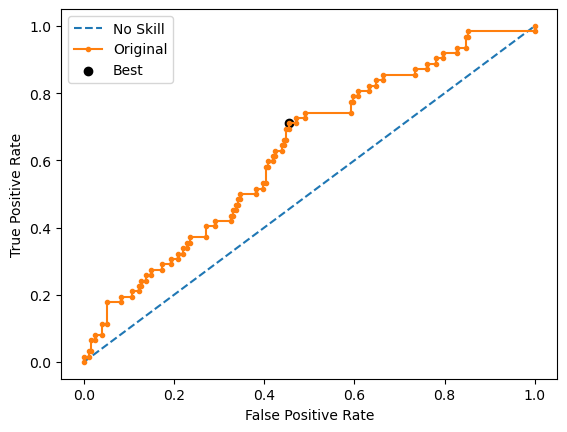

Learning rate set to 0.006754
0:	learn: 0.6921356	total: 6.3ms	remaining: 6.3s
1:	learn: 0.6914337	total: 12.1ms	remaining: 6.03s
2:	learn: 0.6905395	total: 18.2ms	remaining: 6.03s
3:	learn: 0.6893376	total: 25.2ms	remaining: 6.26s
4:	learn: 0.6886264	total: 31.4ms	remaining: 6.26s
5:	learn: 0.6873547	total: 38ms	remaining: 6.29s
6:	learn: 0.6865741	total: 43.7ms	remaining: 6.2s
7:	learn: 0.6851301	total: 49.2ms	remaining: 6.11s
8:	learn: 0.6836135	total: 54.3ms	remaining: 5.98s
9:	learn: 0.6819828	total: 58.2ms	remaining: 5.76s
10:	learn: 0.6807787	total: 60.4ms	remaining: 5.43s
11:	learn: 0.6794977	total: 62.6ms	remaining: 5.16s
12:	learn: 0.6787670	total: 64.6ms	remaining: 4.91s
13:	learn: 0.6780396	total: 66.9ms	remaining: 4.71s
14:	learn: 0.6766027	total: 69.1ms	remaining: 4.53s
15:	learn: 0.6753885	total: 71.3ms	remaining: 4.38s
16:	learn: 0.6744288	total: 76ms	remaining: 4.4s
17:	learn: 0.6732602	total: 78.3ms	remaining: 4.27s
18:	learn: 0.6727781	total: 80.1ms	remaining: 4.14s


190:	learn: 0.5427699	total: 391ms	remaining: 1.66s
191:	learn: 0.5421172	total: 393ms	remaining: 1.66s
192:	learn: 0.5412952	total: 395ms	remaining: 1.65s
193:	learn: 0.5407041	total: 397ms	remaining: 1.65s
194:	learn: 0.5399495	total: 399ms	remaining: 1.65s
195:	learn: 0.5393055	total: 400ms	remaining: 1.64s
196:	learn: 0.5385471	total: 402ms	remaining: 1.64s
197:	learn: 0.5378864	total: 404ms	remaining: 1.64s
198:	learn: 0.5368128	total: 406ms	remaining: 1.63s
199:	learn: 0.5364294	total: 408ms	remaining: 1.63s
200:	learn: 0.5357806	total: 410ms	remaining: 1.63s
201:	learn: 0.5353437	total: 412ms	remaining: 1.63s
202:	learn: 0.5348570	total: 414ms	remaining: 1.62s
203:	learn: 0.5344068	total: 416ms	remaining: 1.62s
204:	learn: 0.5339647	total: 417ms	remaining: 1.62s
205:	learn: 0.5330199	total: 419ms	remaining: 1.61s
206:	learn: 0.5320780	total: 421ms	remaining: 1.61s
207:	learn: 0.5317403	total: 423ms	remaining: 1.61s
208:	learn: 0.5313279	total: 425ms	remaining: 1.61s
209:	learn: 

403:	learn: 0.4429163	total: 779ms	remaining: 1.15s
404:	learn: 0.4427829	total: 781ms	remaining: 1.15s
405:	learn: 0.4424597	total: 783ms	remaining: 1.15s
406:	learn: 0.4419437	total: 785ms	remaining: 1.14s
407:	learn: 0.4416319	total: 786ms	remaining: 1.14s
408:	learn: 0.4410821	total: 788ms	remaining: 1.14s
409:	learn: 0.4404847	total: 790ms	remaining: 1.14s
410:	learn: 0.4402313	total: 791ms	remaining: 1.13s
411:	learn: 0.4398376	total: 793ms	remaining: 1.13s
412:	learn: 0.4392560	total: 795ms	remaining: 1.13s
413:	learn: 0.4388660	total: 797ms	remaining: 1.13s
414:	learn: 0.4385221	total: 799ms	remaining: 1.13s
415:	learn: 0.4380478	total: 801ms	remaining: 1.12s
416:	learn: 0.4376968	total: 803ms	remaining: 1.12s
417:	learn: 0.4373300	total: 804ms	remaining: 1.12s
418:	learn: 0.4367720	total: 806ms	remaining: 1.12s
419:	learn: 0.4364272	total: 808ms	remaining: 1.11s
420:	learn: 0.4358208	total: 810ms	remaining: 1.11s
421:	learn: 0.4355161	total: 812ms	remaining: 1.11s
422:	learn: 

624:	learn: 0.3619672	total: 1.18s	remaining: 707ms
625:	learn: 0.3616685	total: 1.18s	remaining: 705ms
626:	learn: 0.3613605	total: 1.18s	remaining: 703ms
627:	learn: 0.3611551	total: 1.18s	remaining: 701ms
628:	learn: 0.3609541	total: 1.19s	remaining: 699ms
629:	learn: 0.3606941	total: 1.19s	remaining: 697ms
630:	learn: 0.3604950	total: 1.19s	remaining: 695ms
631:	learn: 0.3601696	total: 1.19s	remaining: 693ms
632:	learn: 0.3598618	total: 1.19s	remaining: 692ms
633:	learn: 0.3596113	total: 1.19s	remaining: 690ms
634:	learn: 0.3591912	total: 1.2s	remaining: 688ms
635:	learn: 0.3590583	total: 1.2s	remaining: 686ms
636:	learn: 0.3588861	total: 1.2s	remaining: 684ms
637:	learn: 0.3585543	total: 1.2s	remaining: 682ms
638:	learn: 0.3580052	total: 1.2s	remaining: 680ms
639:	learn: 0.3577894	total: 1.21s	remaining: 678ms
640:	learn: 0.3575874	total: 1.21s	remaining: 676ms
641:	learn: 0.3571647	total: 1.21s	remaining: 674ms
642:	learn: 0.3568579	total: 1.21s	remaining: 672ms
643:	learn: 0.356

839:	learn: 0.3023413	total: 1.57s	remaining: 298ms
840:	learn: 0.3021414	total: 1.57s	remaining: 296ms
841:	learn: 0.3018356	total: 1.57s	remaining: 295ms
842:	learn: 0.3013456	total: 1.57s	remaining: 293ms
843:	learn: 0.3009797	total: 1.57s	remaining: 291ms
844:	learn: 0.3006217	total: 1.57s	remaining: 289ms
845:	learn: 0.3005498	total: 1.58s	remaining: 287ms
846:	learn: 0.3003620	total: 1.58s	remaining: 285ms
847:	learn: 0.3001333	total: 1.58s	remaining: 283ms
848:	learn: 0.2999307	total: 1.58s	remaining: 281ms
849:	learn: 0.2993766	total: 1.58s	remaining: 280ms
850:	learn: 0.2990679	total: 1.59s	remaining: 278ms
851:	learn: 0.2986594	total: 1.59s	remaining: 276ms
852:	learn: 0.2983075	total: 1.59s	remaining: 274ms
853:	learn: 0.2981067	total: 1.59s	remaining: 272ms
854:	learn: 0.2976749	total: 1.59s	remaining: 270ms
855:	learn: 0.2972516	total: 1.59s	remaining: 268ms
856:	learn: 0.2969459	total: 1.6s	remaining: 267ms
857:	learn: 0.2965187	total: 1.6s	remaining: 265ms
858:	learn: 0.

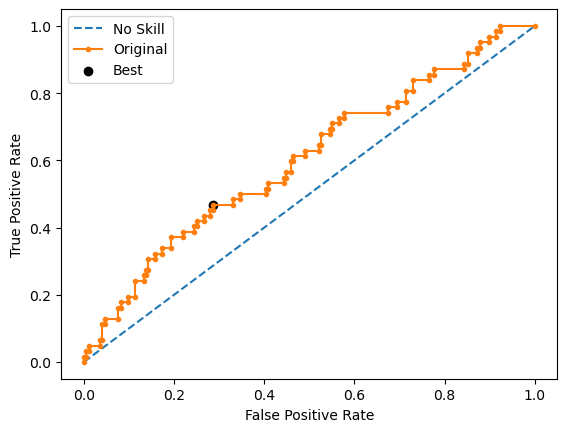

Ave Test G-mean: 0.5776264133640215
Stdev Test G-mean: 0.021888247073740607
Ave Test Specificity: 0.6081632653061224
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8109767151117362
Ave Test Accuracy: 0.5945736434108527
Ave Test Precision: 0.3092322828980502
Ave Test F1-Score: 0.3953285558011297
Ave Runtime: 2.019027900695801


In [128]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [129]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.611687,0.041561,0.586133,NaN,0.590816,0.635484,0.332645,0.435697,0.601550
4,Random Forest,0.601543,0.031002,0.576865,0.608803,0.638776,0.567742,0.332952,0.419291,0.621705
7,Extreme Gradient Boosting (XGBoost),0.598752,0.037482,0.569527,0.849971,0.642857,0.561290,0.332001,0.416351,0.623256
9,CatBoost,0.577626,0.021888,0.560594,0.948444,0.608163,0.551613,0.309232,0.395329,0.594574
6,LightGBM,0.574730,0.040840,0.589313,0.735724,0.596939,0.554839,0.303431,0.392101,0.586822
8,AdaBoost,0.572780,0.026081,0.569458,0.948381,0.606122,0.545161,0.304595,0.389872,0.591473
5,Gradient Boosting Machine (GBM),0.550277,0.042929,0.572540,0.874469,0.587755,0.525806,0.285581,0.368232,0.572868
2,Logistic Regression,0.539955,0.044973,0.540726,NaN,0.630612,0.464516,0.283812,0.352206,0.590698
1,SVM Classifier,0.524960,0.026284,0.538587,0.287537,0.508163,0.551613,0.260143,0.352584,0.518605
0,k-Nearest Neighbors,0.488140,0.057204,0.555174,0.688249,0.656122,0.367742,0.251044,0.297900,0.586822


In [134]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t06_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.623256,Extreme Gradient Boosting (XGBoost)
Highest Test G-mean,0.611687,Decision Tree
Highest Test Recall,0.635484,Decision Tree
Highest Test Precision,0.332952,Random Forest
Highest Test Specificity,0.656122,k-Nearest Neighbors
Highest Test F1-score,0.435697,Decision Tree


# HO-T06 Runs: StandardScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


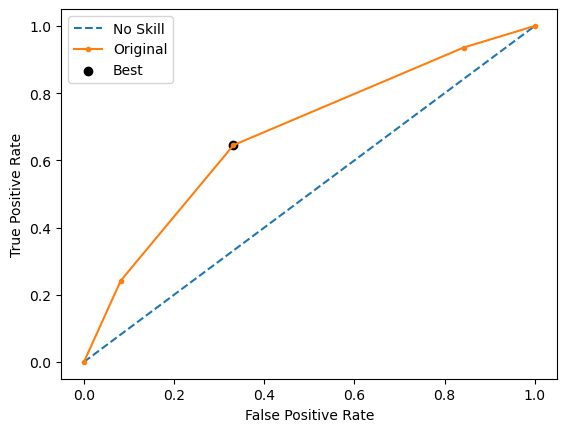

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


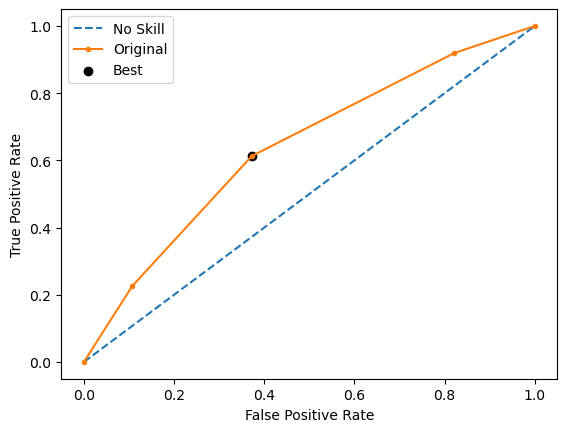

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


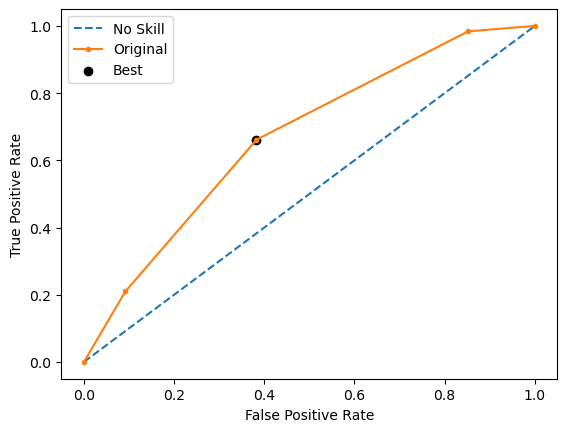

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


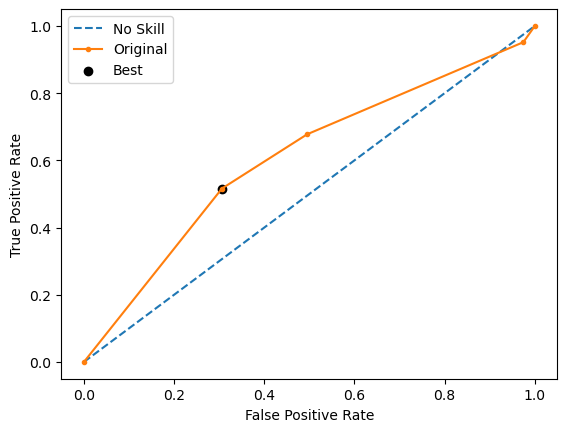

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


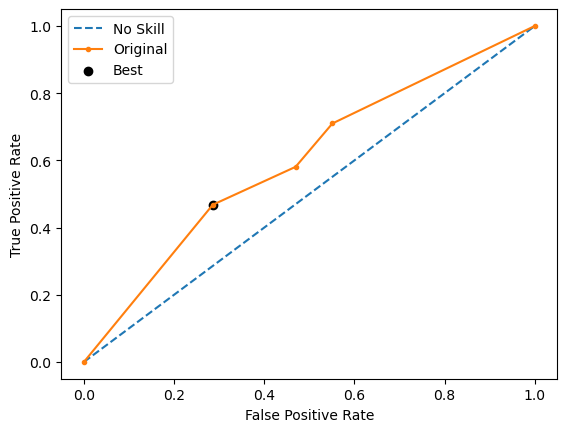

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

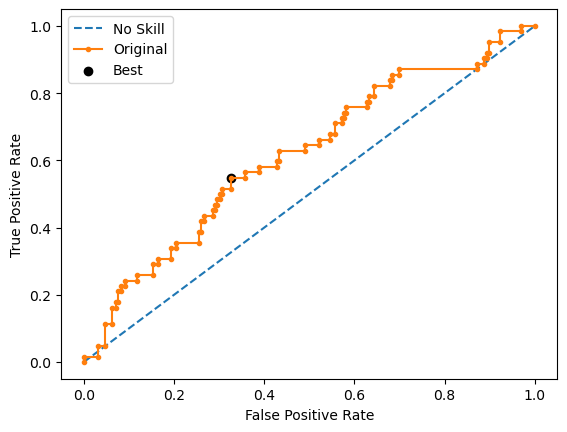

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


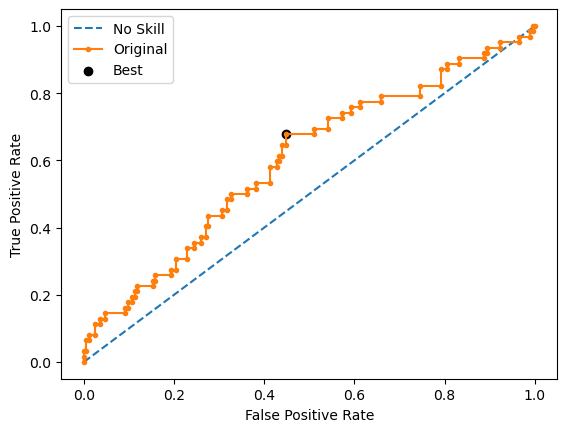

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


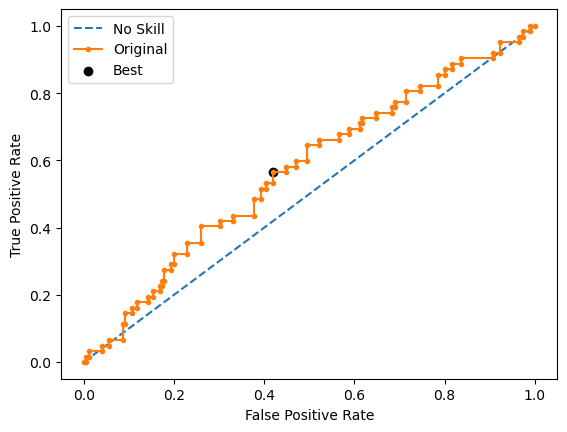

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


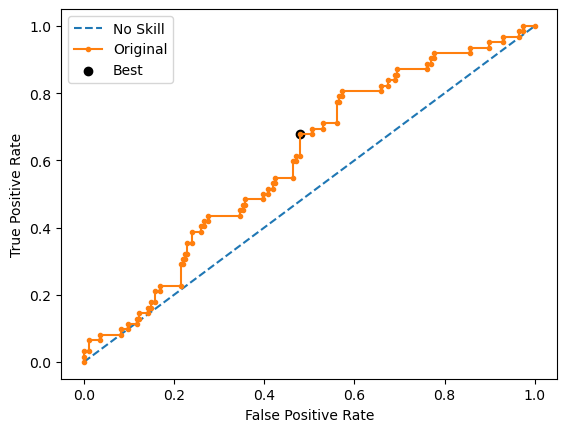

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


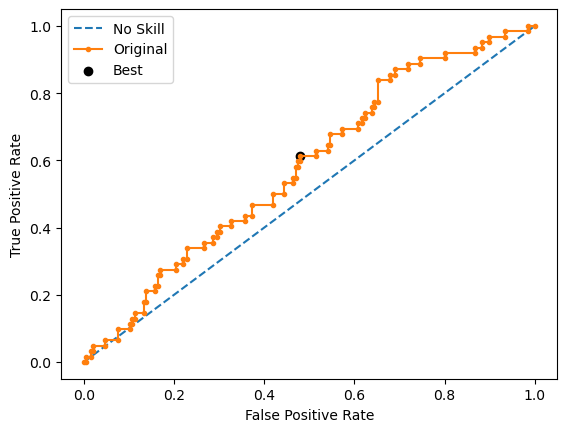

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


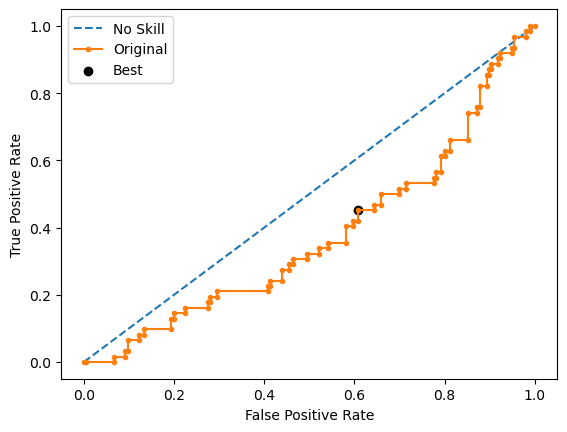

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


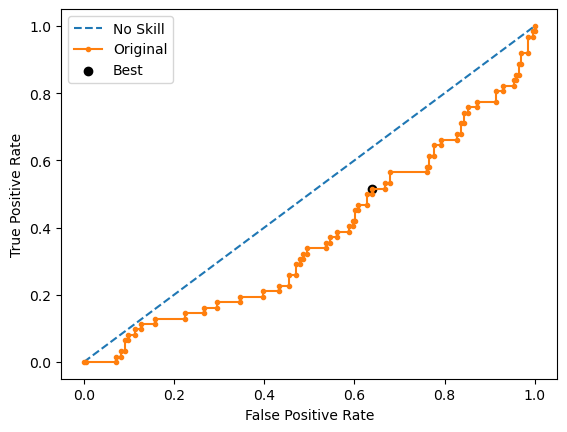

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


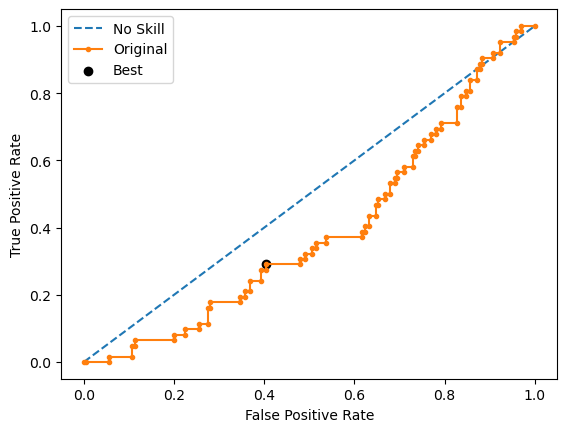

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


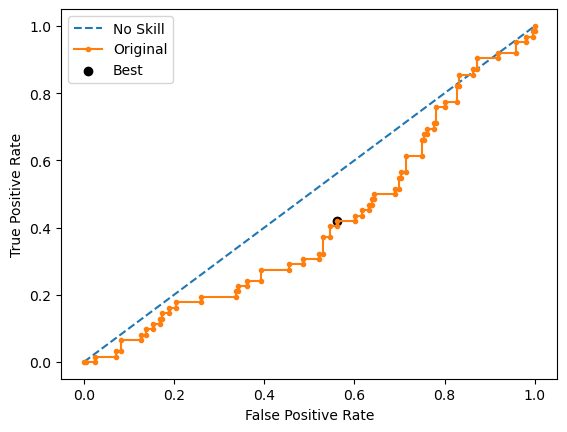

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


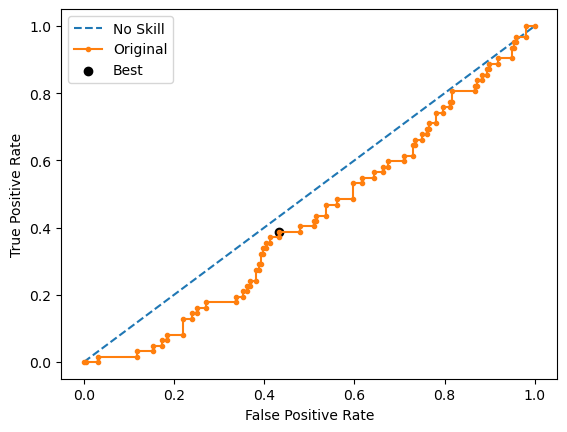

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5695273785971662
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_

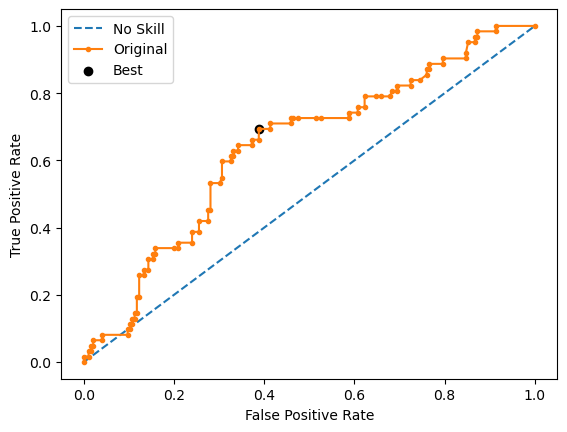

Run 2 - Random State: 1
Test G-mean: 0.6326636793264705
Best Threshold=0.493293, G-Mean=0.636


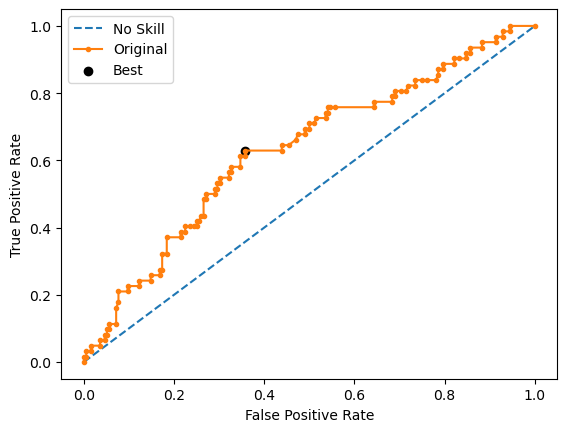

Run 3 - Random State: 2
Test G-mean: 0.5476774830239554
Best Threshold=0.458993, G-Mean=0.564


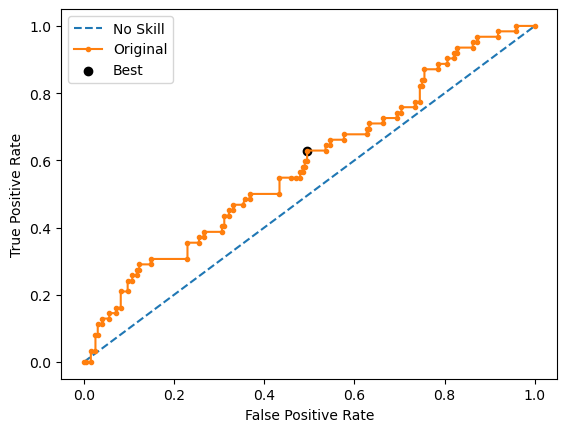

Run 4 - Random State: 3
Test G-mean: 0.6048683337050778
Best Threshold=0.481042, G-Mean=0.614


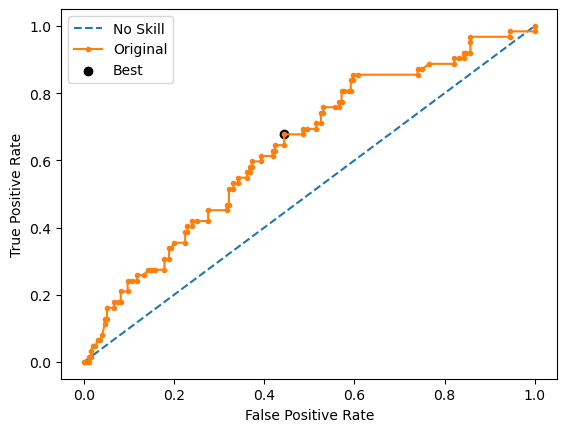

Run 5 - Random State: 4
Test G-mean: 0.5745880397335743
Best Threshold=0.543877, G-Mean=0.611


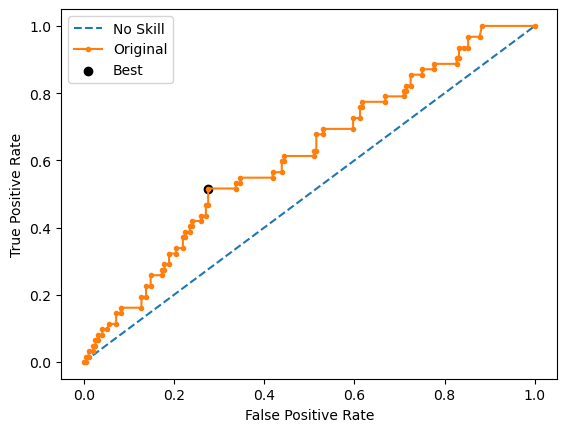

Ave Test G-mean: 0.5987521174719939
Stdev Test G-mean: 0.03748243903978868
Ave Test Specificity: 0.6428571428571429
Ave Test Recall: 0.5612903225806452
Ave Test NPV: 0.8229987307103309
Ave Test Accuracy: 0.6232558139534884
Ave Test Precision: 0.3320006269754075
Ave Test F1-Score: 0.4163508571460087
Ave Runtime: 0.19665169715881348


In [224]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'goss', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__n_estimators': 300, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.577998778688951
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='goss', learning_rate=0.01,
                                max_depth=3, n_estimators=300,
                                random_state=0))])
Mean Train Score (G-mean) 0.7598671718538652
Std Train Score (G-mean) 0.016532797612759057
GridSearchCV Runtime: 35.78956937789917 secs
Run 1 - Random State: 0
Test G-mean: 0.6109598099719176
Best Threshold=0.489740, G-Mean=0.626


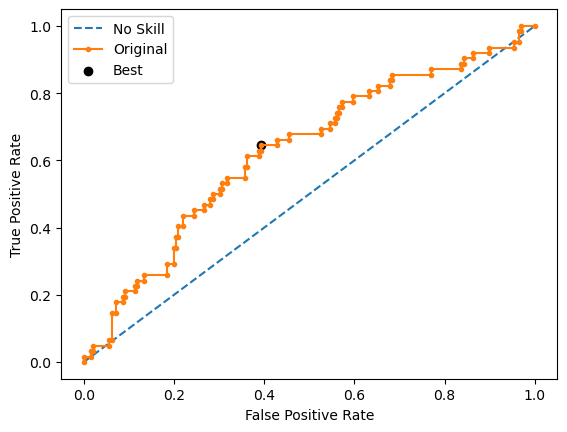

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.542979, G-Mean=0.621


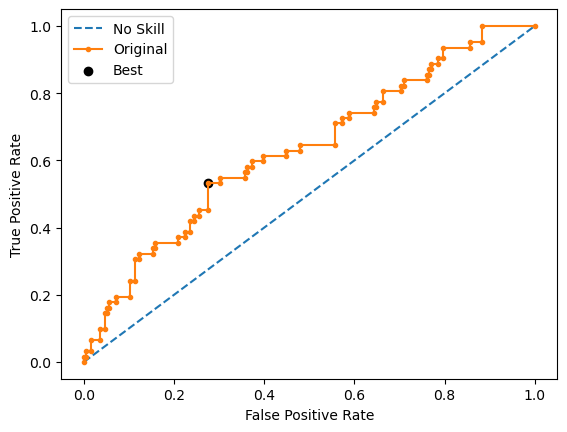

Run 3 - Random State: 2
Test G-mean: 0.6085305366932837
Best Threshold=0.503764, G-Mean=0.618


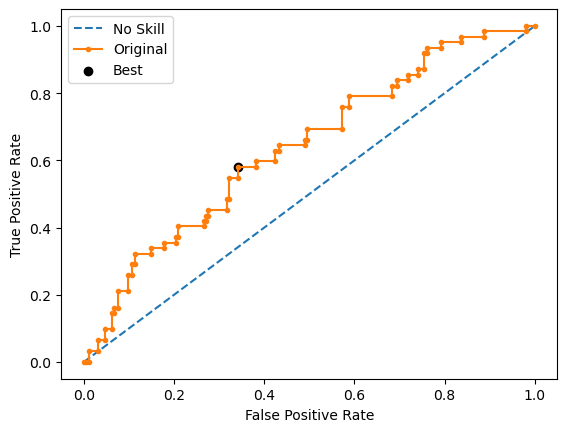

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.472611, G-Mean=0.591


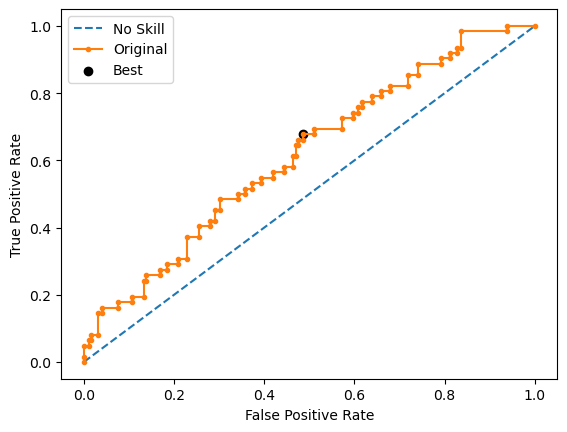

Run 5 - Random State: 4
Test G-mean: 0.5572846327942754
Best Threshold=0.554358, G-Mean=0.588


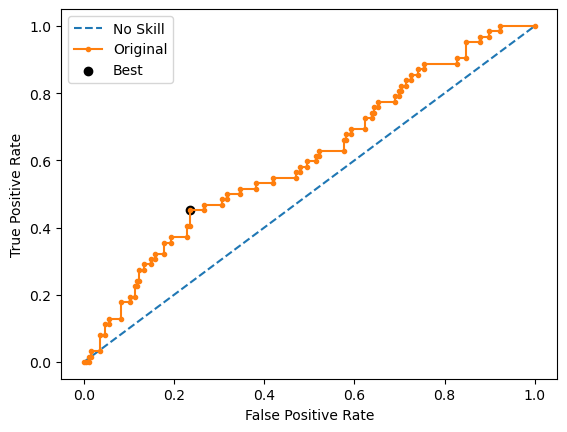

Ave Test G-mean: 0.5906856249389232
Stdev Test G-mean: 0.02411122756127123
Ave Test Specificity: 0.6112244897959184
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8178674166078368
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3182412107715316
Ave Test F1-Score: 0.40848232467154577
Ave Runtime: 0.3433506011962891


In [225]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5708017601192481
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9476864629106763
Std Train Score (G-mean) 0.0038326194544914087
GridSearchCV Runtime: 10.719450235366821 secs
Run 1 - Random State: 0
Test G-mean: 0.5937462102716796
Best Threshold=0.731059, G-Mean=0.594


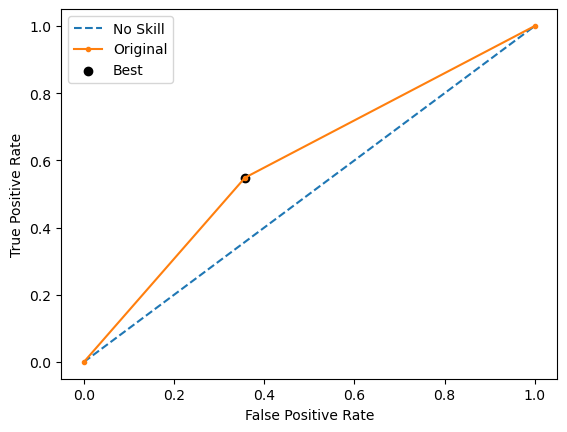

Run 2 - Random State: 1
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


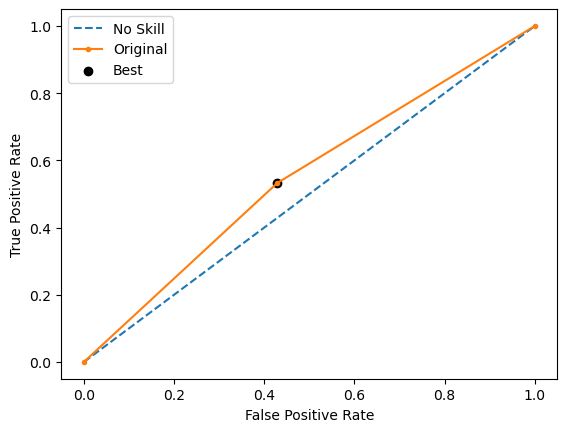

Run 3 - Random State: 2
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


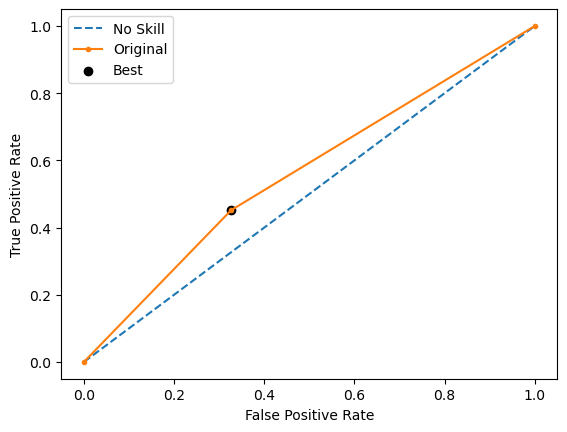

Run 4 - Random State: 3
Test G-mean: 0.6017310994101656
Best Threshold=0.731059, G-Mean=0.602


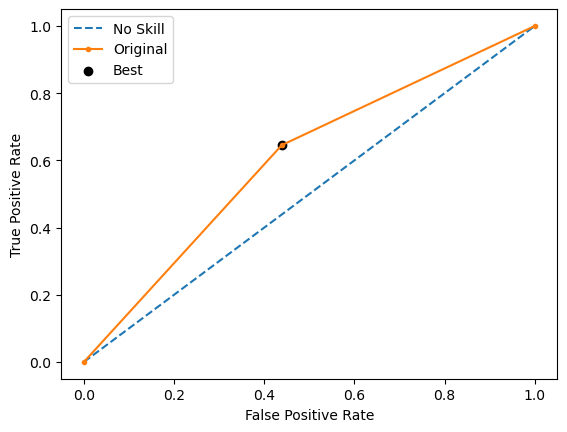

Run 5 - Random State: 4
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


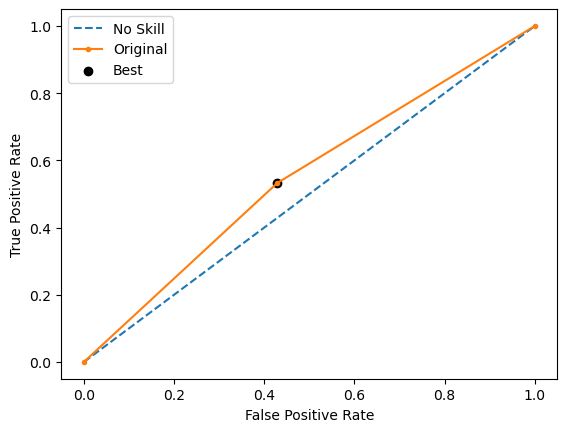

Ave Test G-mean: 0.5699928592630987
Stdev Test G-mean: 0.025485174455446857
Ave Test Specificity: 0.6040816326530611
Ave Test Recall: 0.5419354838709677
Ave Test NPV: 0.8070696713352443
Ave Test Accuracy: 0.5891472868217054
Ave Test Precision: 0.302566756914583
Ave Test F1-Score: 0.38724740006892266
Ave Runtime: 0.2264254570007324


In [226]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5680904738623496
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8771095131586388
Std Train Score (G-mean) 0.010527366294144738
GridSearchCV Runtime: 88.82423067092896 secs
Run 1 - Random State: 0
Test G-mean: 0.5597892954492245
Best Threshold=0.555999, G-Mean=0.580


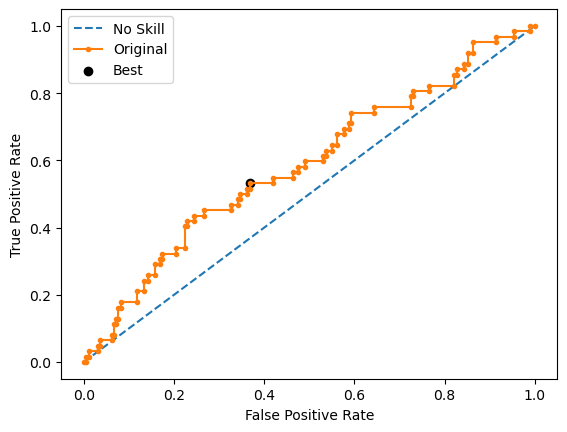

Run 2 - Random State: 1
Test G-mean: 0.5968564788564029
Best Threshold=0.521194, G-Mean=0.613


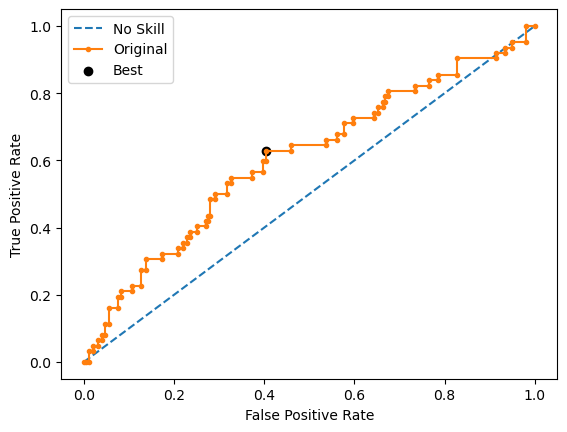

Run 3 - Random State: 2
Test G-mean: 0.48300613958372834
Best Threshold=0.295774, G-Mean=0.528


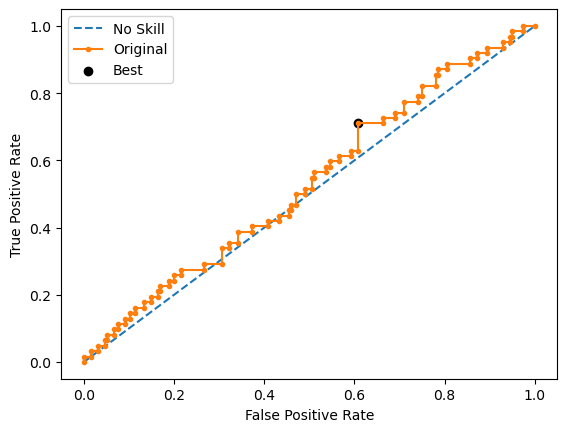

Run 4 - Random State: 3
Test G-mean: 0.5365201312326561
Best Threshold=0.446577, G-Mean=0.552


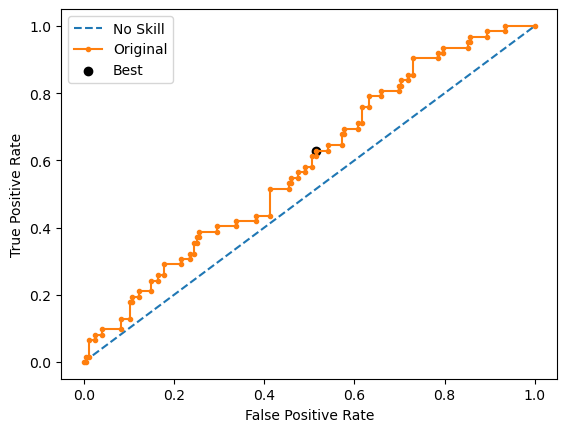

Run 5 - Random State: 4
Test G-mean: 0.568251536808238
Best Threshold=0.634908, G-Mean=0.582


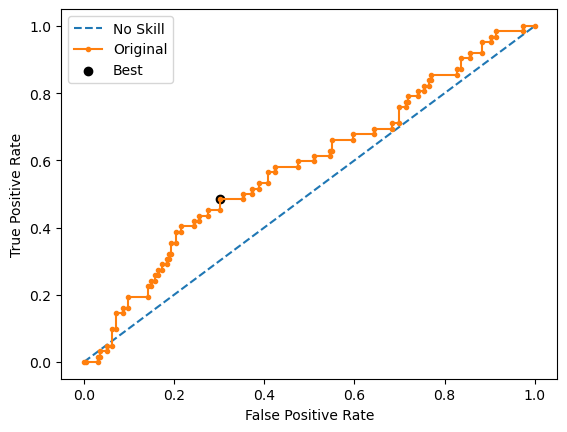

Ave Test G-mean: 0.54888471638605
Stdev Test G-mean: 0.04268531193466081
Ave Test Specificity: 0.5846938775510204
Ave Test Recall: 0.5258064516129031
Ave Test NPV: 0.7975992512186542
Ave Test Accuracy: 0.5705426356589147
Ave Test Precision: 0.2839449785968609
Ave Test F1-Score: 0.36694904582001353
Ave Runtime: 0.39573121070861816


In [228]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5767544617781283
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.619682586626071
Std Train Score (G-mean) 0.02081374722807044
GridSearchCV Runtime: 357.49217915534973 secs
Run 1 - Random State: 0
Test G-mean: 0.6347413981520182
Best 

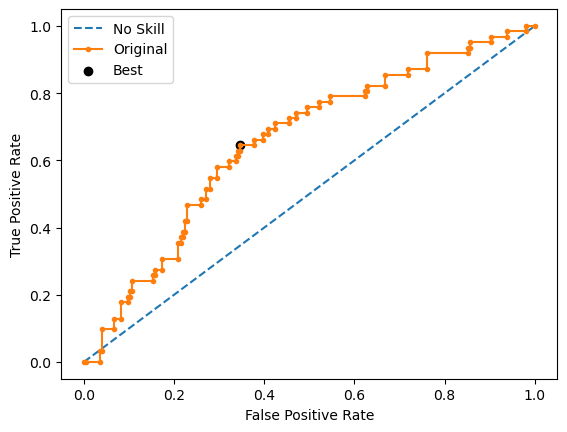

Run 2 - Random State: 1
Test G-mean: 0.6242836579493493
Best Threshold=0.500755, G-Mean=0.624


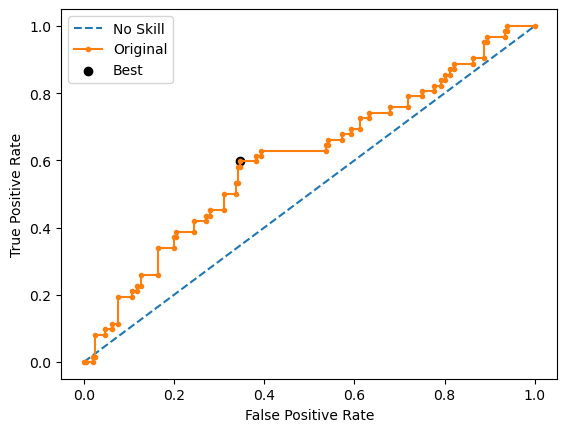

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.483924, G-Mean=0.589


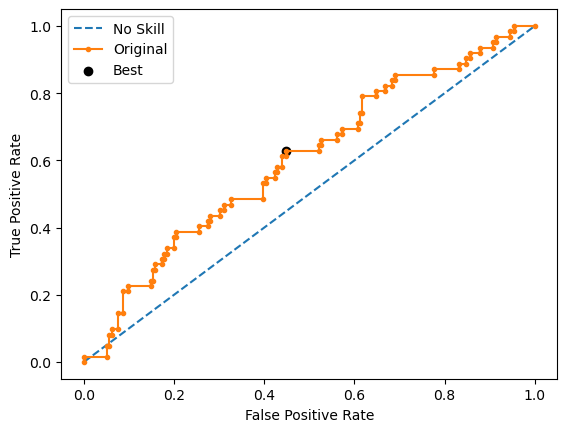

Run 4 - Random State: 3
Test G-mean: 0.591246215124694
Best Threshold=0.465005, G-Mean=0.621


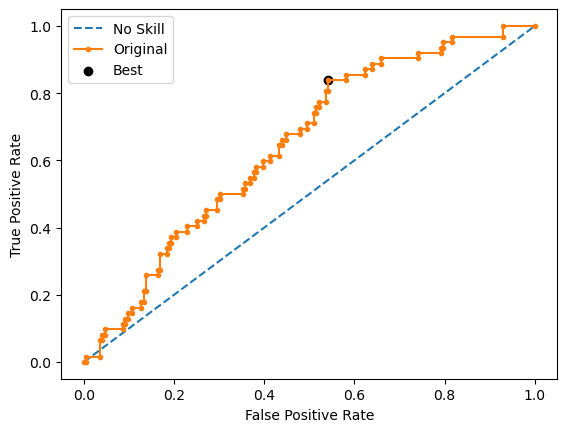

Run 5 - Random State: 4
Test G-mean: 0.6019362000578568
Best Threshold=0.509206, G-Mean=0.623


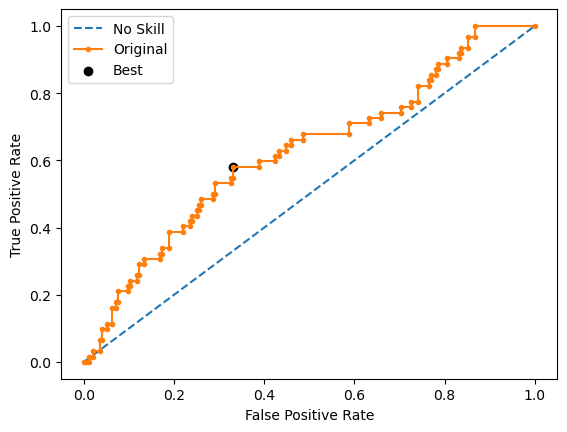

Ave Test G-mean: 0.6015434615493291
Stdev Test G-mean: 0.031002022889914615
Ave Test Specificity: 0.6387755102040816
Ave Test Recall: 0.567741935483871
Ave Test NPV: 0.8236238314622852
Ave Test Accuracy: 0.6217054263565892
Ave Test Precision: 0.33295230650884633
Ave Test F1-Score: 0.4192907178082785
Ave Runtime: 0.5530432224273681


In [227]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6918734	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6904773	total: 4.3ms	remaining: 2.15s
2:	learn: 0.6892748	total: 6.39ms	remaining: 2.13s
3:	learn: 0.6883518	total: 9.02ms	remaining: 2.25s
4:	learn: 0.6874894	total: 11.3ms	remaining: 2.25s
5:	learn: 0.6864793	total: 13.7ms	remaining: 2.26s
6:	learn: 0.6849713	total: 15.7ms	remaining: 2.23s
7:	learn: 0.6835259	total: 17.8ms	remaining: 2.2s
8:	learn: 0.6820508	total: 19.8ms	remaining: 2.19s
9:	learn: 0.6808529	total: 21.9ms	remaining: 2.17s
10:	learn: 0.6794658	total: 23.9ms	remaining: 2.15s
11:	learn: 0.6782565	total: 26.2ms	remaining: 2.15s
12:	learn: 0.6770542	total: 28.4ms	remaining: 2.15s
13:	learn: 0.6758270	total: 30.5ms	remaining: 2.15s
14:	learn: 0.6747007	total: 32.6ms	remaining: 2.14s
15:	learn: 0.6735646	total: 34.5ms	remaining: 2.12s
16:	learn: 0.6724274	total: 36.5ms	remaining: 2.11s
17:	learn: 0.6714028	total: 38.5ms	re

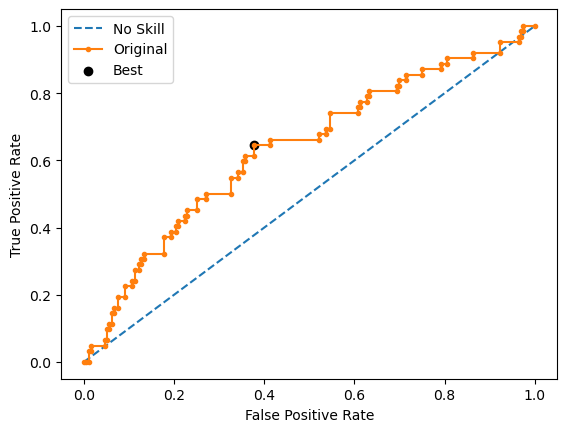

Learning rate set to 0.006754
0:	learn: 0.6909056	total: 4.65ms	remaining: 4.64s
1:	learn: 0.6892966	total: 6.37ms	remaining: 3.18s
2:	learn: 0.6879854	total: 8.06ms	remaining: 2.68s
3:	learn: 0.6869652	total: 10ms	remaining: 2.49s
4:	learn: 0.6857235	total: 12.1ms	remaining: 2.4s
5:	learn: 0.6845124	total: 13.8ms	remaining: 2.29s
6:	learn: 0.6829168	total: 15.5ms	remaining: 2.21s
7:	learn: 0.6809996	total: 17.3ms	remaining: 2.15s
8:	learn: 0.6789838	total: 19.2ms	remaining: 2.12s
9:	learn: 0.6771489	total: 20.9ms	remaining: 2.07s
10:	learn: 0.6755326	total: 22.7ms	remaining: 2.04s
11:	learn: 0.6742410	total: 24.4ms	remaining: 2.01s
12:	learn: 0.6725502	total: 26.4ms	remaining: 2.01s
13:	learn: 0.6705914	total: 28.2ms	remaining: 1.99s
14:	learn: 0.6692993	total: 30.3ms	remaining: 1.99s
15:	learn: 0.6680835	total: 32.1ms	remaining: 1.97s
16:	learn: 0.6669018	total: 33.8ms	remaining: 1.95s
17:	learn: 0.6658209	total: 35.8ms	remaining: 1.95s
18:	learn: 0.6646626	total: 37.4ms	remaining: 1

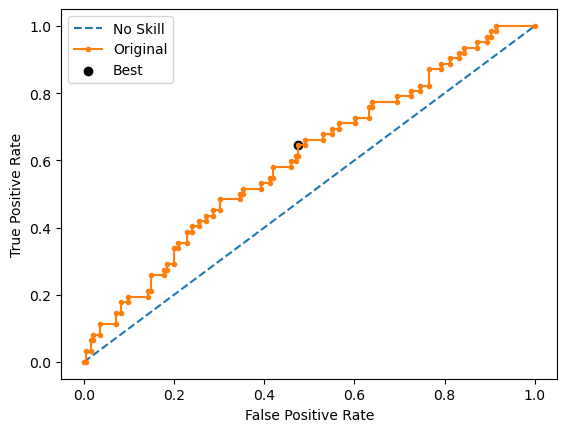

Learning rate set to 0.006754
0:	learn: 0.6912841	total: 3.81ms	remaining: 3.81s
1:	learn: 0.6900261	total: 7.11ms	remaining: 3.55s
2:	learn: 0.6889845	total: 10.3ms	remaining: 3.41s
3:	learn: 0.6882180	total: 13.2ms	remaining: 3.29s
4:	learn: 0.6870207	total: 15.7ms	remaining: 3.12s
5:	learn: 0.6858179	total: 18.8ms	remaining: 3.12s
6:	learn: 0.6851150	total: 21.4ms	remaining: 3.04s
7:	learn: 0.6832779	total: 23.8ms	remaining: 2.95s
8:	learn: 0.6823443	total: 25.8ms	remaining: 2.84s
9:	learn: 0.6812690	total: 27.5ms	remaining: 2.72s
10:	learn: 0.6800280	total: 29.5ms	remaining: 2.65s
11:	learn: 0.6792044	total: 31.4ms	remaining: 2.59s
12:	learn: 0.6783522	total: 33.3ms	remaining: 2.52s
13:	learn: 0.6772651	total: 35.5ms	remaining: 2.5s
14:	learn: 0.6763484	total: 37.2ms	remaining: 2.44s
15:	learn: 0.6753359	total: 39ms	remaining: 2.4s
16:	learn: 0.6745798	total: 41ms	remaining: 2.37s
17:	learn: 0.6740406	total: 42.8ms	remaining: 2.34s
18:	learn: 0.6730462	total: 44.7ms	remaining: 2.31

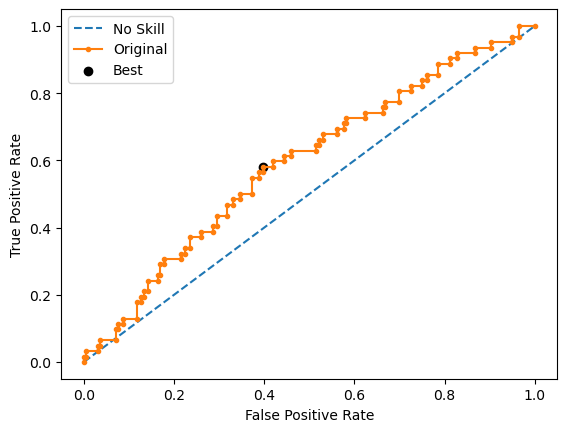

Learning rate set to 0.006754
0:	learn: 0.6916853	total: 4.3ms	remaining: 4.29s
1:	learn: 0.6903289	total: 9.16ms	remaining: 4.57s
2:	learn: 0.6890073	total: 11.5ms	remaining: 3.84s
3:	learn: 0.6876582	total: 14.8ms	remaining: 3.69s
4:	learn: 0.6870475	total: 17.5ms	remaining: 3.49s
5:	learn: 0.6853816	total: 19.5ms	remaining: 3.23s
6:	learn: 0.6842847	total: 21.4ms	remaining: 3.03s
7:	learn: 0.6824566	total: 24.3ms	remaining: 3.02s
8:	learn: 0.6813194	total: 27.5ms	remaining: 3.03s
9:	learn: 0.6800294	total: 30.8ms	remaining: 3.04s
10:	learn: 0.6789221	total: 32.9ms	remaining: 2.95s
11:	learn: 0.6774388	total: 34.8ms	remaining: 2.87s
12:	learn: 0.6757157	total: 36.6ms	remaining: 2.77s
13:	learn: 0.6746996	total: 38.4ms	remaining: 2.7s
14:	learn: 0.6730859	total: 40.6ms	remaining: 2.66s
15:	learn: 0.6718456	total: 42.6ms	remaining: 2.62s
16:	learn: 0.6709146	total: 44.5ms	remaining: 2.57s
17:	learn: 0.6697991	total: 46.6ms	remaining: 2.54s
18:	learn: 0.6687022	total: 48.2ms	remaining: 

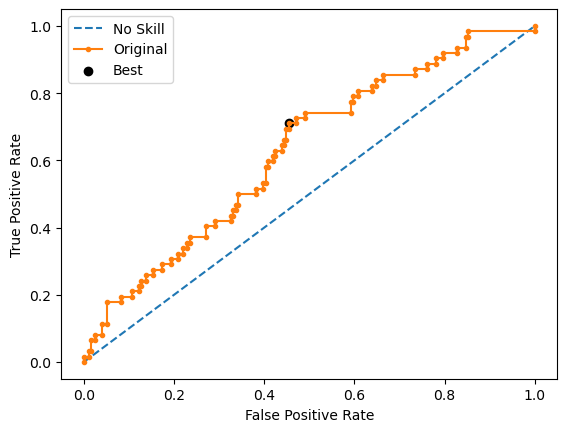

Learning rate set to 0.006754
0:	learn: 0.6921356	total: 7.1ms	remaining: 7.09s
1:	learn: 0.6914337	total: 12.6ms	remaining: 6.31s
2:	learn: 0.6905395	total: 18.7ms	remaining: 6.22s
3:	learn: 0.6893376	total: 24.1ms	remaining: 5.99s
4:	learn: 0.6886264	total: 29.6ms	remaining: 5.89s
5:	learn: 0.6873547	total: 36.1ms	remaining: 5.99s
6:	learn: 0.6865741	total: 41.9ms	remaining: 5.94s
7:	learn: 0.6851301	total: 48.2ms	remaining: 5.98s
8:	learn: 0.6836135	total: 54.3ms	remaining: 5.98s
9:	learn: 0.6819828	total: 59.6ms	remaining: 5.9s
10:	learn: 0.6807787	total: 65.1ms	remaining: 5.86s
11:	learn: 0.6794977	total: 70.6ms	remaining: 5.82s
12:	learn: 0.6787670	total: 75.5ms	remaining: 5.73s
13:	learn: 0.6780396	total: 78.3ms	remaining: 5.51s
14:	learn: 0.6766027	total: 82.7ms	remaining: 5.43s
15:	learn: 0.6753885	total: 85.8ms	remaining: 5.28s
16:	learn: 0.6744288	total: 88.7ms	remaining: 5.13s
17:	learn: 0.6732602	total: 91.9ms	remaining: 5.01s
18:	learn: 0.6727781	total: 93.8ms	remaining: 

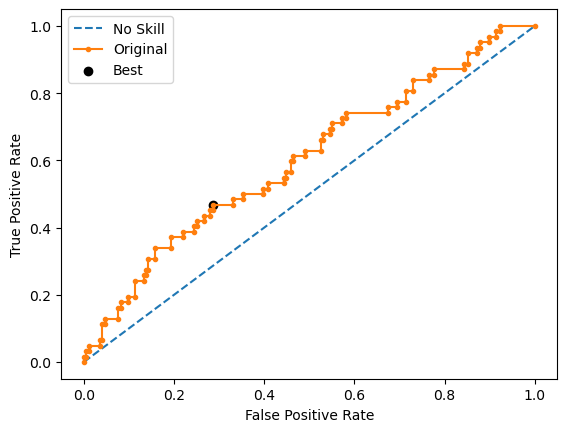

Ave Test G-mean: 0.5780613563062795
Stdev Test G-mean: 0.021632265673870815
Ave Test Specificity: 0.6091836734693878
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8112190842702608
Ave Test Accuracy: 0.5953488372093023
Ave Test Precision: 0.30989017763489235
Ave Test F1-Score: 0.3958123097316304
Ave Runtime: 2.033609962463379


In [250]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [249]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.611160,0.041101,0.586133,0.504563,0.589796,0.635484
4,Random Forest,0.601543,0.031002,0.576754,0.619683,0.638776,0.567742
7,Extreme Gradient Boosting (XGBoost),0.598752,0.037482,0.569527,0.864548,0.642857,0.561290
6,LightGBM,0.590686,0.024111,0.577999,0.759867,0.611224,0.570968
1,SVM Classifier,0.579030,0.019596,0.583602,0.521988,0.643878,0.522581
8,AdaBoost,0.569993,0.025485,0.570802,0.947686,0.604082,0.541935
5,Gradient Boosting Machine (GBM),0.548885,0.042685,0.568090,0.877110,0.584694,0.525806
2,Logistic Regression,0.547066,0.019058,0.551183,NaN,0.663265,0.451613
0,k-Nearest Neighbors,0.521198,0.040743,0.561944,0.692605,0.601020,0.454839


# HO-T07 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.594305156716838
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, random_state=0))])
Mean Train Score (G-mean) 0.5046837575262252
Std Train Score (G-mean) 0.06523744177119856
GridSearchCV Runtime: 109.23559808731079 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.571125, G-Mean=0.647


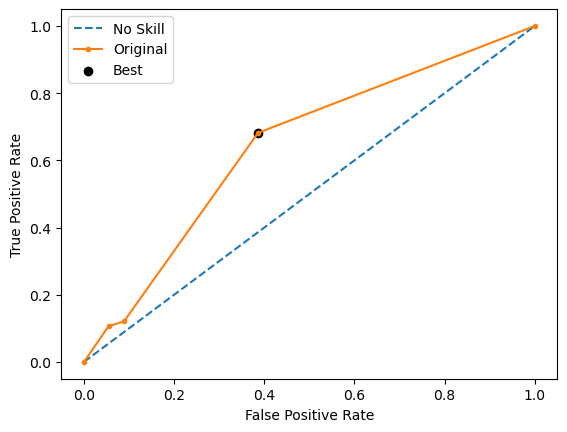

Run 2 - Random State: 1
Test G-mean: 0.6221243475949056
Best Threshold=0.549689, G-Mean=0.622


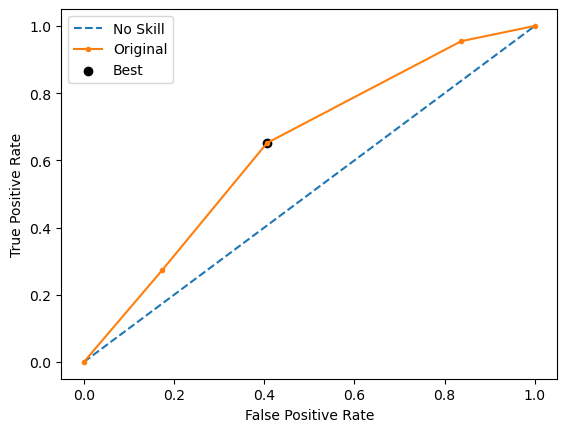

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.575309, G-Mean=0.587


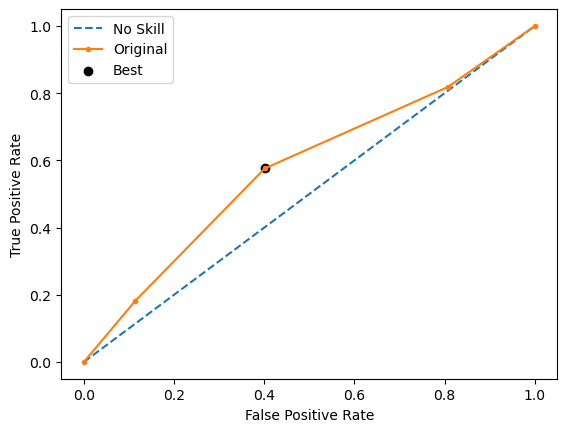

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.567033, G-Mean=0.647


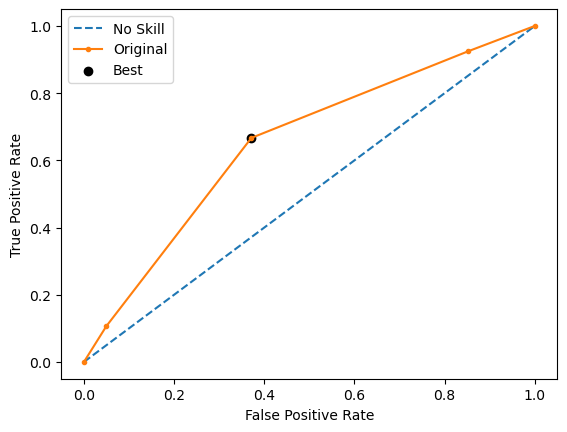

Run 5 - Random State: 4
Test G-mean: 0.6180114835659464
Best Threshold=0.556373, G-Mean=0.618


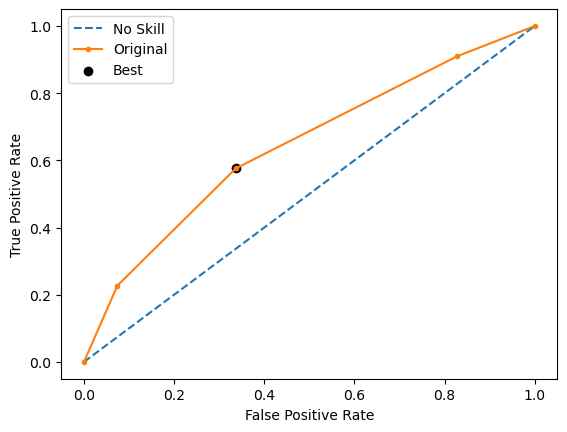

Ave Test G-mean: 0.6243528621539446
Stdev Test G-mean: 0.024812658646035383
Ave Test Specificity: 0.6198019801980198
Ave Test Recall: 0.6303030303030303
Ave Test NPV: 0.837184655396489
Ave Test Accuracy: 0.6223880597014926
Ave Test Precision: 0.3514839709652844
Ave Test F1-Score: 0.45095984157959074
Ave Runtime: 0.044297981262207034


In [253]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6028860756941616
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 103.42858576774597 secs
Run 1 - Random State: 0
Test G-mean: 0.6052574936862545
Best Threshold=0.516985, G-Mean=0.613


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


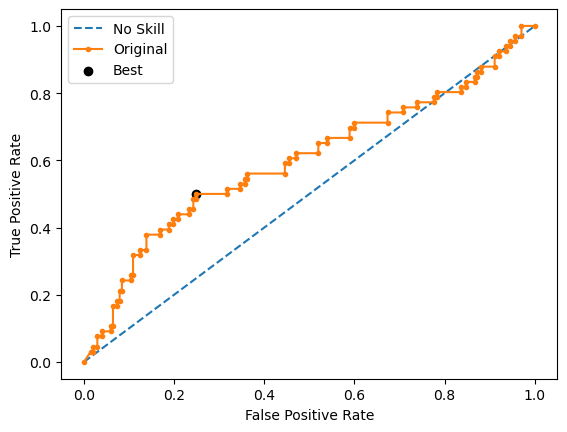

Run 2 - Random State: 1
Test G-mean: 0.5818795909686458
Best Threshold=0.494786, G-Mean=0.585


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


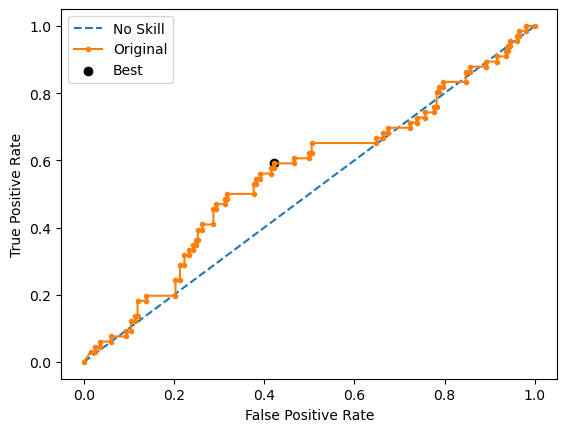

Run 3 - Random State: 2
Test G-mean: 0.6000300022501874
Best Threshold=0.507981, G-Mean=0.610


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


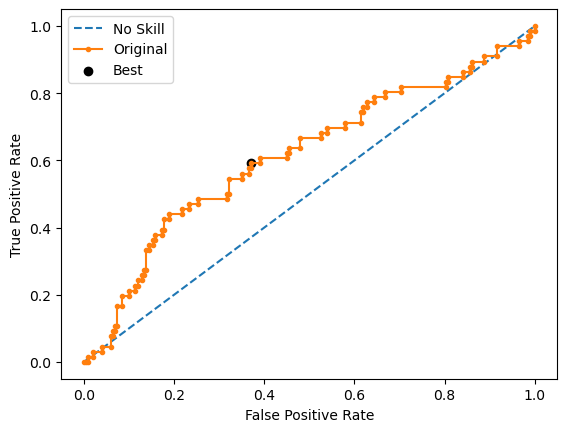

Run 4 - Random State: 3
Test G-mean: 0.5794899316278807
Best Threshold=0.517572, G-Mean=0.582


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


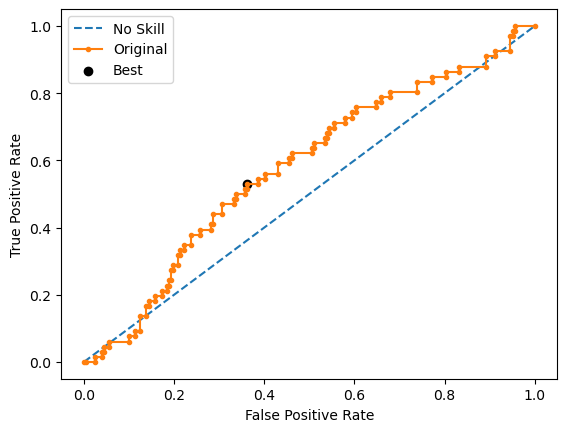

Run 5 - Random State: 4
Test G-mean: 0.5498001709919726
Best Threshold=0.455935, G-Mean=0.567


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


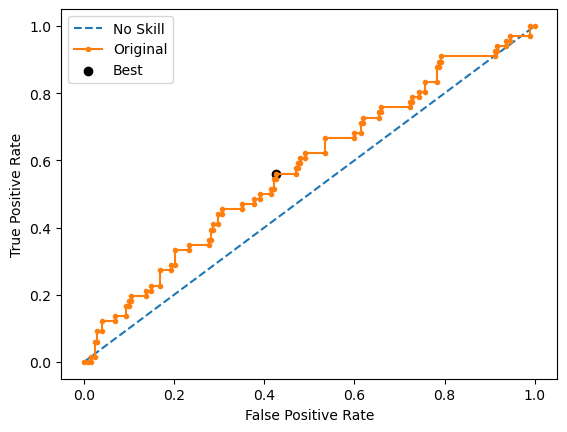

Ave Test G-mean: 0.5832914379049882
Stdev Test G-mean: 0.02179906456771411
Ave Test Specificity: 0.6346534653465347
Ave Test Recall: 0.5393939393939393
Ave Test NPV: 0.8084179681286464
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.327589741869245
Ave Test F1-Score: 0.4060627733963201
Ave Runtime: 0.6266489505767823


In [254]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.525756832540497
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.252068334547509
Std Train Score (G-mean) 0.05114472320145939
GridSearchCV Runtime: 182.0276017189026 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5222329678670935
Best Threshold=0.505154, G-Mean=0.297


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


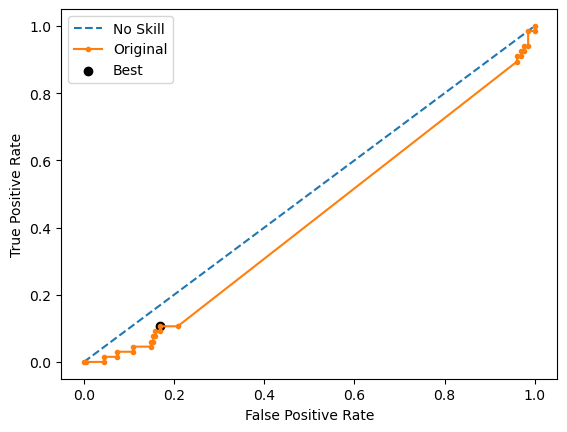

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5620779244547112
Best Threshold=0.500000, G-Mean=0.236


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


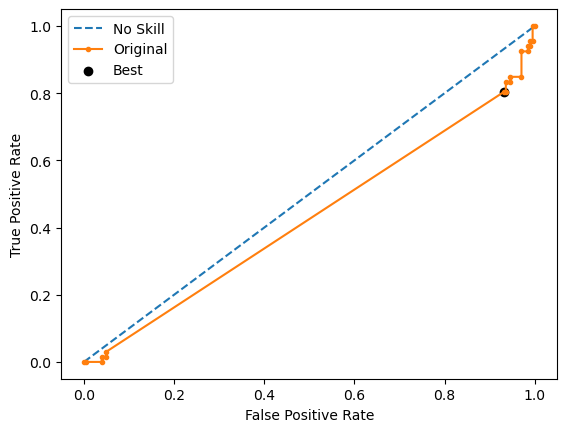

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5035130112869513
Best Threshold=0.494625, G-Mean=0.373


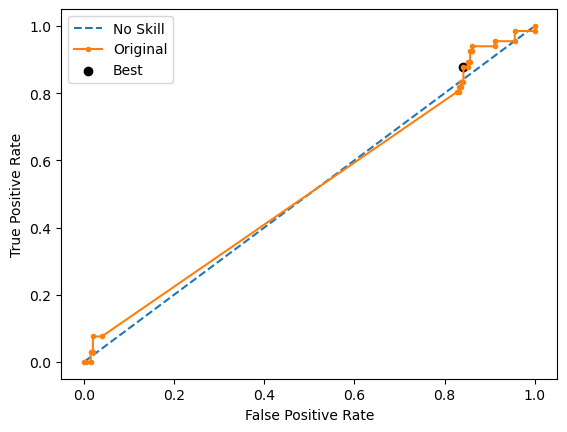

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.49358318694647985
Best Threshold=0.506519, G-Mean=0.359


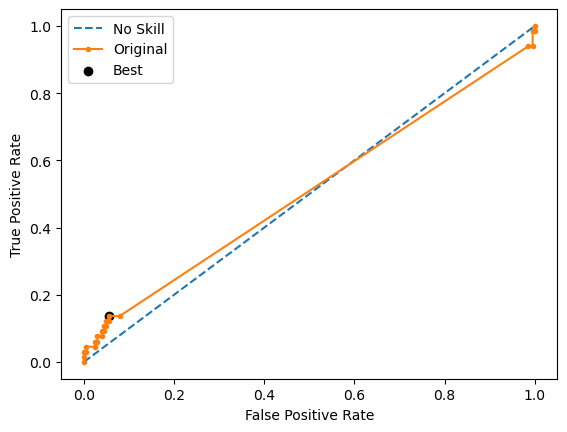

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5260253513539311
Best Threshold=0.505944, G-Mean=0.475


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


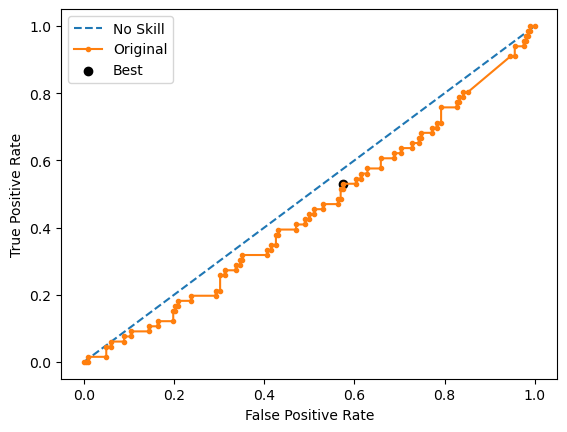

Ave Test G-mean: 0.5214864883818333
Stdev Test G-mean: 0.026317595354782956
Ave Test Specificity: 0.5643564356435644
Ave Test Recall: 0.4878787878787879
Ave Test NPV: 0.7720206747682841
Ave Test Accuracy: 0.5455223880597014
Ave Test Precision: 0.2673880462672968
Ave Test F1-Score: 0.344334146128061
Ave Runtime: 0.3679812431335449


In [255]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [256]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 14, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5616302635069764
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=14))])
Mean Train Score (G-mean) 0.6886934920016934
Std Train Score (G-mean) 0.014052201123921772
GridSearchCV Runtime: 117.2994921207428 secs
Run 1 - Random State: 0
Test G-mean: 0.5545545537413857
Run 2 - Random State: 1
Test G-mean: 0.5148558124861417
Run 3 - Random State: 2
Test G-mean: 0.5405129188294597
Run 4 - Random State: 3
Test G-mean: 0.5664645515906718
Run 5 - Random State: 4
Test G-mean: 0.495251983794861
Ave Test G-mean: 0.534327964088504
Stdev Test G-mean: 0.02909564303445095
Ave Test Specificity: 

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5923832184748289
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7420279935572658
Std Train Score (G-mean) 0.02116929085852266
GridSearchCV Runtime: 45.67667579650879 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.527040, G-Mean=0.690


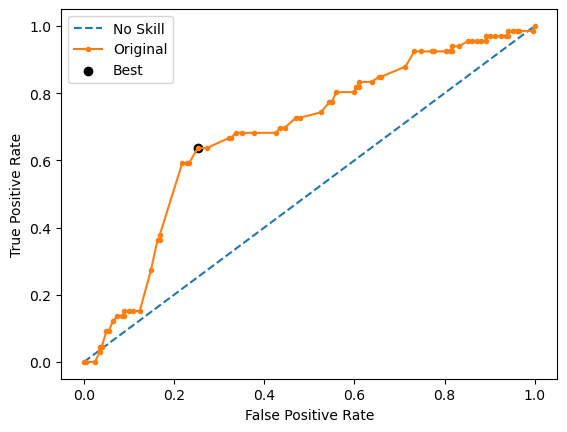

Run 2 - Random State: 1
Test G-mean: 0.6224859427126748
Best Threshold=0.515278, G-Mean=0.642


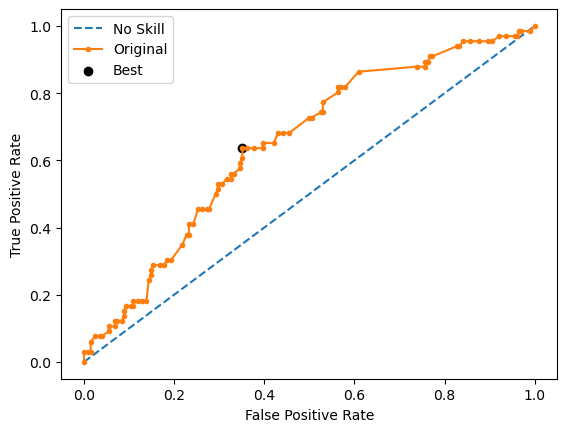

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.534545, G-Mean=0.587


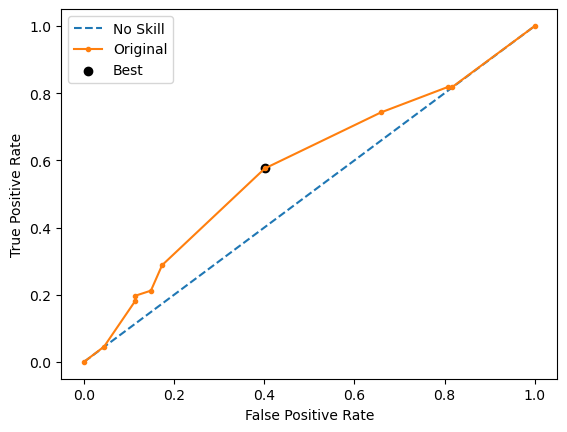

Run 4 - Random State: 3
Test G-mean: 0.6374877560109734
Best Threshold=0.527584, G-Mean=0.665


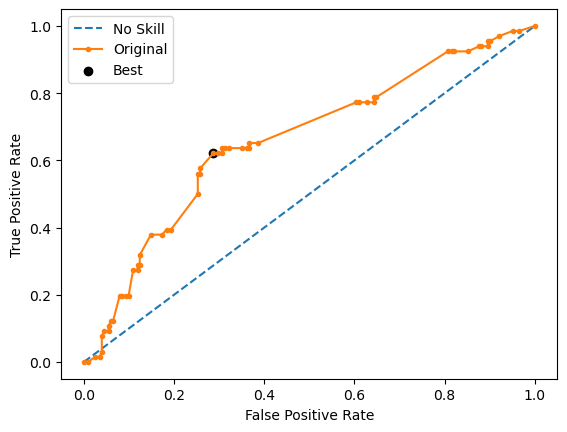

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


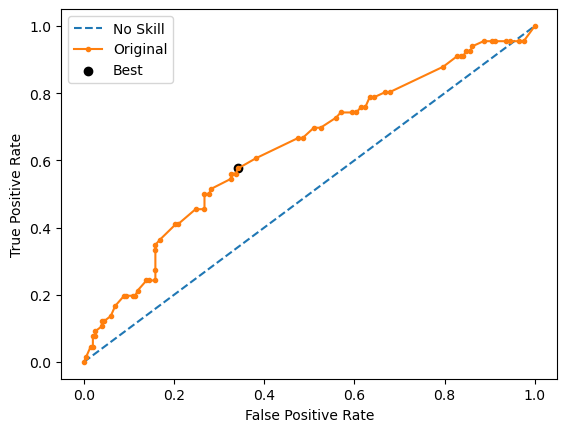

Ave Test G-mean: 0.6213187062333223
Stdev Test G-mean: 0.023230156834298615
Ave Test Specificity: 0.6158415841584158
Ave Test Recall: 0.6272727272727272
Ave Test NPV: 0.8349878938043582
Ave Test Accuracy: 0.6186567164179103
Ave Test Precision: 0.3478773121660482
Ave Test F1-Score: 0.4474892031398528
Ave Runtime: 0.3838043689727783


In [258]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6020912873576488
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9436587297011378
Std Train Score (G-mean) 0.004484499732313889
GridSearchCV Runtime: 12.505472421646118 secs
Run 1 - Random State: 0
Test G-mean: 0.596896664895069
Best Threshold=0.731059, G-Mean=0.597


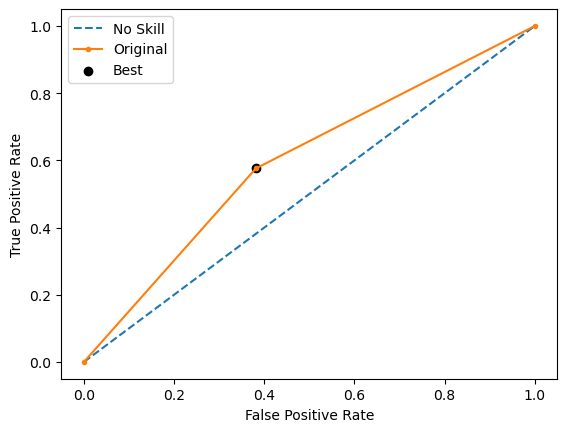

Run 2 - Random State: 1
Test G-mean: 0.5757891569970136
Best Threshold=0.731059, G-Mean=0.576


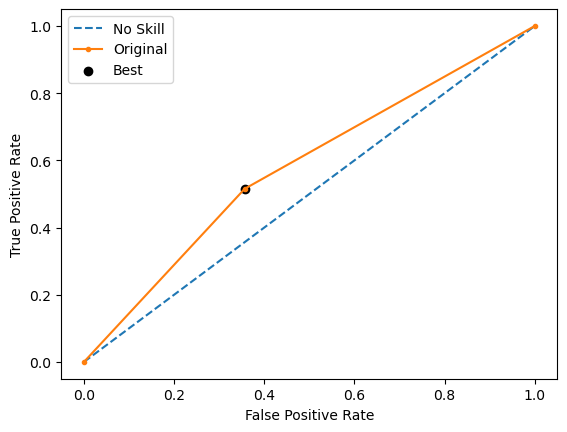

Run 3 - Random State: 2
Test G-mean: 0.5518427792816578
Best Threshold=0.731059, G-Mean=0.552


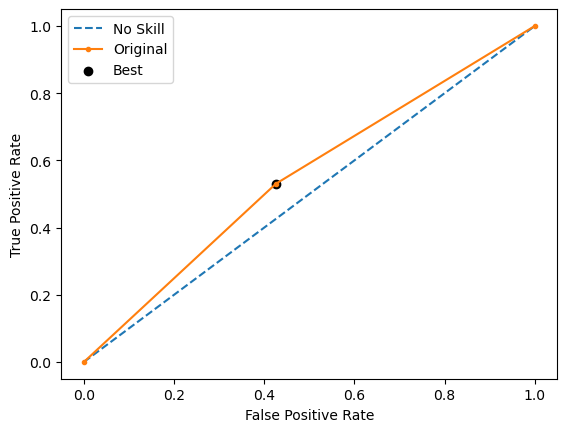

Run 4 - Random State: 3
Test G-mean: 0.5682493209226676
Best Threshold=0.731059, G-Mean=0.568


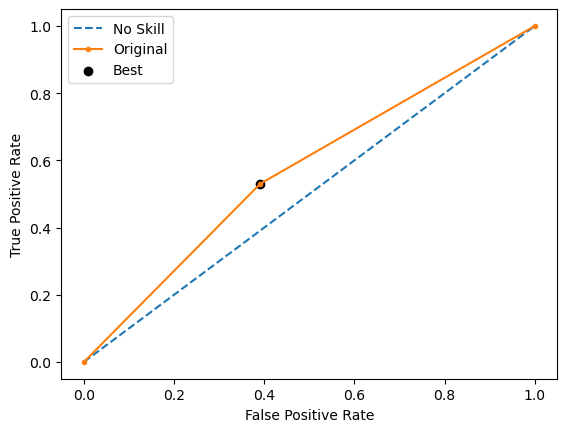

Run 5 - Random State: 4
Test G-mean: 0.58458033957476
Best Threshold=0.731059, G-Mean=0.585


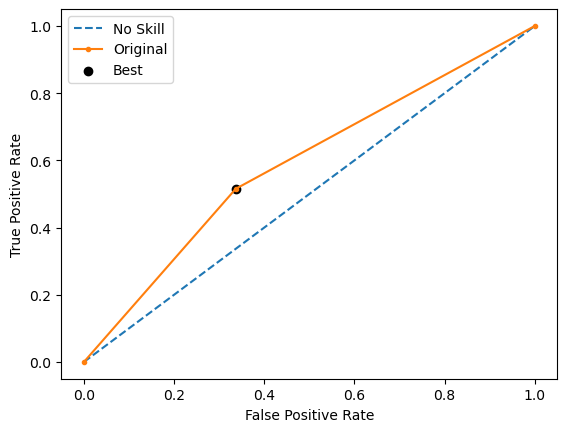

Ave Test G-mean: 0.5754716523342337
Stdev Test G-mean: 0.016974877528584738
Ave Test Specificity: 0.6217821782178218
Ave Test Recall: 0.5333333333333333
Ave Test NPV: 0.8029016920954419
Ave Test Accuracy: 0.6
Ave Test Precision: 0.3161593150259835
Ave Test F1-Score: 0.3966441368849332
Ave Runtime: 0.26468625068664553


In [259]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5820526945931113
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8829407400855935
Std Train Score (G-mean) 0.010635227990922288
GridSearchCV Runtime: 147.33878827095032 secs
Run 1 - Random State: 0
Test G-mean: 0.5650725003865162
Best Threshold=0.373778, G-Mean=0.622


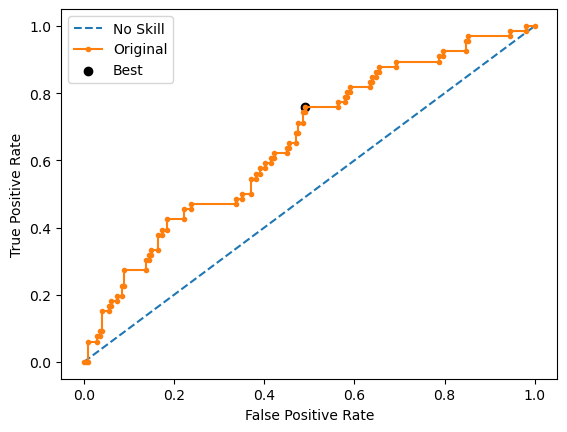

Run 2 - Random State: 1
Test G-mean: 0.5347930444200224
Best Threshold=0.434090, G-Mean=0.562


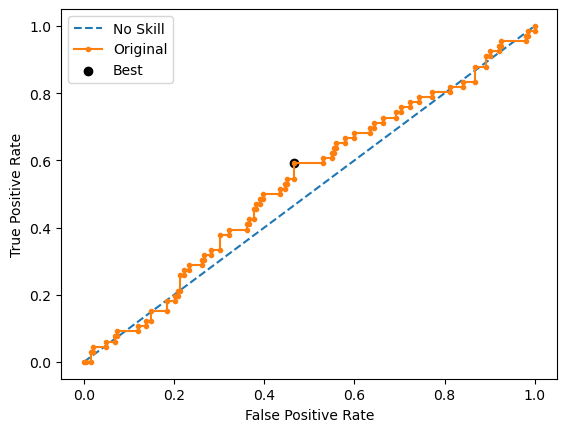

Run 3 - Random State: 2
Test G-mean: 0.6082244599647156
Best Threshold=0.514068, G-Mean=0.608


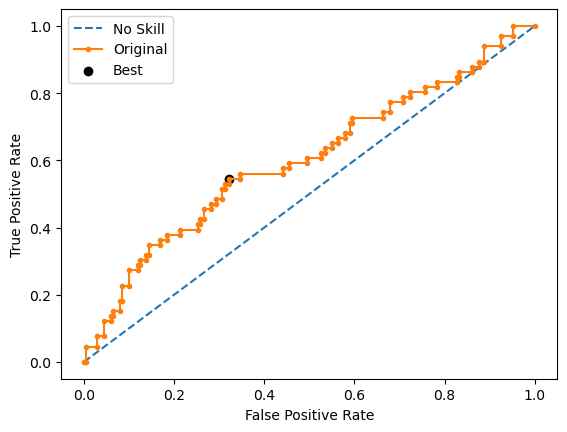

Run 4 - Random State: 3
Test G-mean: 0.541898851665644
Best Threshold=0.355166, G-Mean=0.584


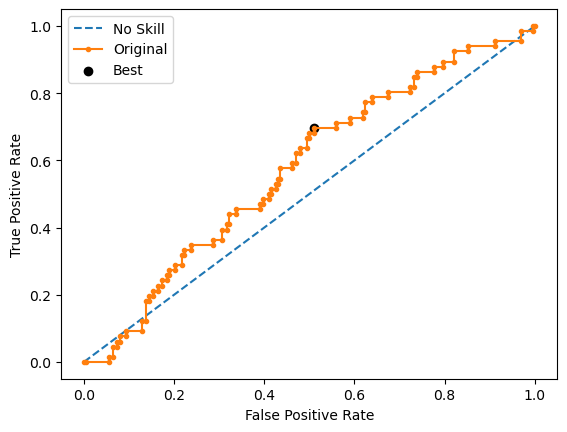

Run 5 - Random State: 4
Test G-mean: 0.5324738048348328
Best Threshold=0.431802, G-Mean=0.600


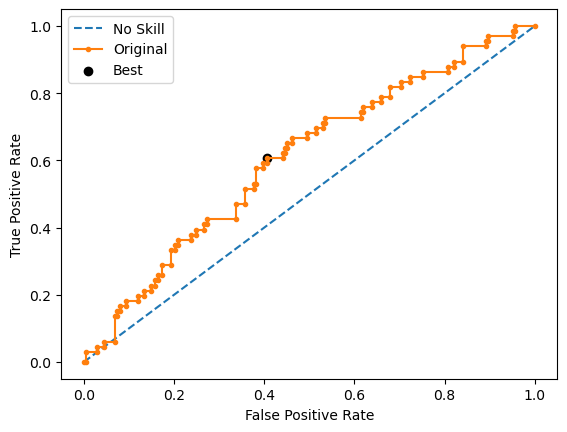

Ave Test G-mean: 0.5564925322543463
Stdev Test G-mean: 0.031664454637771115
Ave Test Specificity: 0.6524752475247525
Ave Test Recall: 0.47575757575757577
Ave Test NPV: 0.7920734264262264
Ave Test Accuracy: 0.608955223880597
Ave Test Precision: 0.30927895110762316
Ave Test F1-Score: 0.374596432074146
Ave Runtime: 0.6857966423034668


In [260]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.594776223443463
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
       

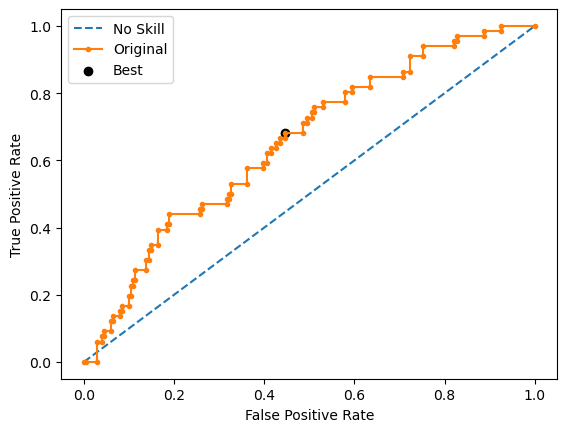

Run 2 - Random State: 1
Test G-mean: 0.5455545462887259
Best Threshold=0.390412, G-Mean=0.577


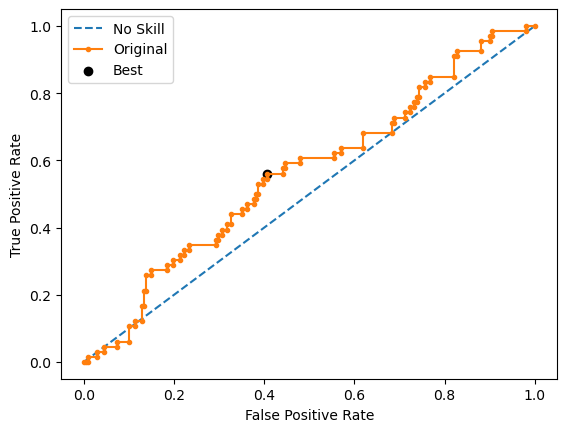

Run 3 - Random State: 2
Test G-mean: 0.60296049301394
Best Threshold=0.345868, G-Mean=0.610


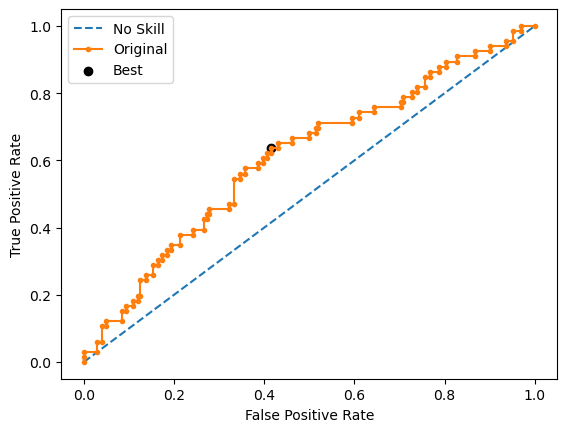

Run 4 - Random State: 3
Test G-mean: 0.5776100443520124
Best Threshold=0.746747, G-Mean=0.614


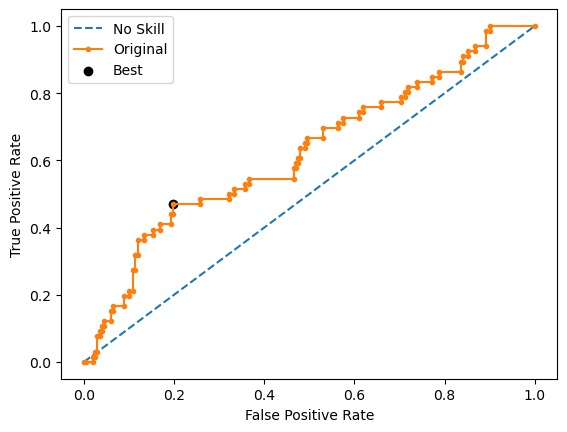

Run 5 - Random State: 4
Test G-mean: 0.5228788963364495
Best Threshold=0.370161, G-Mean=0.577


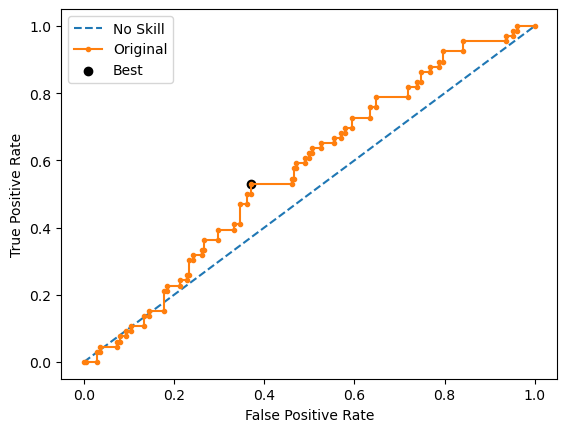

Ave Test G-mean: 0.5671267374504626
Stdev Test G-mean: 0.032394268272267525
Ave Test Specificity: 0.6742574257425742
Ave Test Recall: 0.4787878787878788
Ave Test NPV: 0.7984199040153084
Ave Test Accuracy: 0.6261194029850746
Ave Test Precision: 0.3253225435999957
Ave Test F1-Score: 0.38669440203548416
Ave Runtime: 0.3103505611419678


In [261]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6016644629517163
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6227262963253994
Std Train Score (G-mean) 0.022477704456260326
GridSearchCV Runtime: 392.5867874622345 secs
Run 1 - Random State: 0
Test G-mean: 0.6467161851866847
Best Threshold=0.504757, G-Mean=0.653


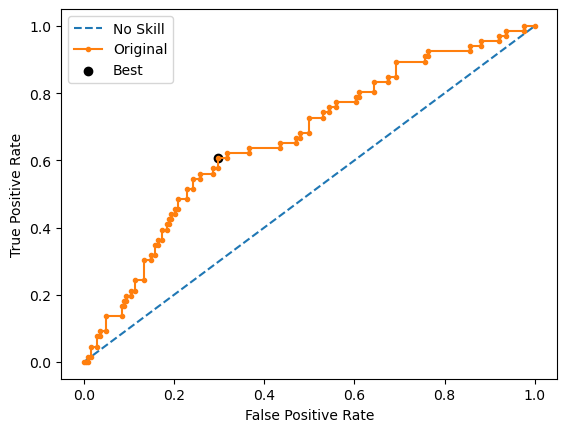

Run 2 - Random State: 1
Test G-mean: 0.563610473355994
Best Threshold=0.477636, G-Mean=0.573


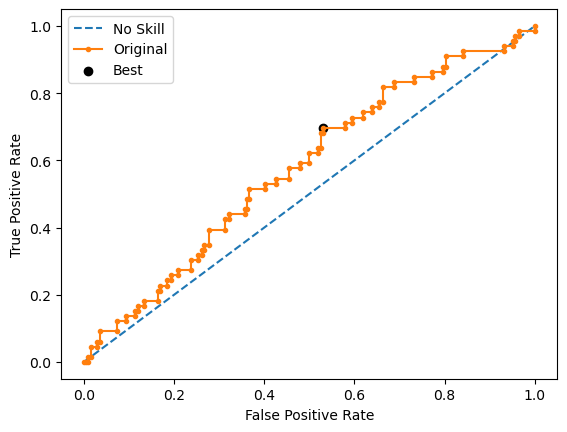

Run 3 - Random State: 2
Test G-mean: 0.6074840769027358
Best Threshold=0.503476, G-Mean=0.619


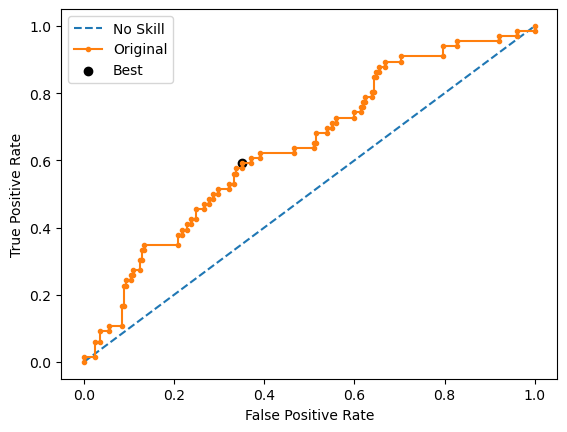

Run 4 - Random State: 3
Test G-mean: 0.6500132704223603
Best Threshold=0.508920, G-Mean=0.665


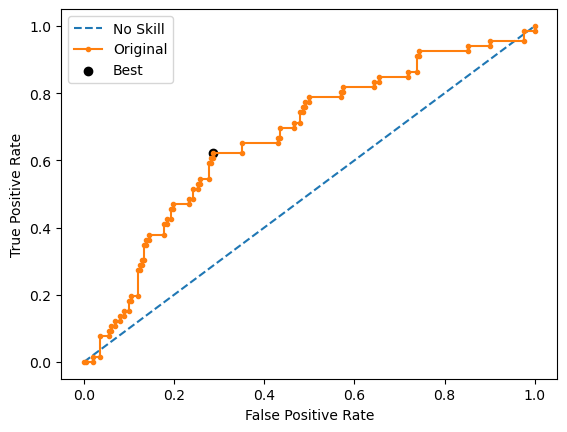

Run 5 - Random State: 4
Test G-mean: 0.584452015494721
Best Threshold=0.476340, G-Mean=0.612


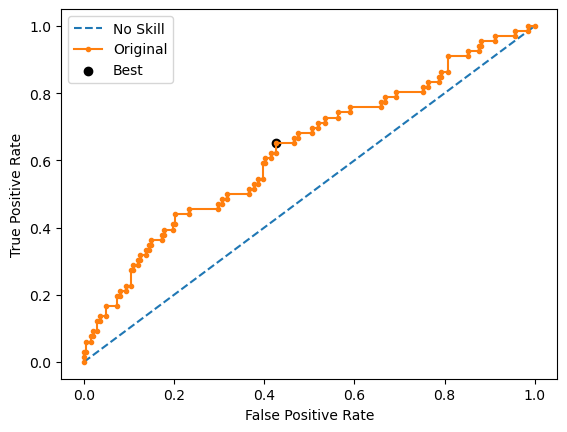

Ave Test G-mean: 0.6104552042724991
Stdev Test G-mean: 0.037944438240259996
Ave Test Specificity: 0.6425742574257426
Ave Test Recall: 0.5818181818181818
Ave Test NPV: 0.8247886757374111
Ave Test Accuracy: 0.6276119402985074
Ave Test Precision: 0.3476870659658312
Ave Test F1-Score: 0.43474440191841524
Ave Runtime: 0.5993012905120849


In [262]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6925932	total: 3.02ms	remaining: 3.01s
1:	learn: 0.6915944	total: 5.72ms	remaining: 2.85s
2:	learn: 0.6907981	total: 8.29ms	remaining: 2.75s
3:	learn: 0.6899970	total: 11ms	remaining: 2.73s
4:	learn: 0.6889704	total: 13.6ms	remaining: 2.7s
5:	learn: 0.6878691	total: 16.1ms	remaining: 2.67s
6:	learn: 0.6866138	total: 18.7ms	remaining: 2.65s
7:	learn: 0.6859139	total: 21ms	remaining: 2.6s
8:	learn: 0.6848884	total: 23.4ms	remaining: 2.58s
9:	learn: 0.6836013	total: 25.9ms	remaining: 2.57s
10:	learn: 0.6821693	total: 28.7ms	remaining: 2.58s
11:	learn: 0.6817355	total: 31.1ms	remaining: 2.56s
12:	learn: 0.6805076	total: 33.5ms	remaining: 2.54s
13:	learn: 0.6794318	total: 36.1ms	remaining: 2.54s
14:	learn: 0.6788873	total: 38.7ms	remaining: 2.54s
15:	learn: 0.6779862	total: 41.2ms	remaining: 2.53s
16:	learn: 0.6769858	total: 44.1ms	remaining: 2.55s
17:	learn: 0.6760934	total: 46.8ms	remain

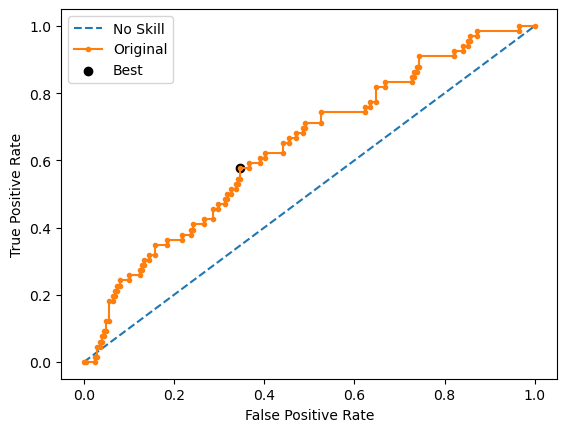

Learning rate set to 0.006922
0:	learn: 0.6917757	total: 3.66ms	remaining: 3.66s
1:	learn: 0.6907574	total: 6.14ms	remaining: 3.07s
2:	learn: 0.6899608	total: 8.73ms	remaining: 2.9s
3:	learn: 0.6885274	total: 11.5ms	remaining: 2.85s
4:	learn: 0.6877070	total: 14ms	remaining: 2.78s
5:	learn: 0.6868436	total: 16.6ms	remaining: 2.75s
6:	learn: 0.6854144	total: 19.1ms	remaining: 2.71s
7:	learn: 0.6841373	total: 21.5ms	remaining: 2.67s
8:	learn: 0.6827903	total: 24.1ms	remaining: 2.65s
9:	learn: 0.6816773	total: 26.5ms	remaining: 2.63s
10:	learn: 0.6802913	total: 28.8ms	remaining: 2.59s
11:	learn: 0.6790553	total: 31.4ms	remaining: 2.58s
12:	learn: 0.6782002	total: 33.9ms	remaining: 2.58s
13:	learn: 0.6771877	total: 36.5ms	remaining: 2.57s
14:	learn: 0.6758085	total: 38.8ms	remaining: 2.55s
15:	learn: 0.6743024	total: 41.4ms	remaining: 2.55s
16:	learn: 0.6727772	total: 44ms	remaining: 2.54s
17:	learn: 0.6723835	total: 46.3ms	remaining: 2.53s
18:	learn: 0.6711152	total: 48.9ms	remaining: 2.5

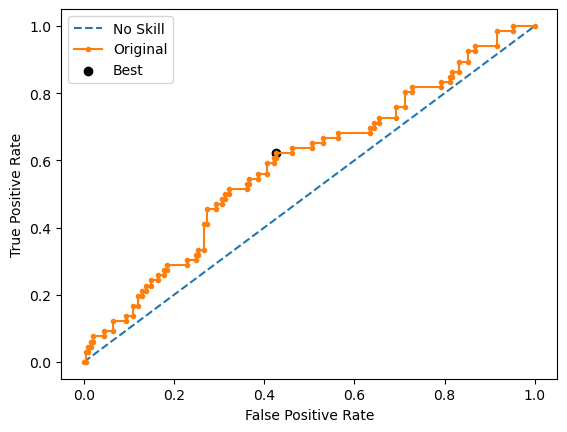

Learning rate set to 0.006922
0:	learn: 0.6915608	total: 2.64ms	remaining: 2.63s
1:	learn: 0.6891043	total: 5.35ms	remaining: 2.67s
2:	learn: 0.6877437	total: 7.9ms	remaining: 2.63s
3:	learn: 0.6859936	total: 10.4ms	remaining: 2.6s
4:	learn: 0.6848356	total: 13ms	remaining: 2.6s
5:	learn: 0.6837831	total: 15.4ms	remaining: 2.55s
6:	learn: 0.6822884	total: 17.7ms	remaining: 2.51s
7:	learn: 0.6811639	total: 20.1ms	remaining: 2.49s
8:	learn: 0.6797561	total: 22.7ms	remaining: 2.5s
9:	learn: 0.6786867	total: 25.2ms	remaining: 2.49s
10:	learn: 0.6777130	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6771724	total: 30.3ms	remaining: 2.5s
12:	learn: 0.6759269	total: 32.8ms	remaining: 2.49s
13:	learn: 0.6743493	total: 35.2ms	remaining: 2.48s
14:	learn: 0.6731938	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6728976	total: 40.4ms	remaining: 2.48s
16:	learn: 0.6712511	total: 43ms	remaining: 2.48s
17:	learn: 0.6699981	total: 45.4ms	remaining: 2.48s
18:	learn: 0.6688468	total: 47.8ms	remaining: 2.47s
1

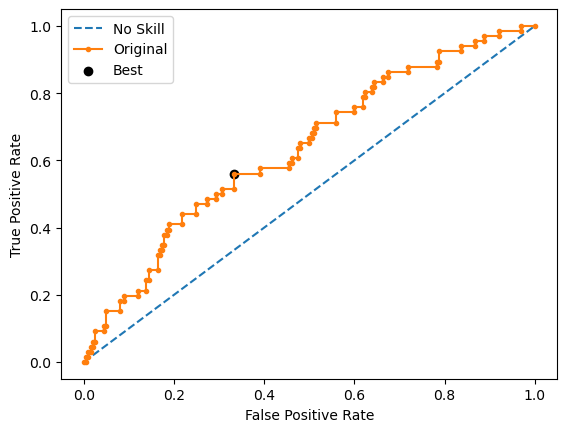

Learning rate set to 0.006922
0:	learn: 0.6922818	total: 2.8ms	remaining: 2.8s
1:	learn: 0.6910777	total: 5.41ms	remaining: 2.7s
2:	learn: 0.6898807	total: 7.77ms	remaining: 2.58s
3:	learn: 0.6889244	total: 10.2ms	remaining: 2.53s
4:	learn: 0.6879907	total: 12.7ms	remaining: 2.52s
5:	learn: 0.6867908	total: 15ms	remaining: 2.49s
6:	learn: 0.6857551	total: 17.5ms	remaining: 2.49s
7:	learn: 0.6846771	total: 19.9ms	remaining: 2.47s
8:	learn: 0.6838094	total: 22.2ms	remaining: 2.44s
9:	learn: 0.6831921	total: 24.7ms	remaining: 2.44s
10:	learn: 0.6820158	total: 27.1ms	remaining: 2.43s
11:	learn: 0.6807095	total: 29.7ms	remaining: 2.44s
12:	learn: 0.6797208	total: 32.3ms	remaining: 2.45s
13:	learn: 0.6781180	total: 34.9ms	remaining: 2.45s
14:	learn: 0.6774925	total: 37.1ms	remaining: 2.44s
15:	learn: 0.6767942	total: 39.8ms	remaining: 2.44s
16:	learn: 0.6758322	total: 42.1ms	remaining: 2.43s
17:	learn: 0.6749166	total: 44.5ms	remaining: 2.43s
18:	learn: 0.6740625	total: 46.8ms	remaining: 2.4

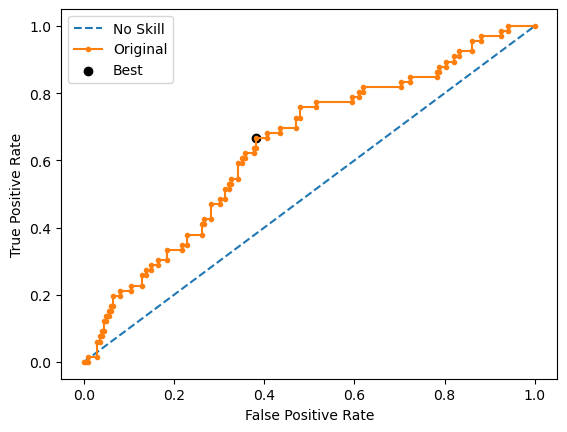

Learning rate set to 0.006922
0:	learn: 0.6918770	total: 3.03ms	remaining: 3.03s
1:	learn: 0.6908344	total: 5.73ms	remaining: 2.86s
2:	learn: 0.6898347	total: 8.16ms	remaining: 2.71s
3:	learn: 0.6889398	total: 10.7ms	remaining: 2.66s
4:	learn: 0.6877485	total: 13.2ms	remaining: 2.62s
5:	learn: 0.6863435	total: 15.8ms	remaining: 2.61s
6:	learn: 0.6851576	total: 18.2ms	remaining: 2.59s
7:	learn: 0.6840617	total: 20.7ms	remaining: 2.56s
8:	learn: 0.6824181	total: 22.9ms	remaining: 2.53s
9:	learn: 0.6812613	total: 25.4ms	remaining: 2.51s
10:	learn: 0.6794770	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6782449	total: 30.3ms	remaining: 2.49s
12:	learn: 0.6774971	total: 32.9ms	remaining: 2.5s
13:	learn: 0.6764224	total: 35.4ms	remaining: 2.49s
14:	learn: 0.6747983	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6737534	total: 40.2ms	remaining: 2.47s
16:	learn: 0.6723031	total: 42.6ms	remaining: 2.46s
17:	learn: 0.6708492	total: 45.2ms	remaining: 2.47s
18:	learn: 0.6697755	total: 47.7ms	remaining:

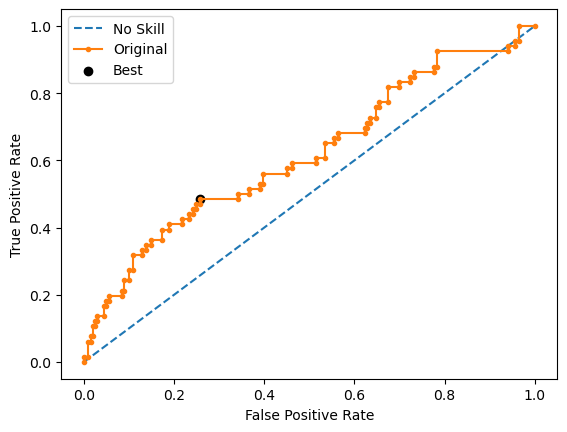

Ave Test G-mean: 0.5978506203204994
Stdev Test G-mean: 0.026702887539368426
Ave Test Specificity: 0.6227722772277228
Ave Test Recall: 0.5757575757575757
Ave Test NPV: 0.8185451642933618
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.33207704455584613
Ave Test F1-Score: 0.4209373515085228
Ave Runtime: 2.6942410469055176


In [263]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [264]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.624353,0.024813,0.594305,0.504684,0.619802,0.630303
6,LightGBM,0.621319,0.023230,0.592383,0.742028,0.615842,0.627273
4,Random Forest,0.610455,0.037944,0.601664,0.622726,0.642574,0.581818
2,Logistic Regression,0.583291,0.021799,0.602886,NaN,0.634653,0.539394
8,AdaBoost,0.575472,0.016975,0.602091,0.943659,0.621782,0.533333
7,Extreme Gradient Boosting (XGBoost),0.567127,0.032394,0.594776,0.850648,0.674257,0.478788
5,Gradient Boosting Machine (GBM),0.556493,0.031664,0.582053,0.882941,0.652475,0.475758
0,k-Nearest Neighbors,0.534328,0.029096,0.561630,0.688693,0.550495,0.527273
1,SVM Classifier,0.521486,0.026318,0.525757,0.252068,0.564356,0.487879


# HO-T08 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5966131815002639
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=3,
                                        max_features='log2', random_state=0))])
Mean Train Score (G-mean) 0.5520784197104317
Std Train Score (G-mean) 0.049809375846590453
GridSearchCV Runtime: 66.08575892448425 secs
Run 1 - Random State: 0
Test G-mean: 0.6547273224684294
Best Threshold=0.582692, G-Mean=0.663


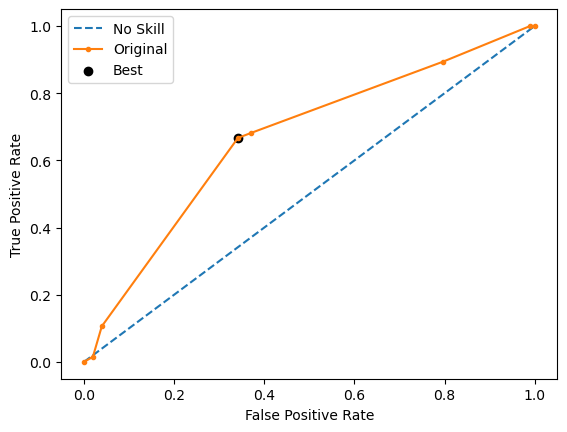

Run 2 - Random State: 1
Test G-mean: 0.596016378594041
Best Threshold=0.655556, G-Mean=0.596


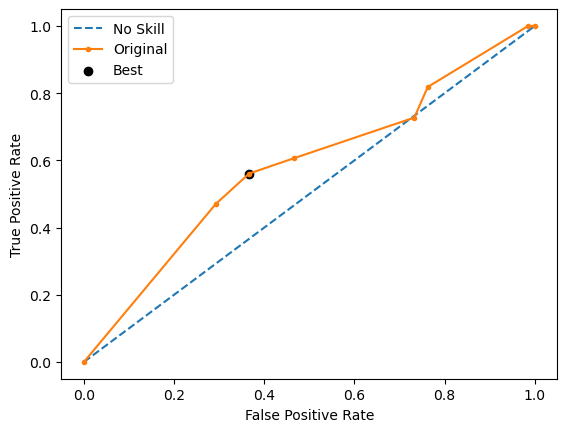

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.612648, G-Mean=0.587


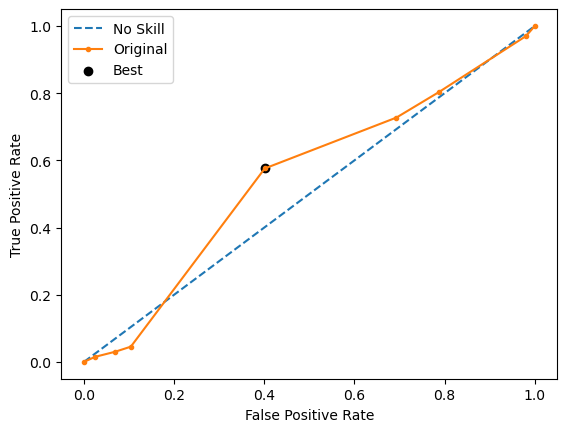

Run 4 - Random State: 3
Test G-mean: 0.6371346749780661
Best Threshold=0.592937, G-Mean=0.637


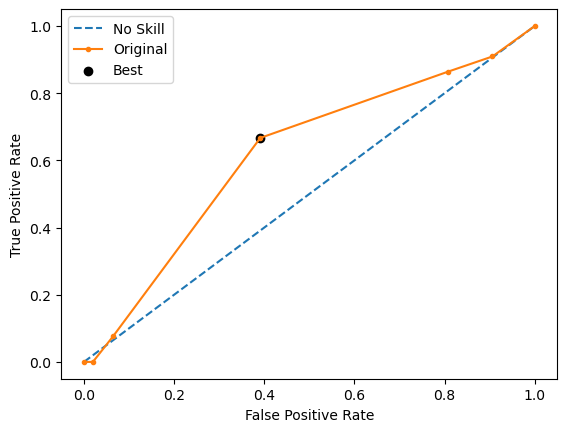

Run 5 - Random State: 4
Test G-mean: 0.5996548662321182
Best Threshold=0.564576, G-Mean=0.600


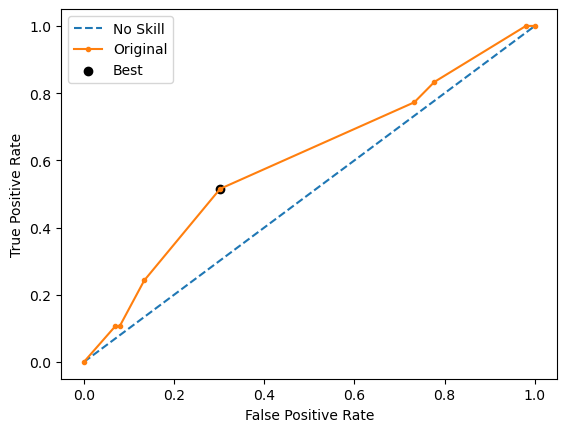

Ave Test G-mean: 0.6149603820603801
Stdev Test G-mean: 0.029296219567977642
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.5999999999999999
Ave Test NPV: 0.8297560066055503
Ave Test Accuracy: 0.6253731343283582
Ave Test Precision: 0.34865587570072953
Ave Test F1-Score: 0.4401459177307229
Ave Runtime: 0.025896835327148437


In [281]:
ho_t08_dt_gs, ho_t08_dt_be, ho_t08_dt_model_info, ho_t08_dt_metrics_df = dt_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 100.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6078975550078626
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=100.0, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 52.069857358932495 secs
Run 1 - Random State: 0
Test G-mean: 0.6188604841399094
Best Threshold=0.512718, G-Mean=0.634


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


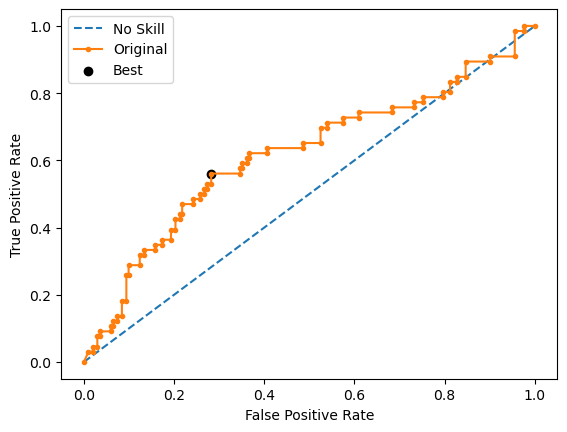

Run 2 - Random State: 1
Test G-mean: 0.5763099975892594
Best Threshold=0.494359, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


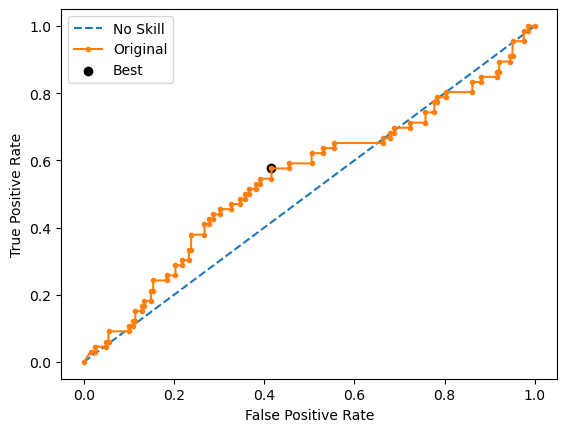

Run 3 - Random State: 2
Test G-mean: 0.6150307523064422
Best Threshold=0.499350, G-Mean=0.620


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


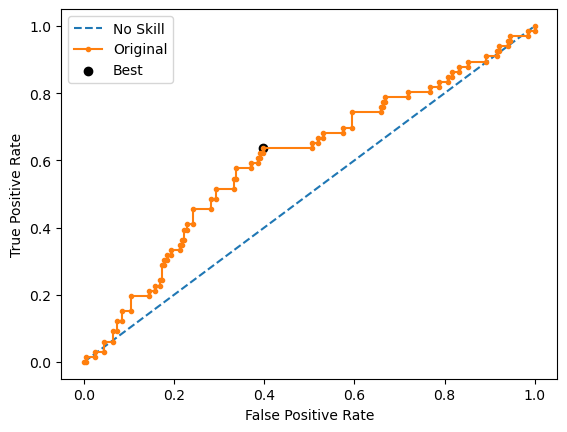

Run 4 - Random State: 3
Test G-mean: 0.5624781223868323
Best Threshold=0.497402, G-Mean=0.592


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


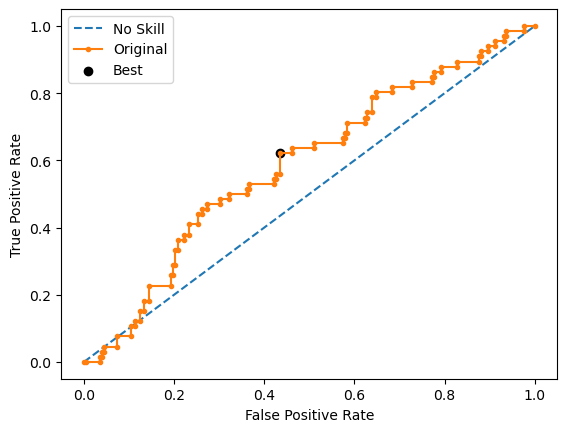

Run 5 - Random State: 4
Test G-mean: 0.560273496284684
Best Threshold=0.486683, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


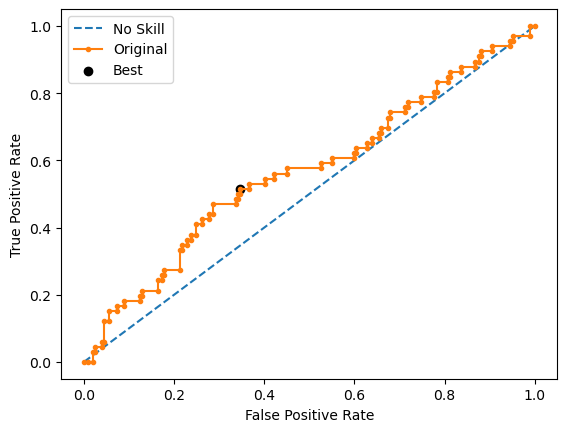

Ave Test G-mean: 0.5865905705414255
Stdev Test G-mean: 0.028416016593412613
Ave Test Specificity: 0.6267326732673267
Ave Test Recall: 0.5515151515151515
Ave Test NPV: 0.8105340798718748
Ave Test Accuracy: 0.6082089552238805
Ave Test Precision: 0.3266746618406295
Ave Test F1-Score: 0.4094494756438197
Ave Runtime: 0.369551420211792


In [282]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5271837717242484
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.25173061573833866
Std Train Score (G-mean) 0.05385039016863185
GridSearchCV Runtime: 118.15375328063965 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5470648297896689
Best Threshold=0.494878, G-Mean=0.567


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


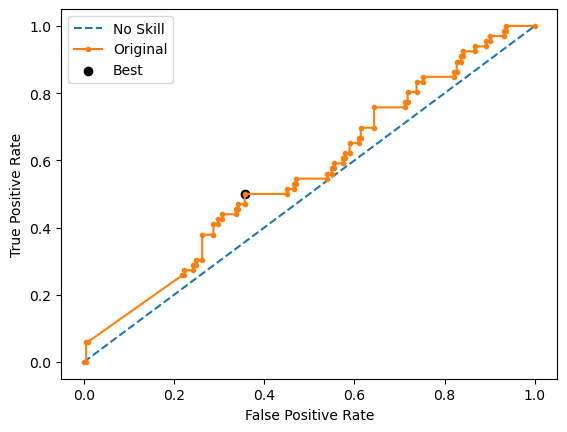

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.50714960324544
Best Threshold=0.521705, G-Mean=0.293


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


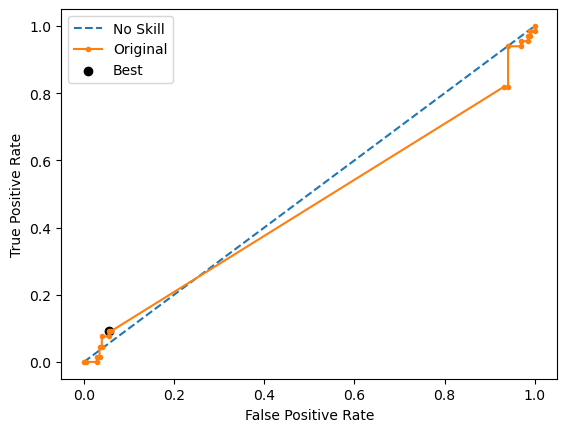

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.5199298344039033
Best Threshold=0.519037, G-Mean=0.401


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


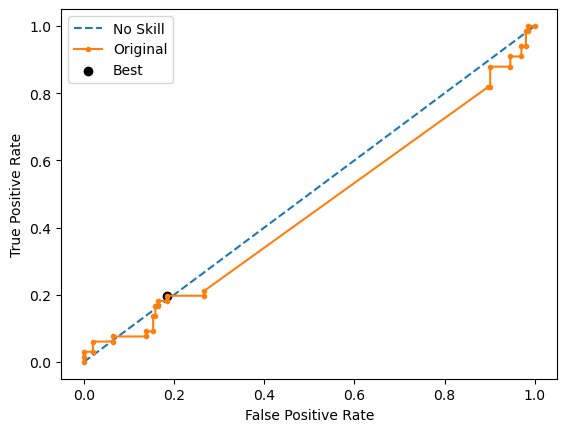

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.4756286600513327
Best Threshold=0.500000, G-Mean=0.118


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


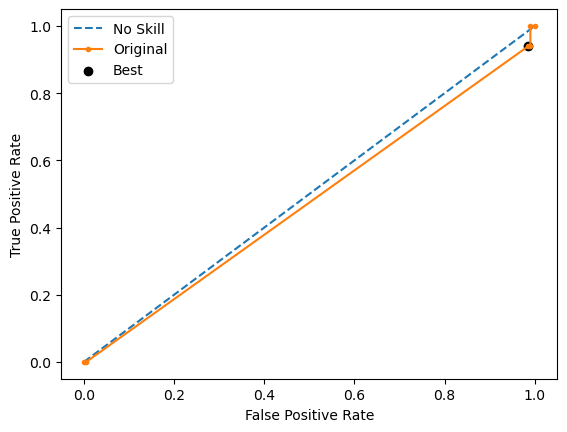

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5391929829915173
Best Threshold=0.493064, G-Mean=0.287


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


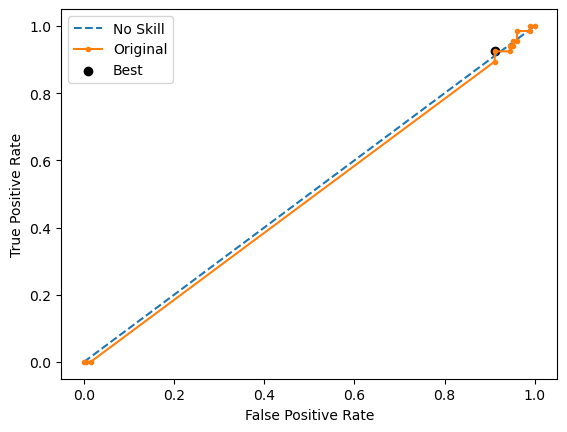

Ave Test G-mean: 0.5177931820963725
Stdev Test G-mean: 0.02833054363296901
Ave Test Specificity: 0.5900990099009901
Ave Test Recall: 0.45757575757575764
Ave Test NPV: 0.7689140185823027
Ave Test Accuracy: 0.5574626865671642
Ave Test Precision: 0.2680212057309454
Ave Test F1-Score: 0.3371681339390776
Ave Runtime: 0.060284757614135744


In [283]:
ho_t08_svm_gs, ho_t08_svm_be, ho_t08_svm_model_info, ho_t08_svm_metrics_df = svm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [284]:
ho_t08_knn_gs, ho_t08_knn_be, ho_t08_knn_model_info, ho_t08_knn_metrics_df = knn_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 3, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5594153075270116
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=3))])
Mean Train Score (G-mean) 0.686828076239181
Std Train Score (G-mean) 0.01544186972704155
GridSearchCV Runtime: 77.13261294364929 secs
Run 1 - Random State: 0
Test G-mean: 0.5682493209226677
Run 2 - Random State: 1
Test G-mean: 0.487004843273388
Run 3 - Random State: 2
Test G-mean: 0.5098048549190267
Run 4 - Random State: 3
Test G-mean: 0.4846116845975599
Run 5 - Random State: 4
Test G-mean: 0.5447289903863175
Ave Test G-mean: 0.5188799388197919
Stdev Test G-mean: 0.036668111034816334
Ave Test Specificity: 0.4851

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5965566786253891
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7460883092264341
Std Train Score (G-mean) 0.01766791496110193
GridSearchCV Runtime: 38.253618001937866 secs
Run 1 - Random State: 0
Test G-mean: 0.6575281243592797
Best Threshold=0.526146, G-Mean=0.684


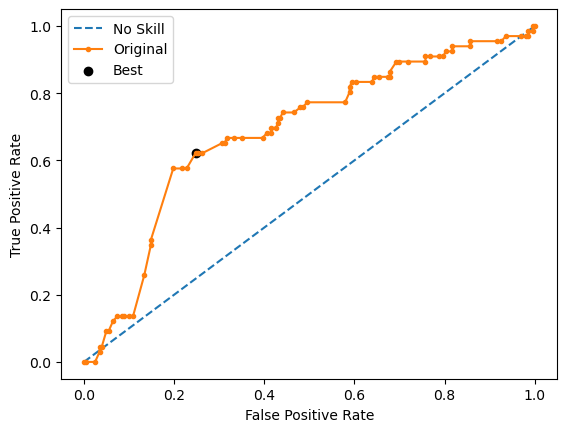

Run 2 - Random State: 1
Test G-mean: 0.6247111543766769
Best Threshold=0.507078, G-Mean=0.632


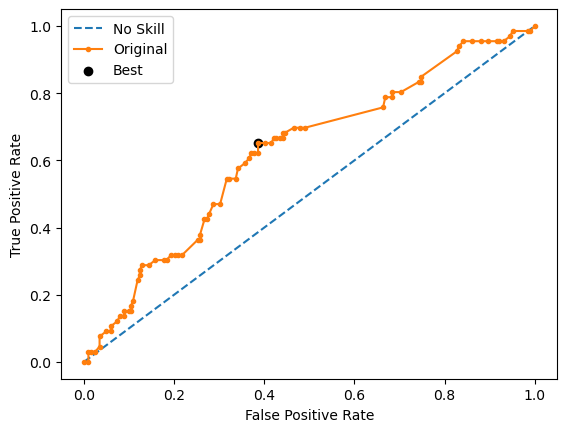

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.533153, G-Mean=0.587


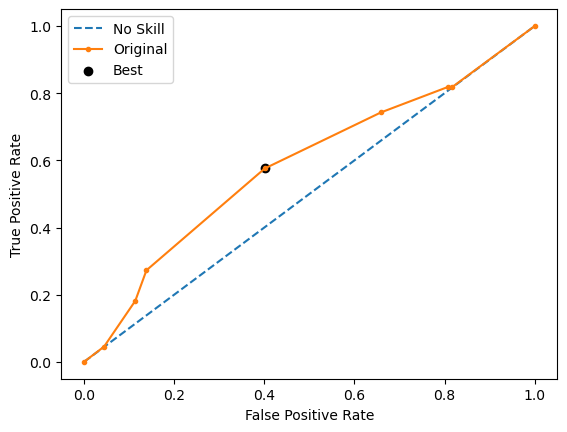

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.503032, G-Mean=0.663


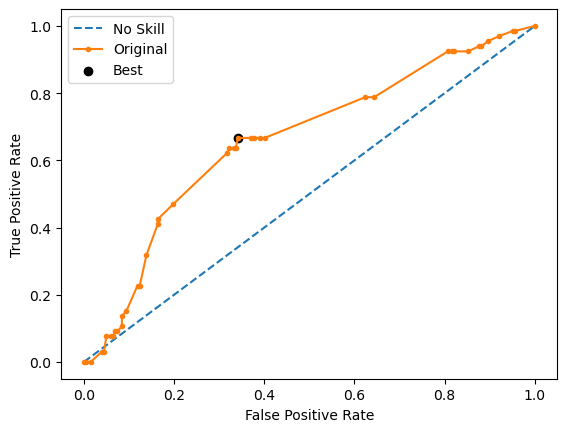

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


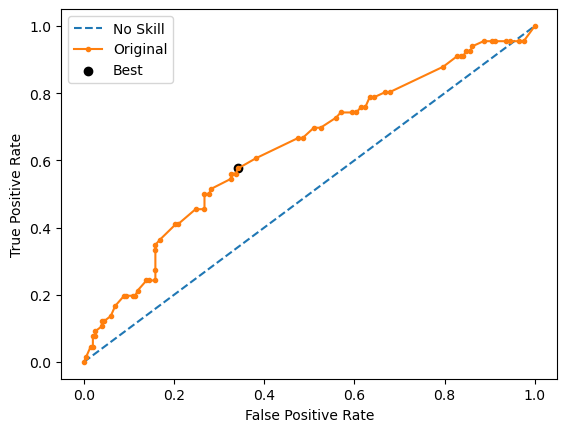

Ave Test G-mean: 0.6258645414318889
Stdev Test G-mean: 0.02801359494945503
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.6333333333333333
Ave Test NPV: 0.8377462055684683
Ave Test Accuracy: 0.6223880597014925
Ave Test Precision: 0.3520677722666008
Ave Test F1-Score: 0.4524928761366155
Ave Runtime: 0.36489238739013674


In [285]:
ho_t08_lgbm_gs, ho_t08_lgbm_be, ho_t08_lgbm_model_info, ho_t08_lgbm_metrics_df = lgbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5684631509057696
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9439618467435441
Std Train Score (G-mean) 0.004924049647730128
GridSearchCV Runtime: 10.690007209777832 secs
Run 1 - Random State: 0
Test G-mean: 0.6150307523064422
Best Threshold=0.731059, G-Mean=0.615


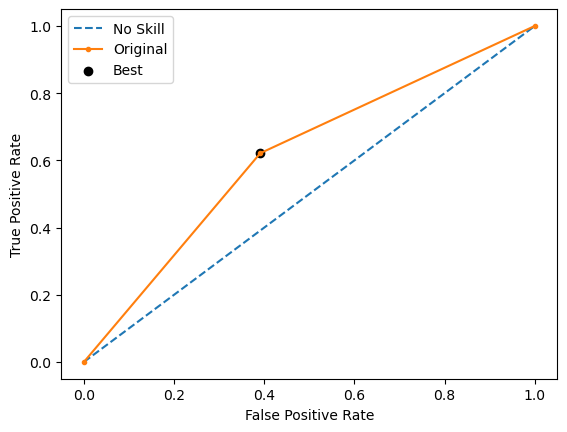

Run 2 - Random State: 1
Test G-mean: 0.5866297072611855
Best Threshold=0.731059, G-Mean=0.587


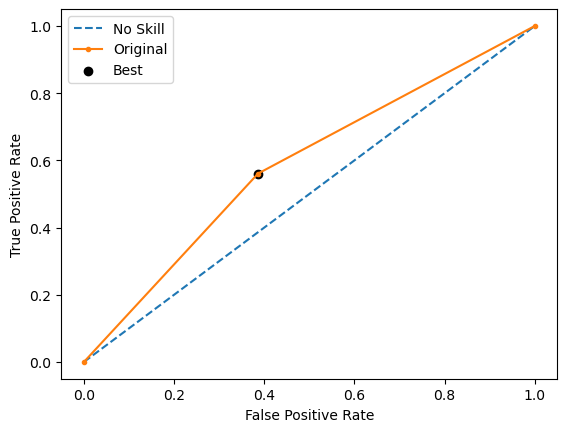

Run 3 - Random State: 2
Test G-mean: 0.5705546014671388
Best Threshold=0.731059, G-Mean=0.571


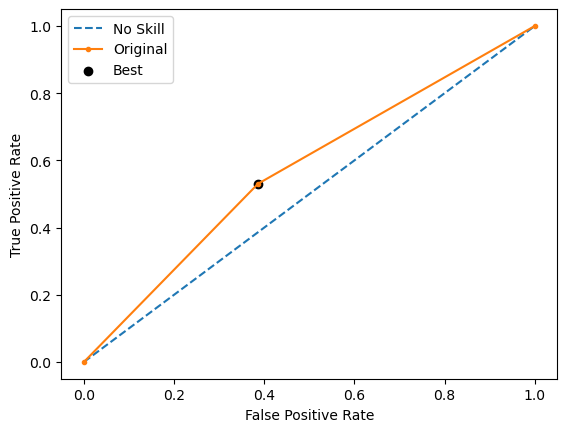

Run 4 - Random State: 3
Test G-mean: 0.5945042838654349
Best Threshold=0.731059, G-Mean=0.595


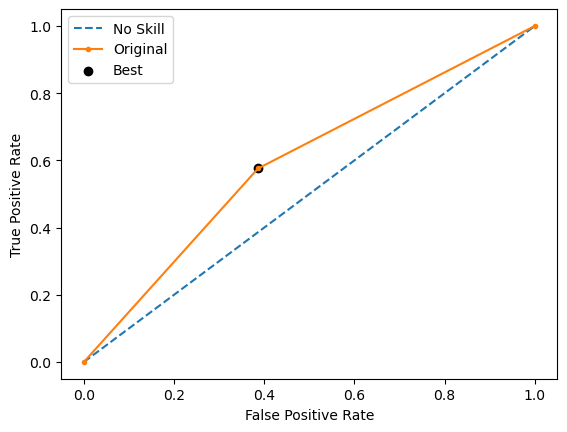

Run 5 - Random State: 4
Test G-mean: 0.5841952827718153
Best Threshold=0.731059, G-Mean=0.584


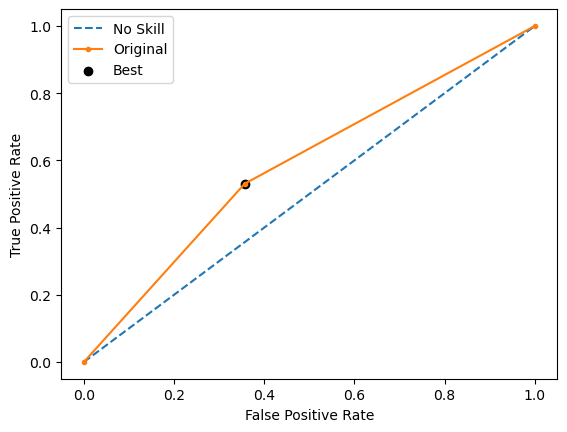

Ave Test G-mean: 0.5901829255344033
Stdev Test G-mean: 0.01635418115312937
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.5636363636363636
Ave Test NPV: 0.812956297450846
Ave Test Accuracy: 0.6052238805970149
Ave Test Precision: 0.325565864202131
Ave Test F1-Score: 0.41259362832246393
Ave Runtime: 0.24993081092834474


In [286]:
ho_t08_adaboost_gs, ho_t08_adaboost_be, ho_t08_adaboost_model_info, ho_t08_adaboost_metrics_df = adaboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5554183683577887
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8739859712005135
Std Train Score (G-mean) 0.010264201605379183
GridSearchCV Runtime: 95.3643696308136 secs
Run 1 - Random State: 0
Test G-mean: 0.5705546014671388
Best Threshold=0.317432, G-Mean=0.606


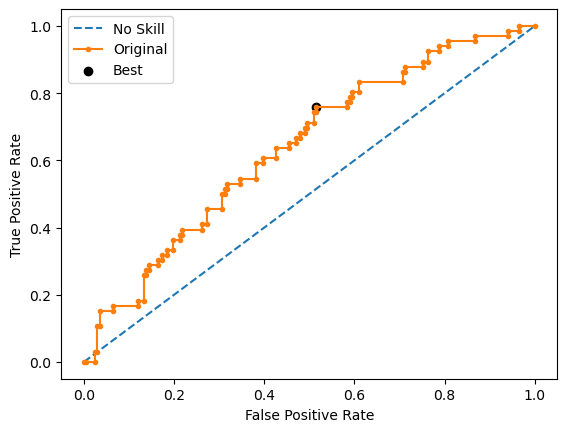

Run 2 - Random State: 1
Test G-mean: 0.5412756210377417
Best Threshold=0.352152, G-Mean=0.557


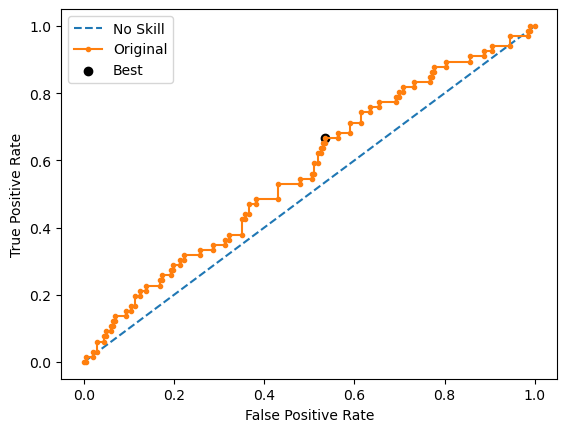

Run 3 - Random State: 2
Test G-mean: 0.5997174051973226
Best Threshold=0.461918, G-Mean=0.606


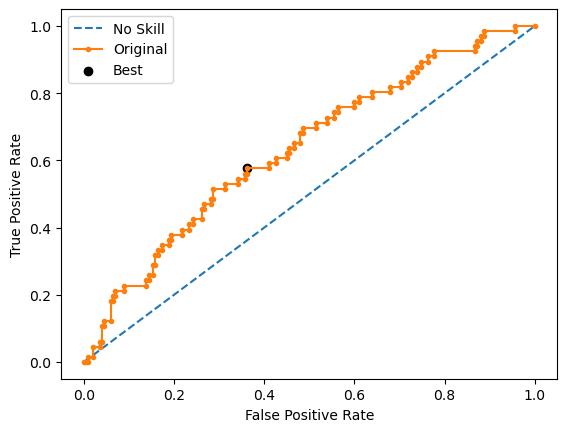

Run 4 - Random State: 3
Test G-mean: 0.5285148368714726
Best Threshold=0.386964, G-Mean=0.562


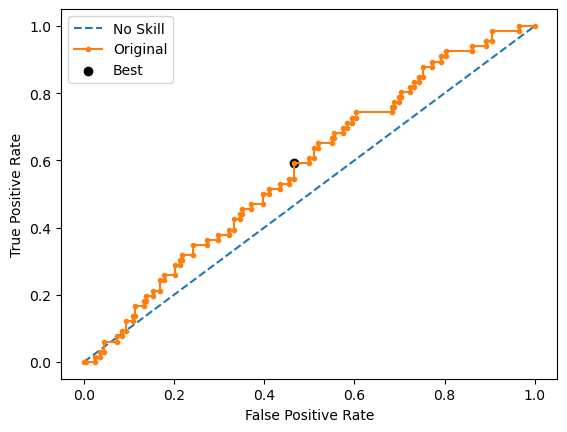

Run 5 - Random State: 4
Test G-mean: 0.5632776652529525
Best Threshold=0.553565, G-Mean=0.575


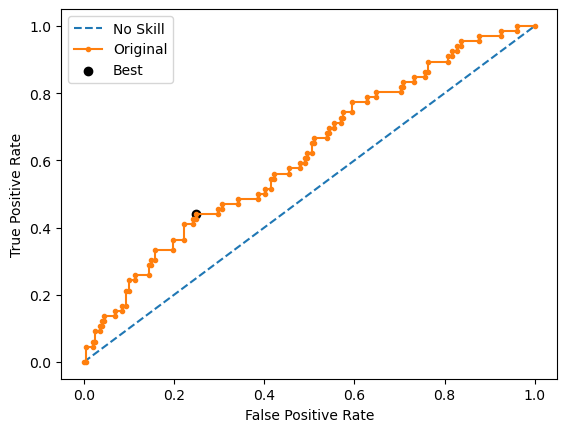

Ave Test G-mean: 0.5606680259653257
Stdev Test G-mean: 0.02756493038513496
Ave Test Specificity: 0.6702970297029702
Ave Test Recall: 0.4696969696969697
Ave Test NPV: 0.7944945666795336
Ave Test Accuracy: 0.6208955223880597
Ave Test Precision: 0.31827661659726403
Ave Test F1-Score: 0.37914584882009894
Ave Runtime: 0.4677495002746582


In [287]:
ho_t08_gbm_gs, ho_t08_gbm_be, ho_t08_gbm_model_info, ho_t08_gbm_metrics_df = gbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5948596762089723
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_t

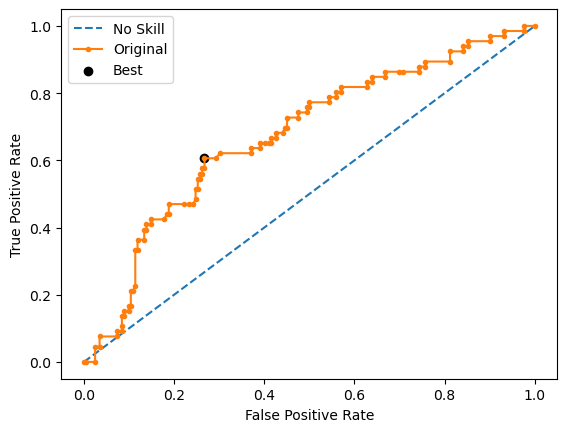

Run 2 - Random State: 1
Test G-mean: 0.5841952827718153
Best Threshold=0.457776, G-Mean=0.616


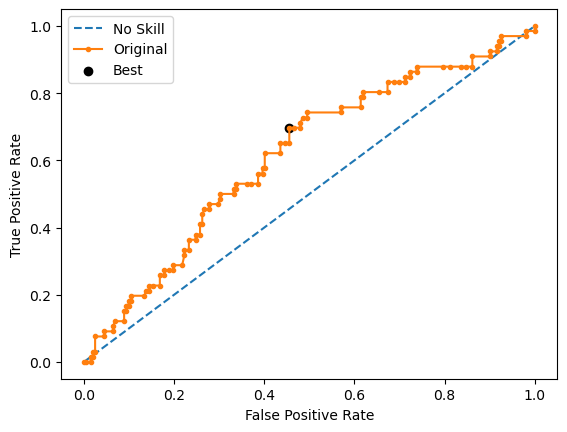

Run 3 - Random State: 2
Test G-mean: 0.6063718072905993
Best Threshold=0.508422, G-Mean=0.616


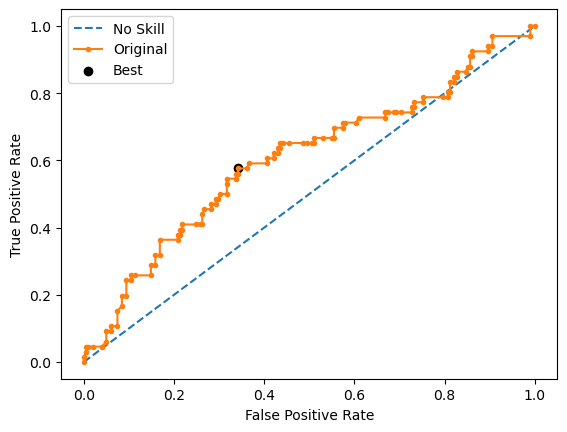

Run 4 - Random State: 3
Test G-mean: 0.644334165361162
Best Threshold=0.497775, G-Mean=0.648


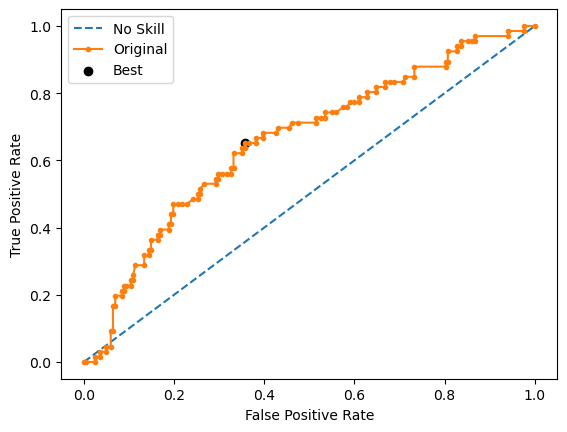

Run 5 - Random State: 4
Test G-mean: 0.6275263970048541
Best Threshold=0.484426, G-Mean=0.635


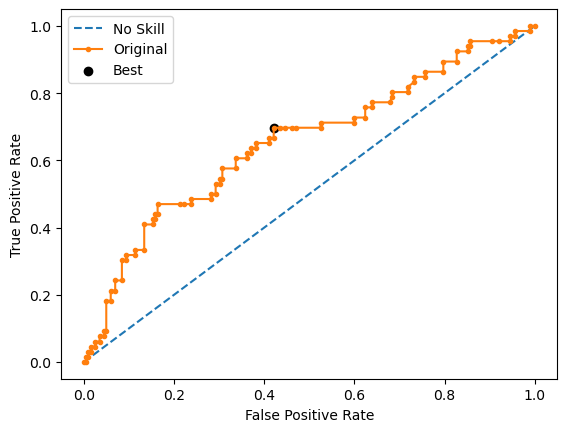

Ave Test G-mean: 0.6218287675230231
Stdev Test G-mean: 0.02652138884785633
Ave Test Specificity: 0.6485148514851485
Ave Test Recall: 0.5969696969696969
Ave Test NPV: 0.8313012276991074
Ave Test Accuracy: 0.6358208955223881
Ave Test Precision: 0.3570387044548672
Ave Test F1-Score: 0.4466619339413196
Ave Runtime: 0.19590449333190918


In [288]:
ho_t08_xgb_gs, ho_t08_xgb_be, ho_t08_xgb_model_info, ho_t08_xgb_metrics_df = xgb_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6919902	total: 1.94ms	remaining: 1.93s
1:	learn: 0.6910596	total: 3.72ms	remaining: 1.85s
2:	learn: 0.6904154	total: 5.02ms	remaining: 1.67s
3:	learn: 0.6893298	total: 6.74ms	remaining: 1.68s
4:	learn: 0.6880167	total: 8.41ms	remaining: 1.67s
5:	learn: 0.6868941	total: 10.1ms	remaining: 1.67s
6:	learn: 0.6859046	total: 11.8ms	remaining: 1.67s
7:	learn: 0.6851172	total: 13.5ms	remaining: 1.67s
8:	learn: 0.6846377	total: 15.1ms	remaining: 1.66s
9:	learn: 0.6838396	total: 16.9ms	remaining: 1.67s
10:	learn: 0.6830388	total: 18.6ms	remaining: 1.67s
11:	learn: 0.6817997	total: 20.5ms	remaining: 1.68s
12:	learn: 0.6811250	total: 22.1ms	remaining: 1.68s
13:	learn: 0.6803405	total: 23.6ms	remaining: 1.66s
14:	learn: 0.6795190	total: 25.3ms	remaining: 1.66s
15:	learn: 0.6786109	total: 27ms	remaining: 1.66s
16:	learn: 0.6777963	total: 28.6ms	remaining: 1.66s
17:	learn: 0.6776718	total: 29.4ms	re

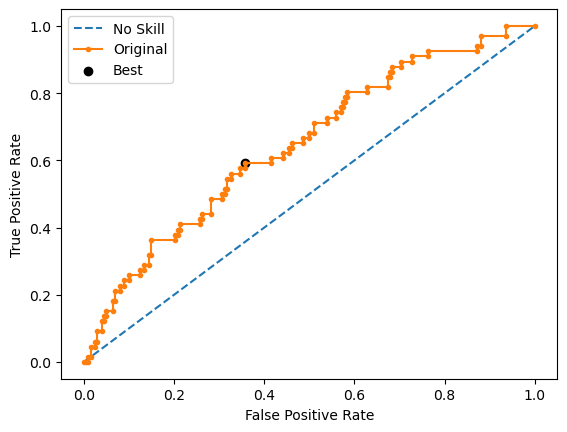

Learning rate set to 0.006922
0:	learn: 0.6914947	total: 2.43ms	remaining: 2.43s
1:	learn: 0.6902797	total: 5.23ms	remaining: 2.61s
2:	learn: 0.6895612	total: 8.84ms	remaining: 2.94s
3:	learn: 0.6881041	total: 12.1ms	remaining: 3s
4:	learn: 0.6871697	total: 15.5ms	remaining: 3.09s
5:	learn: 0.6860296	total: 18.7ms	remaining: 3.09s
6:	learn: 0.6848762	total: 22.1ms	remaining: 3.13s
7:	learn: 0.6838265	total: 24.8ms	remaining: 3.07s
8:	learn: 0.6823009	total: 27.5ms	remaining: 3.02s
9:	learn: 0.6812723	total: 30ms	remaining: 2.97s
10:	learn: 0.6799702	total: 32.4ms	remaining: 2.92s
11:	learn: 0.6782471	total: 35.1ms	remaining: 2.89s
12:	learn: 0.6767136	total: 37.2ms	remaining: 2.82s
13:	learn: 0.6753772	total: 39.3ms	remaining: 2.77s
14:	learn: 0.6740560	total: 41.1ms	remaining: 2.7s
15:	learn: 0.6733935	total: 43ms	remaining: 2.65s
16:	learn: 0.6724746	total: 44.9ms	remaining: 2.6s
17:	learn: 0.6715246	total: 46.9ms	remaining: 2.56s
18:	learn: 0.6703512	total: 48.7ms	remaining: 2.52s
1

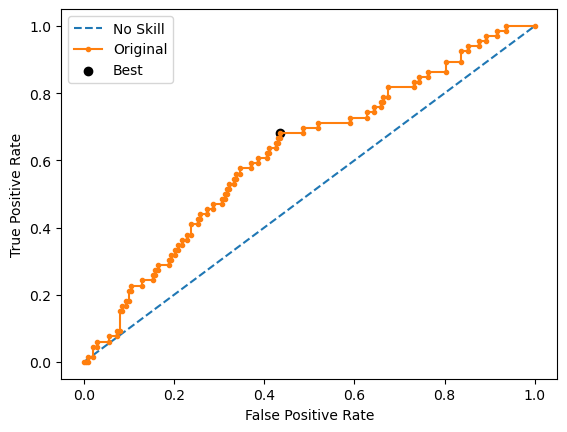

Learning rate set to 0.006922
0:	learn: 0.6916007	total: 2.8ms	remaining: 2.79s
1:	learn: 0.6906099	total: 4.75ms	remaining: 2.37s
2:	learn: 0.6896611	total: 6.39ms	remaining: 2.12s
3:	learn: 0.6885565	total: 8.21ms	remaining: 2.04s
4:	learn: 0.6874643	total: 9.97ms	remaining: 1.98s
5:	learn: 0.6855903	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6845379	total: 14.1ms	remaining: 2s
7:	learn: 0.6830962	total: 16ms	remaining: 1.99s
8:	learn: 0.6819924	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6802917	total: 19.7ms	remaining: 1.95s
10:	learn: 0.6793248	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6779212	total: 23ms	remaining: 1.9s
12:	learn: 0.6760875	total: 24.7ms	remaining: 1.87s
13:	learn: 0.6749760	total: 26.3ms	remaining: 1.85s
14:	learn: 0.6737902	total: 27.8ms	remaining: 1.83s
15:	learn: 0.6727685	total: 29.6ms	remaining: 1.82s
16:	learn: 0.6716598	total: 31.3ms	remaining: 1.81s
17:	learn: 0.6705489	total: 32.8ms	remaining: 1.79s
18:	learn: 0.6692961	total: 34.5ms	remaining: 1.78s
1

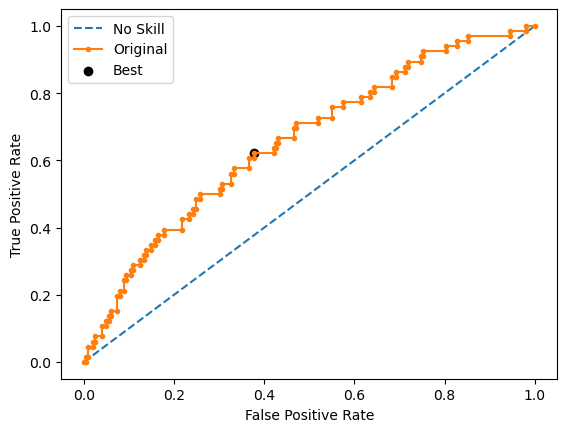

Learning rate set to 0.006922
0:	learn: 0.6921436	total: 2.39ms	remaining: 2.39s
1:	learn: 0.6907547	total: 4.16ms	remaining: 2.07s
2:	learn: 0.6900516	total: 6ms	remaining: 2s
3:	learn: 0.6892551	total: 7.88ms	remaining: 1.96s
4:	learn: 0.6882943	total: 9.63ms	remaining: 1.92s
5:	learn: 0.6872237	total: 11.4ms	remaining: 1.9s
6:	learn: 0.6865761	total: 13ms	remaining: 1.84s
7:	learn: 0.6848859	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6838586	total: 16.3ms	remaining: 1.79s
9:	learn: 0.6831848	total: 17.9ms	remaining: 1.77s
10:	learn: 0.6820082	total: 19.5ms	remaining: 1.76s
11:	learn: 0.6806971	total: 21.2ms	remaining: 1.74s
12:	learn: 0.6795370	total: 22.8ms	remaining: 1.73s
13:	learn: 0.6787919	total: 24.5ms	remaining: 1.73s
14:	learn: 0.6776370	total: 26.1ms	remaining: 1.71s
15:	learn: 0.6763227	total: 27.8ms	remaining: 1.71s
16:	learn: 0.6756414	total: 29.4ms	remaining: 1.7s
17:	learn: 0.6746330	total: 31.1ms	remaining: 1.7s
18:	learn: 0.6734429	total: 32.9ms	remaining: 1.7s
19:	

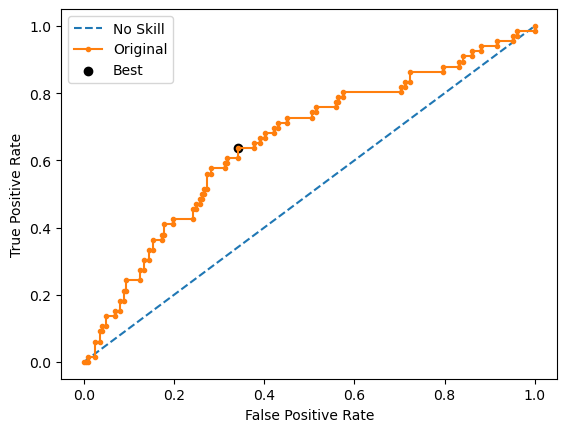

Learning rate set to 0.006922
0:	learn: 0.6914900	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6902983	total: 4.27ms	remaining: 2.13s
2:	learn: 0.6895627	total: 5.91ms	remaining: 1.96s
3:	learn: 0.6890878	total: 7.64ms	remaining: 1.9s
4:	learn: 0.6880513	total: 9.66ms	remaining: 1.92s
5:	learn: 0.6862832	total: 11.2ms	remaining: 1.85s
6:	learn: 0.6854552	total: 12.8ms	remaining: 1.82s
7:	learn: 0.6838742	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6822738	total: 16.2ms	remaining: 1.78s
9:	learn: 0.6812647	total: 17.7ms	remaining: 1.75s
10:	learn: 0.6803056	total: 19.3ms	remaining: 1.74s
11:	learn: 0.6787749	total: 20.9ms	remaining: 1.72s
12:	learn: 0.6771524	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6759314	total: 24.1ms	remaining: 1.7s
14:	learn: 0.6745352	total: 25.7ms	remaining: 1.69s
15:	learn: 0.6733417	total: 27.3ms	remaining: 1.68s
16:	learn: 0.6725769	total: 29.2ms	remaining: 1.69s
17:	learn: 0.6714911	total: 30.8ms	remaining: 1.68s
18:	learn: 0.6702564	total: 32.6ms	remaining: 

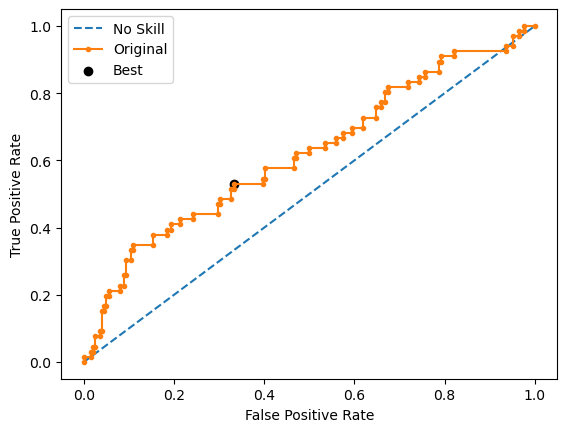

Ave Test G-mean: 0.6129672258498672
Stdev Test G-mean: 0.014948695302344868
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.593939393939394
Ave Test NPV: 0.8271293923959459
Ave Test Accuracy: 0.6238805970149255
Ave Test Precision: 0.3461636342354292
Ave Test F1-Score: 0.43716737663412797
Ave Runtime: 1.8529942512512207


In [289]:
ho_t08_catboost_gs, ho_t08_catboost_be, ho_t08_catboost_model_info, ho_t08_catboost_metrics_df = catboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6002747134052935
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6277561829255867
Std Train Score (G-mean) 0.01965083989099662
GridSearchCV Runtime: 363.1061005592346 secs
Run 1 - Random State: 0
Test G-mean: 0.6350120660526092
Best Threshold=0.515332, G-Mean=0.652


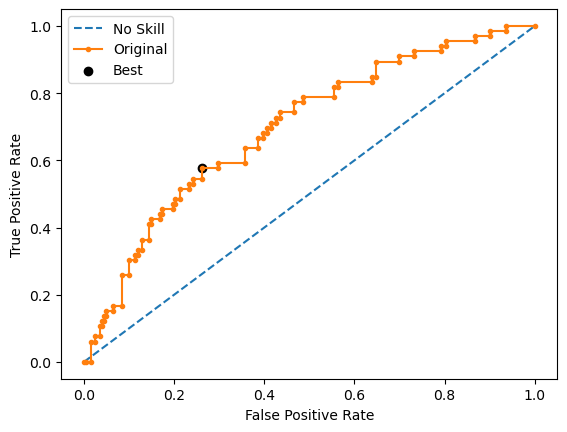

Run 2 - Random State: 1
Test G-mean: 0.5896904047696111
Best Threshold=0.498371, G-Mean=0.603


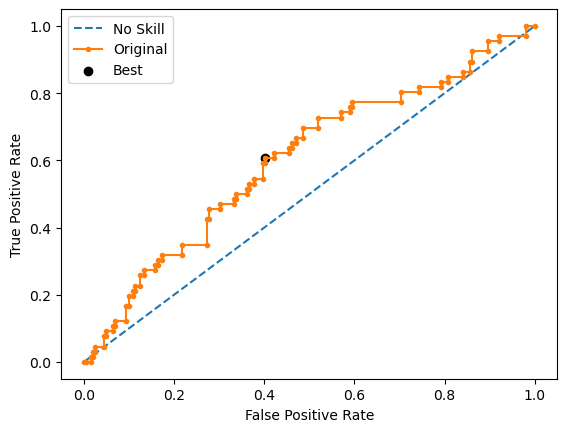

Run 3 - Random State: 2
Test G-mean: 0.5823949848615106
Best Threshold=0.523332, G-Mean=0.628


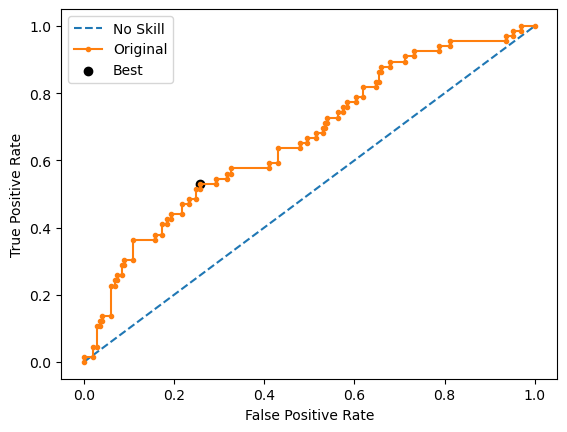

Run 4 - Random State: 3
Test G-mean: 0.659350797639189
Best Threshold=0.495704, G-Mean=0.668


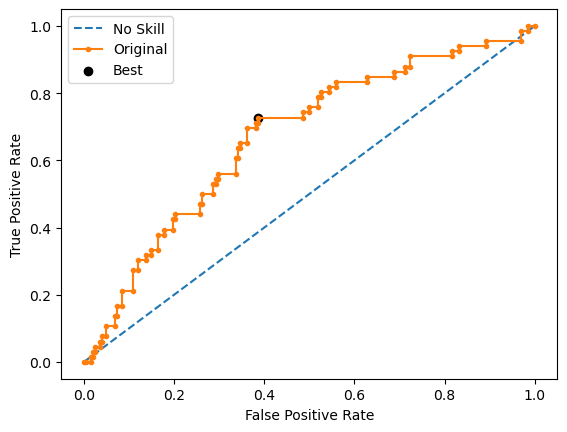

Run 5 - Random State: 4
Test G-mean: 0.5823305855706784
Best Threshold=0.536047, G-Mean=0.611


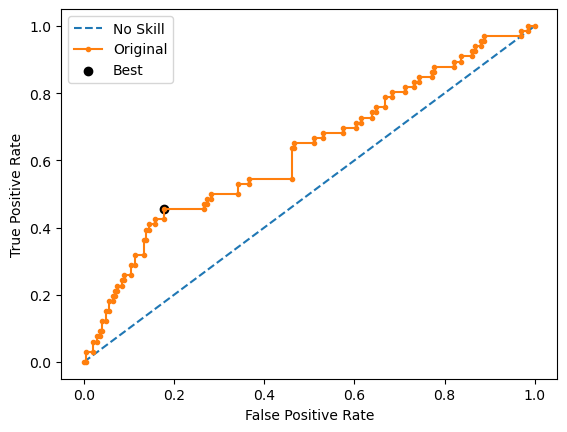

Ave Test G-mean: 0.6097557677787196
Stdev Test G-mean: 0.03535858963192227
Ave Test Specificity: 0.6257425742574257
Ave Test Recall: 0.596969696969697
Ave Test NPV: 0.8267716915172703
Ave Test Accuracy: 0.6186567164179105
Ave Test Precision: 0.3423872649609211
Ave Test F1-Score: 0.43455995572334
Ave Runtime: 0.5589699268341064


In [290]:
ho_t08_rf_gs, ho_t08_rf_be, ho_t08_rf_model_info, ho_t08_rf_metrics_df = rf_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [291]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t08_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t08_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t08_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
6,LightGBM,0.625865,0.028014,0.596557,0.746088,0.618812,0.633333
7,Extreme Gradient Boosting (XGBoost),0.621829,0.026521,0.594860,0.853936,0.648515,0.596970
3,Decision Tree,0.614960,0.029296,0.596613,0.552078,0.633663,0.600000
4,Random Forest,0.609756,0.035359,0.600275,0.627756,0.625743,0.596970
8,AdaBoost,0.590183,0.016354,0.568463,0.943962,0.618812,0.563636
2,Logistic Regression,0.586591,0.028416,0.607898,NaN,0.626733,0.551515
5,Gradient Boosting Machine (GBM),0.560668,0.027565,0.555418,0.873986,0.670297,0.469697
0,k-Nearest Neighbors,0.518880,0.036668,0.559415,0.686828,0.485149,0.557576
1,SVM Classifier,0.517793,0.028331,0.527184,0.251731,0.590099,0.457576


# HO-T07 Runs: Retain Top 30 Features

In [ ]:
model = ho_t07_logreg_be.named_steps['classifier']
coefficients = model.coef_[0]

# 3. Get Absolute Values of Coefficients
abs_coefficients = abs(coefficients)

# 4. Sort Features Based on Absolute Coefficient Values
sorted_idx = abs_coefficients.argsort()[::-1]
top_20_features = sorted_idx[:20]

# 5. Retain Only the Top 20 Features and Extract the Feature Names
feature_names = list(ho_t07_X_num.columns)  # Assuming X is a DataFrame before train-test split
top_20_feature_names = [feature_names[i] for i in top_20_features]

# Place all dropped features into a list
dropped_features = [feature for feature in feature_names if feature not in top_20_feature_names]

# 6. (Optional) Print the Top 20 Features and Dropped Features
print("Top 20 Features:", top_20_feature_names)
print("Dropped Features:", dropped_features)

sorted_indices = abs_coefficients.argsort()[::-1]
top_20_indices = sorted_indices[:20]
top_20_importances = coefficients[top_20_indices]
# Plot
plt.figure(figsize=(10, 8))
plt.barh(top_20_feature_names, top_20_importances, align='center')
plt.xlabel('Importance')
plt.title('Top 20 Feature Importances from Logistic Regression')
plt.gca().invert_yaxis()  # To display the feature with the highest importance at the top
plt.show()

ho_t08_full = ho_t07_full.copy()
ho_t08_logreg = ho_t08_full.copy().drop(columns=dropped_features).drop(['gender', 'province', 'job'], axis=1)

In [ ]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08_logreg, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


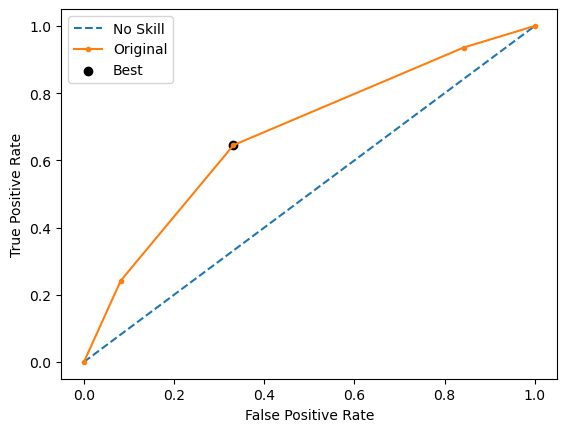

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


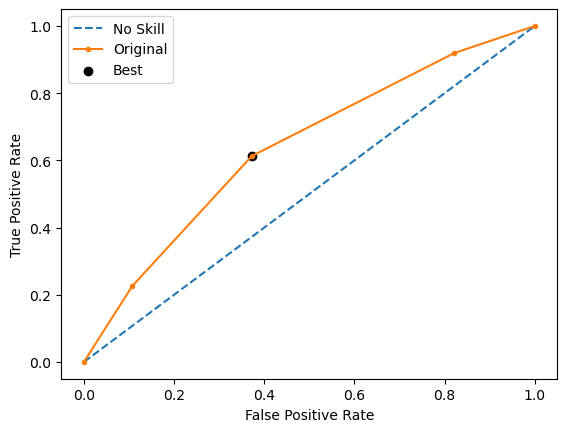

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


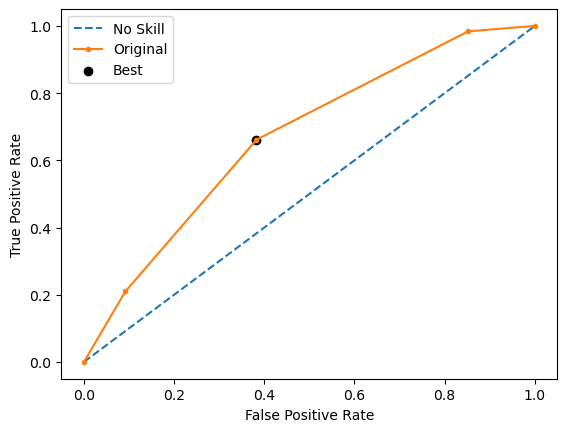

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


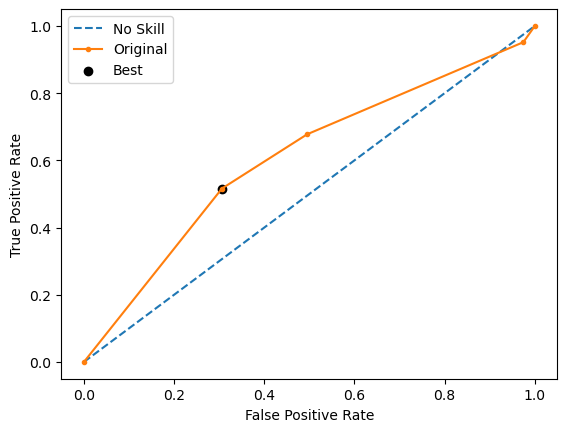

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


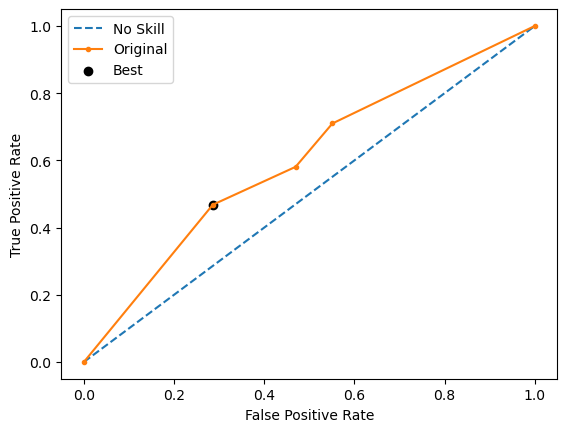

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

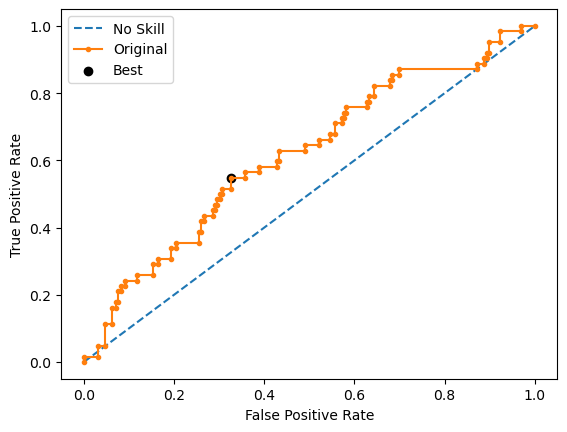

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


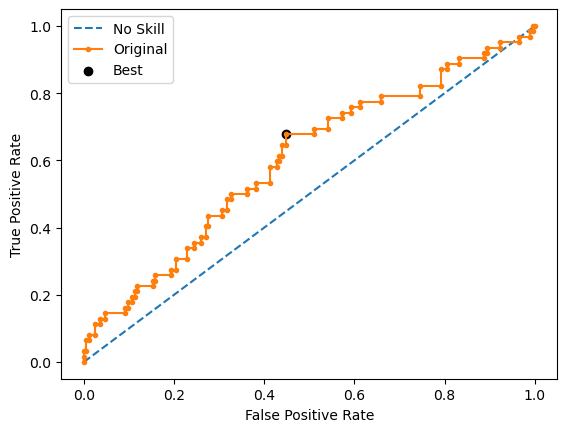

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


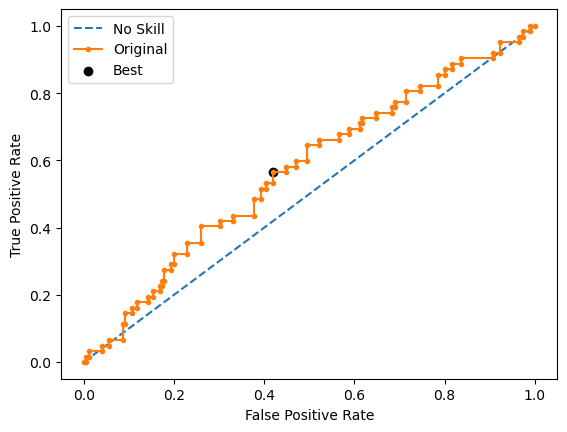

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


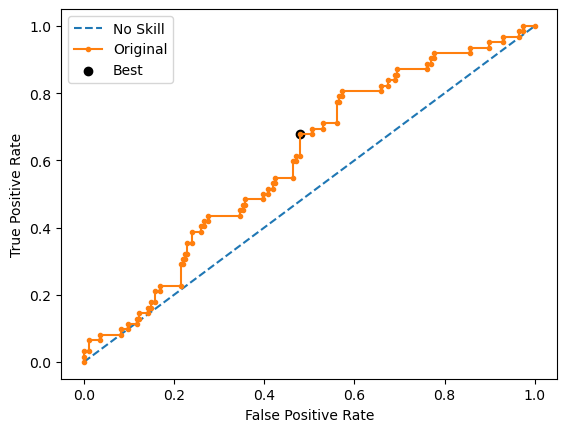

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


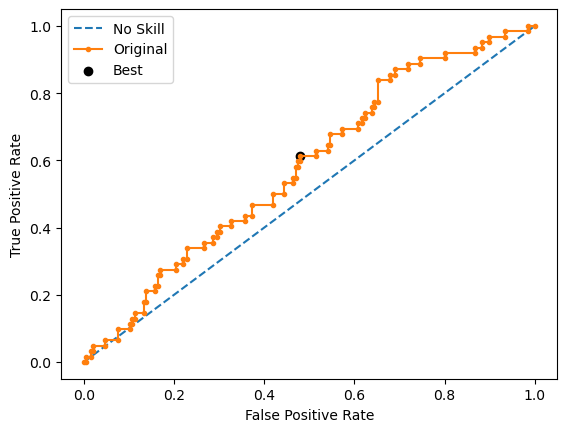

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


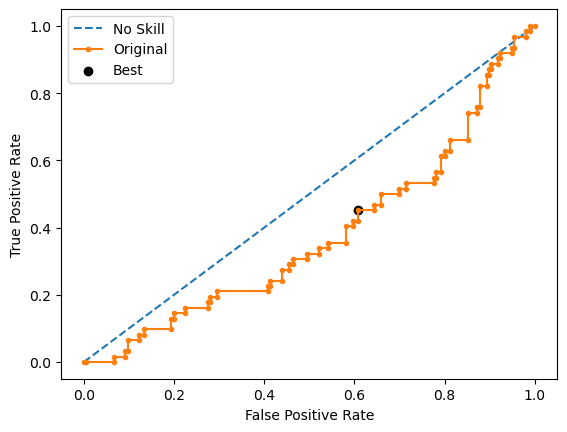

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


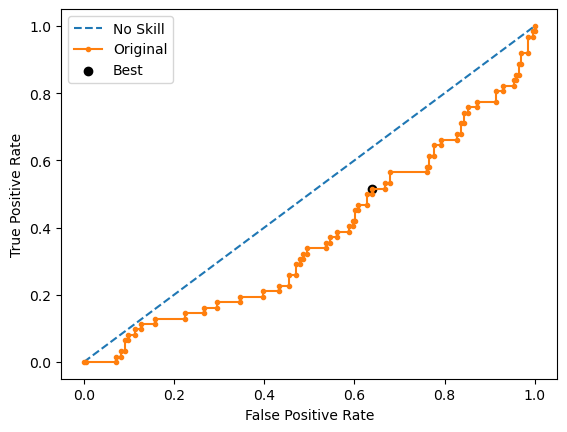

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


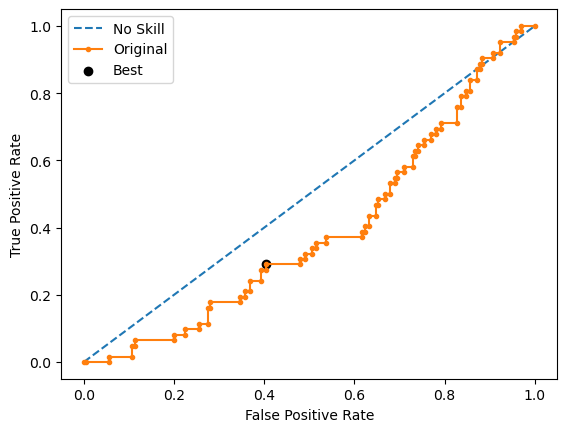

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


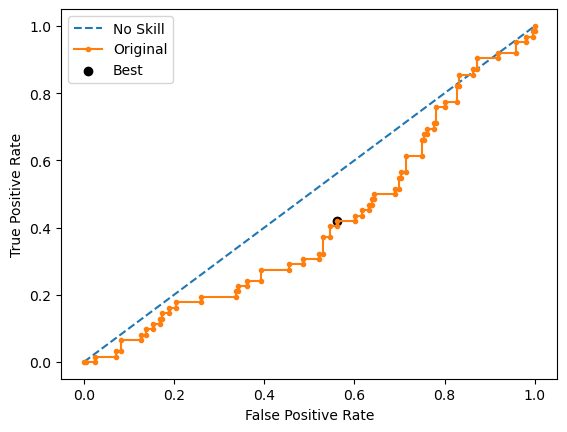

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


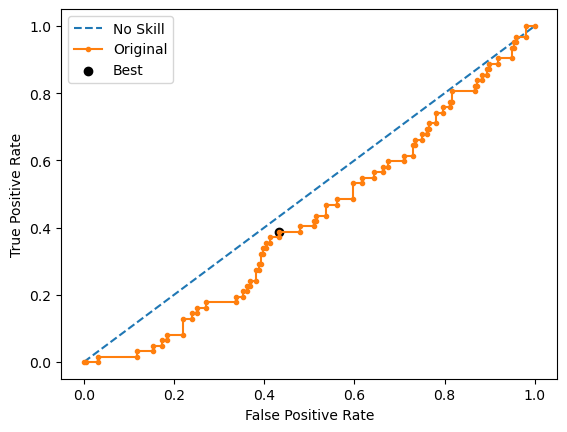

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

In [ ]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


In [ ]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# HO-T07 Runs

In [ ]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# Best Model Explainability Methods

In [301]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Access the trained Random Forest model from the dictionary
model = ho_t02_xgb_be.named_steps.classifier

# Ensure the model has been trained
if hasattr(model, "estimators_"):
    # Visualize the first tree
    plt.figure(figsize=(20, 10))
    plot_tree(model.estimators_[0], filled=True, feature_names=X_train.columns, class_names=True, rounded=True)
    plt.show()
else:
    print("The model hasn't been trained yet.")

The model hasn't been trained yet.


In [302]:
from sklearn.tree import _tree

def tree_rules(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            yield f"{indent}if {name} <= {threshold:.2f}:"
            yield from recurse(tree_.children_left[node], depth + 1)
            yield f"{indent}else:  # if {name} > {threshold:.2f}"
            yield from recurse(tree_.children_right[node], depth + 1)
        else:
            yield f"{indent}return Class {tree_.value[node].argmax()}"

    return "\n".join(recurse(0, 1))

In [303]:
model = ho_t02_xgb_be.named_steps.classifier
rules = tree_rules(model.estimators_[0], X_train.columns)
print(rules)

AttributeError: 'XGBClassifier' object has no attribute 'estimators_'

In [304]:
from xgboost import plot_tree

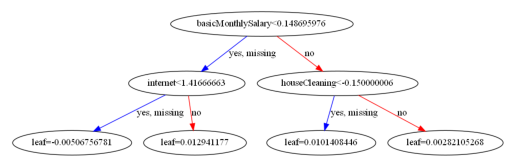

In [313]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)

model.named_steps['classifier'].get_booster().feature_names = X.columns.to_list()

plot_tree(model.named_steps['classifier'],
          rank_dir='LR'); plt.show()

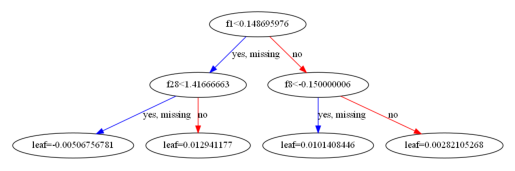

In [118]:
# model.named_steps['classifier'].feature_importances_

Permutation explainer: 269it [00:13,  4.83it/s]                         


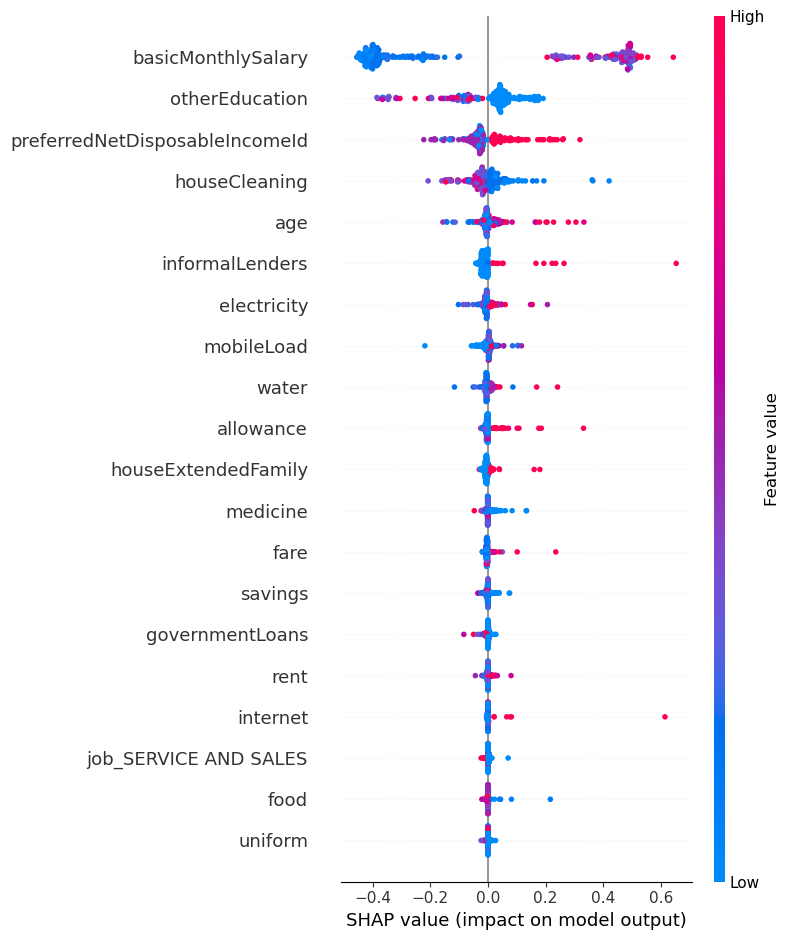

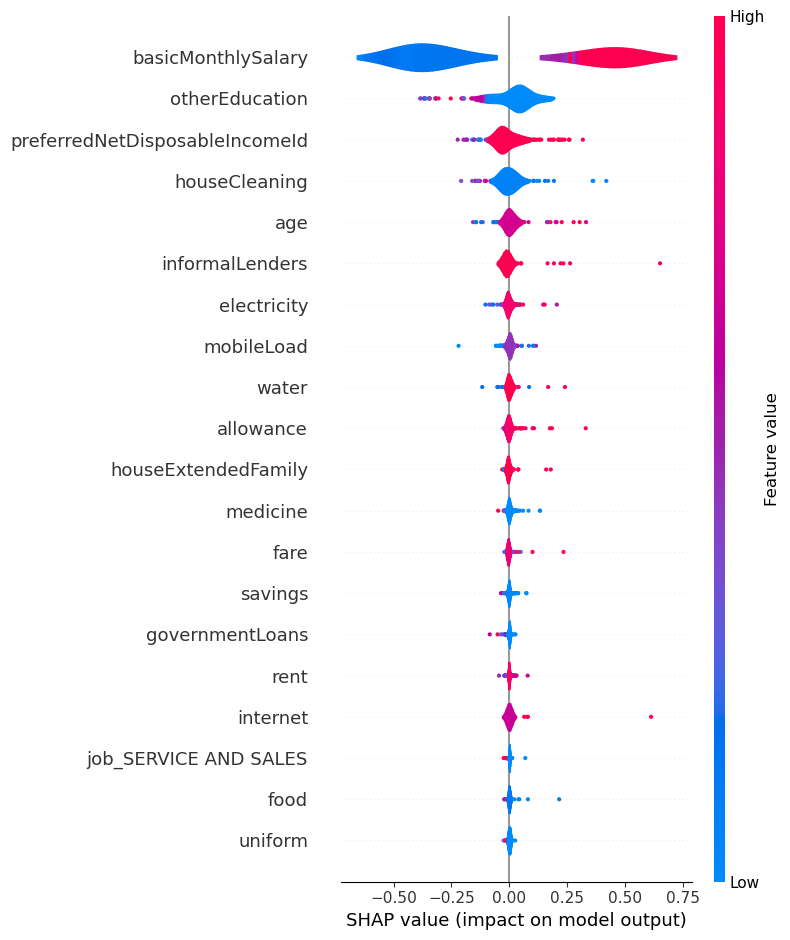

In [325]:
df = ho_t02
# model = ho_t02_xgb_be.named_steps['classifier']
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)
# explainer = shap.TreeExplainer(model=model,
#                                data=X_test,
#                                model_output='raw',
# #                                feature_perturbation='tree_path_dependent'
#                               )

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)
# shap_values = explainer.shap_values(X_test)


feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

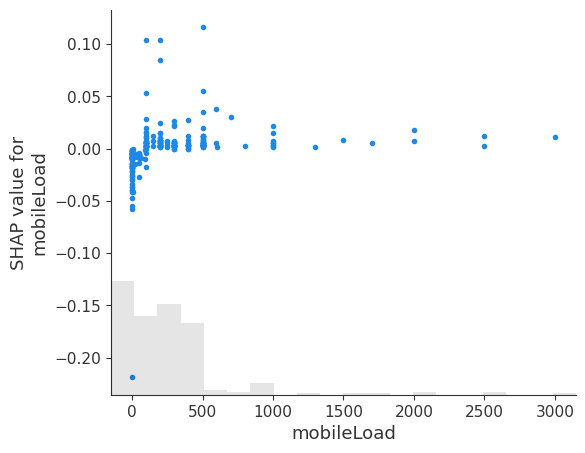

In [354]:
feature_name = 'mobileLoad' # Replace with the name of the feature you're interested in

shap.plots.scatter(shap_values[:, feature_name])
plt.show()

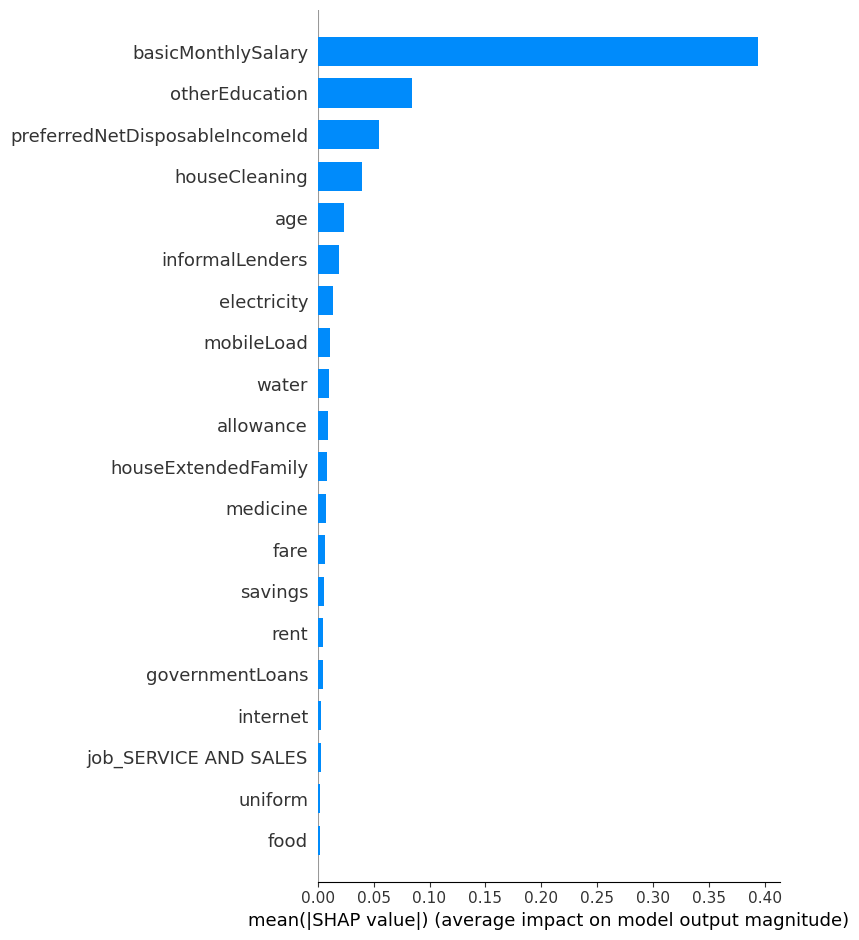

In [315]:
shap.summary_plot(shap_values, feature_names=feature_names,
                  plot_type='bar')

Permutation explainer: 269it [00:13,  4.92it/s]                         


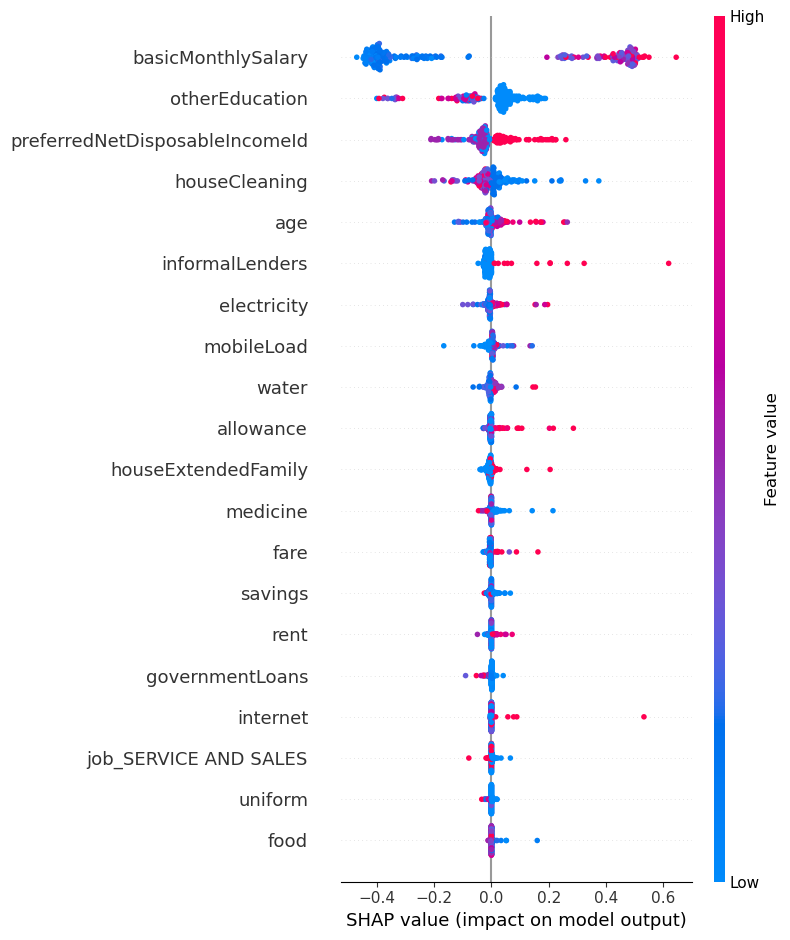

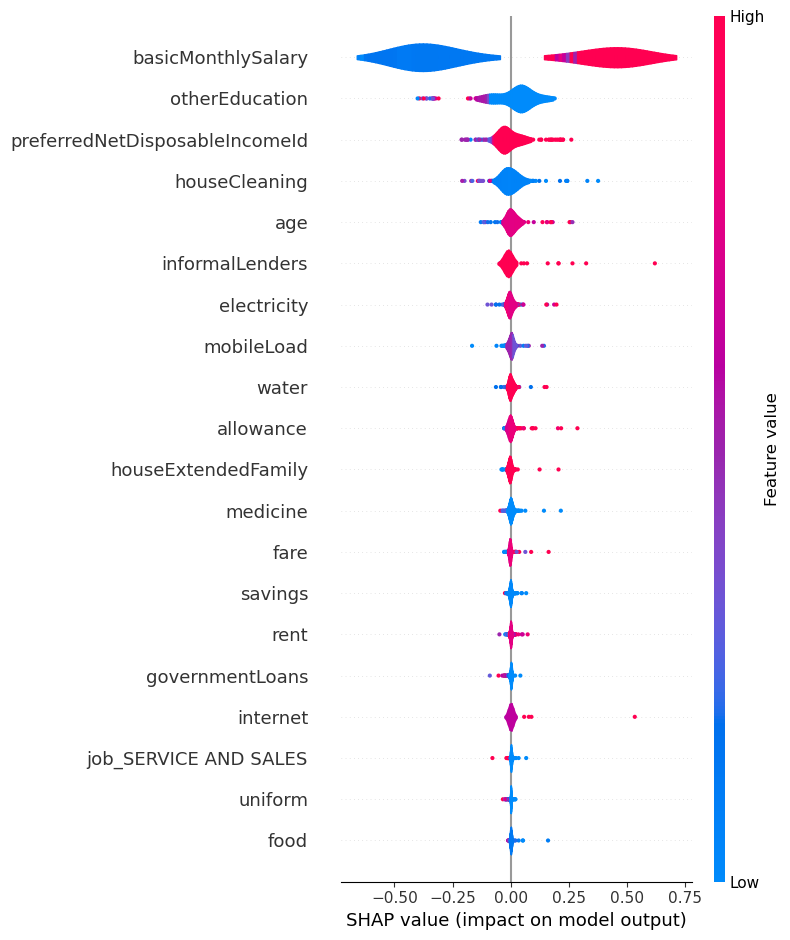

In [296]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)

feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

In [47]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [355]:
ho_t02
df = ho_t02.copy()
df['userId'] = df['userId'].astype('str')
df = adjust_data_types(df)

# ho_t03_dice['gender_MALE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_CAVITE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_METRO MANILA'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_ASSOCIATE PROFESSIONAL'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_SERVICE AND SALES'] = ho_t03_dice['userId'].astype('str')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1070 entries, 0 to 1069
Data columns (total 55 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          1070 non-null   object 
 1   lastFirstName                   1070 non-null   object 
 2   age                             1070 non-null   float64
 3   basicMonthlySalary              1070 non-null   float64
 4   preferredNetDisposableIncomeId  1070 non-null   float64
 5   workingFamilyCount              1070 non-null   float64
 6   residentsCount                  1070 non-null   float64
 7   monthlyFamilyIncome             1070 non-null   float64
 8   food                            1070 non-null   float64
 9   hygiene                         1070 non-null   float64
 10  houseCleaning                   1070 non-null   float64
 11  fare                            1070 non-null   float64
 12  parking                         10

In [359]:
items_list = [
    'food', 'hygiene', 'houseCleaning',
    'fare', 'parking', 'gasoline', 'tuition', 'allowance',
    'uniform', 'otherEducation', 'emergency', 'medicine',
    'water', 'electricity', 'rent', 'repair', 
    'dineOut', 'leisure', 'personalCare', 'clothing',
    'mobileLoad', 'internet', 
    'smoking', 'gambling',
]

result_dict = {}
for item in items_list:
    result_dict[item] = [0, query_instance[item].values[0]]

print(result_dict)

{'food': [0, 3000.0], 'hygiene': [0, 1000.0], 'houseCleaning': [0, 1000.0], 'fare': [0, 2000.0], 'parking': [0, 0.0], 'gasoline': [0, 0.0], 'tuition': [0, 0.0], 'allowance': [0, 0.0], 'uniform': [0, 0.0], 'otherEducation': [0, 0.0], 'emergency': [0, 1000.0], 'medicine': [0, 1000.0], 'water': [0, 500.0], 'electricity': [0, 1500.0], 'rent': [0, 500.0], 'repair': [0, 0.0], 'dineOut': [0, 0.0], 'leisure': [0, 0.0], 'personalCare': [0, 0.0], 'clothing': [0, 1000.0], 'mobileLoad': [0, 2000.0], 'internet': [0, 0.0], 'smoking': [0, 0.0], 'gambling': [0, 0.0]}


In [419]:
df = df
model = ho_t02_xgb_be


X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
# exp = dice_ml.Dice(d, m, method='genetic')
exp = dice_ml.Dice(d, m)

In [421]:
max_limit = len(X_test[X_test['home_ownership_class'] == 0])

init = 40
for i in range(init, max_limit):
    try:
        # Generate counterfactual examples
        query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
        dice_exp = exp.generate_counterfactuals(
            query_instance, total_CFs=1,
            desired_class="opposite", verbose=True,
           features_to_vary=[
                'food', 'hygiene', 'houseCleaning',
                'fare', 'parking', 'gasoline', 'tuition', 'allowance',
                'uniform', 'otherEducation', 'emergency', 'medicine',
                'water', 'electricity', 'rent', 'repair', 
                'dineOut', 'leisure', 'personalCare', 'clothing',
                'mobileLoad', 'internet', 
                'smoking', 'gambling', 'savings', 'payFamilySupport'
            ],
            permitted_range=result_dict
        )
        # Visualize counterfactual explanation
        dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                        show_only_changes=True)
        break
    except Exception as e:
        print(f"Error at i={i}: {e}")
        continue


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=40: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=41: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1,1,1,1,0,1,0,1,0,0,0,0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0.0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,159.3,-,-,-,-,-,-,95.9,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0


In [422]:
df = df
model = ho_t02_xgb_be
i = 42

X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
exp = dice_ml.Dice(d, m, method='genetic')
# exp = dice_ml.Dice(d, m)


# Generate counterfactual examples
query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
dice_exp = exp.generate_counterfactuals(
    query_instance, total_CFs=30,
    desired_class="opposite", verbose=True,
   features_to_vary=[
        'food', 'hygiene', 'houseCleaning',
        'fare', 'parking', 'gasoline', 'tuition', 'allowance',
        'uniform', 'otherEducation', 'emergency', 'medicine',
        'water', 'electricity', 'rent', 'repair', 
        'dineOut', 'leisure', 'personalCare', 'clothing',
        'mobileLoad', 'internet', 
        'smoking', 'gambling', 'savings', 'payFamilySupport'
    ],
    permitted_range=result_dict
)

# Visualize counterfactual explanation
dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                show_only_changes=True)

  0%|          | 0/1 [00:00<?, ?it/s]

Initializing initial parameters to the genetic algorithm...
Initialization complete! Generating counterfactuals...


100%|██████████| 1/1 [00:16<00:00, 16.78s/it]

Only 16 (required 30)  Diverse Counterfactuals found for the given configuation, perhaps  change the query instance or the features to vary...; total time taken: 00 min 16 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,331.6,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,3000.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,300.0,0.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,3000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,30.6,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,-,500.0,-,-,-,-,-,-,0.0,300.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1799.1,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,300.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1282.3,-,-,-,-,-,-,0.0,0.0,-,1000.0,-,500.0,1000.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,2450.2,-,-,-,-,-,-,0.0,0.0,-,496.0,-,300.0,750.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1982.1,-,-,1000.0,-,-,-,0.0,0.0,-,500.0,500.0,350.0,1000.0,-,-,-,-,-,0.0,-,50.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,805.2,-,-,0.0,-,-,-,0.0,0.0,-,500.0,500.0,500.0,1000.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0


In [410]:
ho_t02[
    (ho_t02['age'] == 40) &
    (ho_t02['basicMonthlySalary'] == 30000) &
    (ho_t02['monthlyFamilyIncome'] == 30000) &
    (ho_t02['residentsCount'] == 5)
]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
69,10492,"GARCIA, FRANCO",40,30000,2,1,5,30000.0,4000,2000,1000,0,0,400,0,500,500,500,5000,2000,250,1000,4000,0,0,500,500,200,500,0,1000,0,0,0,0,374,0,0,0,0,0,1000,0,0,1,1,0,1,0,0,1,0,0,0,0


In [394]:
ho_t02[ho_t02['userId'] == 11666]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
607,11742,"DAYAO, ANGELO",27,26000,2,3,4,35000.0,5000,5000,5000,0,0,0,0,0,0,3000,3000,0,1000,1000,5000,0,0,0,0,500,0,0,0,0,0,0,0,0,0,0,0,0,0,3000,0,0,0,1,0,1,0,0,1,0,1,0,0


In [414]:
# Saving examples to csv
dice_exp.cf_examples_list[0].final_cfs_df.to_csv('new_10492.csv')

In [ ]:
#     permitted_range={'food': [0, query_instance['food'].values[0]]}
#     features_to_vary = [
#         'monthlyVices',
#         'monthlyUtilityBills',
#         'totalMonthlyExpenses',
# #         'monthlyFamilyIncome - totalMonthlyExpenses',
# #         'basicMonthlySalary - totalMonthlyExpenses',
#         'monthlyFamilyIncome / workingFamilyCount',
# #         'monthlyFamilyIncome / residentsCount',
#         'basicMonthlySalary / monthlyFamilyIncome',
#         'totalMonthlyExpenses / basicMonthlySalary',
#         'totalMonthlyExpenses / monthlyFamilyIncome'
#     ]

#     features_to_vary=[
#         'food', 'hygiene', 'houseCleaning',
#         'fare', 'parking', 'gasoline', 'tuition', 'allowance',
#         'uniform', 'otherEducation', 'emergency', 'medicine',
#         'water', 'electricity', 'rent', 'repair', 
#         'dineOut', 'leisure', 'personalCare', 'clothing',
#         'mobileLoad', 'internet', 'vehicleLoan', 'informalLenders',
#         'companyLoan', 'privateLoans', 'governmentLoans',
#         'smoking', 'gambling', 'savings', 'loanSSS', 'payFamilySupport',
#         'houseHasPrivateEmployee', 'houseHasOFW',
#         'houseOnlyFamily', 'houseExtendedFamily'
#     ]
#     features_to_vary=[
#         'water', 'electricity', 'rent',
# #         'preferredNetDisposableIncomeId',
#         'mobileLoad', 'internet'
#     ]

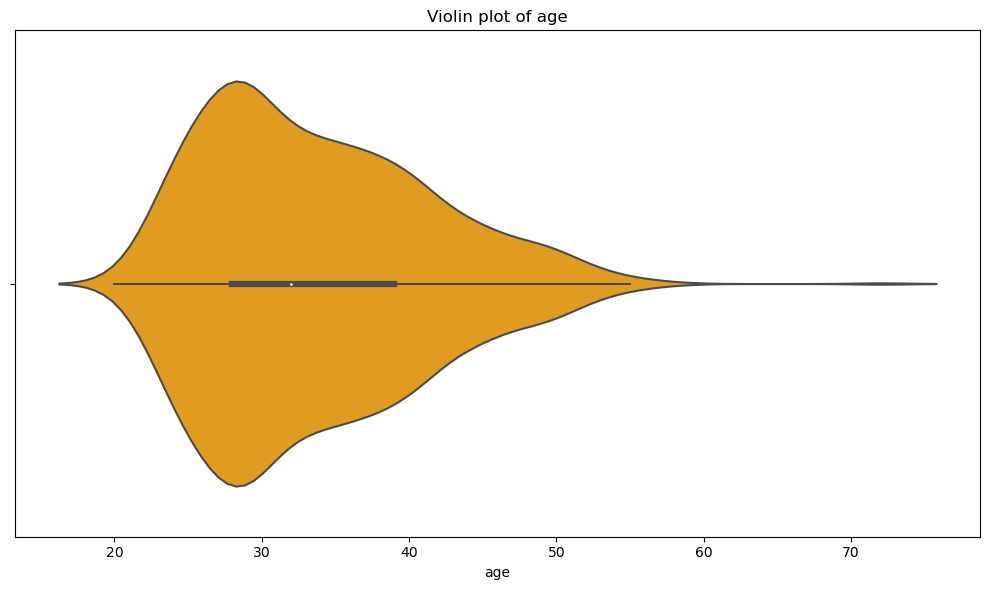

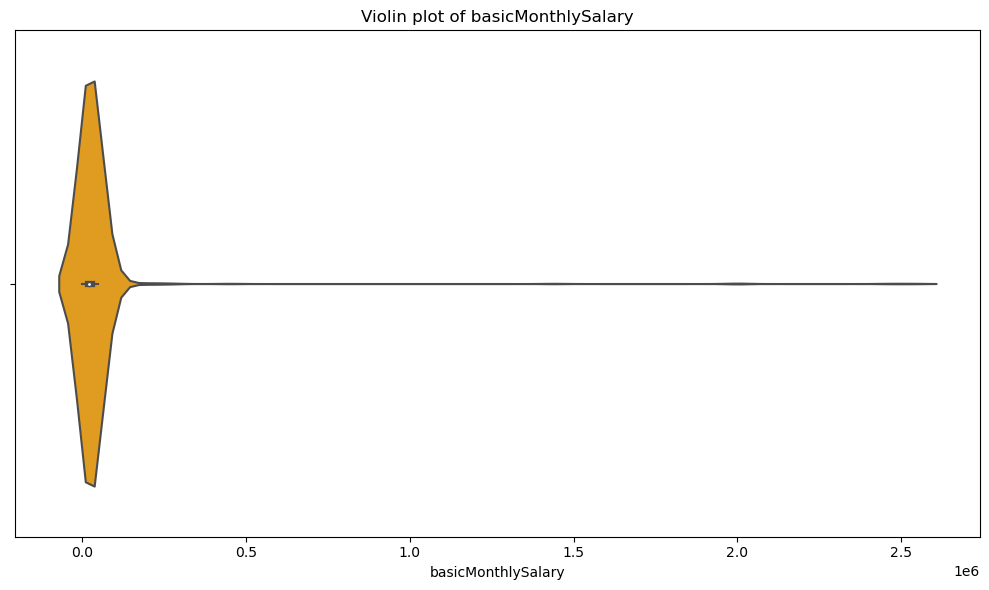

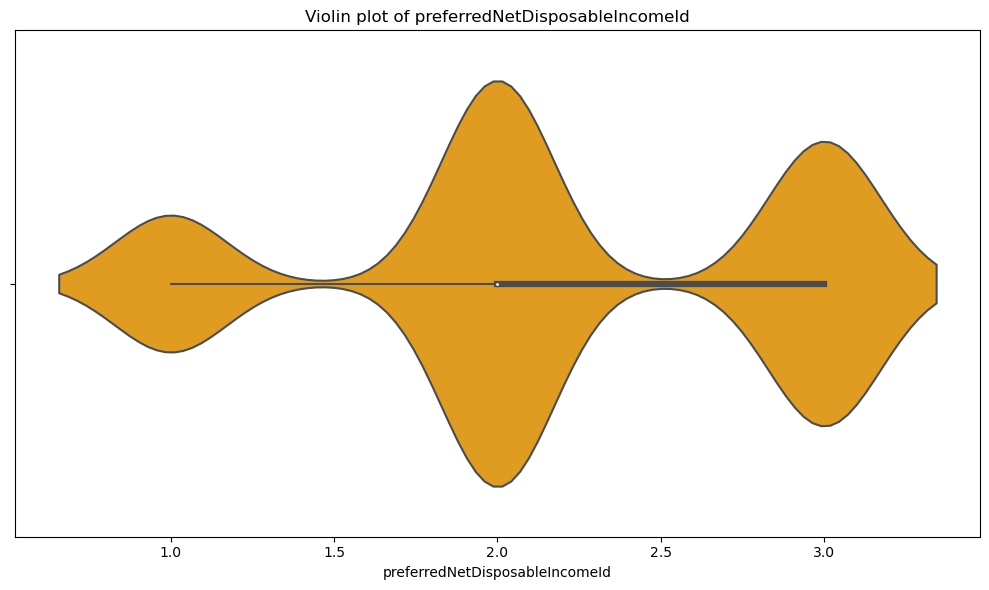

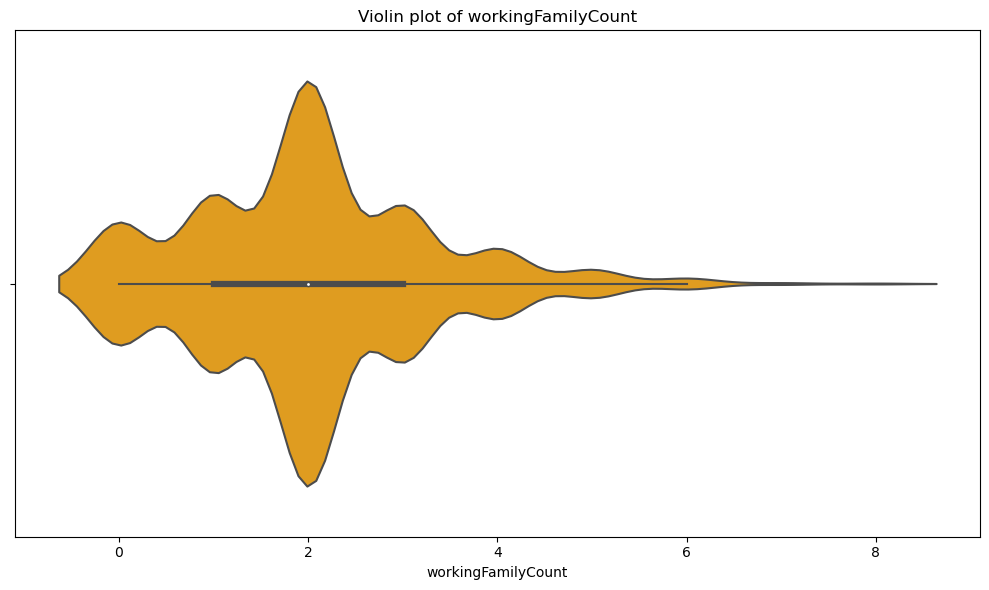

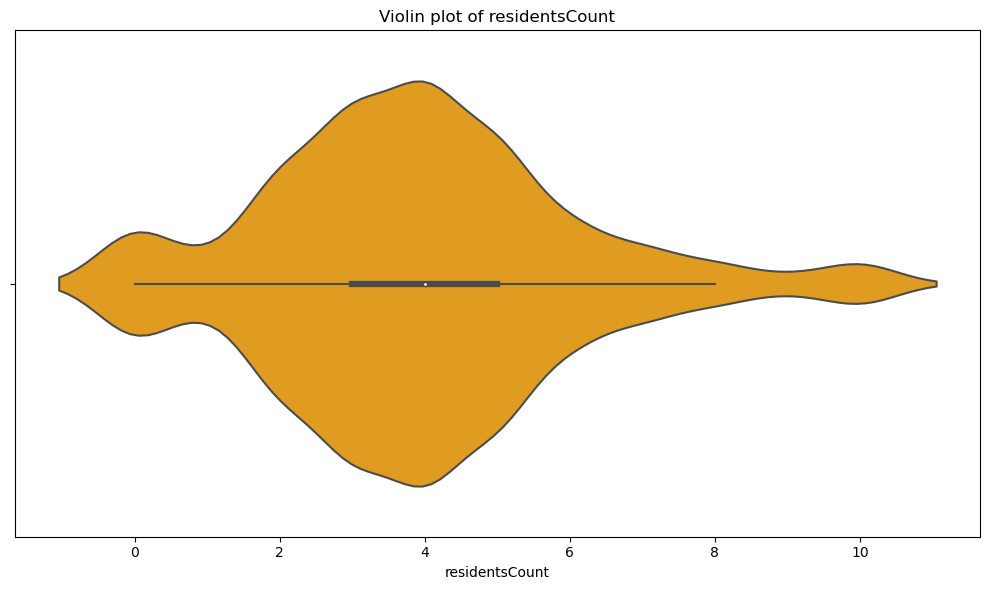

...

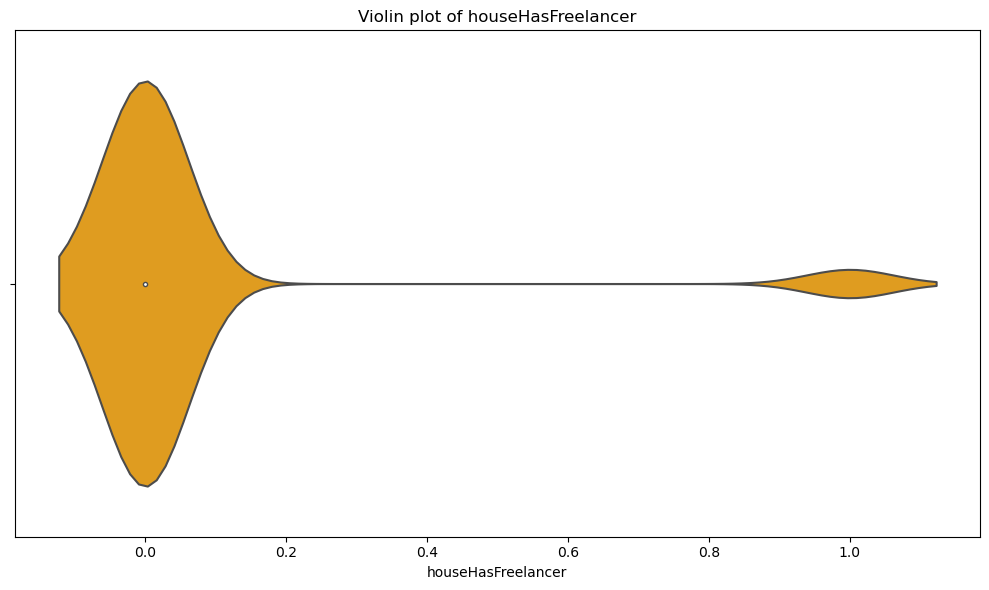

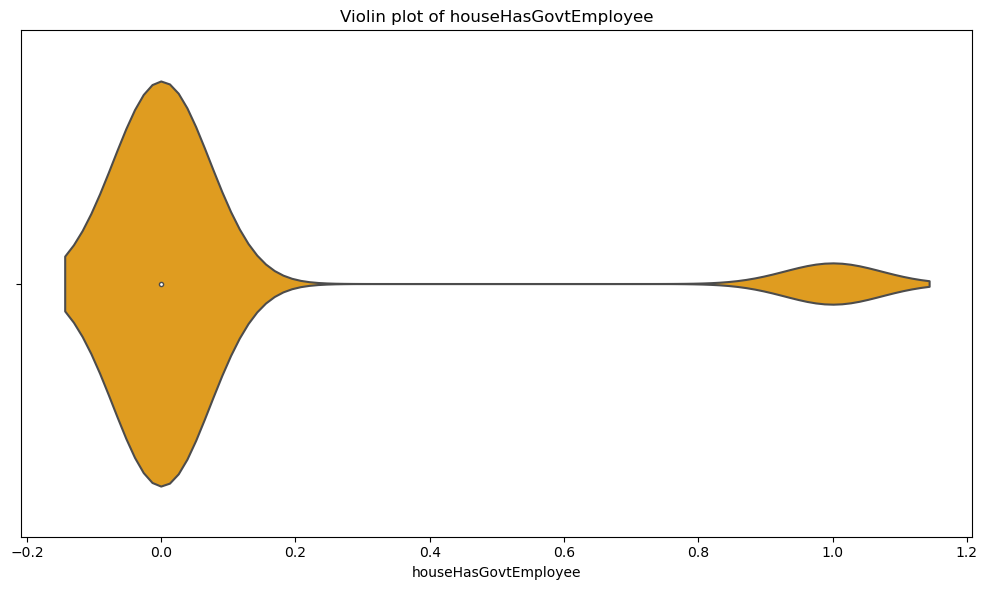

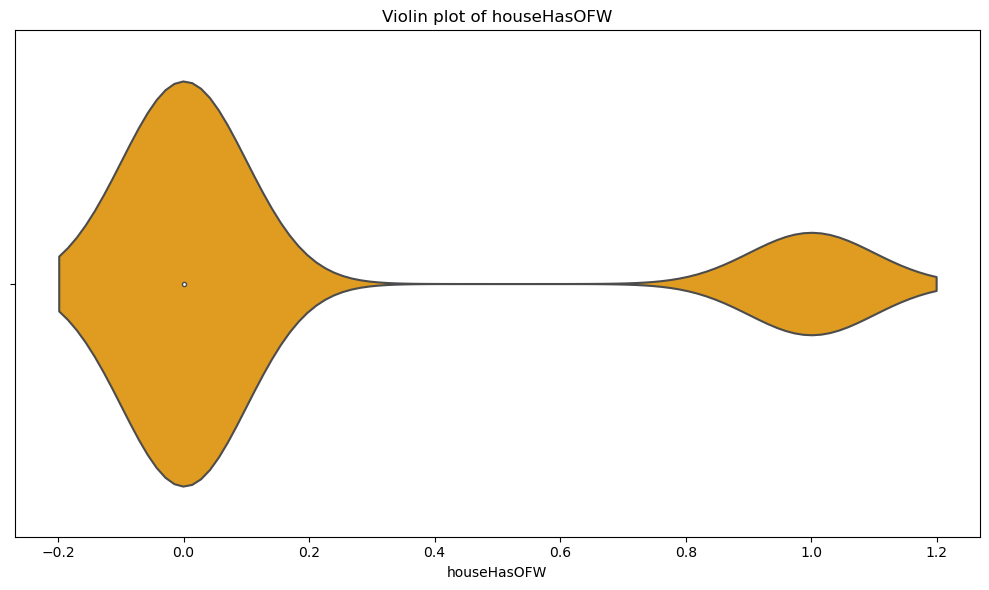

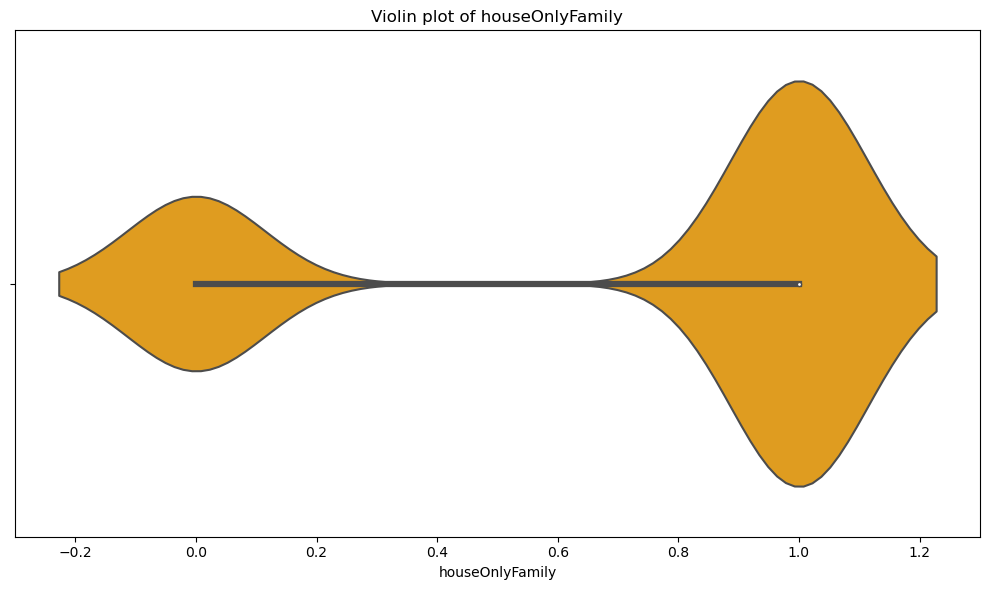

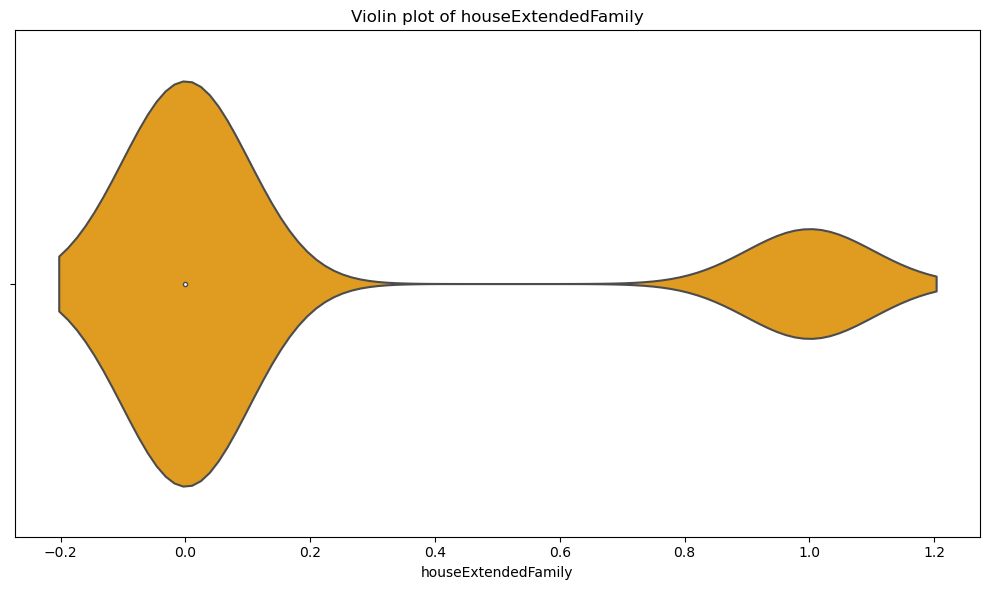

In [435]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your dataframe
df = ho_t01.drop(columns=['userId', 'lastFirstName', 'home_ownership_class', 'gender', 'job', 'province'])
features = df.columns

for feature in features:
    plt.figure(figsize=(10, 6))
    sns.violinplot(x=df[feature], color='orange')
    plt.title('Violin plot of {}'.format(feature))
    plt.tight_layout()
    plt.show()


In [8]:
1/(1+np.exp(-1*0.0101408446))

0.5025351894241549